# EDA on the Official Covid-19 Public Dataset

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import scipy as sp
import seaborn as sns
from matplotlib import pyplot as plt
from collections import Counter
from itertools import chain
import datetime as dt
import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

pd.set_option('display.max_columns', None)

from sklearn.feature_selection import SelectKBest, chi2, f_regression, mutual_info_regression, RFECV
from sklearn.feature_selection import f_classif, mutual_info_classif
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso

from sklearn import preprocessing # label encoding
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier 
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import svm
from sklearn.model_selection import train_test_split # Import train_test_split functionn
from sklearn.tree import export_graphviz 
from sklearn import tree

from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

from sklearn.pipeline import make_pipeline


from sklearn.preprocessing import MinMaxScaler # min max
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE
import imblearn

## Epidemic

## Loading the Epidemic Dataset

In [2]:
cases_malaysia = pd.read_csv('covid19-public/epidemic/cases_malaysia.csv')
cases_state = pd.read_csv('covid19-public/epidemic/cases_state.csv')
clusters = pd.read_csv('covid19-public/epidemic/clusters.csv')
deaths_malaysia = pd.read_csv('covid19-public/epidemic/deaths_malaysia.csv')
deaths_state = pd.read_csv('covid19-public/epidemic/deaths_state.csv')
hospital = pd.read_csv('covid19-public/epidemic/hospital.csv')
icu = pd.read_csv('covid19-public/epidemic/icu.csv')
pkrc = pd.read_csv('covid19-public/epidemic/pkrc.csv')
tests_malaysia = pd.read_csv('covid19-public/epidemic/tests_malaysia.csv')
tests_state = pd.read_csv('covid19-public/epidemic/tests_state.csv')

In [3]:
population = pd.read_csv('covid19-public/static/population.csv')

We will start by looking at the cases_malaysia dataset first.

In [4]:
print(cases_malaysia.shape)
cases_malaysia.dtypes

(631, 19)


date                        object
cases_new                    int64
cases_import                 int64
cases_recovered              int64
cases_active                 int64
cases_cluster                int64
cases_pvax                   int64
cases_fvax                   int64
cases_child                  int64
cases_adolescent             int64
cases_adult                  int64
cases_elderly                int64
cluster_import             float64
cluster_religious          float64
cluster_community          float64
cluster_highRisk           float64
cluster_education          float64
cluster_detentionCentre    float64
cluster_workplace          float64
dtype: object

In [5]:
cases_malaysia.isnull().sum()

date                         0
cases_new                    0
cases_import                 0
cases_recovered              0
cases_active                 0
cases_cluster                0
cases_pvax                   0
cases_fvax                   0
cases_child                  0
cases_adolescent             0
cases_adult                  0
cases_elderly                0
cluster_import             342
cluster_religious          342
cluster_community          342
cluster_highRisk           342
cluster_education          342
cluster_detentionCentre    342
cluster_workplace          342
dtype: int64

In [6]:
print(cases_state.shape)
cases_state.dtypes

(10096, 13)


date                object
state               object
cases_new            int64
cases_import         int64
cases_recovered      int64
cases_active         int64
cases_cluster        int64
cases_pvax           int64
cases_fvax           int64
cases_child          int64
cases_adolescent     int64
cases_adult          int64
cases_elderly        int64
dtype: object

In [7]:
cases_state.isnull().sum()

date                0
state               0
cases_new           0
cases_import        0
cases_recovered     0
cases_active        0
cases_cluster       0
cases_pvax          0
cases_fvax          0
cases_child         0
cases_adolescent    0
cases_adult         0
cases_elderly       0
dtype: int64

In [8]:
print(clusters.shape)
clusters.dtypes

(5654, 14)


cluster            object
state              object
district           object
date_announced     object
date_last_onset    object
category           object
status             object
cases_new           int64
cases_total         int64
cases_active        int64
tests               int64
icu                 int64
deaths              int64
recovered           int64
dtype: object

In [9]:
clusters.isnull().sum()

cluster            0
state              0
district           0
date_announced     0
date_last_onset    0
category           0
status             0
cases_new          0
cases_total        0
cases_active       0
tests              0
icu                0
deaths             0
recovered          0
dtype: int64

In [10]:
print(deaths_malaysia.shape)
deaths_malaysia.dtypes

(579, 8)


date              object
deaths_new         int64
deaths_bid         int64
deaths_new_dod     int64
deaths_bid_dod     int64
deaths_pvax        int64
deaths_fvax        int64
deaths_tat         int64
dtype: object

In [11]:
print(deaths_state.shape)
deaths_state.dtypes

(9264, 9)


date              object
state             object
deaths_new         int64
deaths_bid         int64
deaths_new_dod     int64
deaths_bid_dod     int64
deaths_pvax        int64
deaths_fvax        int64
deaths_tat         int64
dtype: object

In [12]:
deaths_state.isnull().sum()

date              0
state             0
deaths_new        0
deaths_bid        0
deaths_new_dod    0
deaths_bid_dod    0
deaths_pvax       0
deaths_fvax       0
deaths_tat        0
dtype: int64

In [13]:
print(hospital.shape)
hospital.dtypes

(8739, 14)


date                object
state               object
beds                 int64
beds_covid           int64
beds_noncrit         int64
admitted_pui         int64
admitted_covid       int64
admitted_total       int64
discharged_pui       int64
discharged_covid     int64
discharged_total     int64
hosp_covid           int64
hosp_pui             int64
hosp_noncovid        int64
dtype: object

In [14]:
hospital.isnull().sum()

date                0
state               0
beds                0
beds_covid          0
beds_noncrit        0
admitted_pui        0
admitted_covid      0
admitted_total      0
discharged_pui      0
discharged_covid    0
discharged_total    0
hosp_covid          0
hosp_pui            0
hosp_noncovid       0
dtype: int64

In [15]:
print(icu.shape)
icu.dtypes

(8759, 16)


date              object
state             object
beds_icu           int64
beds_icu_rep       int64
beds_icu_total     int64
beds_icu_covid     int64
vent               int64
vent_port          int64
icu_covid          int64
icu_pui            int64
icu_noncovid       int64
vent_covid         int64
vent_pui           int64
vent_noncovid      int64
vent_used          int64
vent_port_used     int64
dtype: object

In [16]:
icu.isnull().sum()

date              0
state             0
beds_icu          0
beds_icu_rep      0
beds_icu_total    0
beds_icu_covid    0
vent              0
vent_port         0
icu_covid         0
icu_pui           0
icu_noncovid      0
vent_covid        0
vent_pui          0
vent_noncovid     0
vent_used         0
vent_port_used    0
dtype: int64

In [17]:
print(pkrc.shape)
pkrc.dtypes

(6673, 12)


date               object
state              object
beds                int64
admitted_pui        int64
admitted_covid      int64
admitted_total      int64
discharge_pui       int64
discharge_covid     int64
discharge_total     int64
pkrc_covid          int64
pkrc_pui            int64
pkrc_noncovid       int64
dtype: object

In [18]:
pkrc.isnull().sum()

date               0
state              0
beds               0
admitted_pui       0
admitted_covid     0
admitted_total     0
discharge_pui      0
discharge_covid    0
discharge_total    0
pkrc_covid         0
pkrc_pui           0
pkrc_noncovid      0
dtype: int64

In [19]:
print(tests_malaysia.shape)
tests_malaysia.dtypes

(628, 3)


date      object
rtk-ag     int64
pcr        int64
dtype: object

In [20]:
tests_malaysia.isnull().sum()

date      0
rtk-ag    0
pcr       0
dtype: int64

In [21]:
print(tests_state.shape)
tests_state.dtypes

(1664, 4)


date      object
state     object
rtk-ag     int64
pcr        int64
dtype: object

In [22]:
tests_state.isnull().sum()

date      0
state     0
rtk-ag    0
pcr       0
dtype: int64

In [23]:
print(population.shape)
population.dtypes

(17, 6)


state     object
idxs       int64
pop        int64
pop_18     int64
pop_60     int64
pop_12     int64
dtype: object

In [24]:
population.isnull().sum()

state     0
idxs      0
pop       0
pop_18    0
pop_60    0
pop_12    0
dtype: int64

In [25]:
# Basic preperation

# change to date_time from object
cases_malaysia['date'] = pd.to_datetime(cases_malaysia['date'], errors='raise')
cases_state['date'] = pd.to_datetime(cases_state['date'], errors='raise')
clusters['date_announced'] = pd.to_datetime(clusters['date_announced'], errors='raise')
clusters['date_last_onset'] = pd.to_datetime(clusters['date_last_onset'], errors='raise')
deaths_malaysia['date'] = pd.to_datetime(deaths_malaysia['date'], errors='raise')
deaths_state['date'] = pd.to_datetime(deaths_state['date'], errors='raise')
hospital['date'] = pd.to_datetime(hospital['date'], errors='raise')
icu['date'] = pd.to_datetime(icu['date'], errors='raise')
pkrc['date'] = pd.to_datetime(pkrc['date'], errors='raise')
tests_malaysia['date'] = pd.to_datetime(tests_malaysia['date'], errors='raise')
tests_state['date'] = pd.to_datetime(tests_state['date'], errors='raise')

## Measuring the Central Tendency of the Datasets

In [26]:
display(cases_malaysia.describe())
display(cases_state.describe())
display(clusters.describe())
display(deaths_malaysia.describe())
display(deaths_state.describe())
display(hospital.describe())
display(icu.describe())
display(pkrc.describe())
display(tests_malaysia.describe())
display(tests_state.describe())
display(population.describe())

,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace
count,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,289.000000,289.000000,289.000000,289.000000,289.000000,289.000000,289.000000
mean,3778.988906,8.044374,3583.659271,43915.730586,758.602219,608.576862,630.244057,507.465927,261.432647,2589.125198,306.692552,0.453287,28.532872,246.674740,31.380623,38.878893,75.840830,766.235294
std,5847.240380,8.841529,5786.879132,70140.682760,844.642809,1580.419176,1727.793582,902.211358,447.967489,3909.072042,481.956180,3.719141,62.343525,186.481227,33.331465,71.754325,79.180365,467.460701
min,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,19.000000,0.000000,0.000000,0.000000,57.000000
25%,37.500000,3.000000,35.500000,898.500000,8.500000,0.000000,0.000000,1.000000,1.000000,23.000000,2.000000,0.000000,1.000000,95.000000,6.000000,0.000000,17.000000,357.000000
50%,1208.000000,5.000000,1052.000000,12826.000000,518.000000,0.000000,0.000000,93.000000,53.000000,899.000000,58.000000,0.000000,6.000000,199.000000,18.000000,14.000000,56.000000,720.000000
75%,4545.000000,10.000000,4235.000000,49644.500000,1247.000000,62.500000,24.500000,466.000000,323.500000,3278.000000,413.500000,0.000000,20.000000,359.000000,48.000000,40.000000,103.000000,1120.000000
max,24599.000000,72.000000,24855.000000,263903.000000,3394.000000,7304.000000,8398.000000,5766.000000,1840.000000,16440.000000,1941.000000,54.000000,359.000000,825.000000,189.000000,501.000000,439.000000,2338.000000


,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly
count,10096.000000,10096.000000,10096.000000,10096.000000,10096.000000,10096.000000,10096.000000,10096.000000,10096.000000,10096.000000,10096.000000
mean,236.186807,0.502773,223.978704,2744.733162,47.412639,38.036054,39.390254,31.716620,16.339540,161.820325,19.168284
std,636.677500,2.175188,635.473629,7859.912680,100.527649,192.829266,177.368243,88.646513,44.060657,441.963569,48.721742
min,0.000000,0.000000,0.000000,-2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,10.000000,0.000000,8.000000,138.000000,3.000000,0.000000,0.000000,0.000000,0.000000,7.000000,1.000000
75%,177.000000,0.000000,148.000000,1721.750000,51.250000,1.000000,1.000000,17.000000,9.000000,124.000000,13.000000
max,8792.000000,72.000000,8801.000000,94152.000000,1545.000000,3885.000000,3600.000000,1898.000000,530.000000,6514.000000,617.000000


,cases_new,cases_total,cases_active,tests,icu,deaths,recovered
count,5654.000000,5654.000000,5654.000000,5654.000000,5654.000000,5654.000000,5654.000000
mean,0.073576,87.627343,1.986912,365.253803,0.002830,0.340998,85.264238
std,1.252162,221.008991,12.228202,1210.866481,0.053126,1.441258,219.911898
min,0.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000
25%,0.000000,20.000000,0.000000,58.000000,0.000000,0.000000,18.000000
50%,0.000000,38.000000,0.000000,137.000000,0.000000,0.000000,37.000000
75%,0.000000,83.000000,0.000000,325.000000,0.000000,0.000000,79.000000
max,52.000000,7205.000000,381.000000,42100.000000,1.000000,37.000000,7204.000000


,deaths_new,deaths_bid,deaths_new_dod,deaths_bid_dod,deaths_pvax,deaths_fvax,deaths_tat
count,579.000000,579.000000,579.000000,579.000000,579.000000,579.000000,579.000000
mean,48.113990,9.732297,48.113990,9.732297,10.383420,4.656304,2.255613
std,92.824298,23.588364,86.633365,19.887726,24.775493,11.903781,4.304212
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
50%,4.000000,1.000000,5.000000,1.000000,0.000000,0.000000,2.000000
75%,59.000000,5.000000,59.000000,6.000000,3.000000,0.000000,3.000000
max,592.000000,176.000000,407.000000,117.000000,135.000000,61.000000,49.000000


,deaths_new,deaths_bid,deaths_new_dod,deaths_bid_dod,deaths_pvax,deaths_fvax,deaths_tat
count,9264.000000,9264.000000,9264.000000,9264.000000,9264.000000,9264.000000,9264.000000
mean,3.007124,0.608269,3.007124,0.608269,0.648964,0.291019,1.279577
std,11.764712,3.402970,11.409599,2.879370,3.535731,1.254310,5.569188
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
max,359.000000,84.000000,191.000000,63.000000,69.000000,17.000000,176.000000


,beds,beds_covid,beds_noncrit,admitted_pui,admitted_covid,admitted_total,discharged_pui,discharged_covid,discharged_total,hosp_covid,hosp_pui,hosp_noncovid
count,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000,8739.000000
mean,2004.112599,503.215929,1924.503490,15.747225,43.289507,59.036732,11.503376,36.754663,48.258039,244.713812,41.295572,979.360682
std,1326.039408,568.585871,1270.914009,35.167995,81.545866,108.231998,25.074612,72.930321,91.807945,428.495547,80.080518,657.046695
min,122.000000,4.000000,95.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1158.000000,132.000000,1124.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,7.000000,2.000000,533.000000
50%,1669.000000,323.000000,1616.000000,3.000000,8.000000,15.000000,2.000000,7.000000,13.000000,78.000000,10.000000,871.000000
75%,2664.000000,701.000000,2579.000000,11.000000,47.000000,60.000000,9.000000,39.000000,47.000000,327.000000,40.000000,1445.000000
max,6568.000000,4713.000000,6224.000000,273.000000,748.000000,797.000000,236.000000,658.000000,732.000000,4218.000000,874.000000,3407.000000


,beds_icu,beds_icu_rep,beds_icu_total,beds_icu_covid,vent,vent_port,icu_covid,icu_pui,icu_noncovid,vent_covid,vent_pui,vent_noncovid,vent_used,vent_port_used
count,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000
mean,48.154926,31.001256,79.156182,47.469574,81.523690,35.790501,27.523690,0.660349,25.970202,14.935381,0.312935,3.740724,52.863683,1.440575
std,35.179481,37.717519,66.219760,50.858285,64.987227,33.043151,53.145864,4.154975,17.753846,31.345421,1.068089,9.900153,48.016764,5.811679
min,5.000000,0.000000,5.000000,0.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,23.000000,2.000000,33.000000,12.000000,41.000000,12.000000,0.000000,0.000000,11.000000,0.000000,0.000000,0.000000,23.000000,0.000000
50%,47.000000,16.000000,67.000000,30.000000,63.000000,22.000000,4.000000,0.000000,23.000000,2.000000,0.000000,0.000000,39.000000,0.000000
75%,64.000000,55.000000,110.000000,64.000000,106.000000,48.000000,33.000000,0.000000,39.000000,17.000000,0.000000,0.000000,72.000000,0.000000
max,247.000000,227.000000,455.000000,380.000000,534.000000,196.000000,532.000000,80.000000,109.000000,294.000000,41.000000,106.000000,402.000000,64.000000


,beds,admitted_pui,admitted_covid,admitted_total,discharge_pui,discharge_covid,discharge_total,pkrc_covid,pkrc_pui,pkrc_noncovid
count,6673.000000,6673.000000,6673.000000,6673.000000,6673.000000,6673.000000,6673.000000,6673.000000,6673.000000,6673.000000
mean,1544.454818,2.593586,90.490184,93.083770,2.024577,88.376442,90.401019,670.062940,27.766372,15.988911
std,2017.616716,7.682841,175.275283,177.317022,7.576587,174.950787,176.550935,1088.110945,90.206430,41.151358
min,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,148.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000,0.000000,0.000000
50%,730.000000,0.000000,18.000000,20.000000,0.000000,18.000000,19.000000,173.000000,0.000000,0.000000
75%,2055.000000,2.000000,104.000000,106.000000,1.000000,96.000000,98.000000,814.000000,12.000000,0.000000
max,11345.000000,190.000000,2040.000000,2042.000000,305.000000,2278.000000,2278.000000,6685.000000,1079.000000,629.000000


,rtk-ag,pcr
count,628.000000,628.000000
mean,23669.347134,27418.031847
std,28992.440921,23483.994401
min,0.000000,2.000000
25%,1240.250000,6469.250000
50%,8755.000000,21853.000000
75%,36544.250000,44420.500000
max,141200.000000,90293.000000


,rtk-ag,pcr
count,1664.000000,1664.000000
mean,4779.382812,3793.123197
std,6069.170838,3850.248204
min,9.000000,13.000000
25%,1359.750000,1330.000000
50%,2944.000000,2832.000000
75%,5546.250000,4777.250000
max,41143.000000,23350.000000


,idxs,pop,pop_18,pop_60,pop_12
count,17.000000,1.700000e+01,1.700000e+01,1.700000e+01,1.700000e+01
mean,8.000000,3.842047e+06,2.754071e+06,4.120000e+05,3.702941e+05
std,5.049752,7.597089e+06,5.448646e+06,8.107364e+05,7.313435e+05
min,0.000000,9.960000e+04,6.770000e+04,5.000000e+03,9.500000e+03
25%,4.000000,1.128800e+06,8.084000e+05,1.185000e+05,1.094000e+05
50%,8.000000,1.773700e+06,1.348600e+06,2.058000e+05,1.730000e+05
75%,12.000000,2.816500e+06,2.042700e+06,3.328000e+05,2.932000e+05
max,16.000000,3.265740e+07,2.340960e+07,3.502000e+06,3.147500e+06


## cases_malaysia.csv dataset

Under the `cases_malaysia` dataset, we can subset it further. These subset groups are: 
- Age group: `cases_child`, `cases_adolescent`, `cases_adult`, `cases_elderly`
- Cases from identified clusters: `cluster_religious`, `cluster_community`, `cluster_highRisk`, `cluster_education`, `cluster_detentionCentre`, `cluster_workplace` 

The same can be seen for the `cases_state` dataset, which only has the age group subset. 

These subsets can be used for our analysis on differences between the age groups, as well as the clusters they are likely to originate from. This may have potential for identifying patterns or data for mining in terms of which age group/clusters the Covid-19 cases originate from. 

We also need to note that, the "Cases from Identified Clusters" has a huge amount of null values. Further inspection reveals that, the values that are null, originate from the dates that appear before '1/1/2021', where there is no recorded data regarding daily cases from clusters. Hence, it would be a viable option to analyse this group, after this specified date (1/1/2021). 

In [27]:
# Prove that the dataset is null before 01/01/2021, uncomment the code below
cases_malaysia.iloc[340:344]

,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace
340,2020-12-30,1870,2,745,22519,920,0,0,141,62,1304,115,NaN,NaN,NaN,NaN,NaN,NaN,NaN
341,2020-12-31,2525,13,1481,23556,1505,0,0,142,62,2152,88,NaN,NaN,NaN,NaN,NaN,NaN,NaN
342,2021-01-01,2068,2,2230,23382,944,0,0,121,76,1721,119,0.0,0.0,35.0,17.0,0.0,18.0,671.0
343,2021-01-02,2295,9,3321,22347,1091,0,0,116,61,1896,117,0.0,2.0,30.0,33.0,0.0,135.0,882.0


Finally, since the `cases_cluster` column represents the cases attributed to the clusters, and we are interested now to see the general pattern of the new cases in Malaysia, we shall drop the columns in the group of 'Cases from identified clusters'.

In [28]:
# save the clusters into another dataframe
cases_malaysia_with_clusters = cases_malaysia[['date', 'cluster_import', 'cluster_religious', 'cluster_community', 'cluster_highRisk', 'cluster_education', 'cluster_detentionCentre', 'cluster_workplace']].copy()
cases_malaysia_with_clusters

,date,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace
0,2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-01-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-01-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-01-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020-01-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
626,2021-10-12,0.0,10.0,140.0,20.0,64.0,0.0,145.0
627,2021-10-13,0.0,24.0,95.0,78.0,66.0,44.0,193.0
628,2021-10-14,0.0,10.0,78.0,75.0,34.0,0.0,155.0
629,2021-10-15,0.0,0.0,86.0,18.0,27.0,6.0,279.0


In [29]:
# For dropping clusters 
cases_malaysia.drop(cases_malaysia.columns[12:], axis=1, inplace=True)

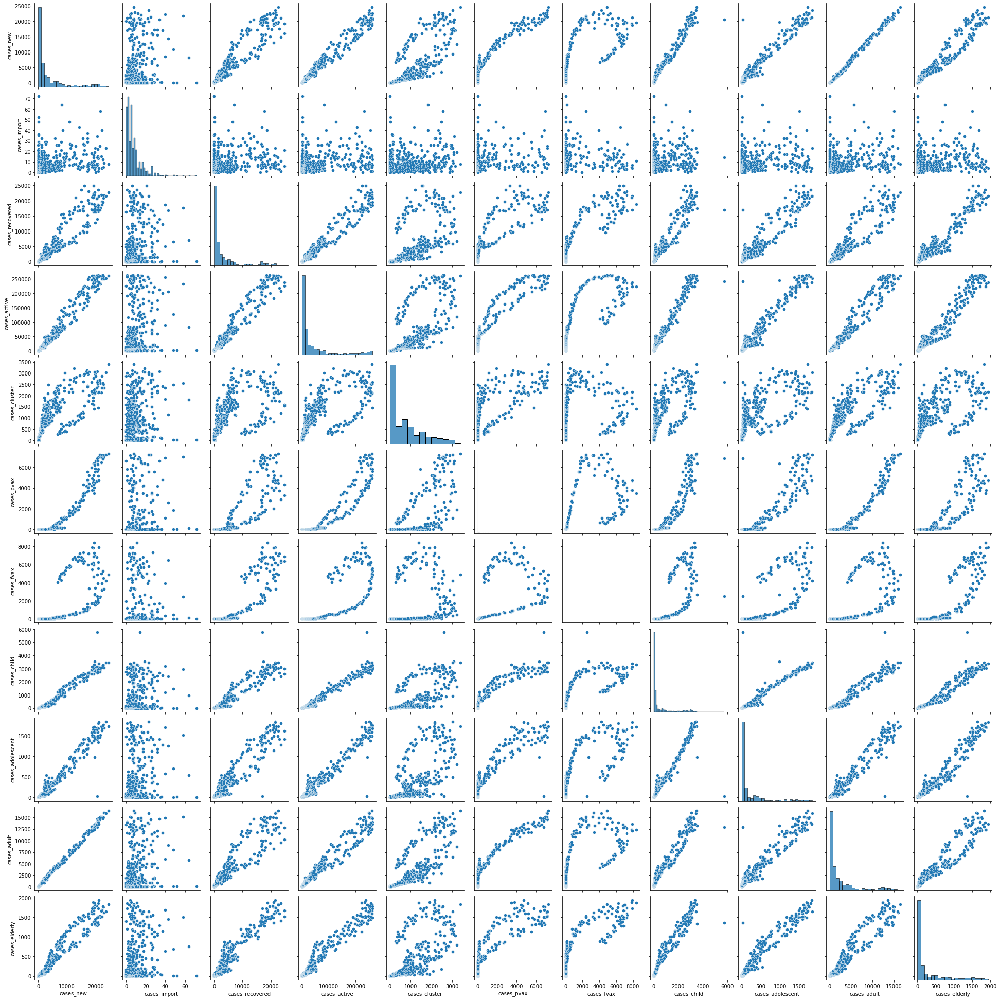

In [30]:
sns.pairplot(data=cases_malaysia)

<AxesSubplot:>

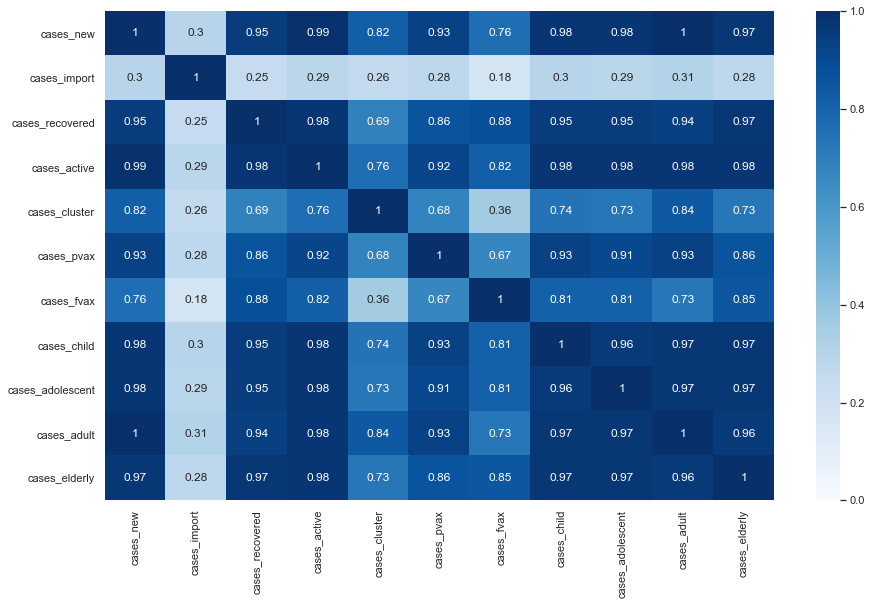

In [31]:
# show the correlation between attributes using a correlation plot
sns.set(rc={'figure.figsize':(15,9)})
sns.heatmap(cases_malaysia[1:-1].corr().round(2), cmap='Blues', annot=True, vmin=0, vmax=1)

From this correlation plot, with the exception of `cases_import`, each attribute is strong positive correlation to another attribute. Now we look at the histogram and density plot for these attributes. 

In [32]:
coi = cases_malaysia.columns.tolist()
coi.pop(0)
for column in coi: 
    print("Skewness " + column + ": " + str(cases_malaysia[column].skew()))

Skewness cases_new: 1.8805065253815654
Skewness cases_import: 2.701680900244781
Skewness cases_recovered: 1.9940643731088523
Skewness cases_active: 1.9319721272964225
Skewness cases_cluster: 1.0567521867832868
Skewness cases_pvax: 2.861720978396113
Skewness cases_fvax: 2.8472582567467057
Skewness cases_child: 2.1225306681776193
Skewness cases_adolescent: 2.0428739074041955
Skewness cases_adult: 1.8681271531442079
Skewness cases_elderly: 1.7569135955203503


Based on the value of the skewness, we can see that all of these attributes are highly skewed to the right. To reduce this skewness, we will be employing cube square root transform, which is normally applied for counted data. 

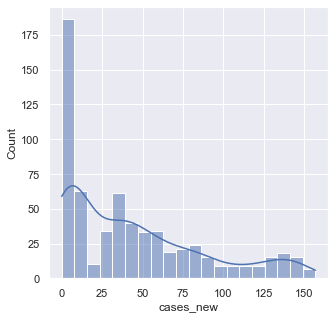

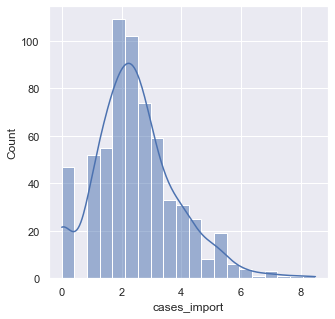

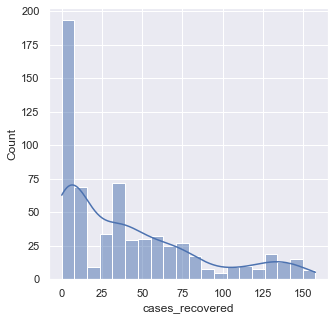

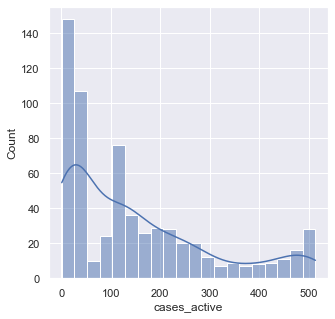

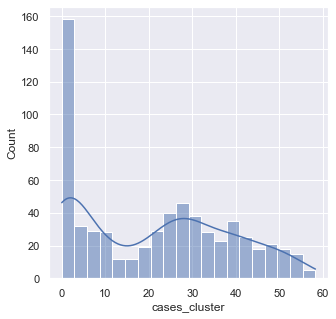

...

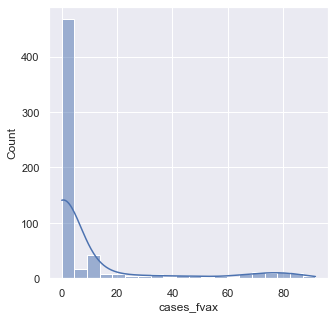

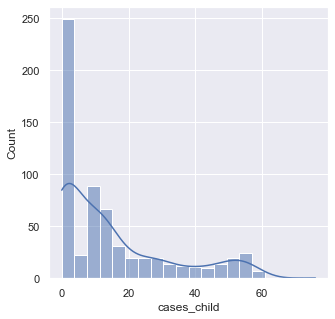

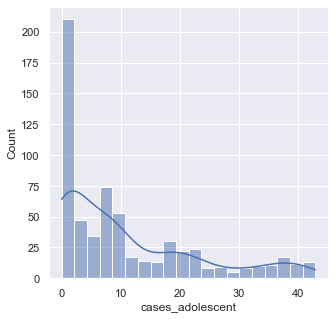

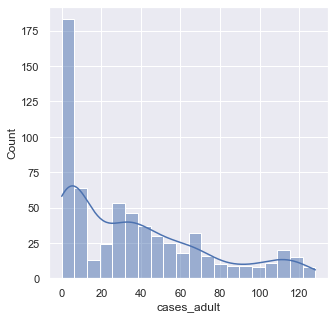

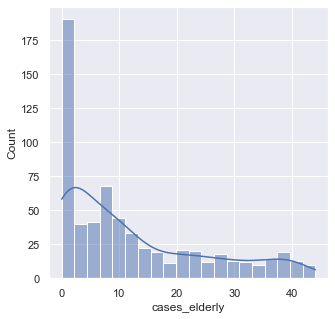

In [33]:
for column in coi: 
    fig, ax = plt.subplots(figsize=(5,5))
    sqrt_trans = np.sqrt(cases_malaysia[column])
    sns.histplot(ax=ax, data=sqrt_trans, kde=True, bins=20)
    plt.show()

For identifying outliers in this data, the appropriate graph to be used will be to use will be the boxplot. 

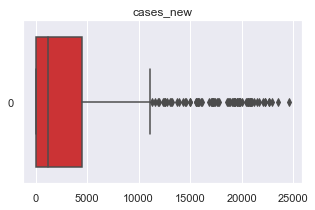

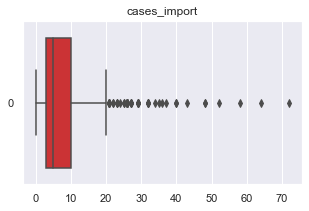

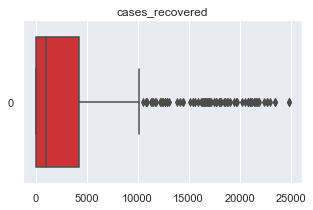

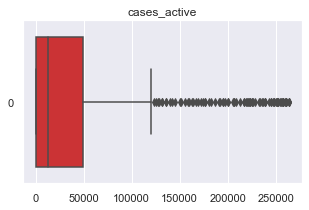

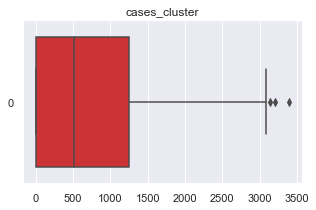

...

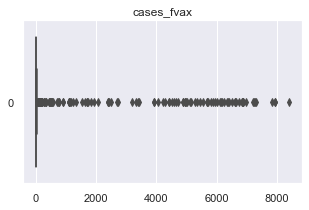

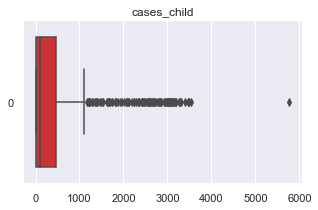

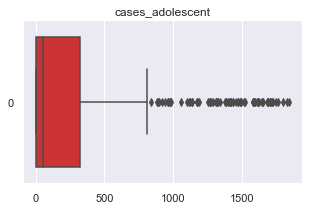

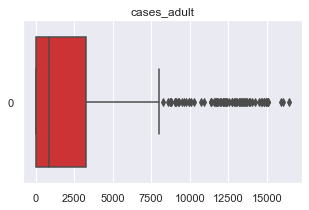

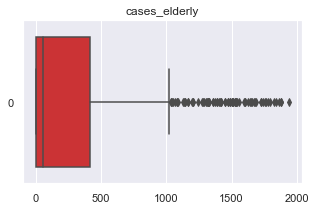

In [34]:
for column in coi: 
    fig, ax = plt.subplots(figsize=(5,3))
    ax.set_title(column)
    sns.boxplot(ax=ax, data=cases_malaysia[column], orient='h', palette='Set1')
    plt.show()

Based on the analysis of the outliers, we can see that the `cases_active` has a very wide range of values. In order to better analyse the other attributes, we will be removing the `cases_active` attribute so that we may further study the other attributes in the column. 

However, we also notice that many other attributes still contain a high amount of outliers. In order to overcome this problem, we will split our dataset into 3-month intervals for this boxplot analysis. 

In [35]:
coi.pop(3)

intervals_boundries = [pd.Timestamp('2020-01-25'), 
                        pd.Timestamp('2020-04-25'), 
                        pd.Timestamp('2020-07-25'),
                        pd.Timestamp('2020-10-25'),
                        pd.Timestamp('2021-01-25'),
                        pd.Timestamp('2021-04-25'), 
                        pd.Timestamp('2021-07-25'),
                        pd.Timestamp('2021-10-25'),]

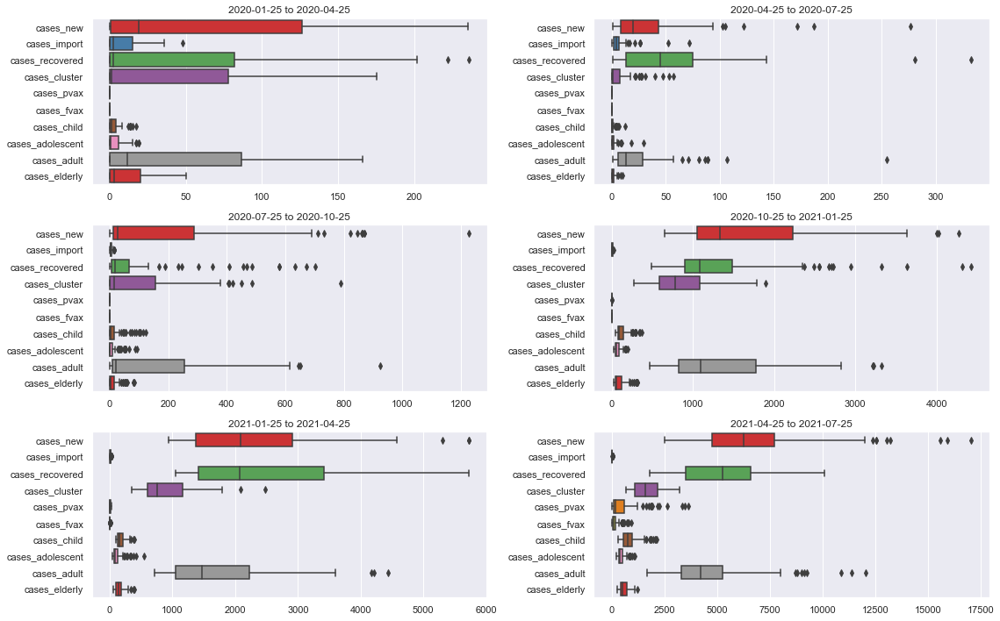

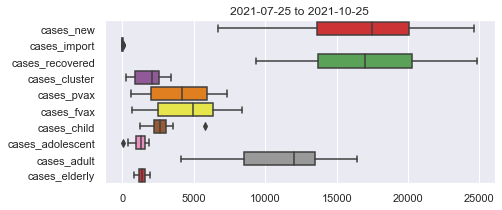

In [36]:
cases_malaysia.set_index('date', inplace=True)
n_plots = len(intervals_boundries) - 1

fig, axes = plt.subplots(ncols=2, nrows=n_plots//2, figsize=(16,10))

for i, ax in zip(range(len(intervals_boundries)), axes.flat):
    ax.set_title(intervals_boundries[i].strftime('%Y-%m-%d') + ' to ' + intervals_boundries[i+1].strftime('%Y-%m-%d'))
    df = cases_malaysia.loc[intervals_boundries[i]:intervals_boundries[i+1],coi]
    sns.boxplot(data=df, orient='h', palette='Set1', ax=ax)
fig.tight_layout()

fig, ax = plt.subplots(figsize=(7,3))
ax.set_title(intervals_boundries[-2].strftime('%Y-%m-%d') + ' to ' + intervals_boundries[-1].strftime('%Y-%m-%d'))
df = cases_malaysia.loc[intervals_boundries[-2]:intervals_boundries[-1],coi]
sns.boxplot(ax=ax, data=df, orient='h', palette='Set1')
plt.show()

After splitting the datasets into 3-month intervals, we have successfully reduced the outliers across all attributes. Further analysis shows that, `cases_new`, `cases_recovered` and `cases_adult` cover the widest range. The outliers indicates that, along the 3-month intervals, we have a spike in cases that attributed to the existence of these upper outliers when recording the daily cases in Malaysia, which subsequently led to the wide range of values in the `cases_recovery` attribute, as more people recovered from their Covid-19 infection. 

The strongest indicator however, is that a majority of the cases originates from adults. Hence, this category group should be the main focus of the government if it plans to curb and control the spread of Covid-19 in Malaysia.

## Feature Engineering: Lagging and Rolling Average for Daily New Cases
As we are dealing with time series analysis data, we will need to expand the number of features, for the purposes of feature extraction. One of the few methods we chose to approach is by using lagged variables i.e how past values of variables are able to influence the future values, thus unlocking predictive value. 

The second method involes using a moving average, in the form of a 7-day moving average and 14-day moving average. The reason we use this method is because it is extremely difficult to understand how much something is increasing when there are multiple peaks and valleys, espeically when looking at relational plots. In our case, it provides us with an average line over time, which effectively 'flattens' the peaks and valleys, giving us a better visualisation for example, the trend of daily cases. 

Below, we have prepared 2 functions that help us perform the above tasks before we conduct feature extraction of the variables. We will be using these functions for the `cases_malaysia` and `cases_state` dataset.

In [37]:
def calc_lag(df, ndays):
    """Takes in cases dataset for a particular state and number of days. 
    Returns a new dataset with added n-day columns of 1 to n-day lags for each of the
    3 cases columns."""
    
    cols_of_interest = df[['cases_new', 'cases_import', 'cases_recovered']]
    for i in range(ndays):
        current_day_lag = cols_of_interest.shift(i+1)
        current_day_lag.columns = [str(i+1)+'-day lag imported case', 
                                   str(i+1)+'-day lag new case', 
                                   str(i+1)+'-day lag recovered case']
        df = pd.concat([df, current_day_lag], axis=1)
    return df

In [38]:
def cases_engineer(df_cases, state_name='', show_plot=False):
    """Takes in the cases_malaysia/cases_state dataset (if using the cases_state, the name of the state is needed). Returns a new dataset that 
    contains added lagging and rolling average features.
    """
    cases = df_cases.copy()
    # extracting dataframe for this state
    if state_name != '':
        cases = df_cases[df_cases['state'] == state_name]
        cases = cases.drop(columns=['state'])
        cases.reset_index(inplace=True, drop=True)

    # adding columns of the rolling averages of new cases for 7 days and 14 days
    cases['7DayAverageNewCases'] = cases['cases_new'].rolling(window=7).mean()
    cases['14DayAverageNewCases'] = cases['cases_new'].rolling(window=14).mean()
    cases['7DayAverageImportCases'] = cases['cases_import'].rolling(window=7).mean()
    cases['14DayAverageImportCases'] = cases['cases_import'].rolling(window=14).mean()
    cases['7DayAverageRecoveredCases'] = cases['cases_recovered'].rolling(window=7).mean()
    cases['14DayAverageNewRecoveredCases'] = cases['cases_recovered'].rolling(window=14).mean() 

    # adding columns of 1-to-n-day-lags of new cases, new import cases and cases recovered
    cases = calc_lag(cases, 7)

    # simple plot to confirm...
    if show_plot == True: 
        df = cases.set_index('date')
        if state_name != '':
            fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15,15))
            sns.lineplot(data=df.loc['2021-01':,['cases_new', '7DayAverageNewCases', '14DayAverageNewCases']], ax=ax1).set_title(state_name + ' rolling average new cases')
            sns.lineplot(data=df.loc['2021-01':,['cases_import', '7DayAverageImportCases', '14DayAverageImportCases']], ax=ax2).set_title(state_name + ' rolling average import cases')
            sns.lineplot(data=df.loc['2021-01':,['cases_recovered', '7DayAverageRecoveredCases', '14DayAverageNewRecoveredCases']], ax=ax3).set_title(state_name + ' rolling average recovered cases')
        else:
            fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15,20))
            sns.lineplot(data=df.loc['2021-01':,['cases_new', '7DayAverageNewCases', '14DayAverageNewCases']], ax=ax1).set_title('Malaysia rolling average new cases')
            sns.lineplot(data=df.loc['2021-01':,['cases_import', '7DayAverageImportCases', '14DayAverageImportCases']], ax=ax2).set_title('Malaysia rolling average import cases')
            sns.lineplot(data=df.loc['2021-01':,['cases_recovered', '7DayAverageRecoveredCases', '14DayAverageNewRecoveredCases']], ax=ax3).set_title('Malaysia rolling average recovered cases')
    
    return cases

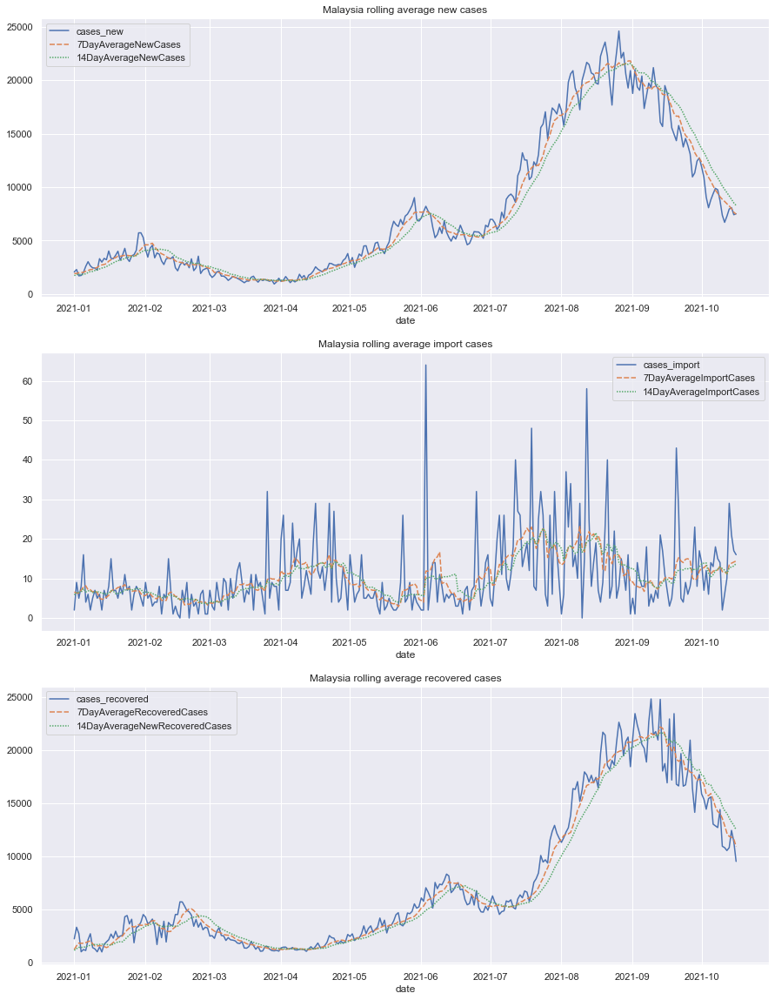

In [39]:
# we create lagging and rolling average feature for cases in malaysia
# cases_malaysia.reset_index()
cases_malaysia = cases_engineer(cases_malaysia.reset_index(), show_plot=True)

In [40]:
# prove that the columns are concatenated, uncomment this code
cases_malaysia.head(20)

,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case
0,2020-01-25,4,4,0,4,0,0,0,0,0,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-01-26,0,0,0,4,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-01-27,0,0,0,4,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-01-28,0,0,0,4,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020-01-29,3,3,0,7,0,0,0,1,0,2,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2020-01-30,1,1,0,8,0,0,0,0,0,1,0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
6,2020-01-31,0,0,0,8,0,0,0,0,0,0,0,1.142857,NaN,1.142857,NaN,0.000000,NaN,1.0,1.0,0.0,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN
7,2020-02-01,0,0,0,8,0,0,0,0,0,0,0,0.571429,NaN,0.571429,NaN,0.000000,NaN,0.0,0.0,0.0,1.0,1.0,0.0,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0
8,2020-02-02,0,0,0,8,0,0,0,0,0,0,0,0.571429,NaN,0.571429,NaN,0.000000,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,2020-02-03,0,0,0,8,0,0,0,0,0,0,0,0.571429,NaN,0.571429,NaN,0.000000,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Now that we have successfully 'flattened' the peak and valleys, it will provide a much simpler visualisation of the `cases_new`, `cases_import` and `cases_recovered`. Based on the data plotted, we can clearly see that Malaysia has undergone 3 waves of Covid-19 infections. Considerable efforts such as lockdowns and curfews were implemented in order to lower the number of cases, in which the fruits of these labour contributed to the decrease in cases. However, the laxed attitude also consequently, caused the increased in cases which led to another wave of infections. This analysis proves to explain that, constant vigilance and care needs to be taken if we are to ensure we do not lead to another new wave of infections again. 

In [41]:
# join the clusters data back to the cases_malaysia dataframe
cases_malaysia = pd.merge(cases_malaysia, cases_malaysia_with_clusters, on='date')
cases_malaysia

,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace
0,2020-01-25,4,4,0,4,0,0,0,0,0,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-01-26,0,0,0,4,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-01-27,0,0,0,4,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-01-28,0,0,0,4,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020-01-29,3,3,0,7,0,0,0,1,0,2,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
626,2021-10-12,7276,10,10555,108747,379,776,4425,1236,581,4486,883,8446.000000,9503.785714,11.142857,11.142857,12203.142857,14068.500000,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,8817.0,14.0,15615.0,0.0,10.0,140.0,20.0,64.0,0.0,145.0
627,2021-10-13,7950,29,10832,105822,500,777,4948,1312,524,4964,1004,8241.714286,9183.500000,13.428571,12.642857,11887.000000,13627.928571,7276.0,10.0,10555.0,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,0.0,24.0,95.0,78.0,66.0,44.0,193.0
628,2021-10-14,8084,21,12456,101422,352,720,4993,1462,538,5020,1005,7983.714286,8851.285714,13.857143,12.928571,11825.857143,13251.571429,7950.0,29.0,10832.0,7276.0,10.0,10555.0,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,0.0,10.0,78.0,75.0,34.0,0.0,155.0
629,2021-10-15,7420,17,11413,97417,416,611,4588,1390,410,4655,918,7650.714286,8532.071429,14.142857,13.142857,11638.571429,12931.714286,8084.0,21.0,12456.0,7950.0,29.0,10832.0,7276.0,10.0,10555.0,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,0.0,0.0,86.0,18.0,27.0,6.0,279.0


## cases_state.csv dataset

Now we will be looking at the `cases_state.csv` dataset. Where we will conduct some analysis on the epidemic data in each state. 

In [42]:
# first we transform the data from long to wide for all the columns
cases_state_wide = cases_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['cases_import', 'cases_new', 'cases_recovered', 'cases_active', 'cases_cluster', 'cases_pvax', 'cases_fvax', 'cases_child', 'cases_adolescent', 'cases_adult', 'cases_elderly']
                                          )

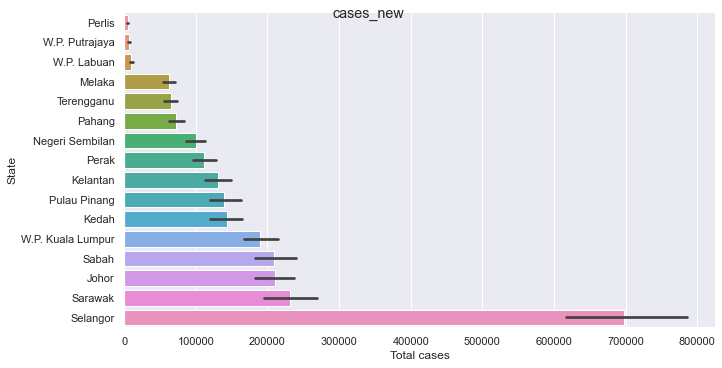

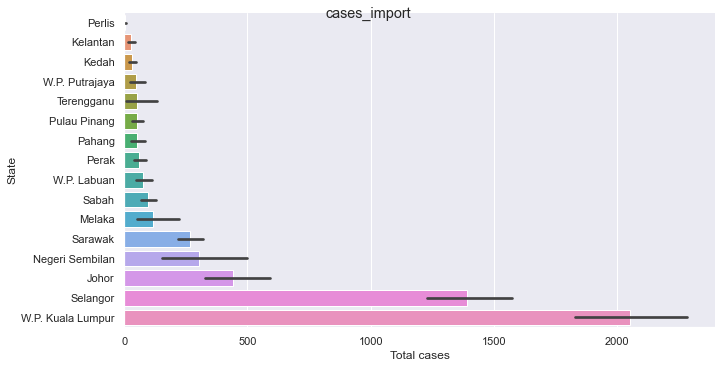

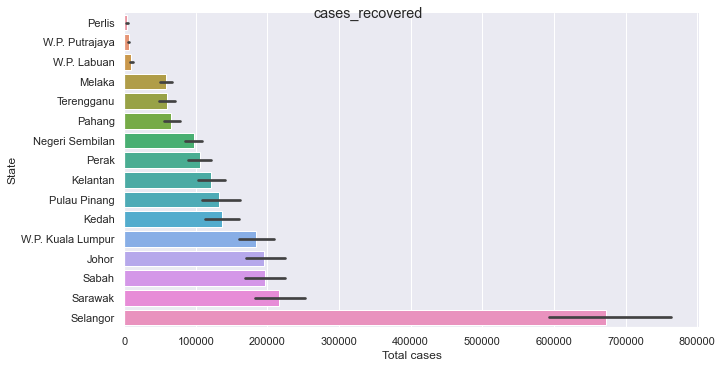

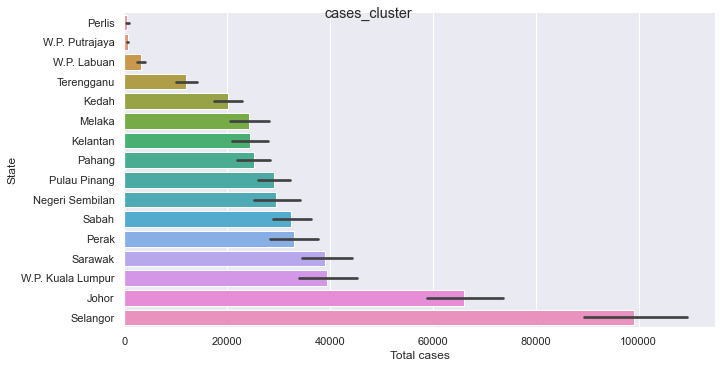

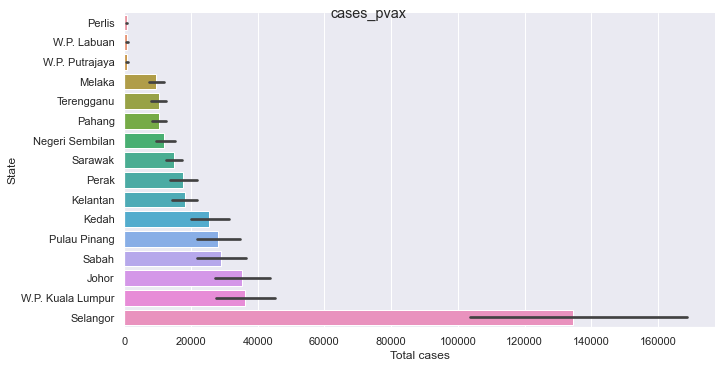

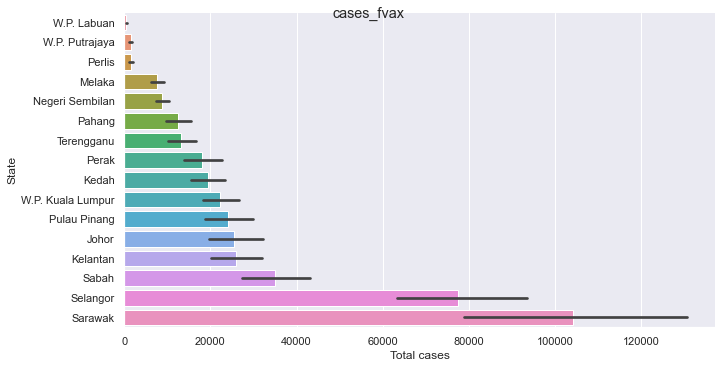

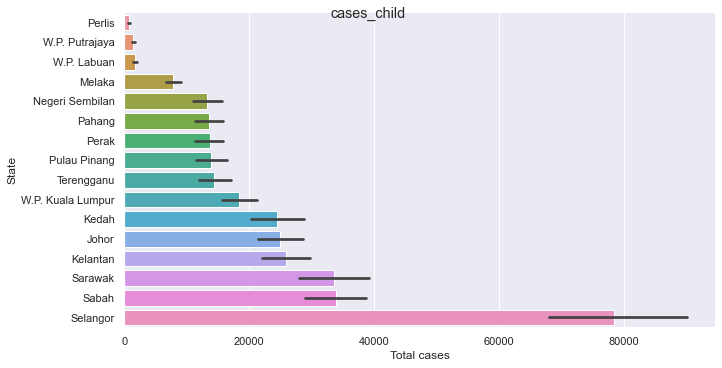

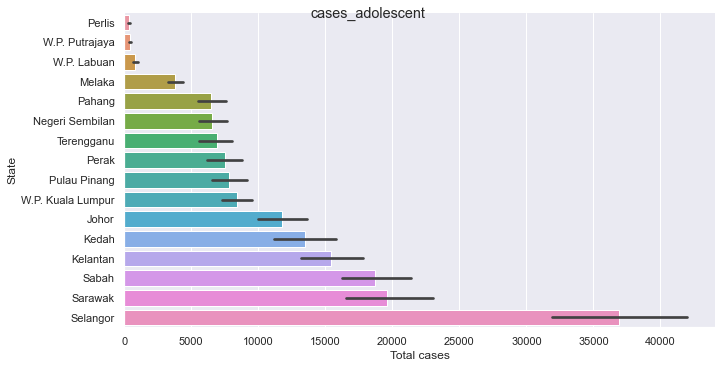

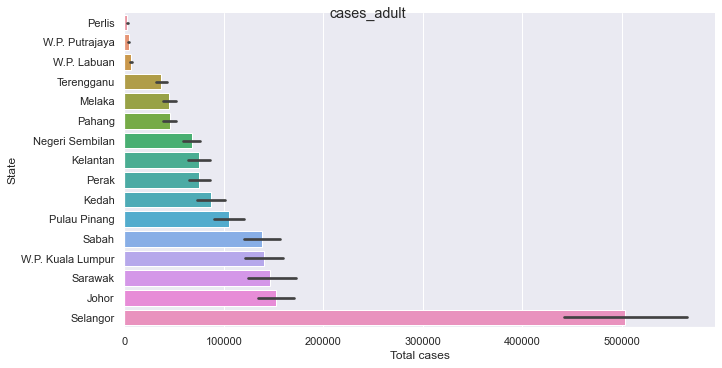

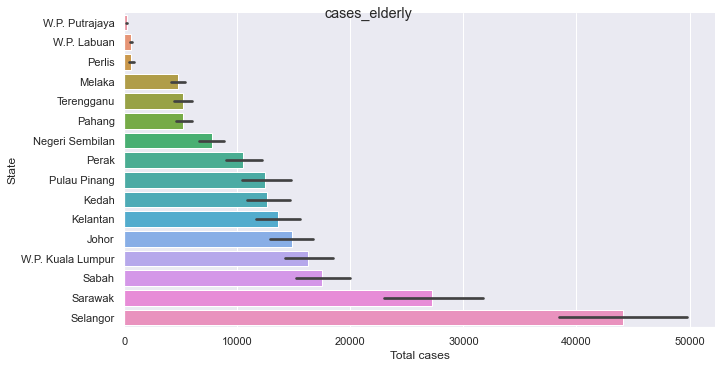

In [43]:
# compute total per state and find index after sorting
for column in coi:
    sorted_index = cases_state_wide[column].sum().sort_values().index
    cases_state_wide[column][sorted_index]
    ax = sns.catplot(kind='bar', data=cases_state_wide[column][sorted_index], 
                 estimator=sum, orient='h', aspect=2.0)
    ax.set_xlabels('Total cases')
    ax.set_ylabels('State')
    ax.fig.suptitle(column)

Throughout each column, we can see that Selangor has the most number of cases for all attirbutes. This goes to show that, Selangor should be the main focus in order to curb the number of cases in Malaysia.

Let us check the histogram and density plot of the attributes for each state. Note that we will be removing the `cases_active` as that column does not tell us the spread of the cases in each categories for each state. First we will be checking the skewness of the attributes.

In [44]:
all_states = cases_state['state'].unique().tolist()
    
for state in all_states:
    print("State:" + state)
    df = cases_state[cases_state['state']==state]
    for column in coi: 
        print("Skewness " + column + ": " + str(df[column].skew()))
    print("=============================================================")

State:Johor
Skewness cases_new: 2.0794837305663036
Skewness cases_import: 13.510124299052485
Skewness cases_recovered: 2.3078737135587444
Skewness cases_cluster: 1.8666720080480455
Skewness cases_pvax: 3.50088148443905
Skewness cases_fvax: 3.362791160654131
Skewness cases_child: 2.3188962516178564
Skewness cases_adolescent: 2.266387655593638
Skewness cases_adult: 2.0537634429948555
Skewness cases_elderly: 2.2232899617844892
State:Kedah
Skewness cases_new: 2.5622634202246655
Skewness cases_import: 6.7655835180746635
Skewness cases_recovered: 2.672764535595424
Skewness cases_cluster: 3.1516187974979593
Skewness cases_pvax: 3.133205082743607
Skewness cases_fvax: 2.797125989488847
Skewness cases_child: 2.6890577615329554
Skewness cases_adolescent: 2.7051935690240168
Skewness cases_adult: 2.5902315098702227
Skewness cases_elderly: 2.29327855095896
State:Kelantan
Skewness cases_new: 2.029887884722686
Skewness cases_import: 6.908318136439468
Skewness cases_recovered: 2.439289031538098
Skewnes

Again as we noticed in `cases_malaysia.csv` the data is heavily skewed to the right, so we will be conducting the square root trasnformation for each attribute in each state

In [45]:
for state in all_states:
    print("State:" + state)
    df = cases_state[cases_state['state']==state]
    for column in coi: 
        sqrt_trans = np.sqrt(df[column])
        print("Skewness " + column + ": " + str(sqrt_trans.skew()))
    print("====================================================")

State:Johor
Skewness cases_new: 0.9710421760869817
Skewness cases_import: 3.0335340595447375
Skewness cases_recovered: 1.1701448364224663
Skewness cases_cluster: 0.6454447647233896
Skewness cases_pvax: 2.581304100213966
Skewness cases_fvax: 2.6502591134496813
Skewness cases_child: 1.3715772653880876
Skewness cases_adolescent: 1.3236905650906403
Skewness cases_adult: 0.9279862290429336
Skewness cases_elderly: 1.0917332954653058
State:Kedah
Skewness cases_new: 1.571857375208444
Skewness cases_import: 5.004291941066794
Skewness cases_recovered: 1.694025379885245
Skewness cases_cluster: 1.1765094564240741
Skewness cases_pvax: 2.3769248580996933
Skewness cases_fvax: 2.2343285472950107
Skewness cases_child: 1.7865363575430737
Skewness cases_adolescent: 1.7191631237536409
Skewness cases_adult: 1.54554165971203
Skewness cases_elderly: 1.335961212326407
State:Kelantan
Skewness cases_new: 1.2738383731932839
Skewness cases_import: 5.868459764899713
Skewness cases_recovered: 1.4667079431975192
Ske

Even after conducting a square root transformation for the attributes, we are only seeing a heavily skewed case number for each attribute. It goes to show the influence of outliers in each state. And the best way possible to picture this is by using boxplots. Notice that, we will be scaling the graphs logarithmacally on the x-axis, as this is a method in order to respond to skewness towards large values, which is the case we have seen in the value of skewness above

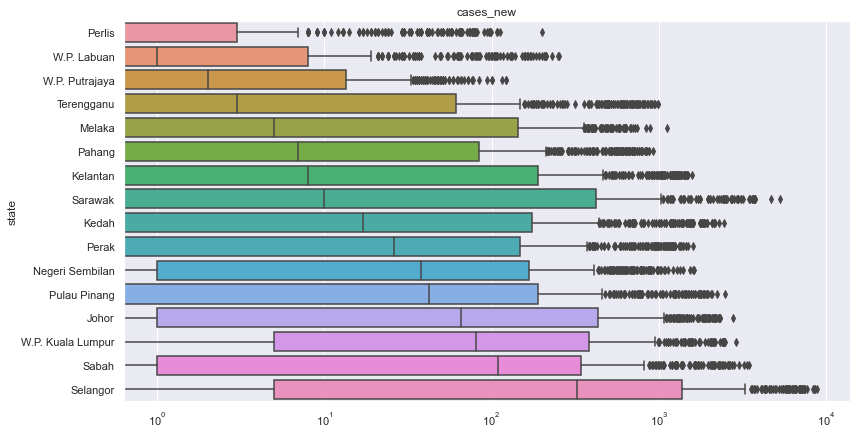

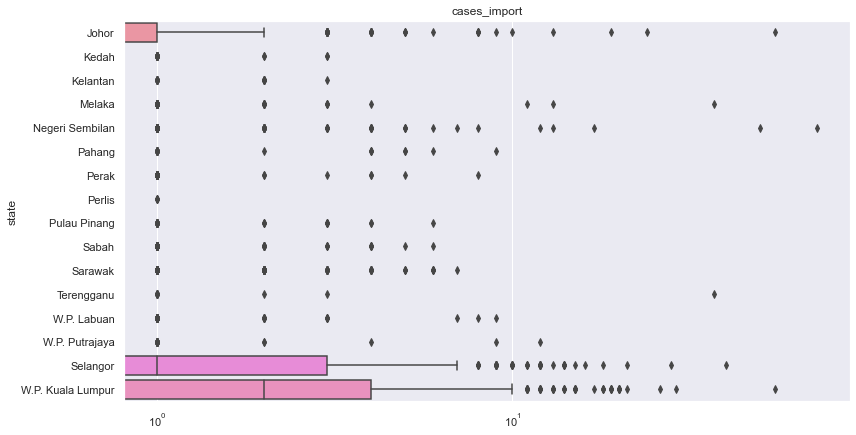

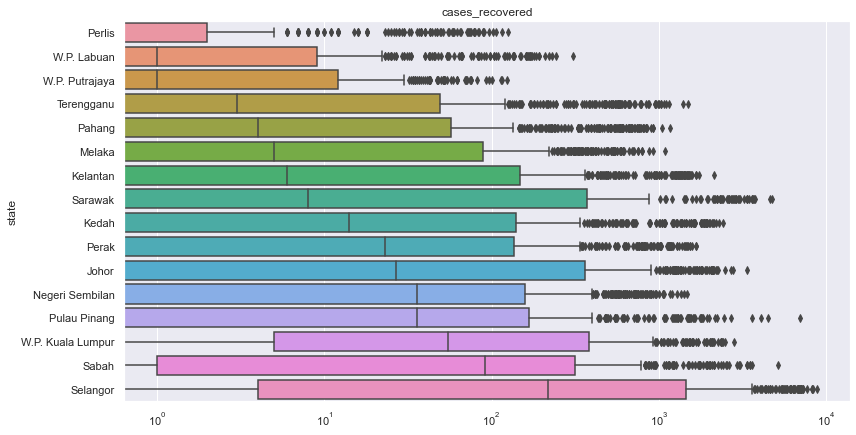

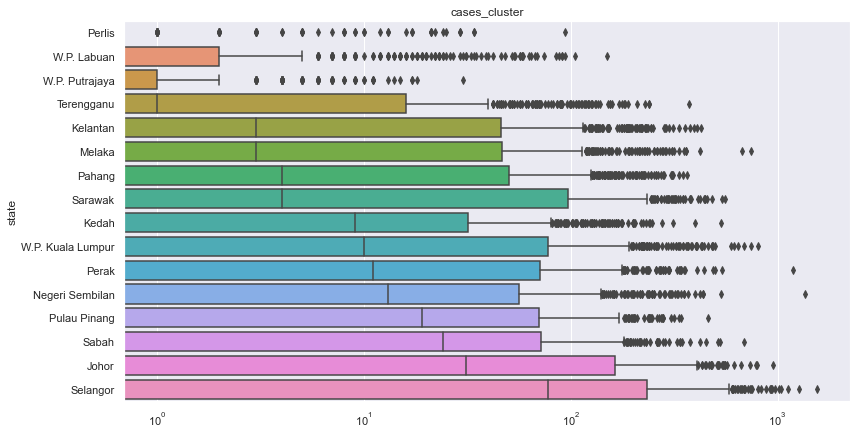

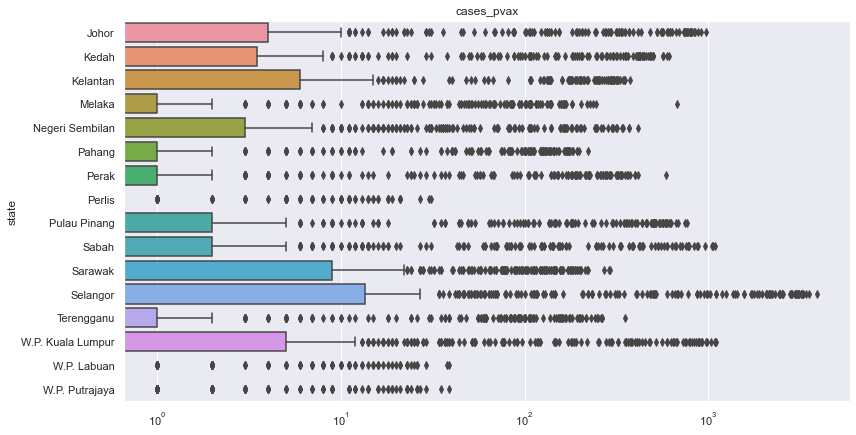

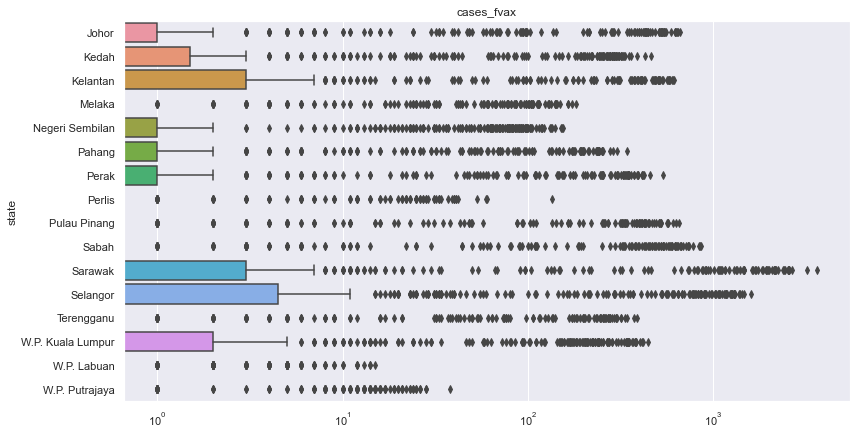

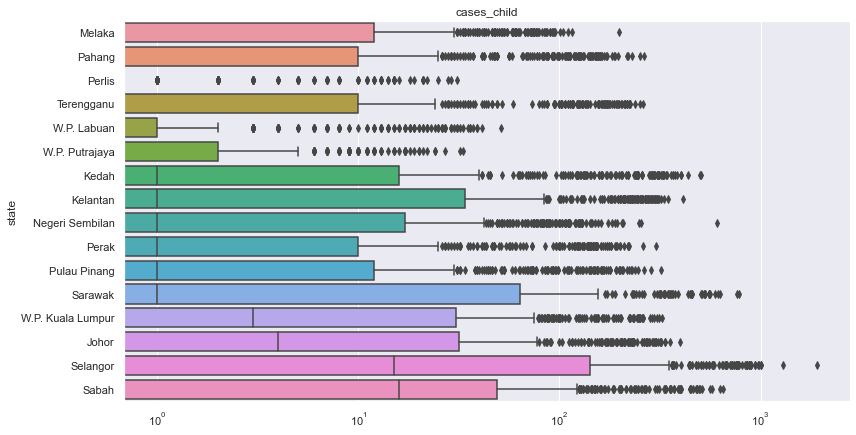

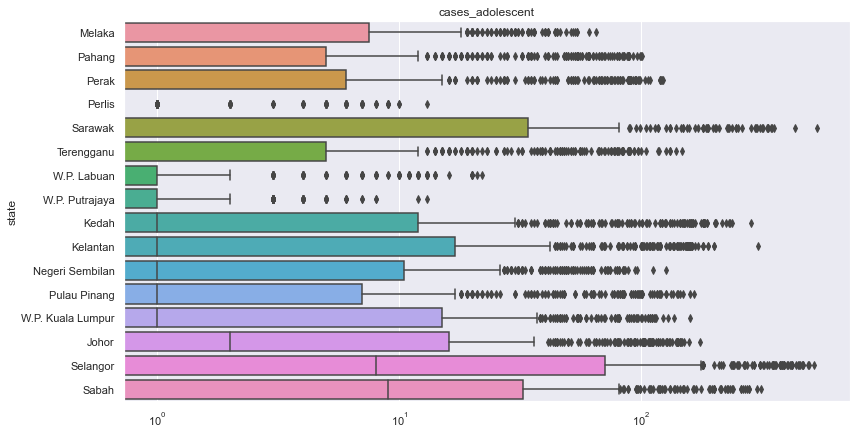

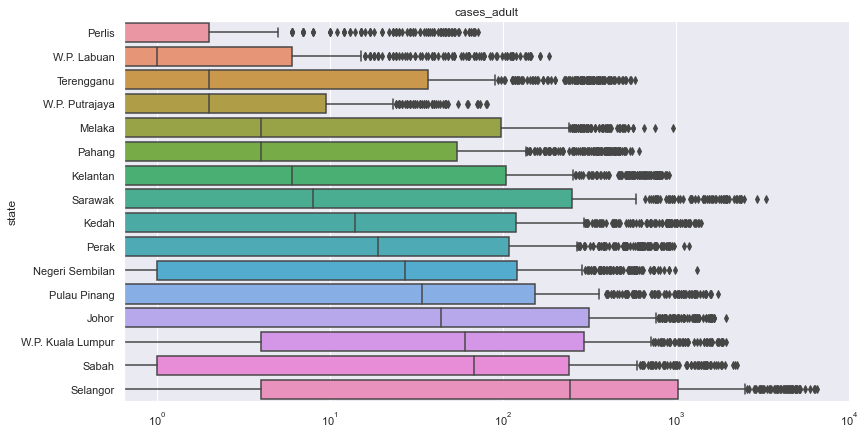

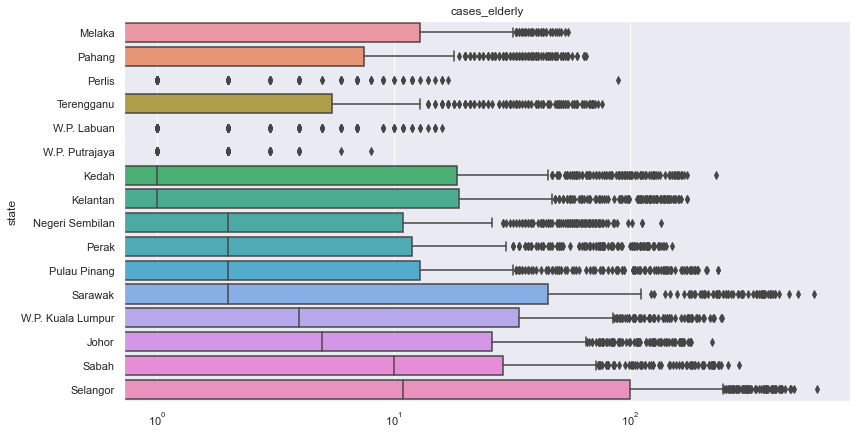

In [46]:
for column in coi:
    sorted_index = cases_state_wide[column].median().sort_values().index
    cases_state_wide[column][sorted_index]
    plt.figure(figsize=(13,7))
    g = sns.boxplot(data=cases_state_wide[column][sorted_index], orient='h', dodge=False)
    g.set_xscale("log")
    g.set_title(column)
    

We are now able to identify the median values for each state and the respective attribute more easily. However we will still be noticing many outliers in each state, which points to the fact that the cases in each attribute for each state are still exceedingly high.

Since we are doing a time series analysis, we will also be adding the lagging and rolling average features for each state, specifically for the `cases_new`, `cases_import`, and `cases_recovered`.

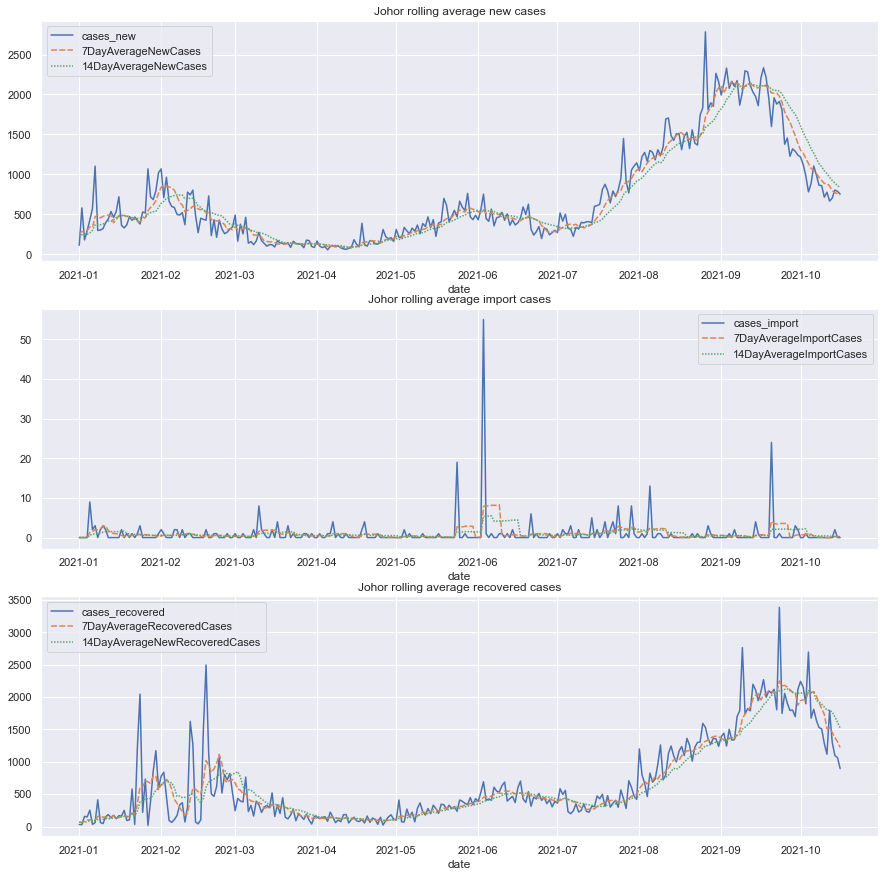

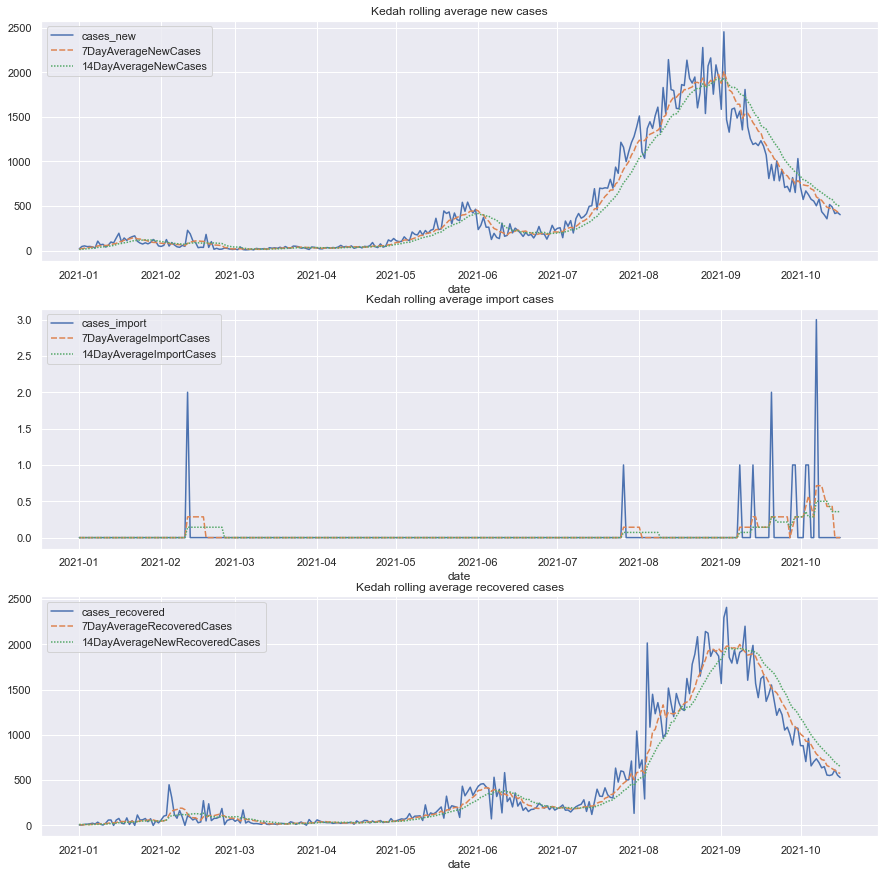

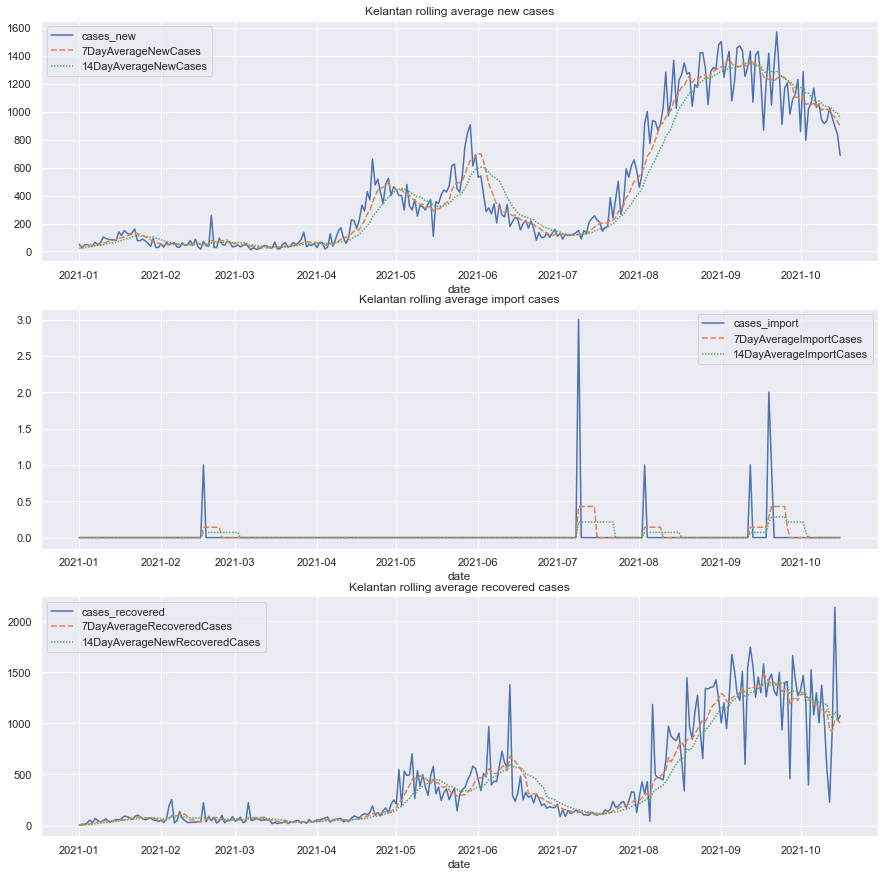

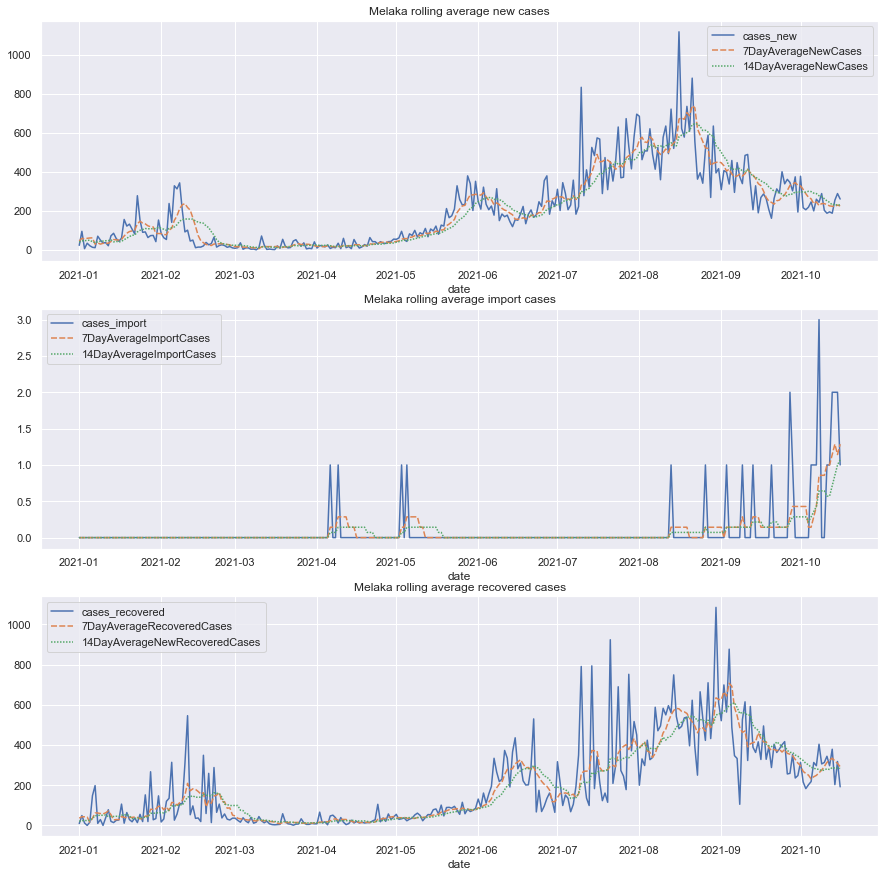

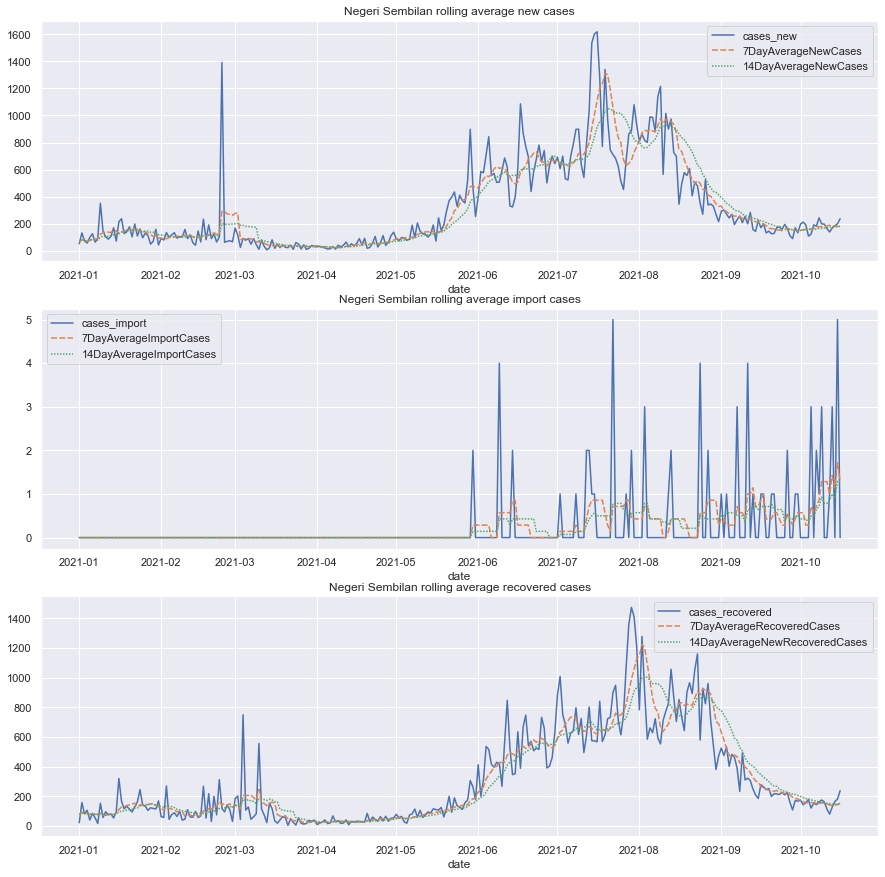

...

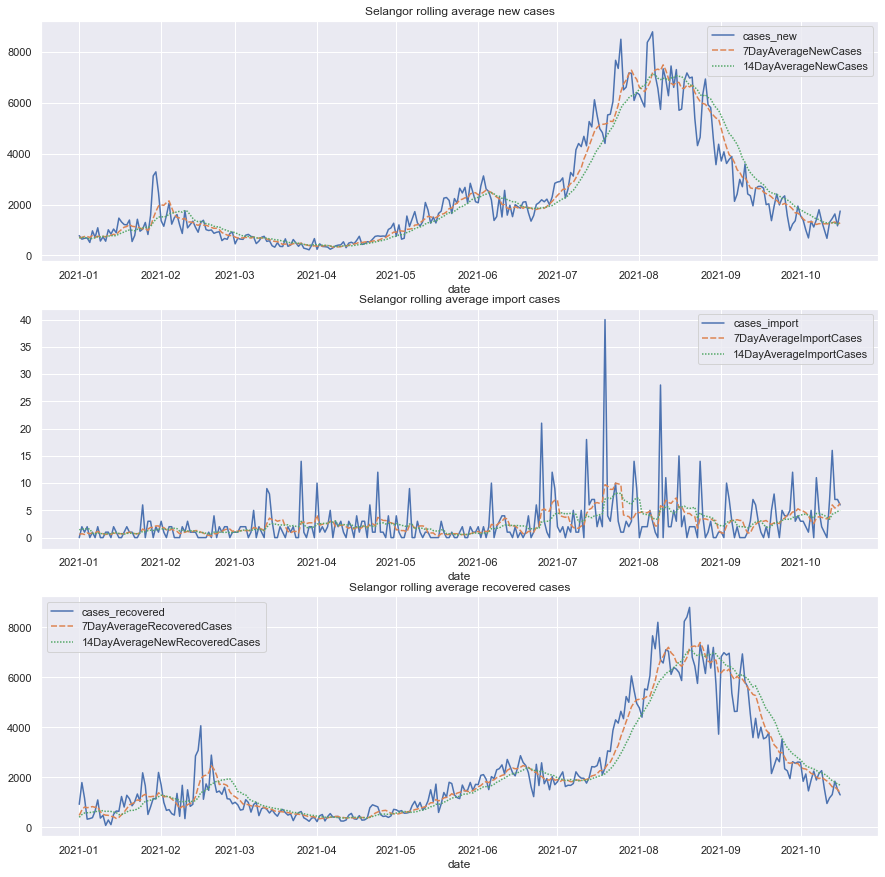

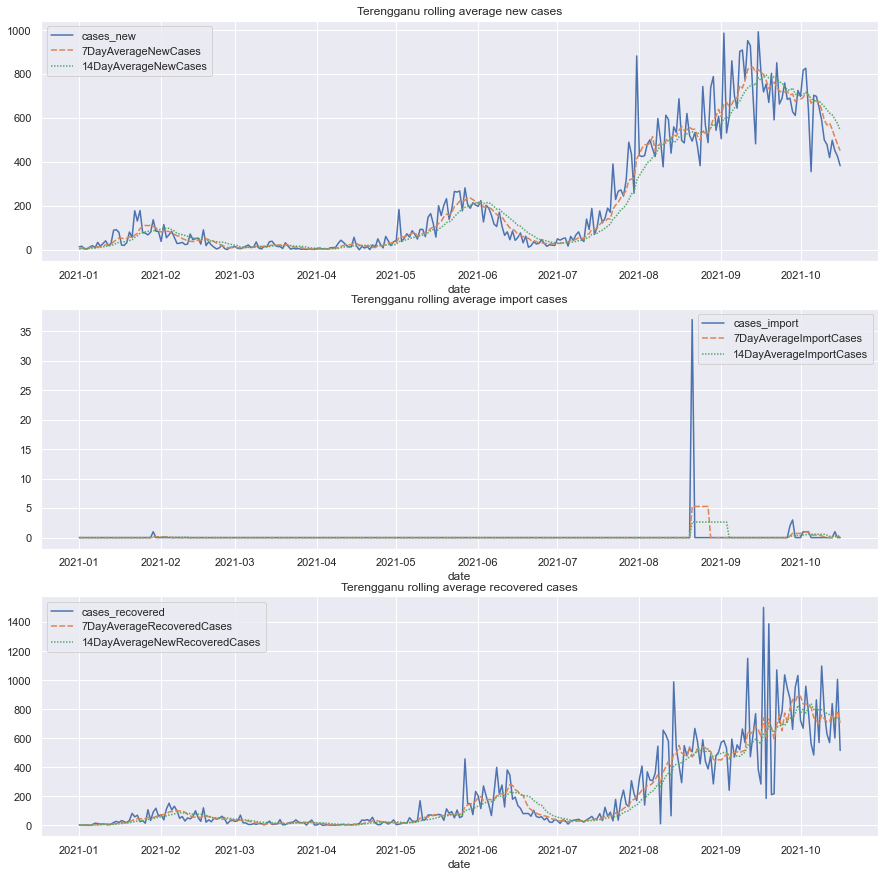

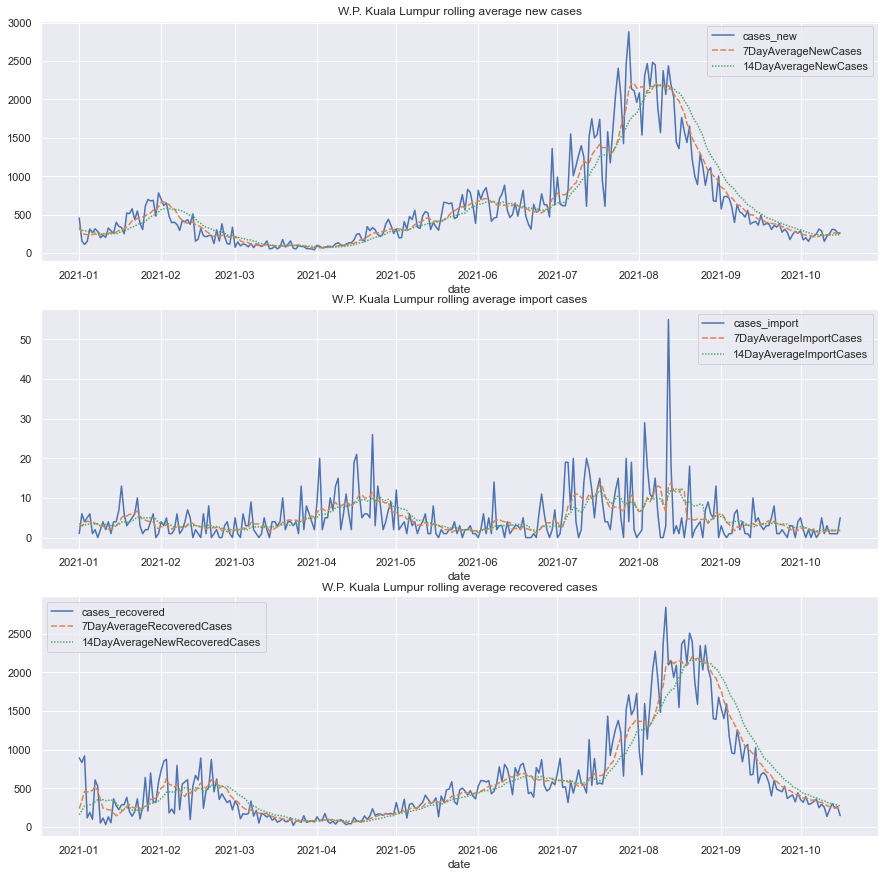

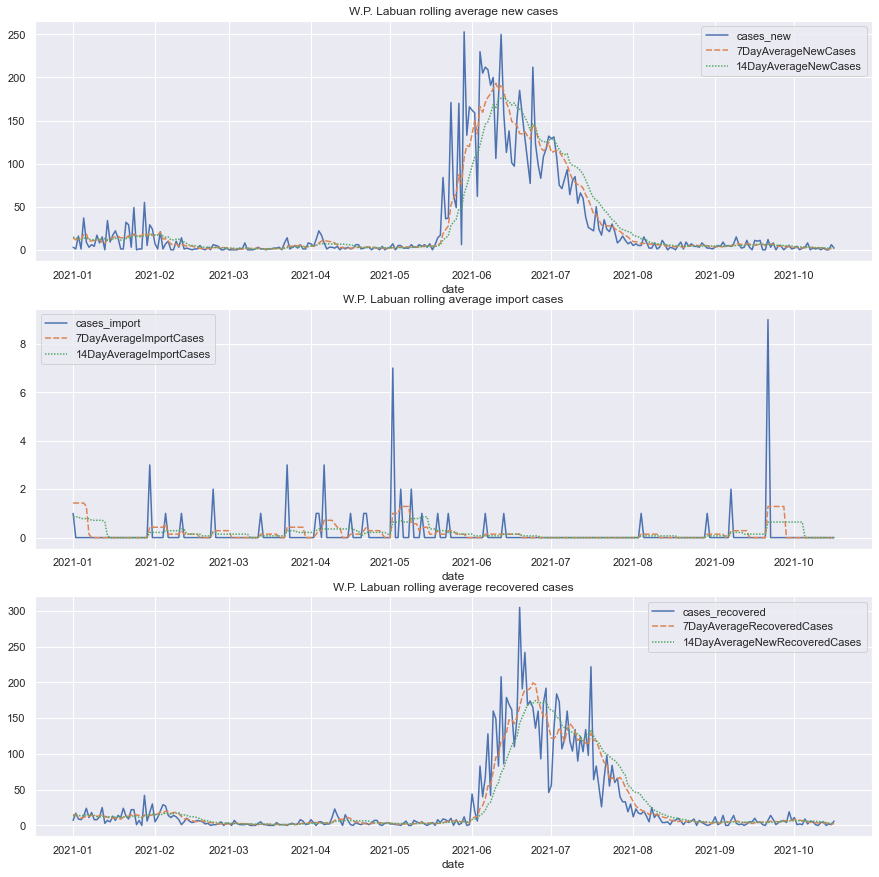

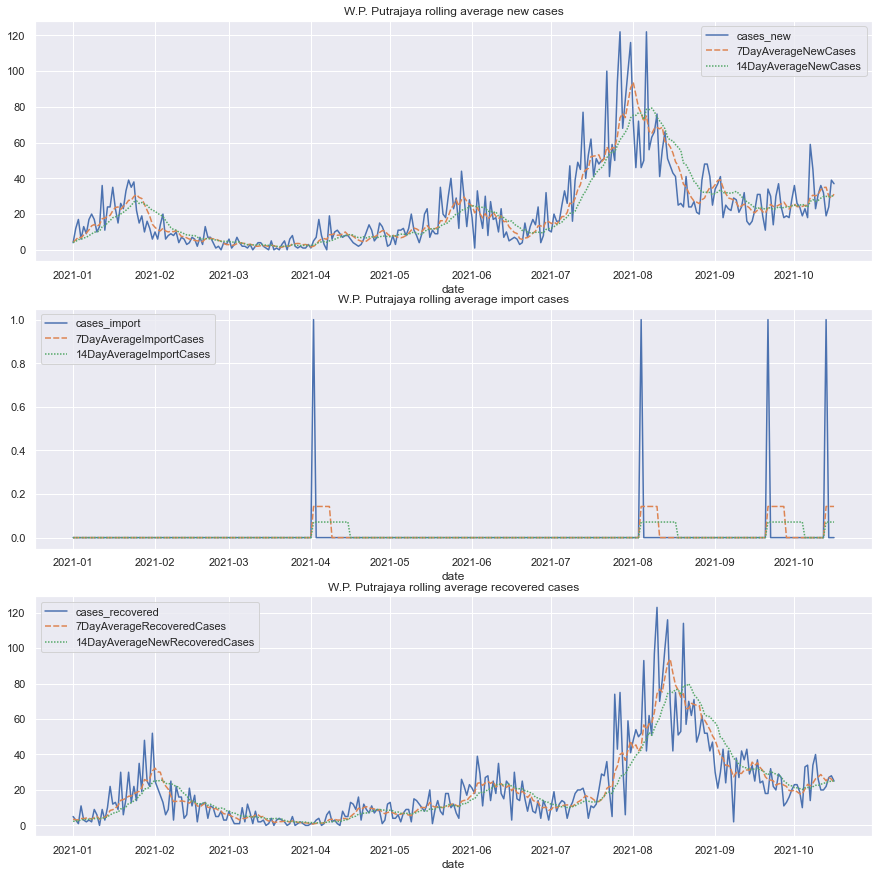

In [47]:
# we create lagging and rolling average feature for each state. 

states = ['Johor', 'Kedah', 'Kelantan', 'Melaka', 'Negeri Sembilan', 'Pahang', 'Perak', 'Perlis', 'Pulau Pinang', 'Sabah', 'Sarawak', 'Selangor', 'Terengganu', 'W.P. Kuala Lumpur', 'W.P. Labuan', 'W.P. Putrajaya']

state_featurized = {state: cases_engineer(cases_state, state, show_plot=True) for state in states} 


## clusters.csv

In this dataset, the `category` column is reflected within our `cases_malaysia.csv` dataset: the number of cases in this category would increase the number of `cases_cluster` column in `cases_malaysia.csv`. Looking at the columns, we can conduct some analysis.

The nature of the cluster dataset is that, values are constantly updated: `cases_active` will eventuall decrease over time as more people recover or die from Covid-19. `icu` number will also decrease as well, as more people recover from the ICU. Due to this, we will only be looking at the number where the columns act as a record for a cluster. In this case, those columns are `cases_total`, `tests`, `recovered`, and `deaths`.

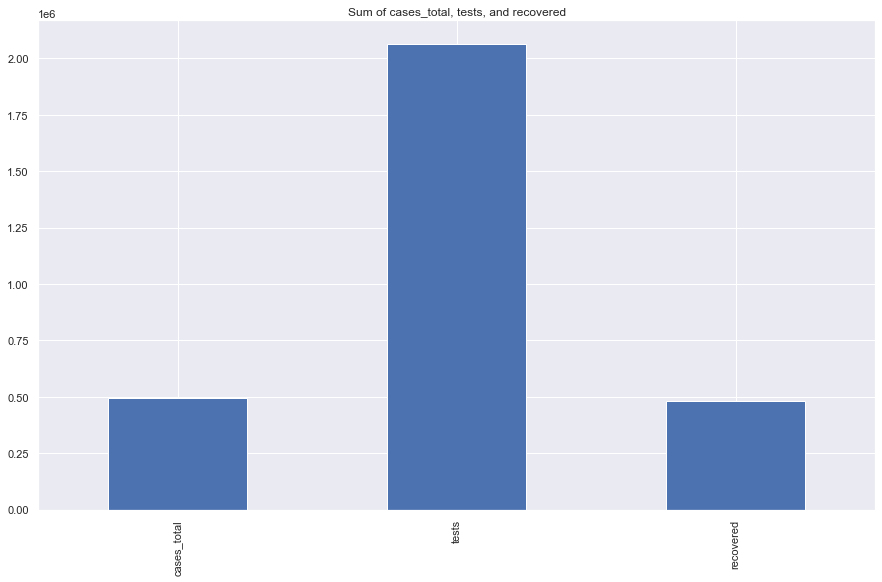

cases_total     495445
tests          2065145
recovered       482084
dtype: int64


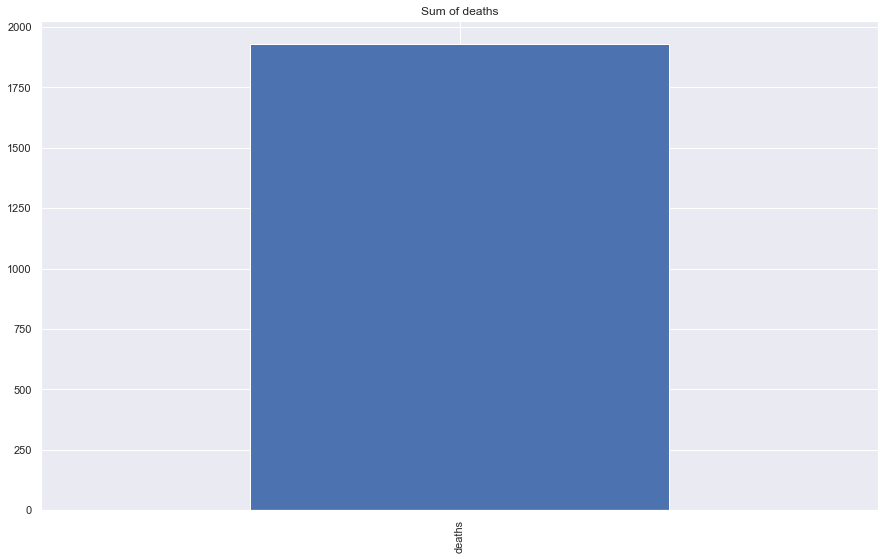

deaths    1928
dtype: int64


In [48]:
test1 = clusters.copy()
test1.drop(['cluster', 'state', 'district', 'date_announced', 'date_last_onset', 'category', 'status', 'cases_new', 'cases_active', 'icu', 'deaths'], axis='columns', inplace=True)

cluster_sum_series = test1.sum(axis = 0, skipna = True)
cluster_sum_series.plot.bar()
plt.title('Sum of cases_total, tests, and recovered')
plt.show()
print(cluster_sum_series)

test1 = clusters.copy()
test1.drop(['cluster', 'state', 'district', 'date_announced', 'date_last_onset', 'category', 'status', 'cases_new', 'cases_active', 'cases_total', 'tests', 'recovered', 'icu' ], axis='columns', inplace=True)

cluster_sum_series = test1.sum(axis = 0, skipna = True)
cluster_sum_series.plot.bar()
plt.title('Sum of deaths')
plt.show()
print(cluster_sum_series)

From the above summation, we can see that an enourmous amount of tests is conducted among all clusters. This is done so that cases within any cluster can be tracked, thereby helping to track the cases and and subsequently calculate a cluster's current positivity rate. We also see that, in total, there are 495445 cases that can be traced back to clusters in Malaysia. And from these clusters, we are also able to track how many people have recovered from these clusters.

## deaths_malaysia.csv

Let us conduct som EDA on the `deaths_malaysia.csv` dataset. Initial observation shows that, the dataset specifies the differences between `deaths_new`,`deaths_bid` and `deaths_new_dod`,`deaths_bid_dod`: the former being the number that was reported to the public, and the latter which was based on the date of death. 

Based on the Covid-19 dataset, it is also noted that, the `deaths_bid` and `deaths_bid_dod` are a perfect subset of `deaths_new` and `deaths_bid` as well. The same also goes to `deaths_bid_dod`, `deaths_pvax` and `deaths_fvax`, where they are the perfect subset of the `deaths_new_dod`. Hence it will be interesting to compare between these groups specifically. 

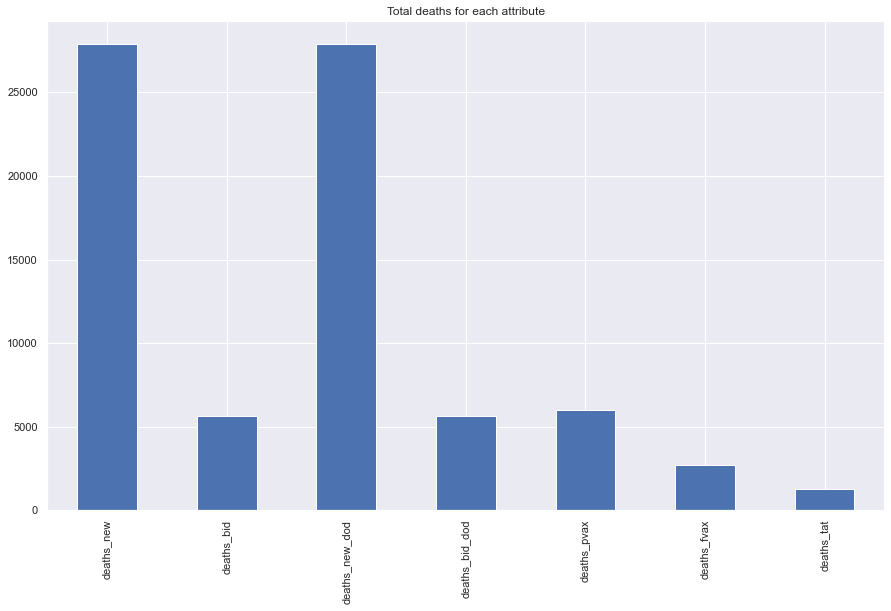

In [49]:
test1 = deaths_malaysia.copy()
test1.drop('date', axis='columns', inplace=True)

deaths_sum_series = test1.sum(axis = 0, skipna = True)
deaths_sum_series.plot.bar()
plt.title('Total deaths for each attribute')
plt.show()

Based on the above bar chart, we can see that, between `deaths_new` and `deaths_bid`, about 20% of the deaths that are reported to the public are brought-in-dead. The same trend is seen in the group for `deahts_dod`, `deaths_bid_dod`, `deaths_pvax` and `deaths_fvax`. This issue is worrisome as it shows that, many patients were unable to receive the treatment necessary and were too late to receive the treatment in medicial facilities in Malaysia. 

Now let us proceed with conducting some outlier analysis on this dataset. We will start by identifying the skewness of these attributes. 

In [50]:
coi = deaths_malaysia.columns.tolist()
coi.pop(0)

for column in coi: 
    print("Skewness " + column + ": " + str(deaths_malaysia[column].skew()))

Skewness deaths_new: 2.4878427827452256
Skewness deaths_bid: 3.4275140681808858
Skewness deaths_new_dod: 2.0005558881001364
Skewness deaths_bid_dod: 2.4536610659520344
Skewness deaths_pvax: 2.6342416678452842
Skewness deaths_fvax: 2.5700504789965652
Skewness deaths_tat: 5.51842386324942


Once again, we see that, these attributes are highly skewed to the right. Hence we will need to conduct transformation once again. 

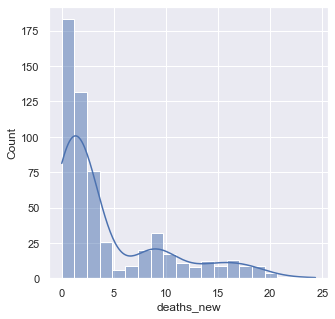

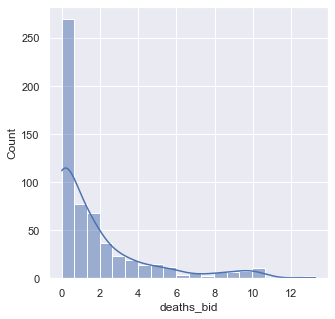

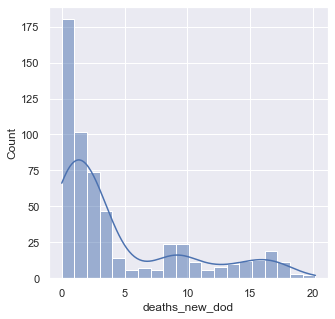

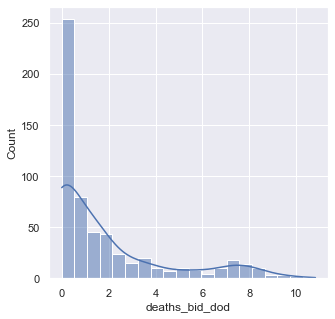

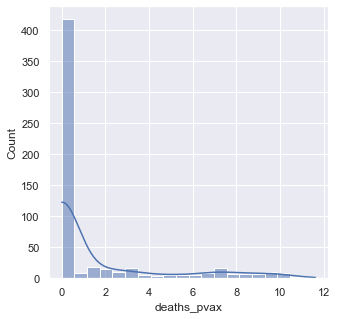

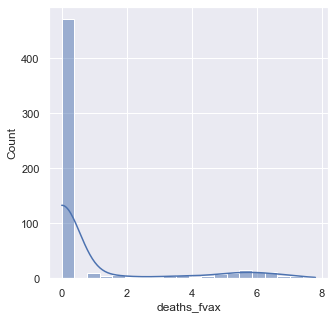

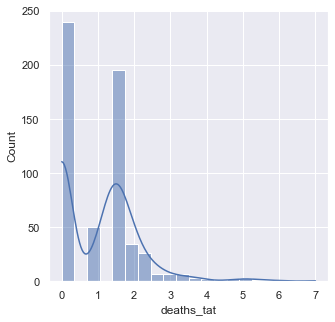

In [51]:
for column in coi: 
    fig, ax = plt.subplots(figsize=(5,5))
    sqrt_trans = np.sqrt(deaths_malaysia[column])
    sns.histplot(ax=ax, data=sqrt_trans, kde=True, bins=20)
    plt.show()

Let us visualise the dataset using the 3-month interval for the boxplots for the attributes here. 

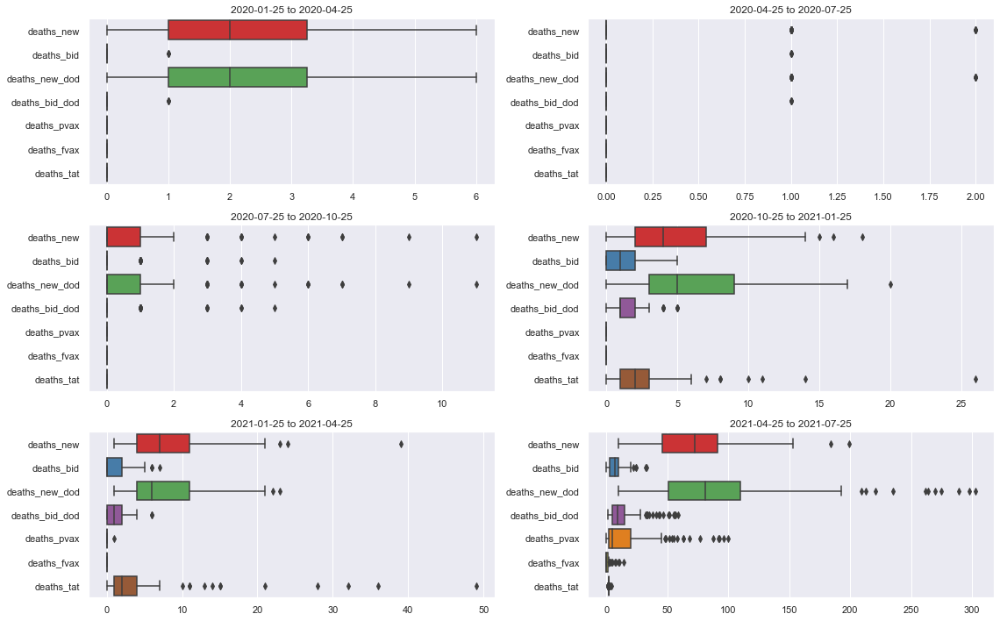

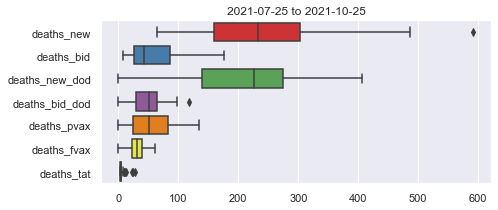

In [52]:
deaths_malaysia.set_index('date', inplace=True)
n_plots = len(intervals_boundries) - 1

fig, axes = plt.subplots(ncols=2, nrows=n_plots//2, figsize=(16,10))

for i, ax in zip(range(len(intervals_boundries)), axes.flat):
    ax.set_title(intervals_boundries[i].strftime('%Y-%m-%d') + ' to ' + intervals_boundries[i+1].strftime('%Y-%m-%d'))
    df = deaths_malaysia.loc[intervals_boundries[i]:intervals_boundries[i+1],coi]
    sns.boxplot(data=df, orient='h', palette='Set1', ax=ax)
fig.tight_layout()

fig, ax = plt.subplots(figsize=(7,3))
ax.set_title(intervals_boundries[-2].strftime('%Y-%m-%d') + ' to ' + intervals_boundries[-1].strftime('%Y-%m-%d'))
df = deaths_malaysia.loc[intervals_boundries[-2]:intervals_boundries[-1],coi]
sns.boxplot(ax=ax, data=df, orient='h', palette='Set1')
plt.show()

From this outlier analysis, we can see that in the early months of Malaysia's Covid-19 pandemic, we had very low numbers of deaths attributed to Covid-19. However, at the beginning of 2020-10-25, the number of deaths began to spike upwards, and very quickly, our median deaths increased to about 200-250 deaths in the 3-months between 2021-07-25 to 2021-10-25. 

Let us see how the attributes are correlated to each other using a correlation plot.

<AxesSubplot:>

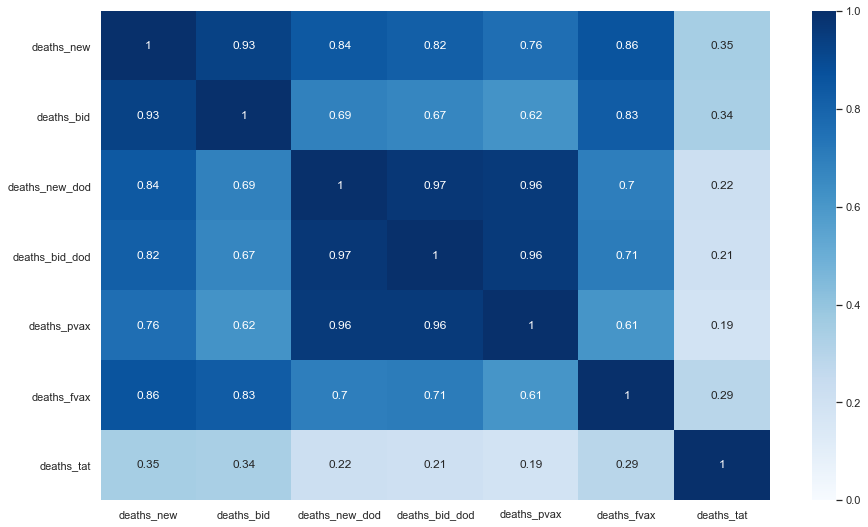

In [53]:
sns.set(rc={'figure.figsize':(15,9)})
sns.heatmap(deaths_malaysia[1:-1].corr().round(2), cmap='Blues', annot=True, vmin=0, vmax=1)

Let us view the relational plot between the between the columns in `deaths_malaysia.csv`

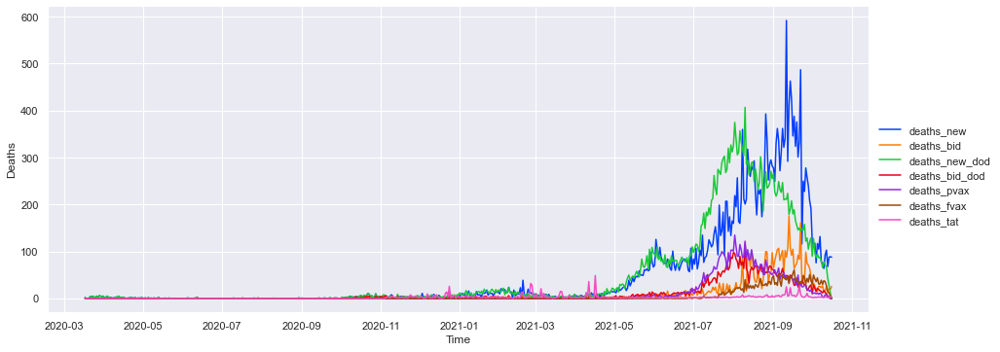

In [54]:
ax = sns.relplot(data=deaths_malaysia.loc[:,coi], kind='line',
            aspect=2.5, dashes=False, palette='bright')
ax.set_xlabels('Time')
ax.set_ylabels('Deaths')

The above relational plot shows that, deaths were not prevalent early on in the pandemic. However, as we entered the mid-2021, the number of deaths began to exceed 100, as we lost more lives to the pandemic. And finally at this current moment, the deaths have begun to fall lower and lower. 

## deaths_state.csv

Similar to `deaths_malaysia.csv`, but this time, we can have a glimpse into each state's deaths. We will start by having a look at the bar plot for each state.

C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


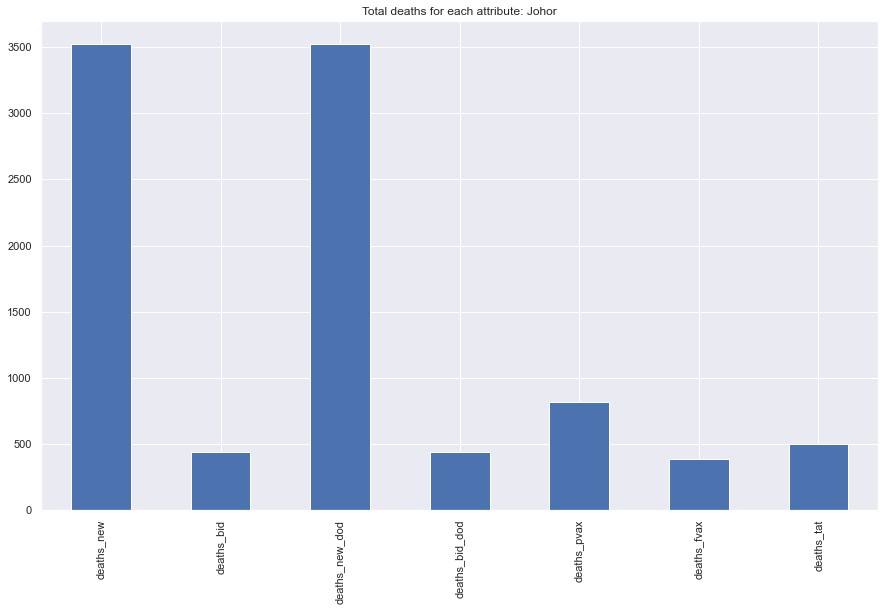

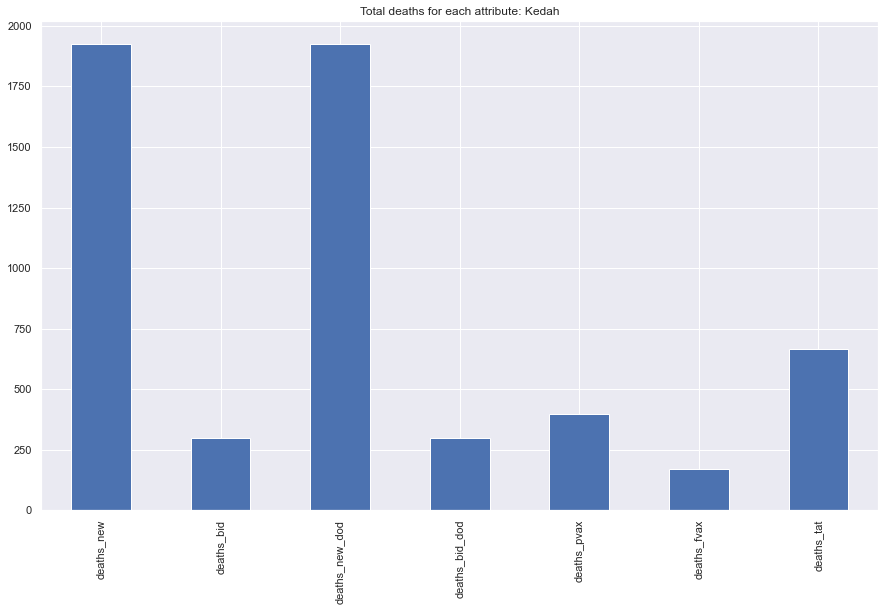

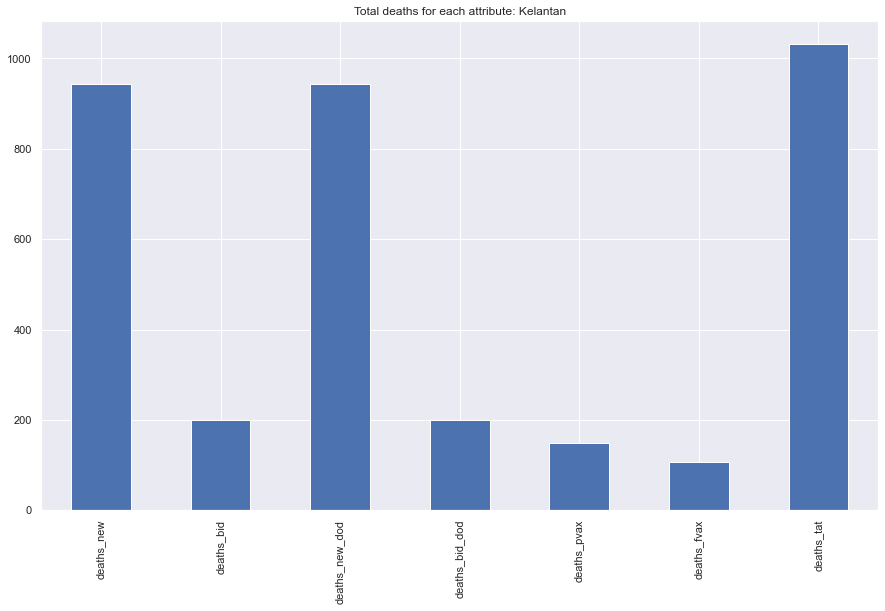

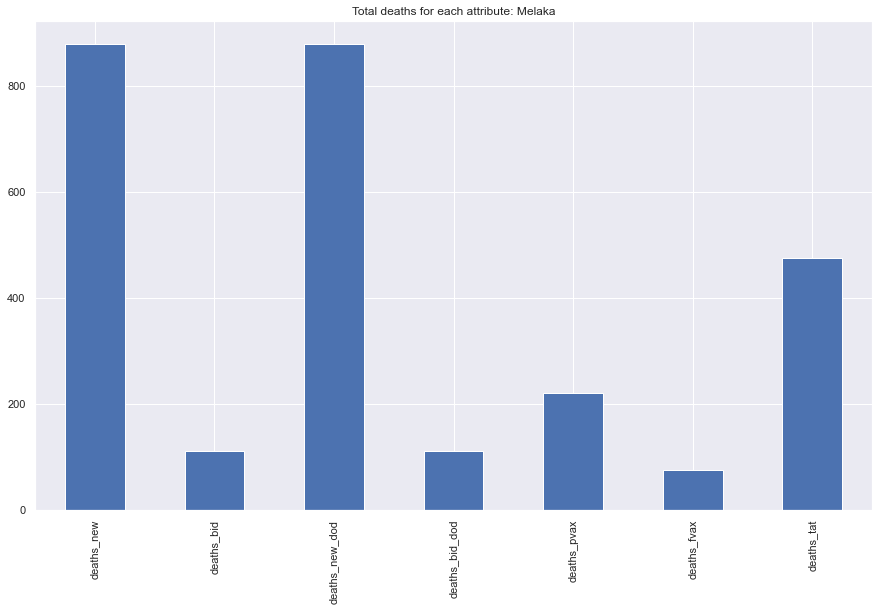

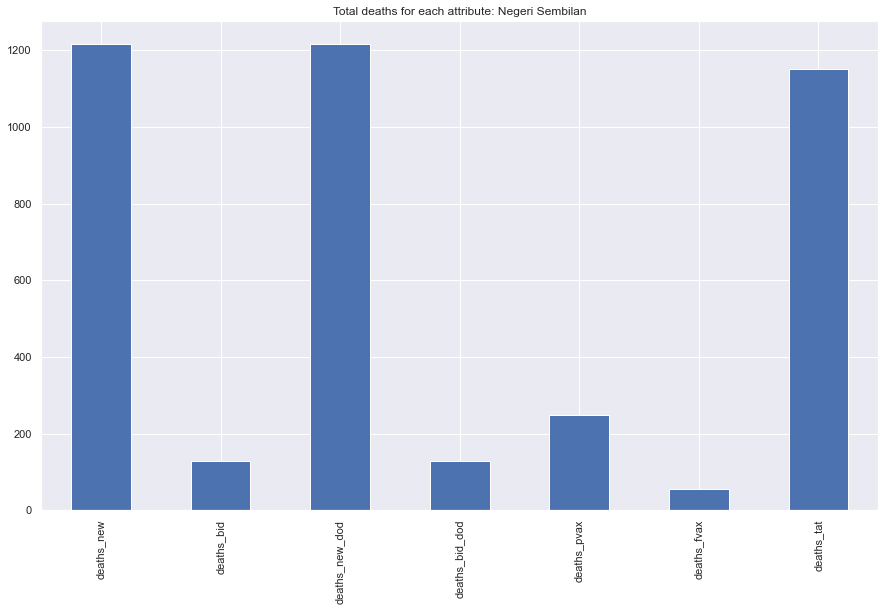

...

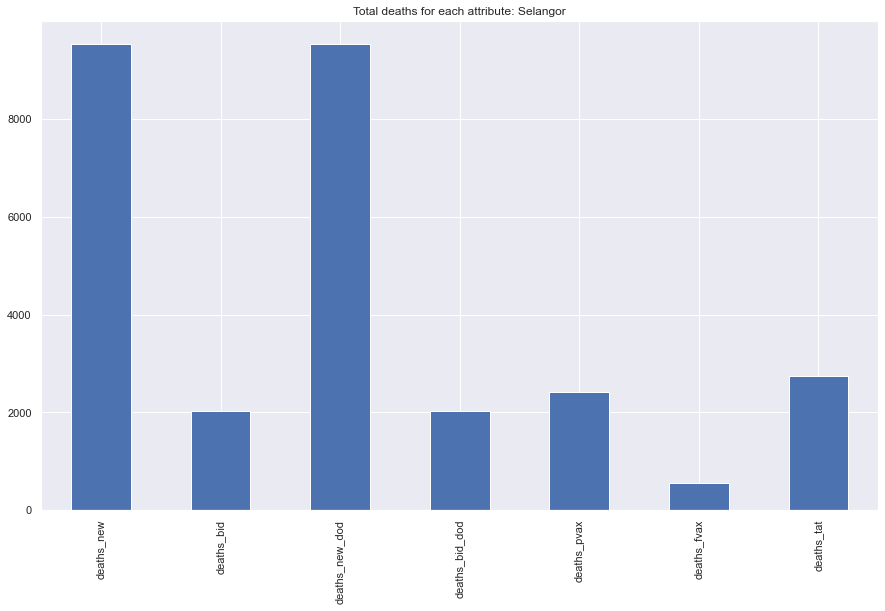

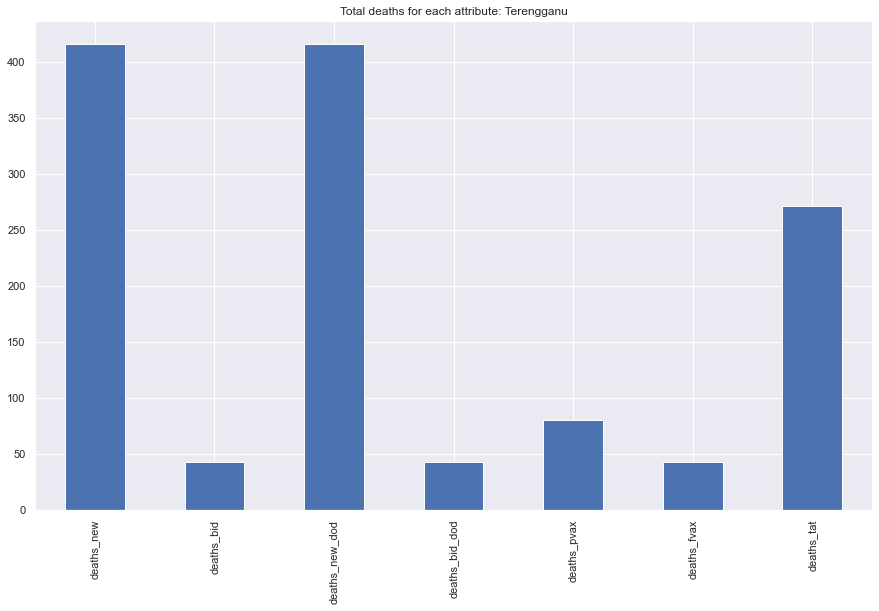

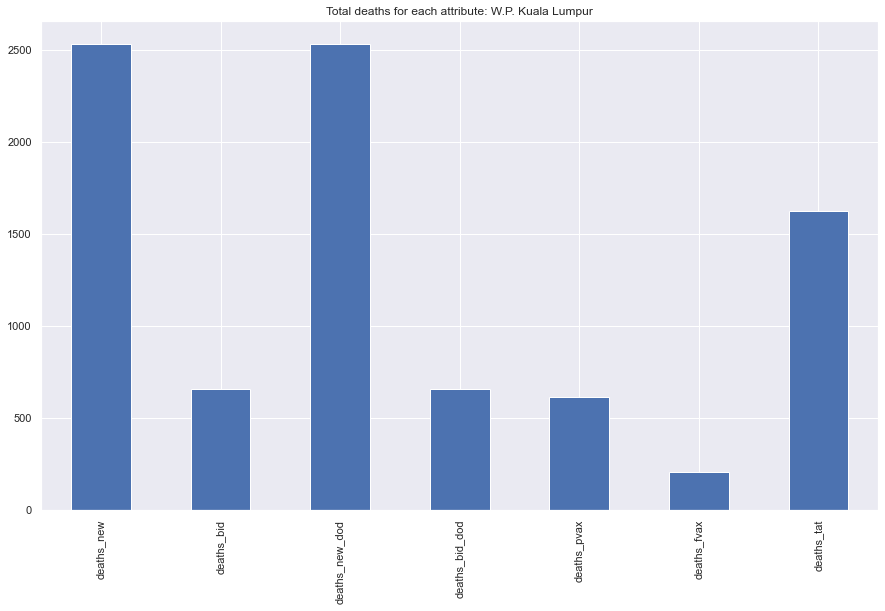

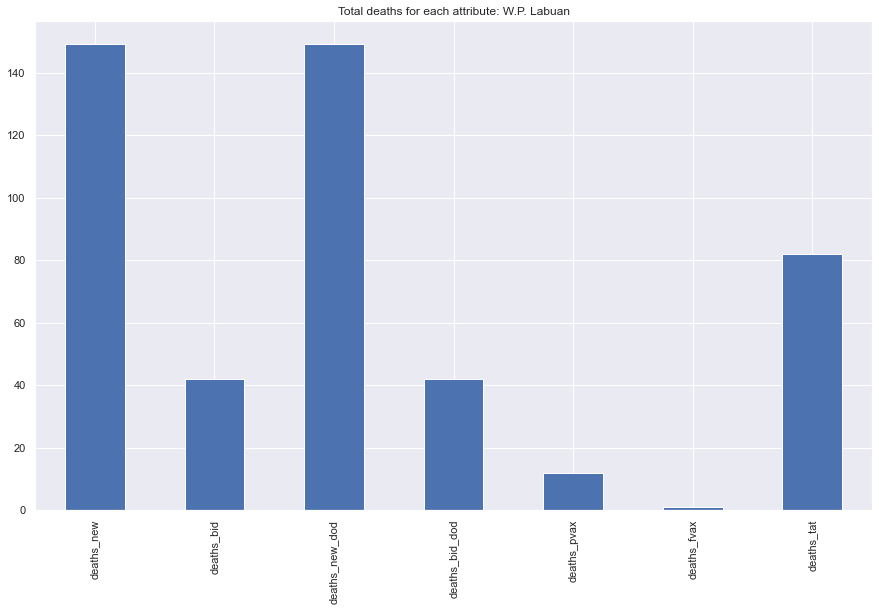

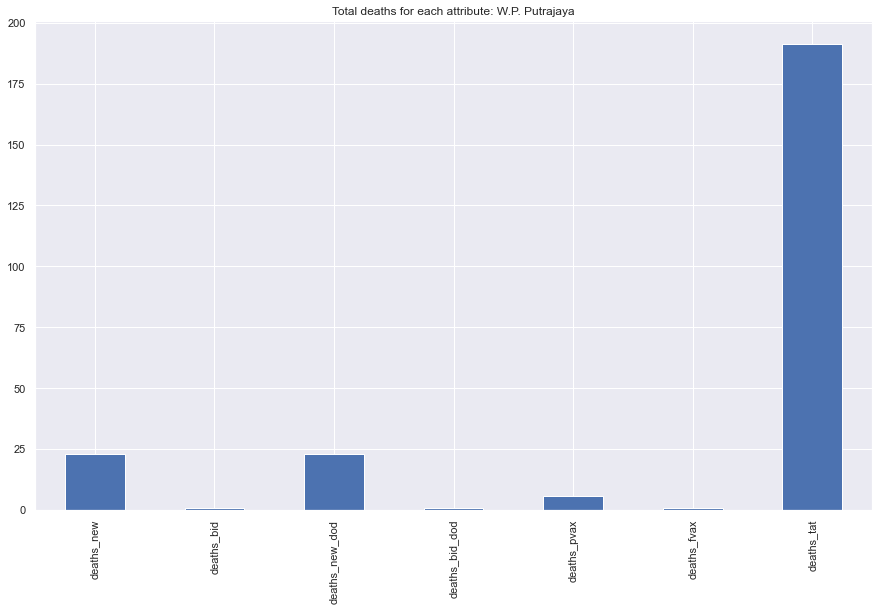

In [55]:
test1 = deaths_state.copy()
test1.drop('date', axis='columns', inplace=True)
all_states = tests_state['state'].unique().tolist()

for state in all_states:
    df = test1[test1['state']==state]
    df.drop('state', axis='columns', inplace=True)
    deaths_sum_series = df.sum(axis = 0, skipna = True)
    deaths_sum_series.plot.bar()
    plt.title('Total deaths for each attribute: ' + state)
    plt.show()

As we look at the above bar plots, we can see that Selangor tops all other states, as it has the highest number of deaths. 

Let us proceed to check the skewness of the data in each state. We will be conducting square root transform for each of the attributes as well.

In [56]:
test1 = deaths_state.copy()
test1.drop('date', axis='columns', inplace=True)

for state in all_states:
    print("State:" + state)
    df = test1[test1['state']==state]
    for column in coi: 
        sqrt_trans = np.sqrt(df[column])
        print("Skewness " + column + ": " + str(sqrt_trans.skew()))
    print("====================================================")

State:Johor
Skewness deaths_new: 1.5970930662437506
Skewness deaths_bid: 2.5329464891750844
Skewness deaths_new_dod: 1.5071807844564542
Skewness deaths_bid_dod: 2.23328679139888
Skewness deaths_pvax: 2.1805925194923774
Skewness deaths_fvax: 2.6027049405161344
Skewness deaths_tat: 1.586522752042477
State:Kedah
Skewness deaths_new: 2.277972627354993
Skewness deaths_bid: 6.513322611286189
Skewness deaths_new_dod: 1.677006069947179
Skewness deaths_bid_dod: 2.461190214434411
Skewness deaths_pvax: 2.3242269813395047
Skewness deaths_fvax: 2.8768434951999593
Skewness deaths_tat: 2.756985043712488
State:Kelantan
Skewness deaths_new: 1.826568038108381
Skewness deaths_bid: 3.1151459589928865
Skewness deaths_new_dod: 1.4385139706464505
Skewness deaths_bid_dod: 2.104015491065094
Skewness deaths_pvax: 2.4926713238916807
Skewness deaths_fvax: 3.3029245331287664
Skewness deaths_tat: 2.3546796026437105
State:Melaka
Skewness deaths_new: 1.7760628537686884
Skewness deaths_bid: 2.8781317720994815
Skewness

Similar to `cases_state.csv` the data is still very much skewed even after conducting a transformation for the attributes. 

To check for outliers, we will be using boxplots for each attribute. 

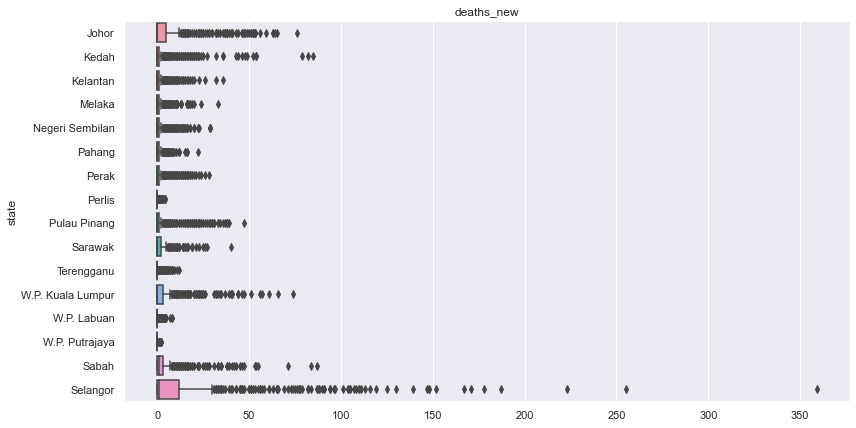

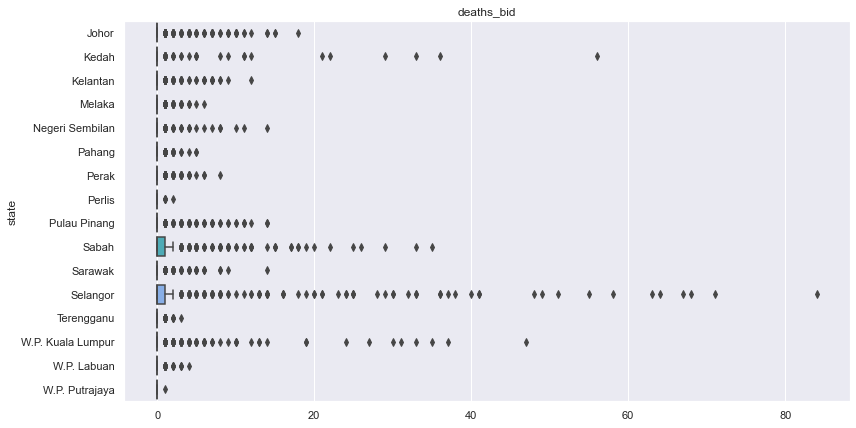

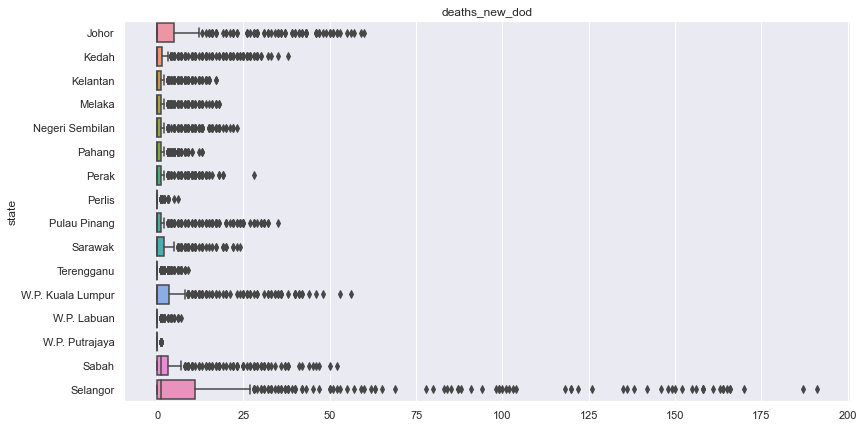

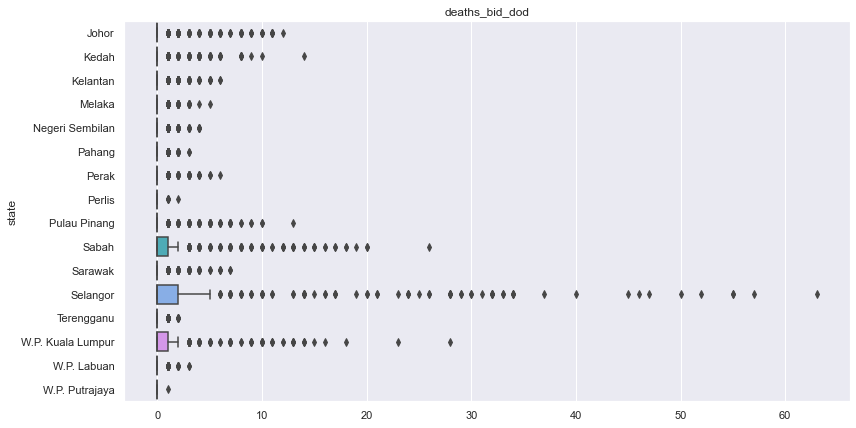

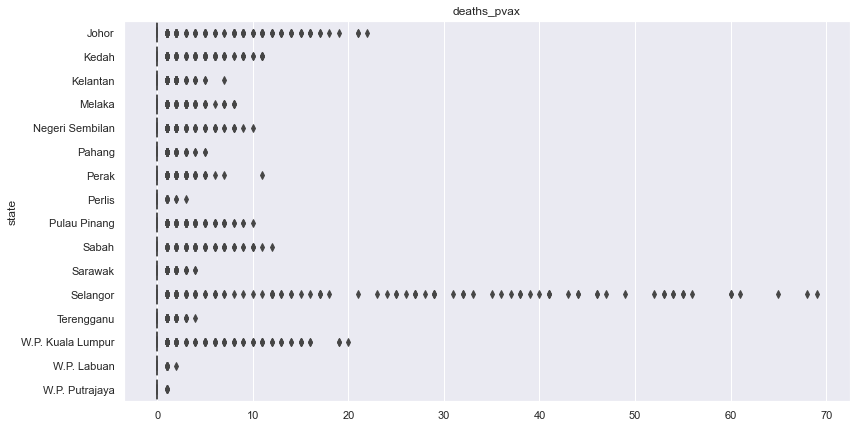

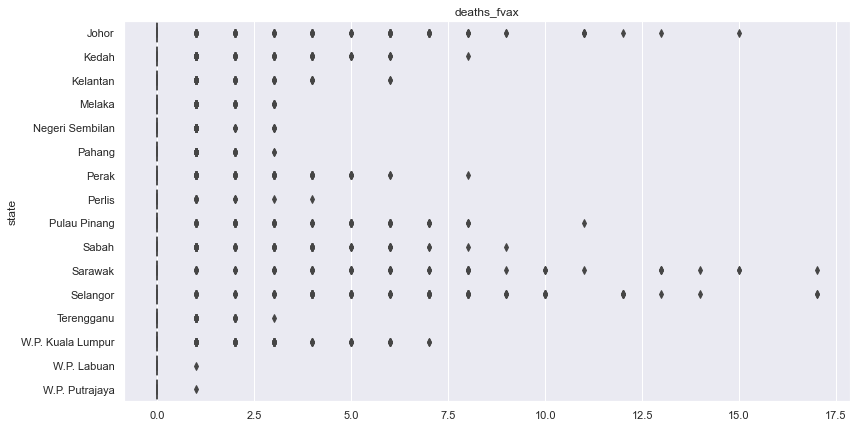

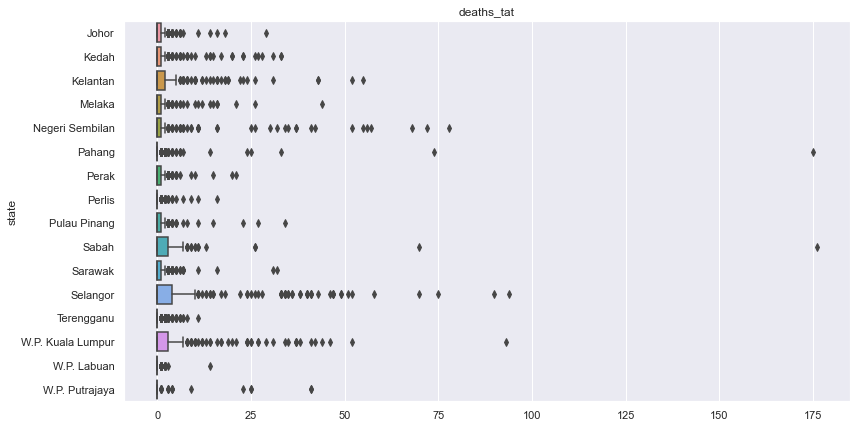

In [57]:
deaths_state_wide = deaths_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['deaths_new', 'deaths_bid', 'deaths_new_dod', 'deaths_bid_dod', 'deaths_pvax', 'deaths_fvax', 'deaths_tat']
                                          )

for column in coi:
    sorted_index = deaths_state_wide[column].median().sort_values().index
    deaths_state_wide[column][sorted_index]
    plt.figure(figsize=(13,7))
    g = sns.boxplot(data=deaths_state_wide[column][sorted_index], orient='h', dodge=False)
    g.set_title(column)

The median values can now be visualised. With the exception of `deaths_bid`, `deaths_bid_dod`, `deaths_pvax`, and `deaths_fvax`, we do not see any boxes, but a lot of outliers instead, which do not provide much insight to the main 50% group of data points. Hence, we will look at the remaining attributes, which are: `deaths_new`, `deaths_new_dod`, `deaths_tat`. In order to visualise them more easily, we will scale them logarithmacally. 

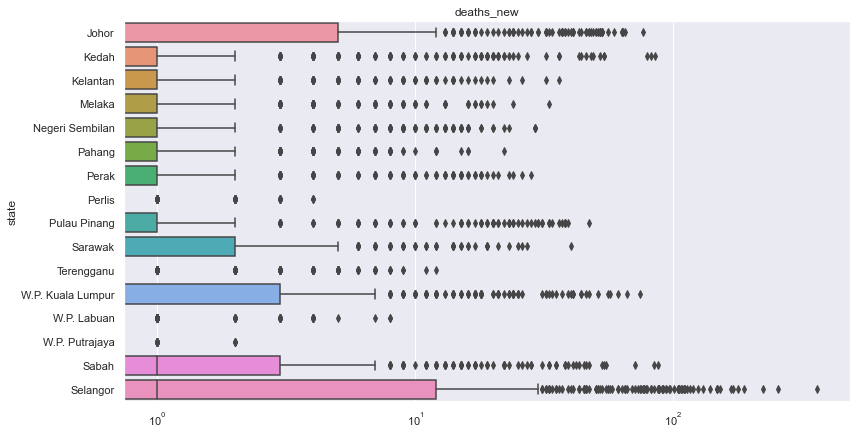

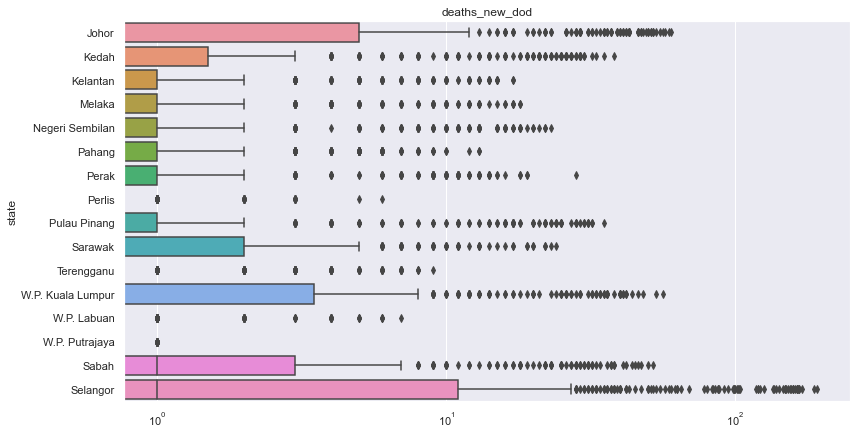

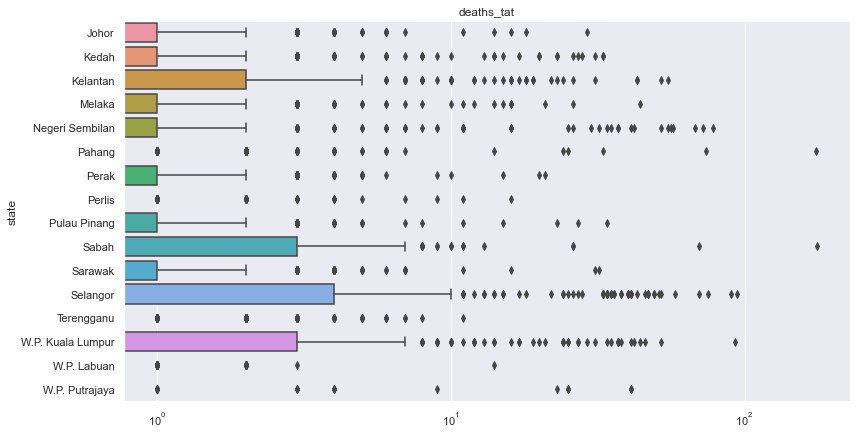

In [58]:
deaths_state_wide = deaths_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['deaths_new', 'deaths_new_dod', 'deaths_tat']
                                          )

for column in coi:
    if column == 'deaths_new' or column =='deaths_new_dod' or column == 'deaths_tat':
        sorted_index = deaths_state_wide[column].median().sort_values().index
        deaths_state_wide[column][sorted_index]
        plt.figure(figsize=(13,7))
        g = sns.boxplot(data=deaths_state_wide[column][sorted_index], orient='h', dodge=False)
        g.set_xscale('log')
        g.set_title(column)

With this, we are able to visualise the median points more easily now. Selangor still covers a wider range compared to the other states in terms of deaths. 

Now lets look at the relational plot for all states, in terms of `deaths_new` column.

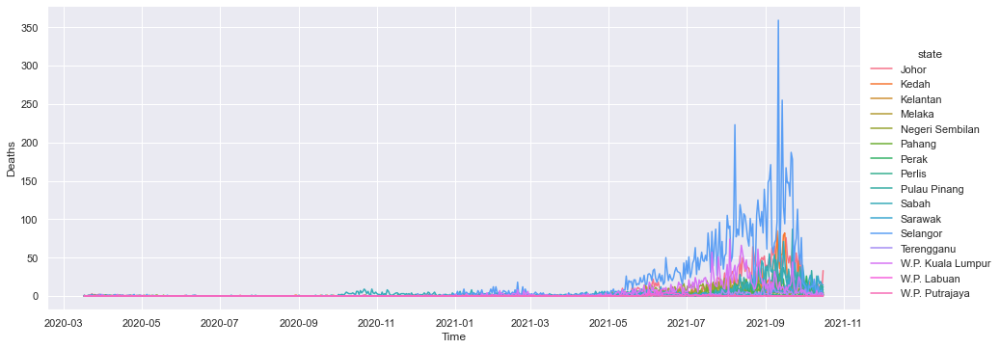

In [59]:
deaths_state_wide = deaths_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['deaths_new']
                                          )
ax = sns.relplot(data=deaths_state_wide['deaths_new'].loc[:,all_states], kind='line',
            aspect=2.5, dashes=False)
ax.set_xlabels('Time')
ax.set_ylabels('Deaths')

Comparing the new deaths that we see in all states, Selangor alone dominates with the highest number of deaths as compared to other states across the whole period of the pandemic. 

## hospital.csv

In [60]:
analysis = hospital.copy()
analysis

,date,state,beds,beds_covid,beds_noncrit,admitted_pui,admitted_covid,admitted_total,discharged_pui,discharged_covid,discharged_total,hosp_covid,hosp_pui,hosp_noncovid
0,2020-03-24,Johor,1440,434,1408,0,0,0,0,0,0,18,9,1
1,2020-03-24,Kedah,1218,143,1183,0,0,0,0,0,0,46,5,12
2,2020-03-24,Kelantan,1463,280,1424,9,6,15,1,0,1,78,58,23
3,2020-03-24,Melaka,1091,82,1065,0,0,0,0,0,0,19,10,12
4,2020-03-24,Negeri Sembilan,1223,253,1205,0,0,0,0,0,0,90,13,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8734,2021-10-16,Selangor,5902,1570,5604,218,97,315,152,95,247,733,404,2035
8735,2021-10-16,Terengganu,1557,491,1500,9,24,33,16,30,46,201,23,899
8736,2021-10-16,W.P. Kuala Lumpur,3963,647,3841,3,28,31,4,18,22,207,34,1012
8737,2021-10-16,W.P. Labuan,122,106,99,0,0,0,0,0,0,0,1,65


<AxesSubplot:xlabel='date', ylabel='beds_covid'>

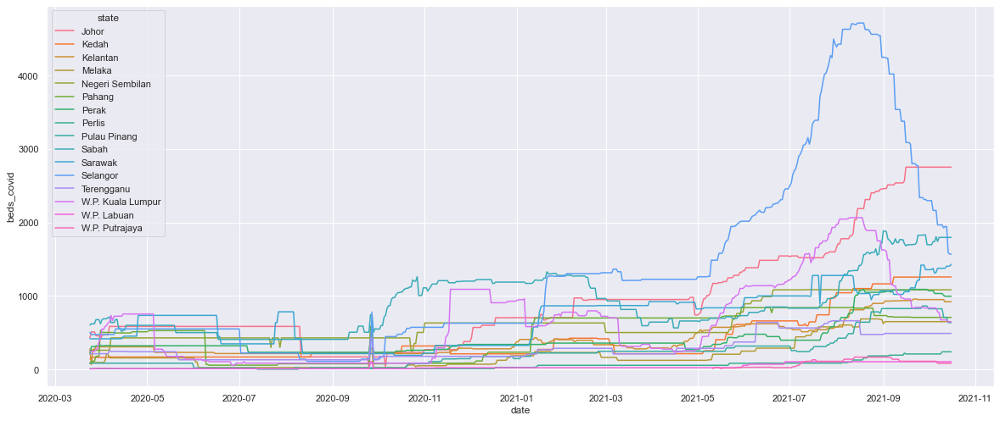

In [61]:
sns.set(rc={'figure.figsize':(20, 8.27)})

sns.lineplot(x="date", y="beds_covid", hue="state", data=analysis)

Bed allocation for covid goes outward to 5000 for Selangor before going down. Most states have roughly 1000 beds allocated for covid by August 2021.

<AxesSubplot:xlabel='date', ylabel='hosp_covid'>

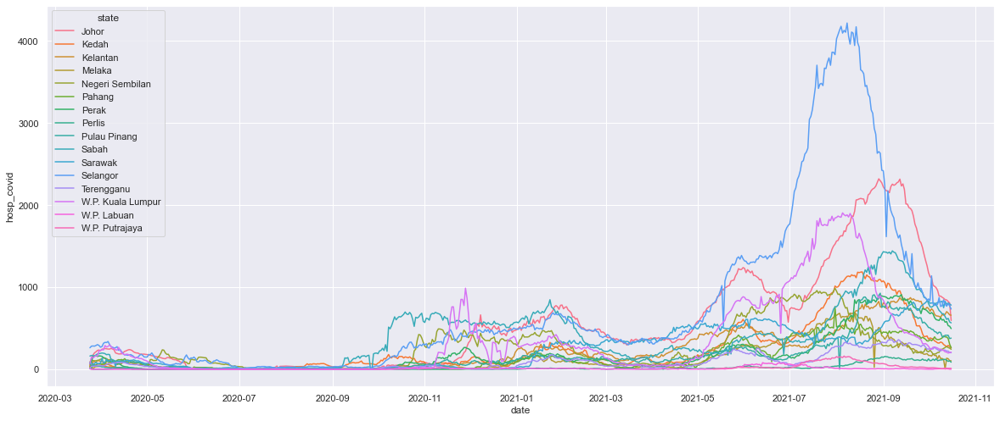

In [62]:
sns.set(rc={'figure.figsize':(20, 8.27)})

sns.lineplot(x="date", y="hosp_covid", hue="state", data=analysis)

Selangor has the highest bed used for covid, which is roughly 4000 beds. Other states used roughly 1000 beds around September-October 2021, as cases also went up during that time period.

### Bed utilization (covid beds to covid cases in hospitals)

PUI and COVID counts for bed utilization. Here we're measuring the bed utilization rate for COVID cases by each states.

In [63]:
analysis['covid_bed_utlization'] = (((analysis['hosp_covid']) / analysis['beds_covid']) * 100).round(2)

<AxesSubplot:xlabel='date', ylabel='covid_bed_utlization'>

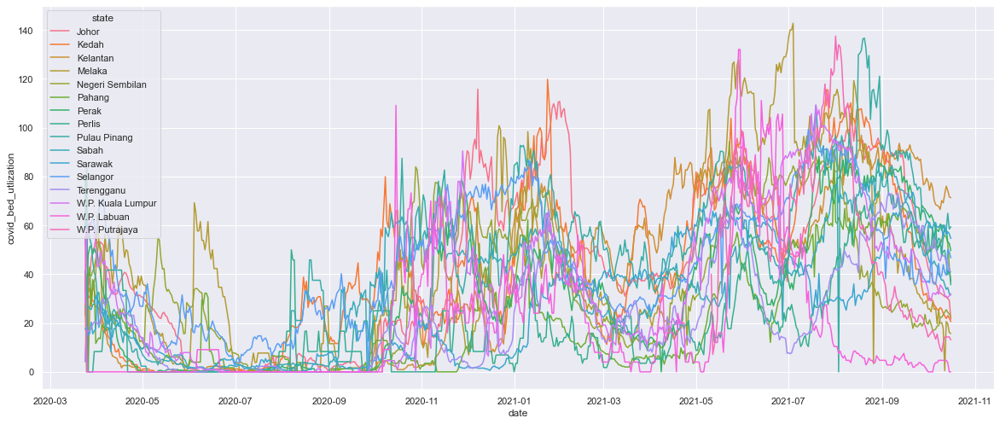

In [64]:
sns.set(rc={'figure.figsize':(20, 8.27)})

sns.lineplot(x="date", y="covid_bed_utlization", hue="state", data=analysis)

From here we can see that for the past 6 months, COVID cases has been rather taxing to our healthcare system, as the utilization for beds for COVID cases reaches 100% (and went over it!) for states like W.P Kuala Lumpur, Selangor, Pulau Pinang. More and more beds for other non-COVID cases has to be allocated for COVID in order to make room for the patients. This also leads to the decline of the healthcare quality provided to the rest of population

<AxesSubplot:>

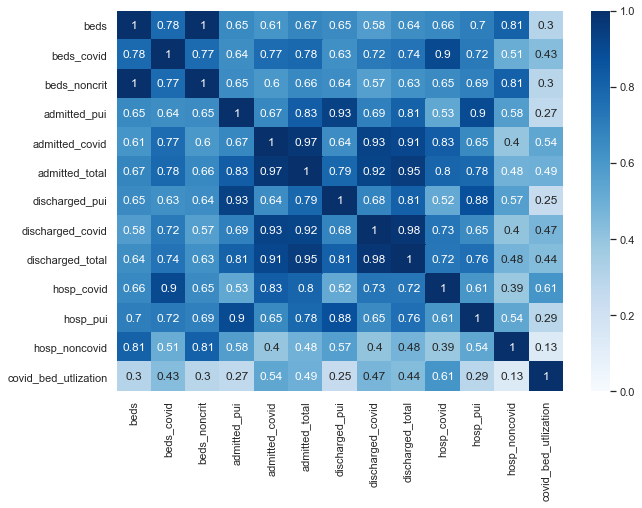

In [65]:
columns_list = analysis.columns
columns_list.delete(0)

sns.set(rc={'figure.figsize':(10, 7)})
sns.heatmap(analysis[columns_list].corr(), cmap='Blues', annot=True, vmin=0, vmax=1)

From the correlation plot, we can see that most of the admission to hospital are mostly COVID-19 cases (strong correlation). We can also see high correlation between beds_covid and hosp_covid, as new beds are allocated for the COVID-19 cases as the numbers goes up

## icu.csv

In [66]:
columns_list = icu.columns
columns_list.delete(0)

analysis = icu.copy()

<AxesSubplot:>

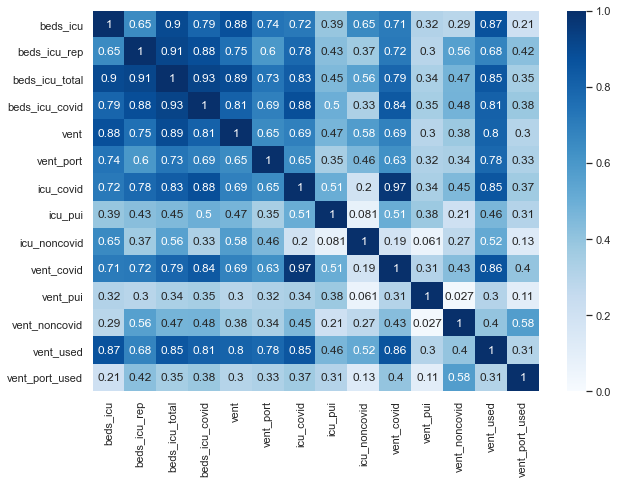

In [67]:
sns.heatmap(analysis[columns_list].corr(), cmap='Blues', annot=True, vmin=0, vmax=1)

Looking at the correlation plot, we can see that beds_icu_total and beds_icu covid has a strong really correlation (>0.9) with each other, implying that a lot of ICU beds are allocated to handle critical COVID cases.

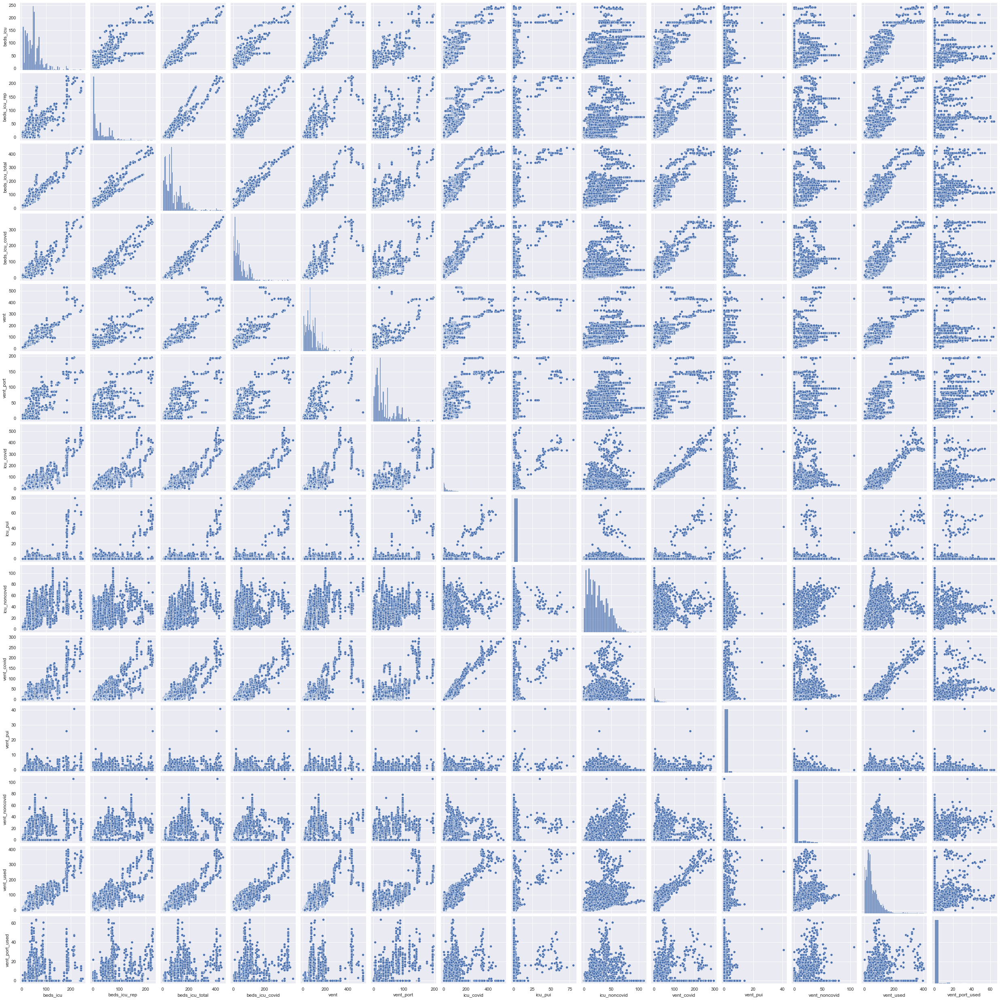

In [68]:
temp = analysis[columns_list]
sns.pairplot(temp)

<AxesSubplot:xlabel='date', ylabel='beds_icu_total'>

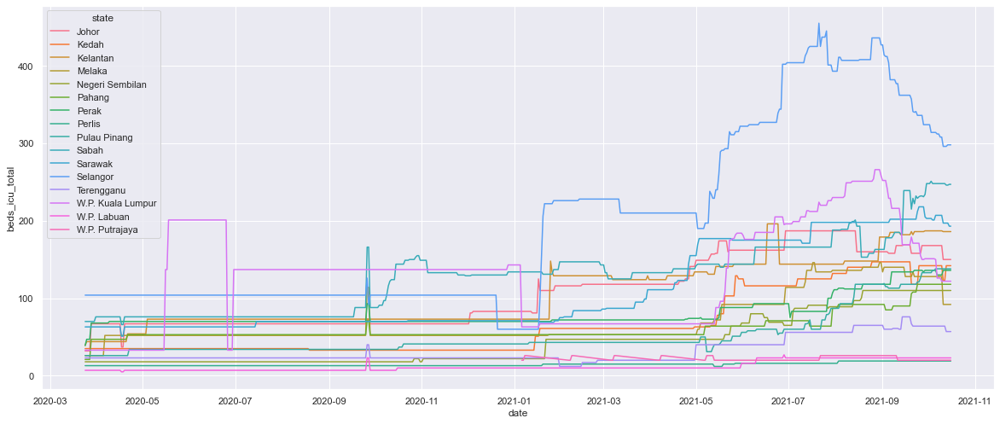

In [69]:
sns.set(rc={'figure.figsize':(20, 8.27)})

sns.lineplot(x="date", y="beds_icu_total", hue="state", data=analysis)

## pkrc.csv

In [70]:
analysis = pkrc.copy()
analysis.set_index('date', inplace=True)
analysis

,state,beds,admitted_pui,admitted_covid,admitted_total,discharge_pui,discharge_covid,discharge_total,pkrc_covid,pkrc_pui,pkrc_noncovid
date,,,,,,,,,,,
2020-03-28,Kelantan,147,0,0,0,0,0,0,0,53,0
2020-03-28,Perlis,54,0,0,0,0,0,0,8,3,0
2020-03-28,Pulau Pinang,58,0,0,0,0,0,0,13,0,0
2020-03-28,Sarawak,74,0,0,0,0,0,0,22,0,0
2020-03-28,Selangor,1452,0,12,12,0,5,5,145,0,8
...,...,...,...,...,...,...,...,...,...,...,...
2021-10-16,Sabah,3512,11,163,174,5,254,259,1236,75,0
2021-10-16,Sarawak,6772,82,18,100,10,24,34,2498,719,0
2021-10-16,Selangor,3156,5,232,237,1,242,243,1921,19,0


<AxesSubplot:xlabel='date', ylabel='pkrc_covid'>

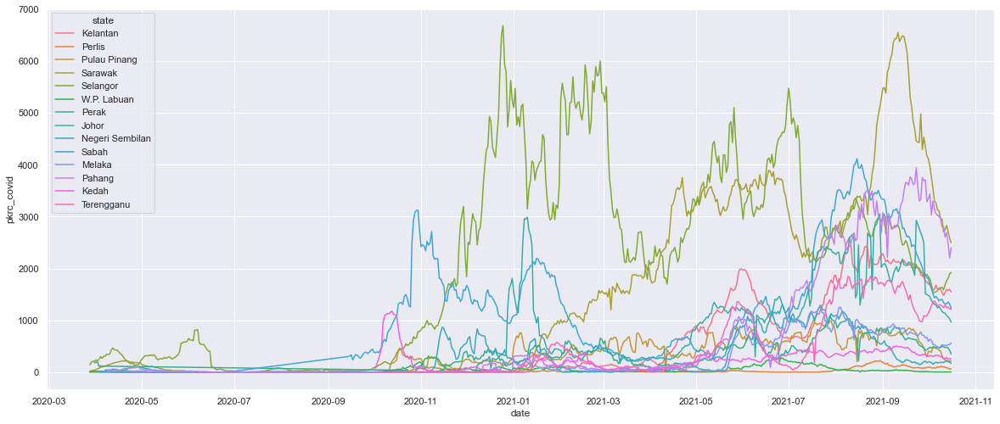

In [71]:
#For this specific example the best solution would be to use the following
sns.set(rc={'figure.figsize':(20, 8.27)})

sns.lineplot(x="date", y="pkrc_covid", hue="state", data=analysis)

In [72]:
columns_list = pkrc.columns
columns_list = columns_list.delete(0)
columns_list = columns_list.delete(0)

<AxesSubplot:>

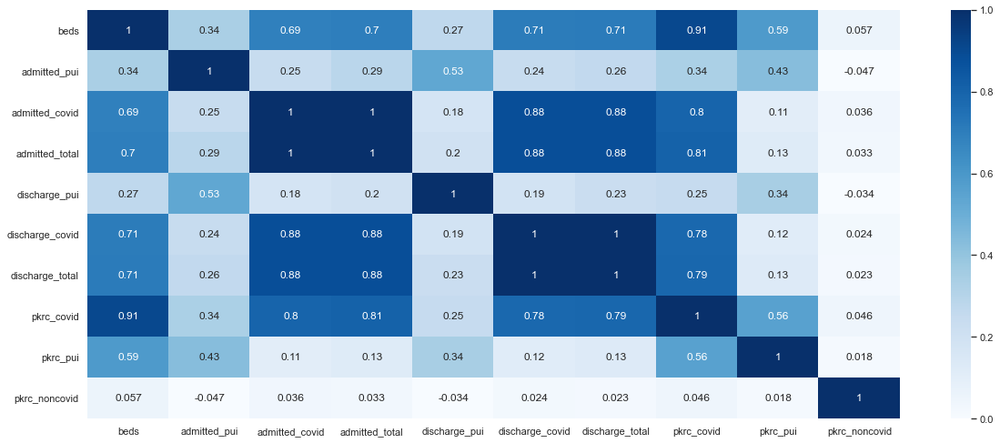

In [73]:
sns.heatmap(analysis[columns_list].corr(), cmap='Blues', annot=True, vmin=0, vmax=1)

In [74]:
analysis_malaysia = analysis.groupby(by='date', axis=0, level=None, as_index=True, sort=True, group_keys=True).sum()
analysis_malaysia

,beds,admitted_pui,admitted_covid,admitted_total,discharge_pui,discharge_covid,discharge_total,pkrc_covid,pkrc_pui,pkrc_noncovid
date,,,,,,,,,,
2020-03-28,1882,0,13,13,1,5,6,194,64,8
2020-03-29,1882,19,41,60,6,6,12,252,59,2
2020-03-30,1882,35,22,57,3,26,29,278,98,10
2020-03-31,2209,10,34,44,49,21,70,471,58,14
2020-04-01,2237,1,29,30,8,25,33,512,70,22
...,...,...,...,...,...,...,...,...,...,...
2021-10-12,30184,95,1371,1466,46,1370,1416,14134,902,104
2021-10-13,30084,97,1293,1390,43,1393,1436,14340,888,99
2021-10-14,29277,112,1640,1752,66,1474,1540,13998,977,84


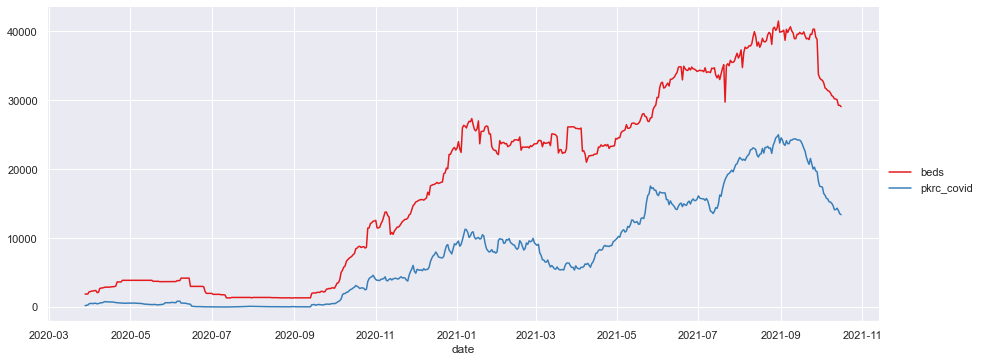

In [75]:
ax = sns.relplot(data=analysis_malaysia.loc[:,['beds', 'pkrc_covid']], kind='line',
            aspect=2.5, dashes=False, palette='Set1')

A lot of beds are opened for the quarantine center to handle the growing number of quarantines and suspected COVID-19 cases. A big gap between beds and pkrc_covid implies that the healthcare system trying it's best to make sure all of the patients can be accomadated in the quarantine centre

## tests_malaysia.csv

We will now be doing the data analysis for the `tests_malaysia.csv` dataset. It is important to note beforehand that, the dataset's starting date only begins from 2021-01 onwards. 

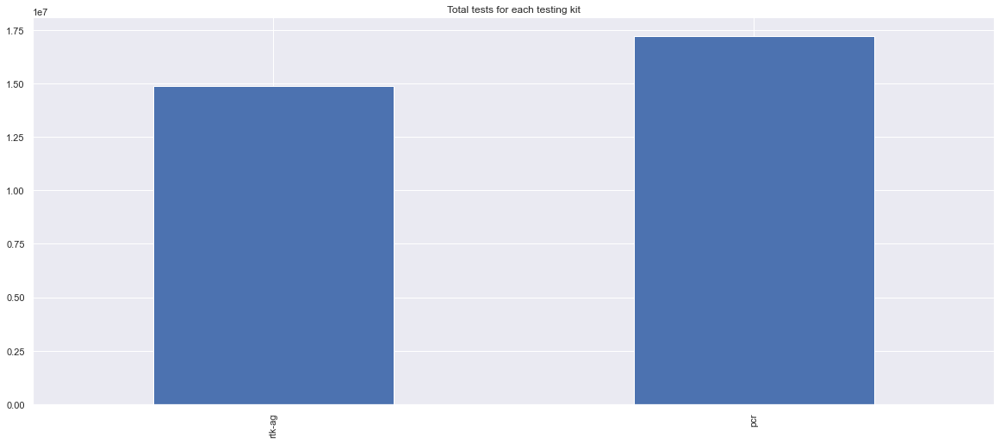

In [76]:
test1 = tests_malaysia.copy()
test1.drop('date', axis='columns', inplace=True)

tests_sum_series = test1.sum(axis = 0, skipna = True)
tests_sum_series.plot.bar()
plt.title('Total tests for each testing kit')
plt.show()

From the above bar plot, we can see that, the number of tests conducted with the PCR test kit is higher than the RTK-AG test kit. On its own, both are still very widely used in the whole of Malaysia.

We will now follow the analysis in terms of outlier analysis. We will start by checking the skewness of the data.

In [77]:
coi = tests_malaysia.columns.tolist()
coi.pop(0)

for column in coi: 
    print("Skewness " + column + ": " + str(tests_malaysia[column].skew()))

Skewness rtk-ag: 1.3691737148062
Skewness pcr: 0.6947179794653423


Below are the boxplots for the test kits.

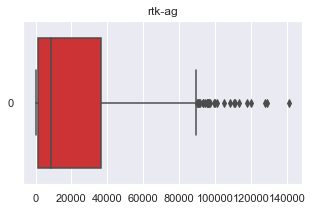

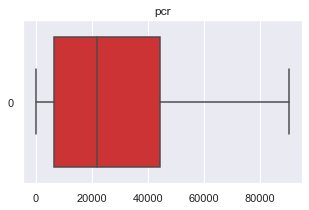

In [78]:
for column in coi: 
    fig, ax = plt.subplots(figsize=(5,3))
    ax.set_title(column)
    sns.boxplot(ax=ax, data=tests_malaysia[column], orient='h', palette='Set1')
    plt.show()

The boxplot shows that, only the RTK-AG test kit had outliers, as compared to the PCR where there were no outliers. We can understand that, early on the RTK-AG were used during the early stages of the pandemic, hence there were data values that represented the main 50% of the testing done, which were of lower frequency. And as the pandemic went on, more testing kits were used, which led to the extreme outliers as we can see in the `rtk-ag` boxplot.

Similar as before, we will be conducting feature engineering for the `tests_malaysia.csv`. In total, we will be creating 1-7 day lagging features for the tests data and 7-and-14 day rolling average for the dataset.

In [79]:
def calc_lag_test(df, ndays):
    """Takes in tests dataset for a particular state and number of days. 
    Returns a new dataset with added n-day columns of 1 to n-day lags for each of the
    2 test kits columns."""
    
    cols_of_interest = df[['rtk-ag', 'pcr']]
    for i in range(ndays):
        current_day_lag = cols_of_interest.shift(i+1)
        current_day_lag.columns = [str(i+1)+'-day lag rtk-ag', 
                                   str(i+1)+'-day lag pcr']
        df = pd.concat([df, current_day_lag], axis=1)
    return df

In [80]:
def tests_engineer(df_tests, state_name='', show_plot=False):
    """Takes in the tests_malaysia/tests_state dataset (if using the tests_state, the name of the state is needed). Returns a new dataset that 
    contains added lagging and rolling average features.
    """
    tests = df_tests.copy()
    # extracting dataframe for this state
    if state_name != '':
        tests = df_tests[df_tests['state'] == state_name]
        tests = tests.drop(columns=['state'])
        tests.reset_index(inplace=True, drop=True)

    # adding columns of the rolling averages of new tests for 7 days and 14 days
    tests['7DayAverageNewTests_rtk-ag'] = tests['rtk-ag'].rolling(window=7).mean()
    tests['14DayAverageNewTests_rtk-ag'] = tests['rtk-ag'].rolling(window=14).mean()
    tests['7DayAverageNewTests_pcr'] = tests['pcr'].rolling(window=7).mean()
    tests['14DayAverageNewTests_pcr'] = tests['pcr'].rolling(window=14).mean()

    # adding columns of 1-to-n-day-lags of new tests
    tests = calc_lag_test(tests, 7)

    # simple plot to confirm...
    if show_plot == True: 
        df = tests.set_index('date')
        if state_name != '':
            fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15,15))
            sns.lineplot(data=df.loc['2021-01':,['rtk-ag', '7DayAverageNewTests_rtk-ag', '14DayAverageNewTests_rtk-ag']], ax=ax1).set_title(state_name + ' rolling average new tests (RTK-AG)')
            sns.lineplot(data=df.loc['2021-01':,['pcr', '7DayAverageNewTests_pcr', '14DayAverageNewTests_pcr']], ax=ax2).set_title(state_name + ' rolling average new tests (PCR)')
        else:
            fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15,20))
            sns.lineplot(data=df.loc['2021-01':,['rtk-ag', '7DayAverageNewTests_rtk-ag', '14DayAverageNewTests_rtk-ag']], ax=ax1).set_title('Malaysia rolling average new tests (RTK-AG)')
            sns.lineplot(data=df.loc['2021-01':,['pcr', '7DayAverageNewTests_pcr', '14DayAverageNewTests_pcr']], ax=ax2).set_title('Malaysia rolling average new tests (PCR)')
    
    return tests

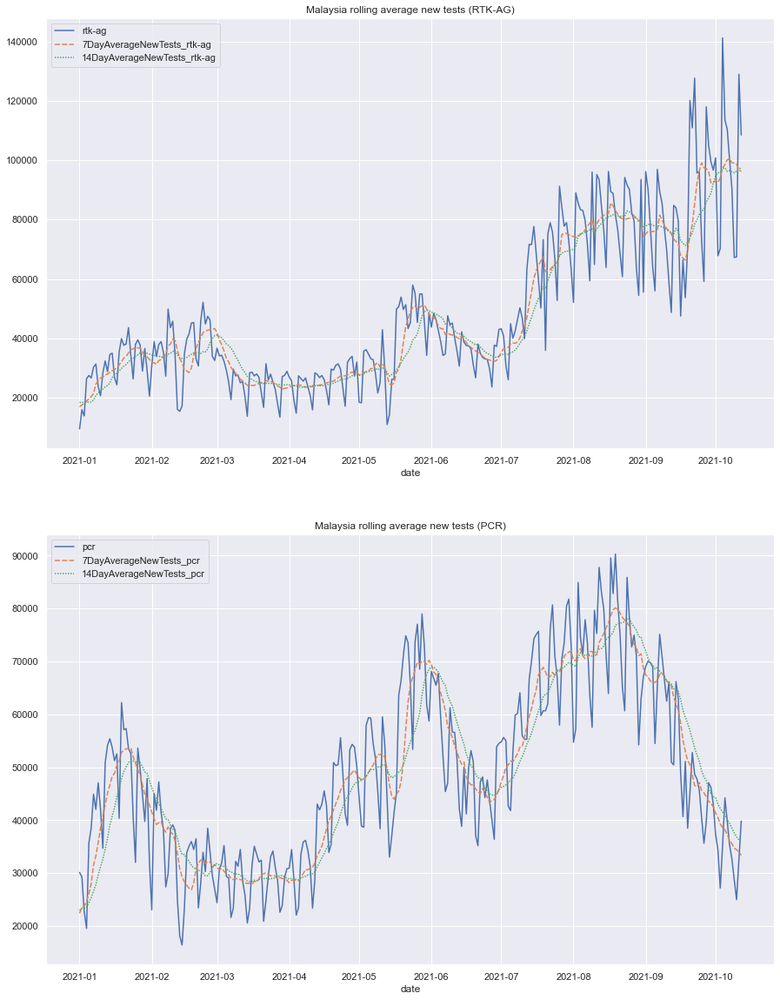

In [81]:
tests_malaysia = tests_engineer(tests_malaysia.reset_index(), show_plot=True)

As we can see above, using the rolling average to visualise the data of the testing kits allows us to make it easier to understand the peaks and valleys of the testing kits, and how much was used throughout the pandemic in order to keep track of the positive rate of Covid-19 patients in Malaysia.

## tests_state.csv

Now we will be looking at the `tests_state.csv`, where we will conduct some analysis on the dataset. It is also important to note that, the dataset only contains data from 2021-07 onwards.

C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


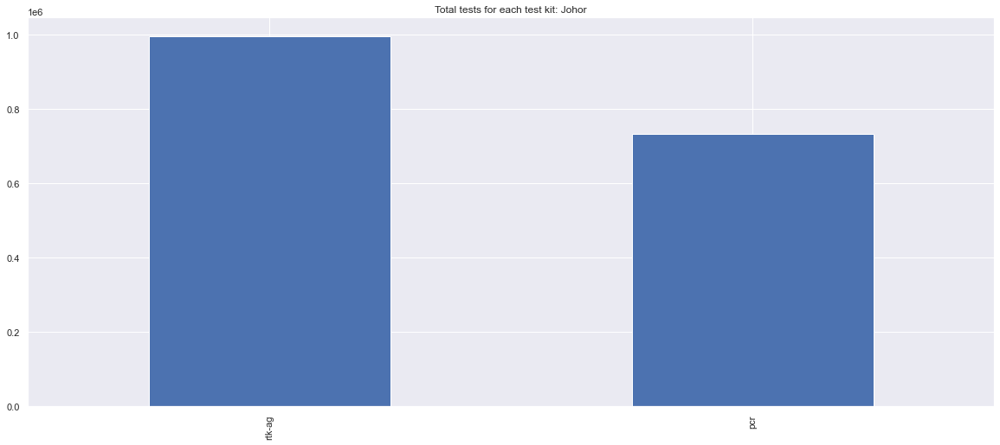

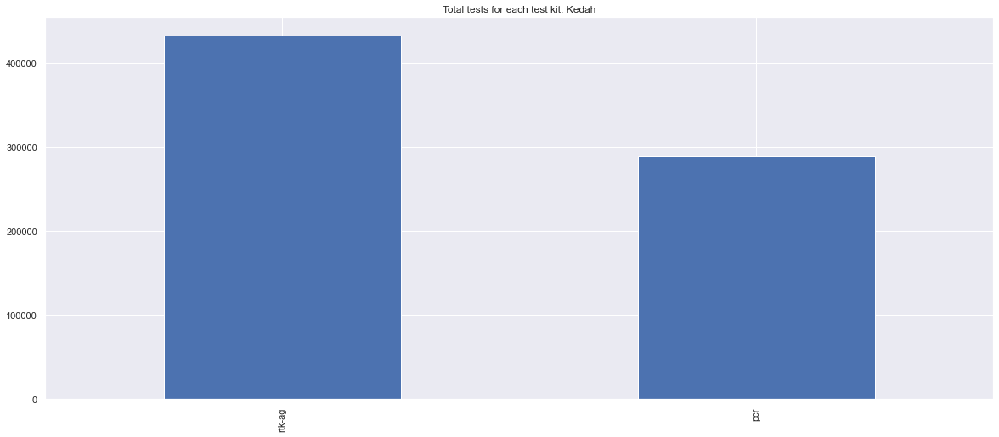

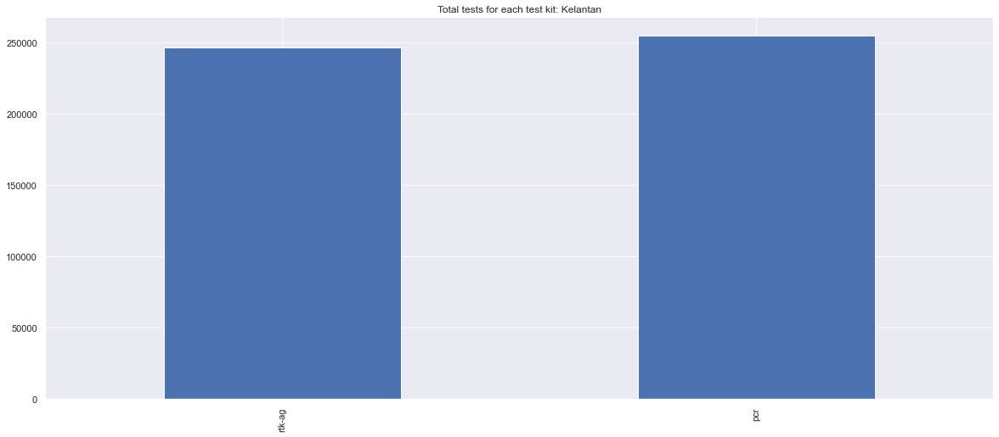

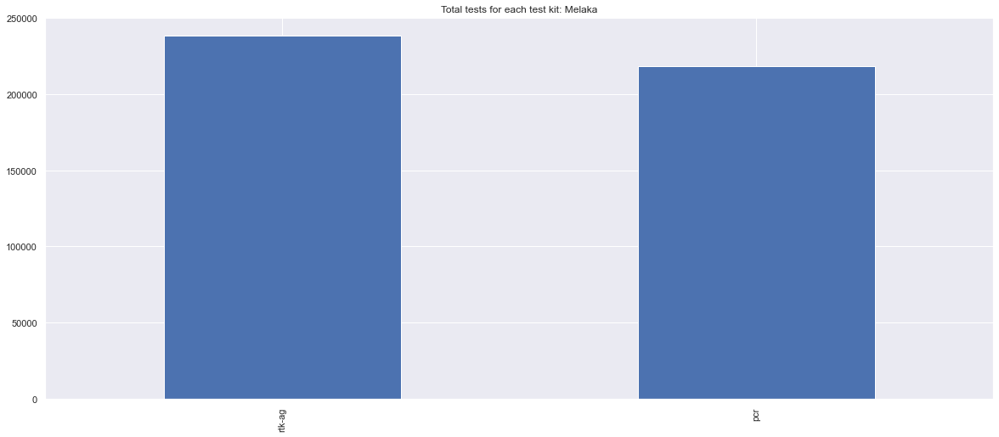

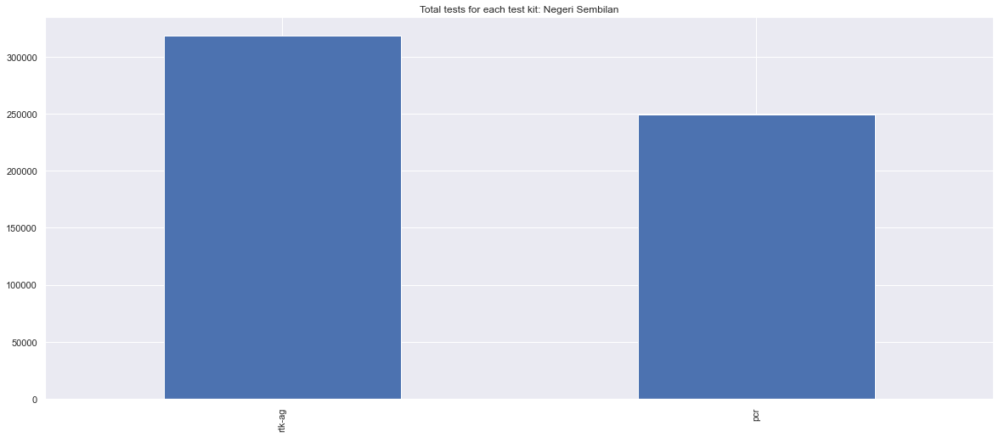

...

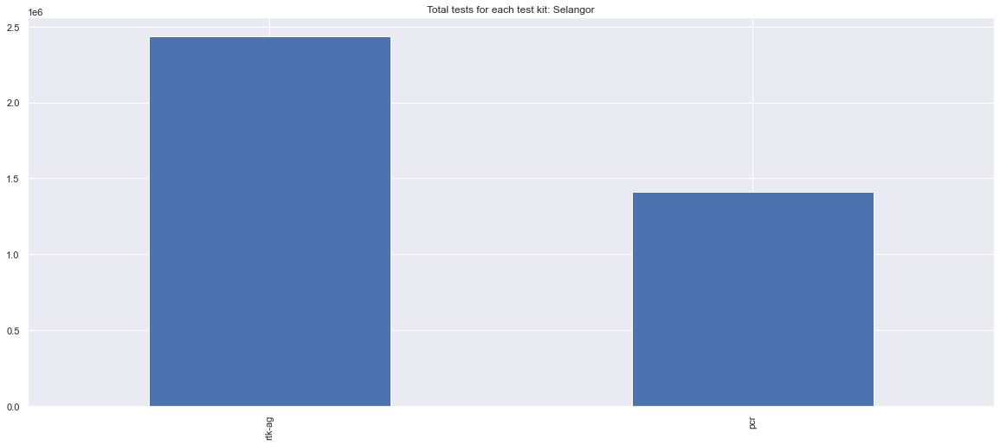

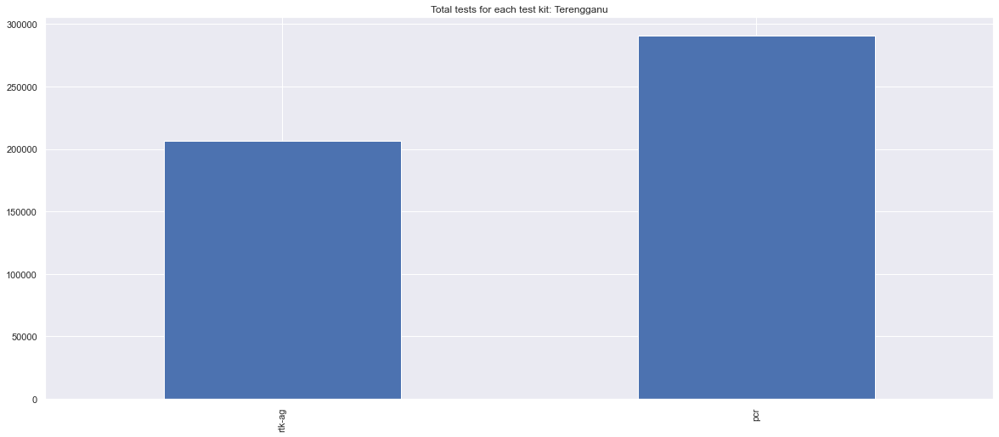

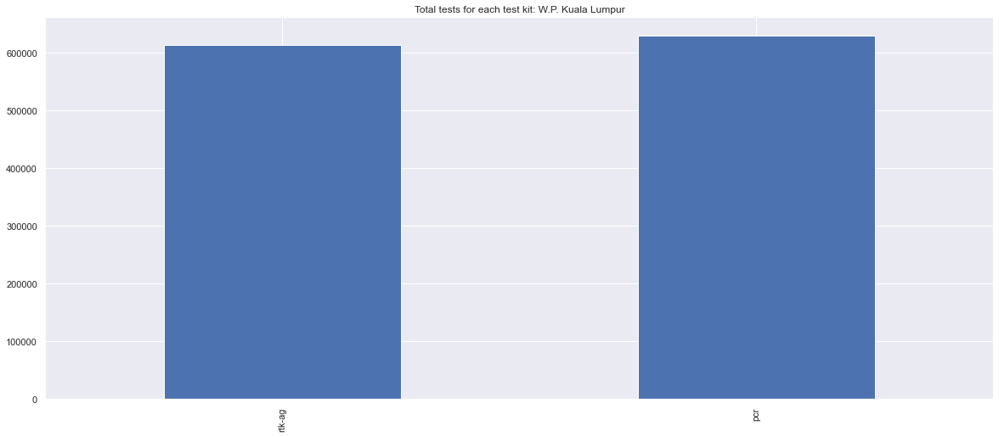

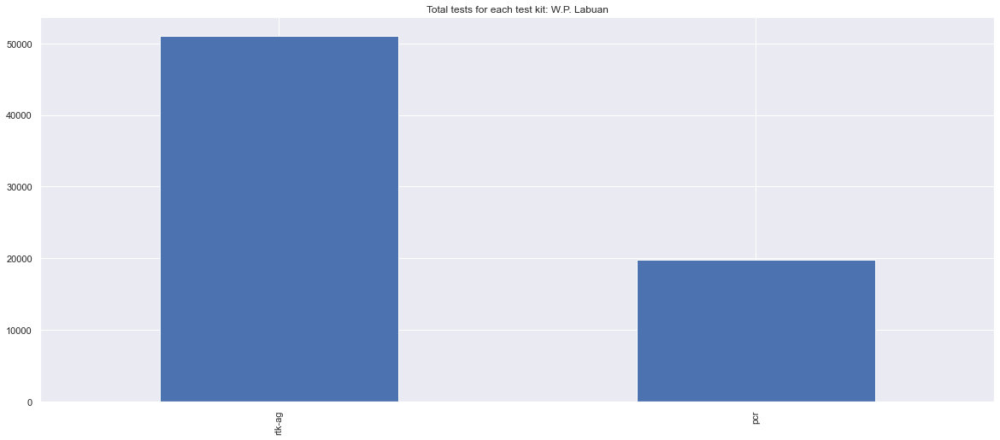

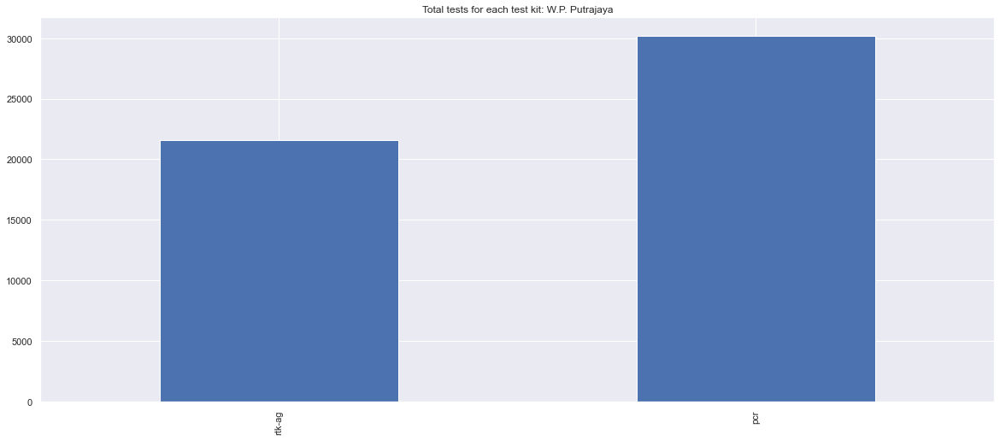

In [82]:
test1 = tests_state.copy()
test1.drop('date', axis='columns', inplace=True)
all_states = tests_state['state'].unique().tolist()

for state in all_states:
    df = test1[test1['state']==state]
    df.drop('state', axis='columns', inplace=True)
    deaths_sum_series = df.sum(axis = 0, skipna = True)
    deaths_sum_series.plot.bar()
    plt.title('Total tests for each test kit: ' + state)
    plt.show()

In the above bar plot, Kelantan, Pahang, Sarawak, Terengganu, W.P. Kuala Lumpur and W.P. Putrajaya uses more PCR test kits as compared to the RTK-AG.

State: Johor
Skewness rtk-ag: 0.2621704401872394


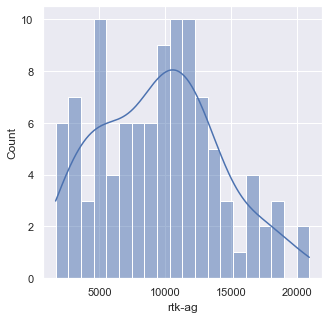

Skewness pcr: 0.29497241693968473


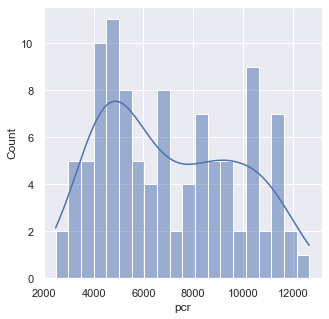

State: Kedah
Skewness rtk-ag: 0.02923684725191362


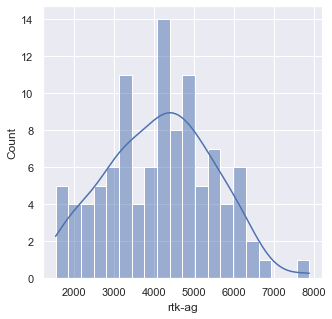

Skewness pcr: 0.06597416048225005


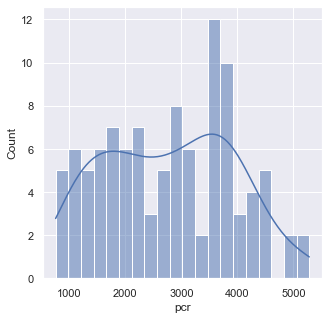

State: Kelantan
Skewness rtk-ag: 0.8047660573924484


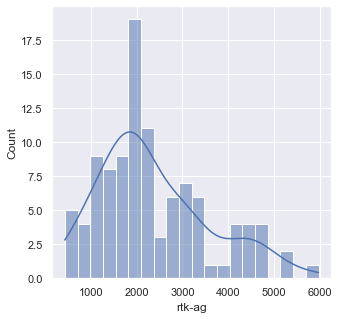

Skewness pcr: 0.8051297198072157


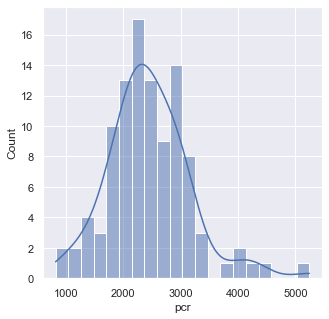

State: Melaka
Skewness rtk-ag: 4.774491751807721


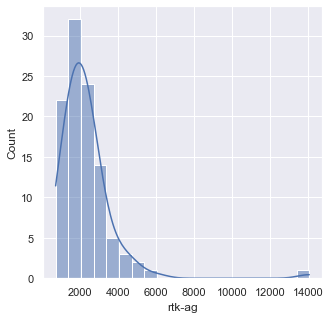

Skewness pcr: 0.8412094633391901


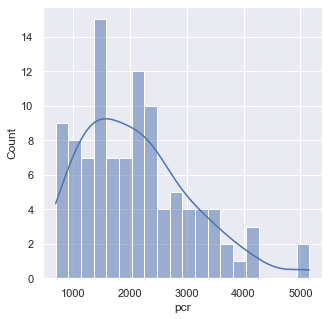

State: Negeri Sembilan
Skewness rtk-ag: 0.8890999122055911


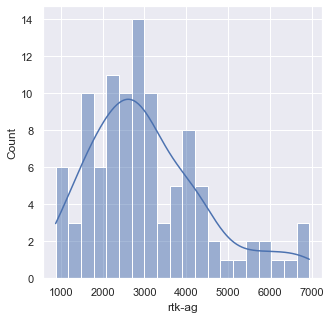

Skewness pcr: 1.0220442531872234


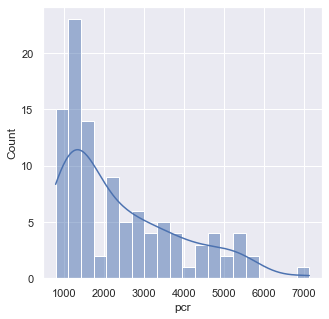

State: Pahang
Skewness rtk-ag: 0.7066269425167058


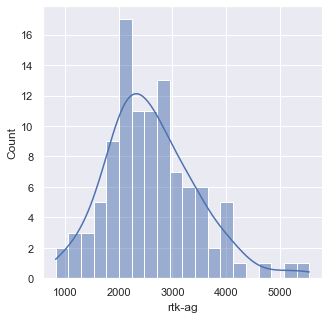

Skewness pcr: -0.08092862791311815


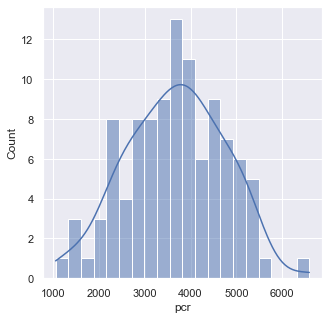

State: Perak
Skewness rtk-ag: 0.44308803949870207


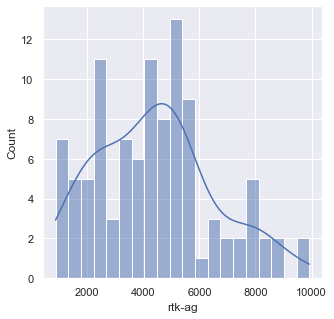

Skewness pcr: 0.4119421477420194


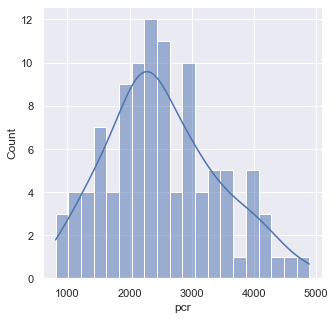

State: Perlis
Skewness rtk-ag: 5.386838667193673


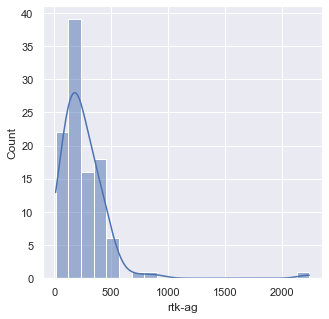

Skewness pcr: 0.5800670473049604


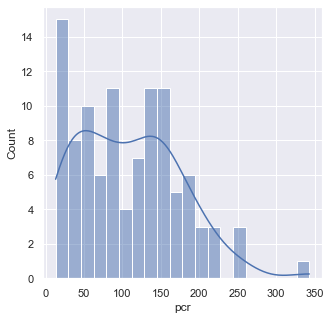

State: Pulau Pinang
Skewness rtk-ag: 0.5810718838780752


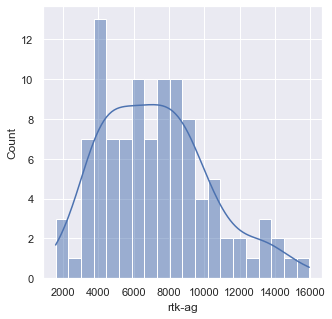

Skewness pcr: 0.26808518068362647


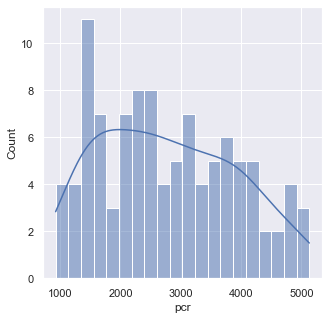

State: Sabah
Skewness rtk-ag: 0.22031115806060997


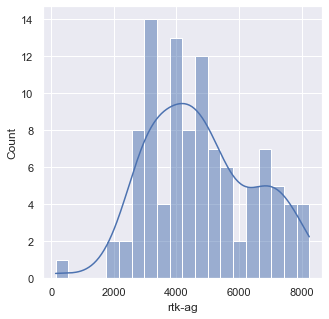

Skewness pcr: 0.6161470063359494


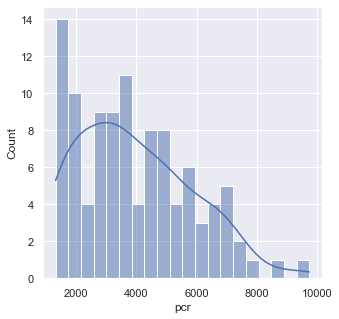

State: Sarawak
Skewness rtk-ag: 0.8043722668826325


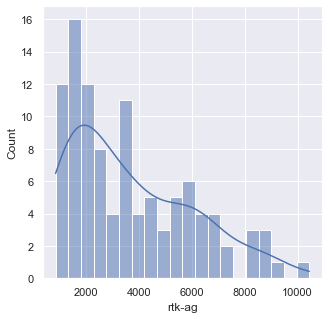

Skewness pcr: 0.8364510172038019


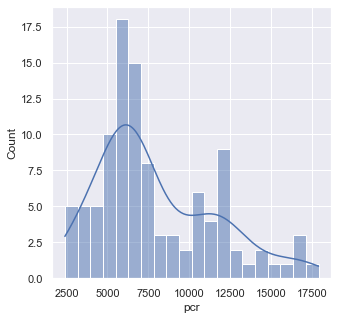

State: Selangor
Skewness rtk-ag: -0.07352790934165539


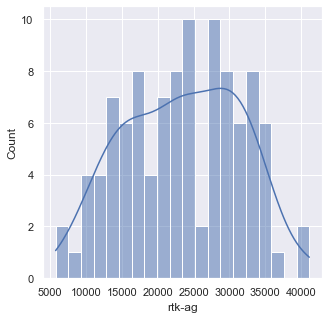

Skewness pcr: 0.17771468316486988


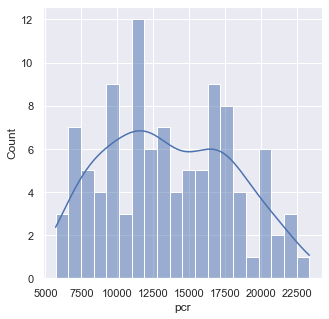

State: Terengganu
Skewness rtk-ag: 1.0253180700336464


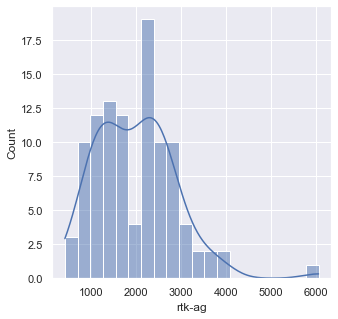

Skewness pcr: 0.17033806334735635


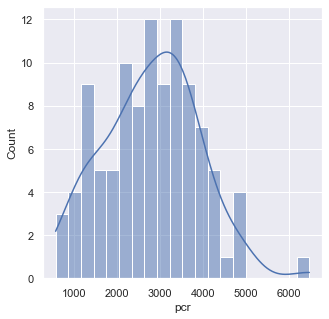

State: W.P. Kuala Lumpur
Skewness rtk-ag: 0.3490431186316286


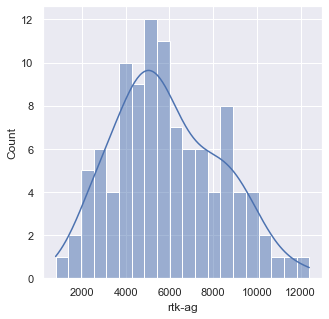

Skewness pcr: 0.5973004357230609


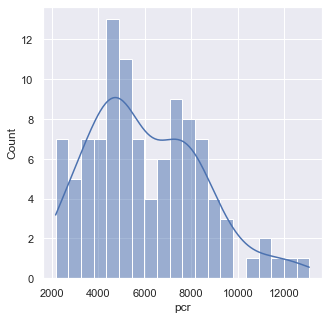

State: W.P. Labuan
Skewness rtk-ag: 2.1481206310464094


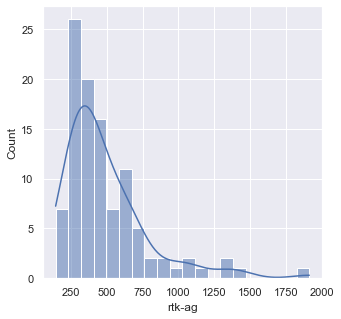

Skewness pcr: 0.33662951803228397


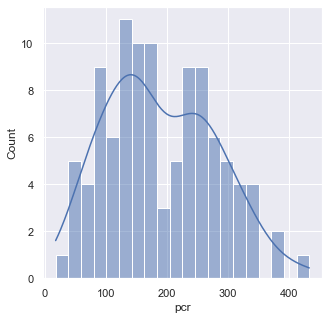

State: W.P. Putrajaya
Skewness rtk-ag: 0.9169901619105125


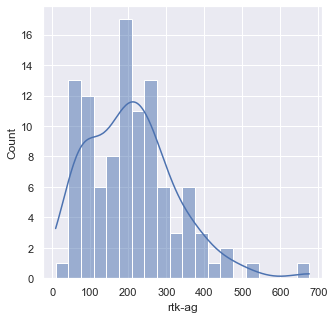

Skewness pcr: 1.2323637272210073


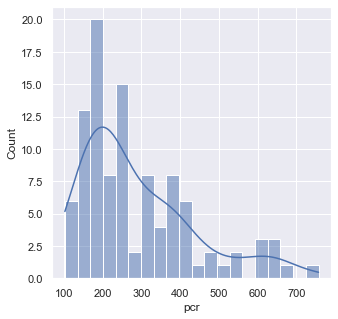

In [83]:
test1 = tests_state.copy()
test1.drop('date', axis='columns', inplace=True)
coi = tests_state.columns.tolist()
coi.pop(0)
coi.pop(0)

for state in all_states:
    print("State: " + state)
    df = test1[test1['state']==state]
    for column in coi: 
        print("Skewness " + column + ": " + str(df[column].skew()))
        fig, ax = plt.subplots(figsize=(5,5))
        sns.histplot(ax=ax, data=df[column], kde=True, bins=20)
        plt.show()
    print("====================================================")

Looking at the `tests_state.csv`, we can see that most of these states are skewed to the right. Hence we will conduct square root transformation to reduce the skewness. 

State: Johor
Skewness rtk-ag: -0.2676203528953418


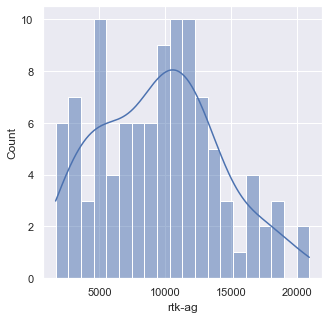

Skewness pcr: 0.06459562479112148


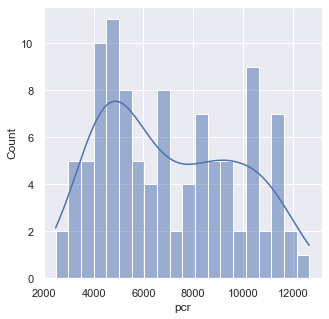

State: Kedah
Skewness rtk-ag: -0.35068136234206604


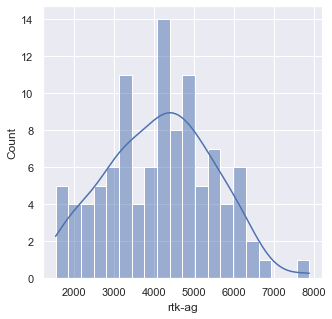

Skewness pcr: -0.26518470876906386


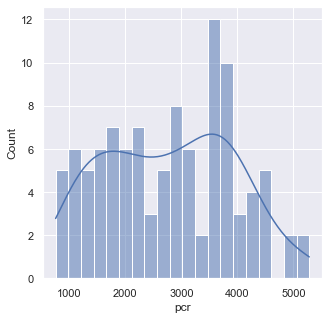

State: Kelantan
Skewness rtk-ag: 0.21862788549499737


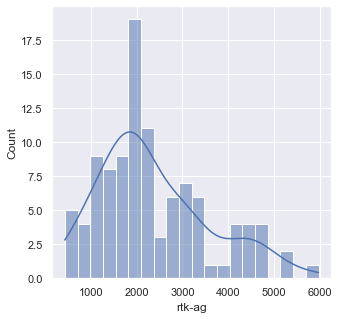

Skewness pcr: 0.11242954920407698


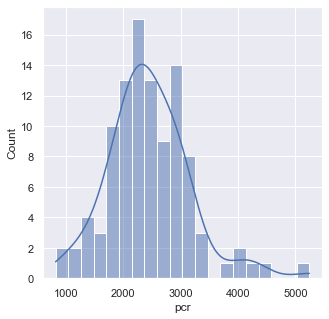

State: Melaka
Skewness rtk-ag: 2.1413112717227434


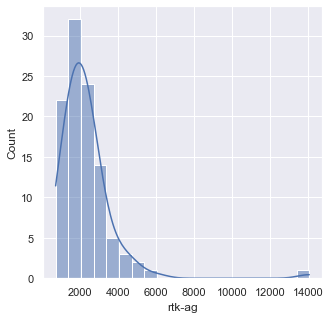

Skewness pcr: 0.3282492046027039


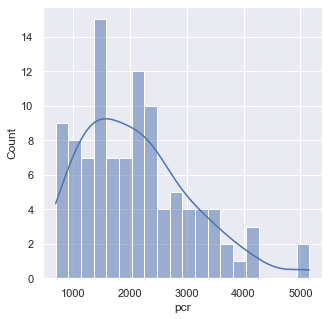

State: Negeri Sembilan
Skewness rtk-ag: 0.3278772565354561


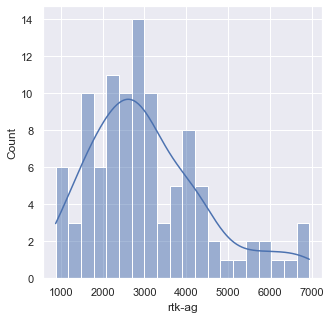

Skewness pcr: 0.6497339662321855


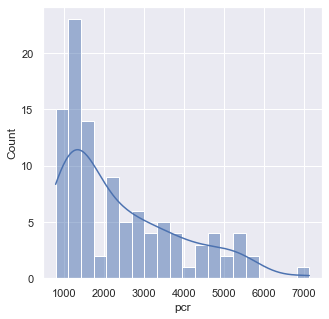

State: Pahang
Skewness rtk-ag: 0.12920790225460488


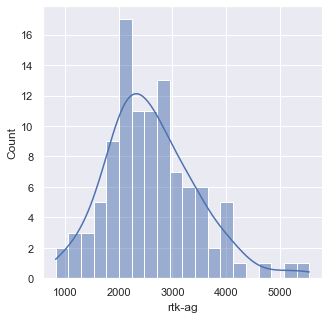

Skewness pcr: -0.5102223289823858


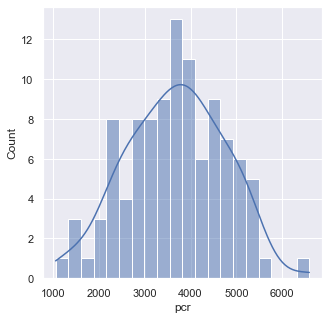

State: Perak
Skewness rtk-ag: -0.12782194649027837


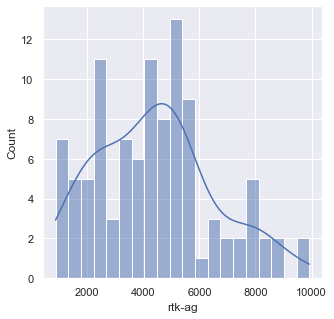

Skewness pcr: -0.02616759559800309


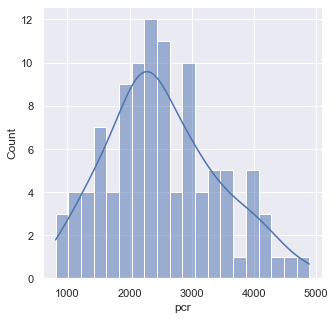

State: Perlis
Skewness rtk-ag: 1.8001894236801368


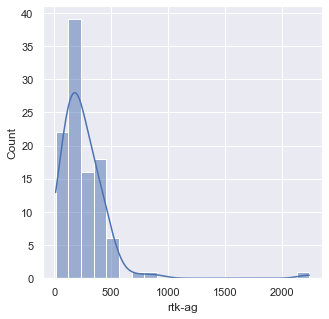

Skewness pcr: -0.10324488626106998


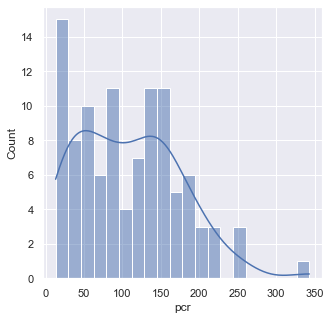

State: Pulau Pinang
Skewness rtk-ag: 0.06415951768132382


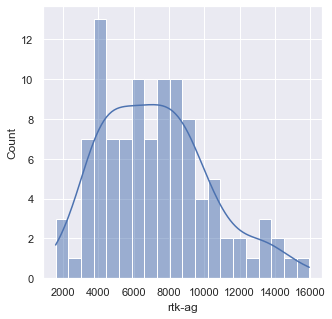

Skewness pcr: -0.03565831291812112


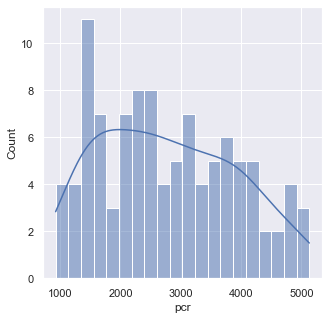

State: Sabah
Skewness rtk-ag: -0.6111124548694029


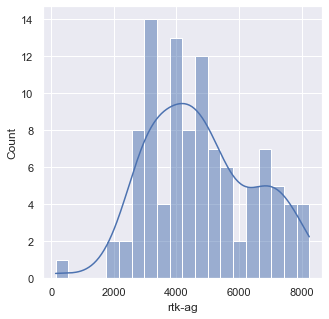

Skewness pcr: 0.17818573249832304


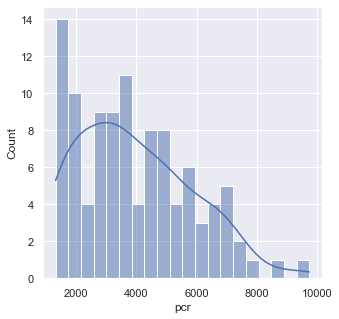

State: Sarawak
Skewness rtk-ag: 0.37228287593185594


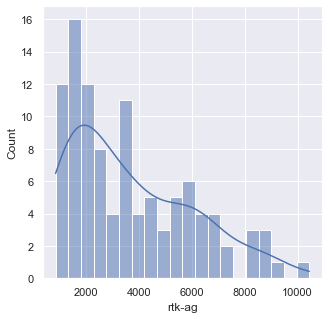

Skewness pcr: 0.4097515097704114


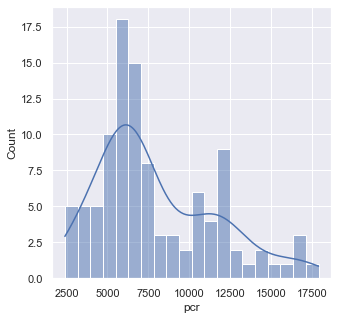

State: Selangor
Skewness rtk-ag: -0.4211000975901282


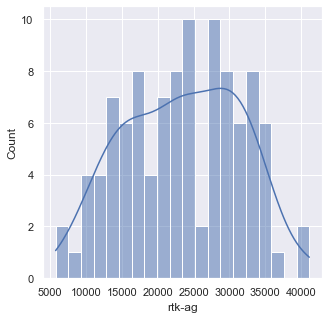

Skewness pcr: -0.07710687102337316


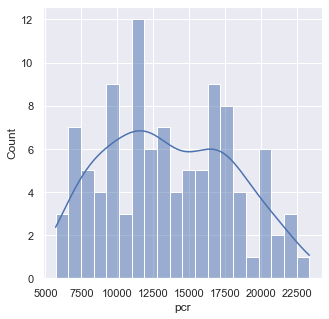

State: Terengganu
Skewness rtk-ag: 0.17331994244403934


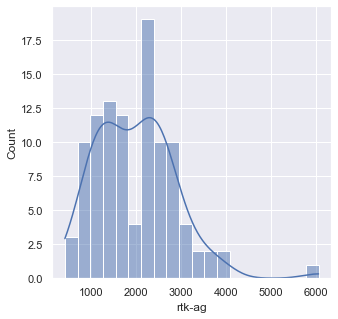

Skewness pcr: -0.43012842384987054


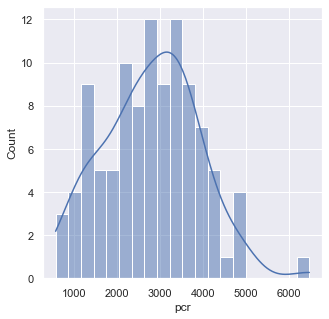

State: W.P. Kuala Lumpur
Skewness rtk-ag: -0.17034429569654916


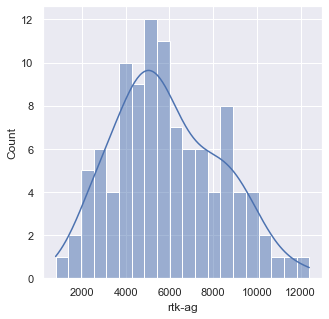

Skewness pcr: 0.15830658584927013


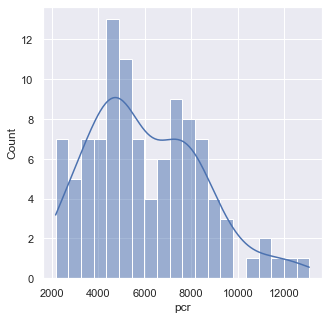

State: W.P. Labuan
Skewness rtk-ag: 1.3070813056208104


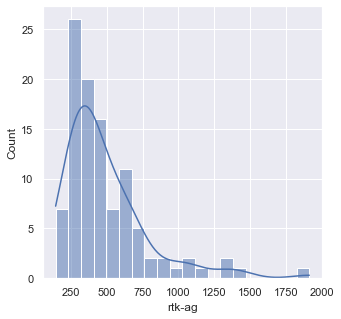

Skewness pcr: -0.18036465130947232


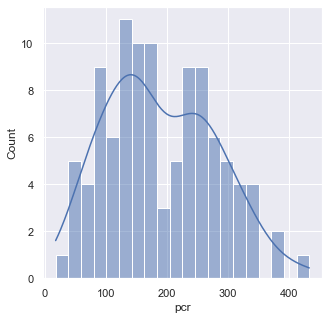

State: W.P. Putrajaya
Skewness rtk-ag: 0.0515217316680083


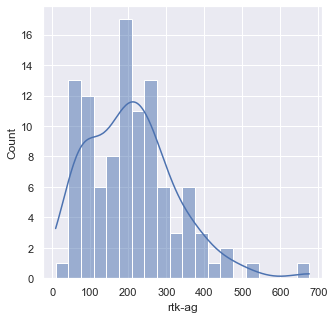

Skewness pcr: 0.8084521943310219


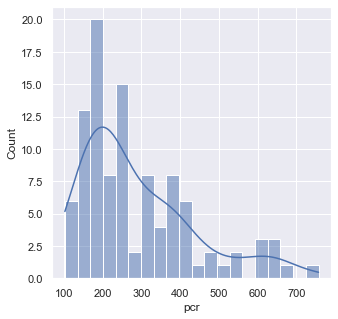

In [84]:
for state in all_states:
    print("State: " + state)
    df = test1[test1['state']==state]
    for column in coi: 
        fig, ax = plt.subplots(figsize=(5,5))
        sqrt_trans = np.sqrt(df[column])
        print("Skewness " + column + ": " + str(sqrt_trans.skew()))
        sns.histplot(ax=ax, data=df[column], kde=True, bins=20)
        plt.show()
    print("====================================================")

With that, we have successfully reduced the skewness for the test kits used for each state. 

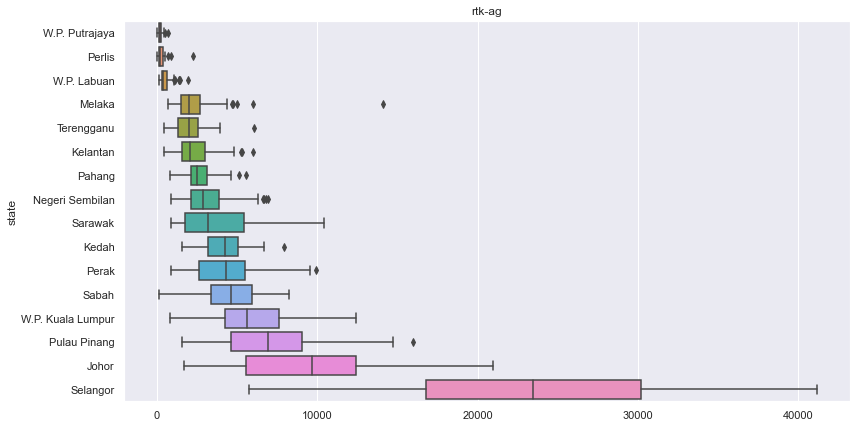

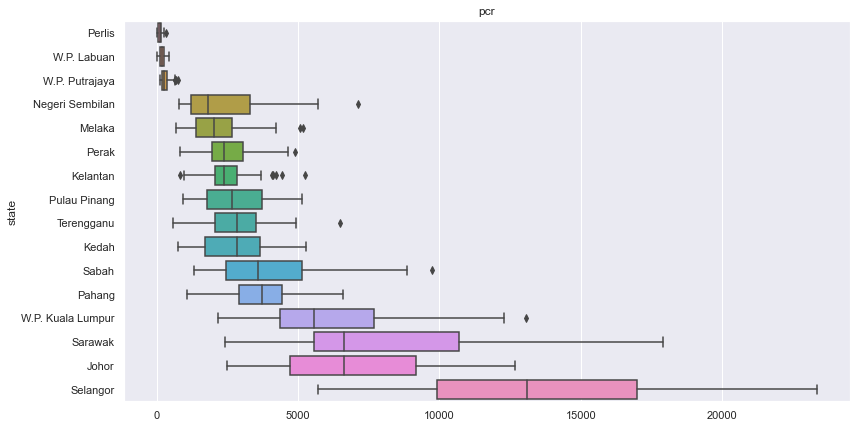

In [85]:
tests_state_wide = tests_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['rtk-ag', 'pcr']
                                          )

for column in coi:
    sorted_index = tests_state_wide[column].median().sort_values().index
    tests_state_wide[column][sorted_index]
    plt.figure(figsize=(13,7))
    g = sns.boxplot(data=tests_state_wide[column][sorted_index], orient='h', dodge=False)
    g.set_title(column)

From this, we can see that based on the median of the data points, Selangor once again covers the largest range for both test kits used. This was logical since with the sudden spike in cases, more testing was conducted in order to track the Covid-19 cases happening throughout Malaysia.

Now we will see the relational plot for both test kits used for each state.

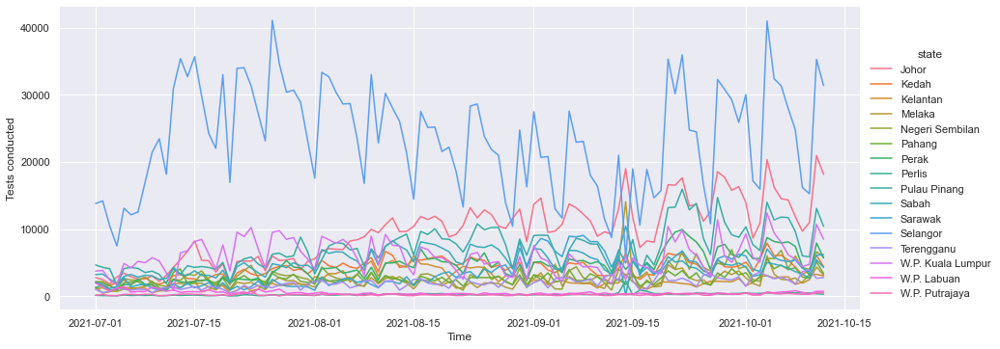

In [86]:
tests_state_wide = tests_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['rtk-ag']
                                          )
ax = sns.relplot(data=tests_state_wide['rtk-ag'].loc[:,all_states], kind='line',
            aspect=2.5, dashes=False)
ax.set_xlabels('Time')
ax.set_ylabels('Tests conducted')

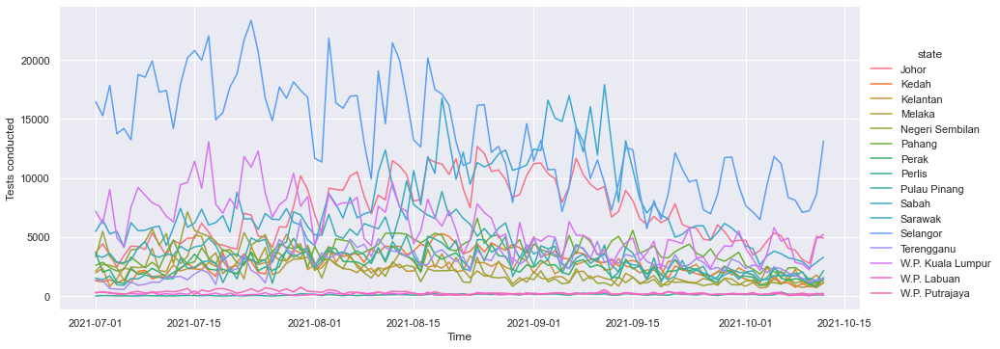

In [87]:
tests_state_wide = tests_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['pcr']
                                          )
ax = sns.relplot(data=tests_state_wide['pcr'].loc[:,all_states], kind='line',
            aspect=2.5, dashes=False)
ax.set_xlabels('Time')
ax.set_ylabels('Tests conducted')

As we can see above, Selangor conducted the most case testings throughout the periods as seen above, dominating other states each day with the sheer number of testing that was conducted. 

-----

## MySejahtera

In [88]:
# loading datasets
checkin_malaysia = pd.read_csv('covid19-public/mysejahtera/checkin_malaysia.csv')
checkin_malaysia_time = pd.read_csv('covid19-public/mysejahtera/checkin_malaysia_time.csv')
checkin_state = pd.read_csv('covid19-public/mysejahtera/checkin_state.csv')
trace_malaysia = pd.read_csv('covid19-public/mysejahtera/trace_malaysia.csv')

In [89]:
# basic data preparations

# change to date_time from object
checkin_malaysia['date'] = pd.to_datetime(checkin_malaysia['date'], errors='raise')
checkin_state['date'] = pd.to_datetime(checkin_state['date'], errors='raise')
trace_malaysia['date'] = pd.to_datetime(trace_malaysia['date'], errors='raise')
checkin_malaysia_time['date'] = pd.to_datetime(checkin_malaysia_time['date'], errors='raise')

# set index as date for timeseries indexing
checkin_malaysia.set_index('date', inplace=True)
checkin_state.set_index('date', inplace=True)
trace_malaysia.set_index('date', inplace=True)
checkin_malaysia_time.set_index('date', inplace=True)


### Daily check-in data for Malaysia

In [90]:
checkin_malaysia.head()

,checkins,unique_ind,unique_loc
date,,,
2020-12-01,17492265,6614474,630363
2020-12-02,17695726,6667261,648752
2020-12-03,17063123,6549583,645604
2020-12-04,18350879,6803979,622383
2020-12-05,19711082,6845366,573132


In [91]:
checkin_malaysia.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 319 entries, 2020-12-01 to 2021-10-15
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   checkins    319 non-null    int64
 1   unique_ind  319 non-null    int64
 2   unique_loc  319 non-null    int64
dtypes: int64(3)
memory usage: 10.0 KB


In [92]:
checkin_malaysia.describe()

,checkins,unique_ind,unique_loc
count,3.190000e+02,3.190000e+02,319.000000
mean,2.028368e+07,7.840309e+06,663153.040752
std,4.772000e+06,1.398504e+06,126324.704164
min,2.999182e+06,2.106959e+06,266148.000000
25%,1.735801e+07,6.899088e+06,580637.500000
50%,1.961415e+07,7.849601e+06,658644.000000
75%,2.370733e+07,8.680753e+06,759410.000000
max,3.190172e+07,1.119712e+07,893008.000000


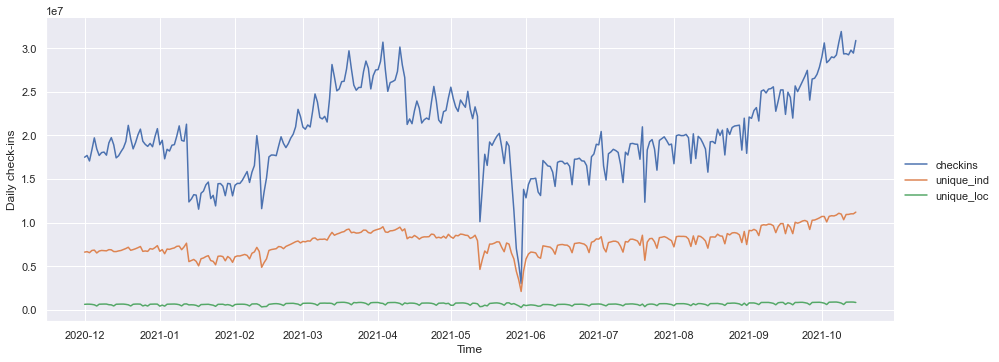

In [93]:
ax = sns.relplot(data=checkin_malaysia, kind='line',
            aspect=2.5, dashes=False)
ax.set_xlabels('Time')
ax.set_ylabels('Daily check-ins')

Note that `total checkins` > `unique_ind` > `unique_loc`. This is because a single person may check in the same unique location more than once, and the underlying assumption that there are more unique individuals than unique locations.

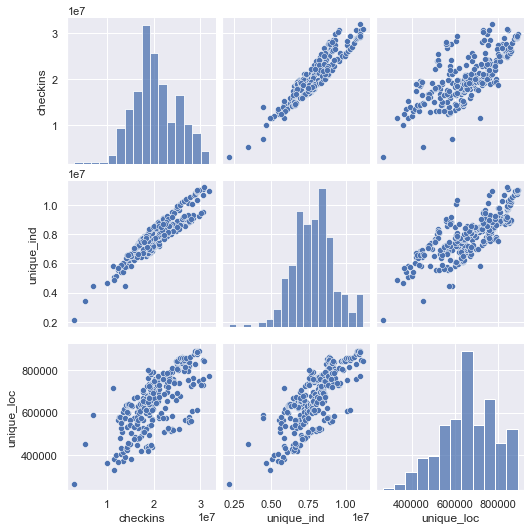

In [94]:
sns.pairplot(data=checkin_malaysia)

<AxesSubplot:>

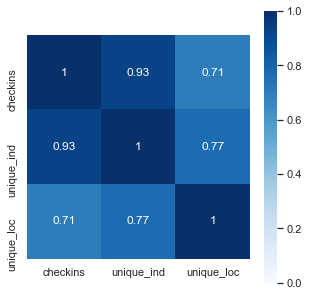

In [95]:
plt.figure(figsize=(5,5))
sns.heatmap(checkin_malaysia.corr(), cmap='Blues', annot=True, square=True, vmin=0, vmax=1)

As expected from the above pairplot and correlation matrix, the 3 variables (`checkins`, `unique_ind` and `unique_loc`) are strongly correlated with each other. 

<AxesSubplot:>

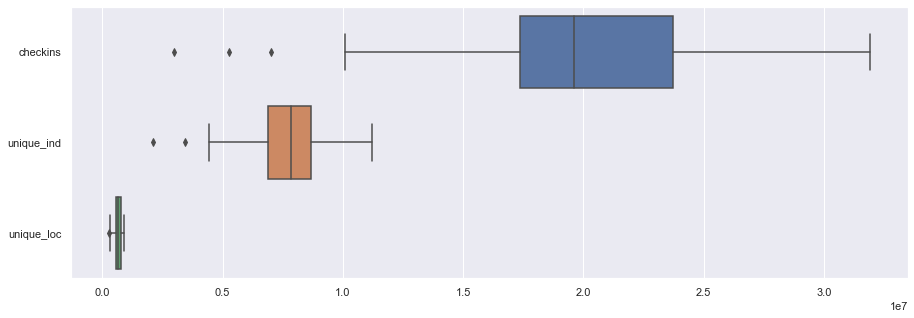

In [96]:
plt.figure(figsize=(15,5))
sns.boxplot(data=checkin_malaysia, orient='h')

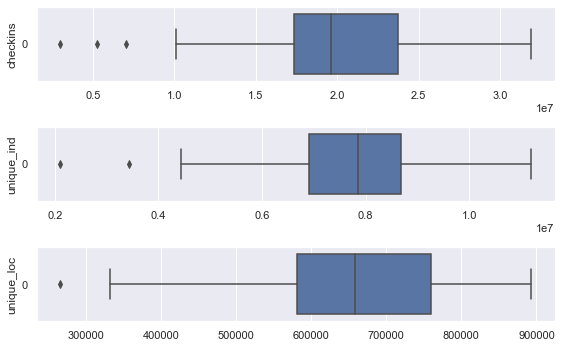

In [97]:
# boxplot for unique_loc 
fig, axes = plt.subplots(nrows=3, figsize=(8,5))

for col, ax in enumerate(axes):
    sns.boxplot(data=checkin_malaysia.iloc[:, col], orient='h', ax=ax)
    ax.set_ylabel(checkin_malaysia.columns[col])

fig.tight_layout()

The above boxplots show that there are only a few lower outliers for each of the variables. No upper outliers present for all 3 variables. Overall, there appears to be a slight left-skewness for the 3 distributions.

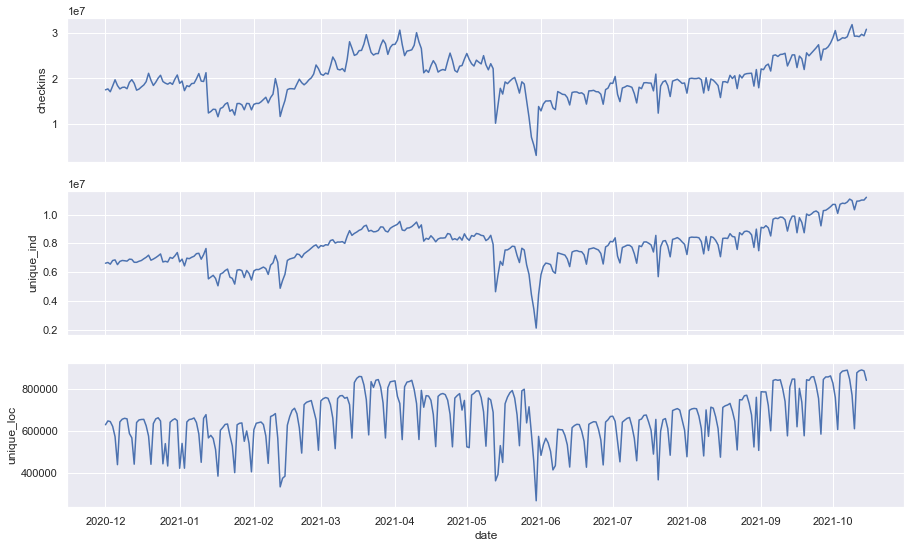

In [98]:
# time-series plot break down
fig, axes = plt.subplots(nrows=3, sharex=True, figsize=(15,9))

for col, ax in enumerate(axes):
    sns.lineplot(data=checkin_malaysia.iloc[:, col], dashes=False, ax=ax)

Looking at the above time-series graphs, there are a few notable points in time where the number of check-ins suddenly drop. Also all 3 variables exibit noticable periodicity. At first glance, these periods appear in 4-5 cycles a month, which is most likely related to weekday and weekend activity.

### Daily check-in data by state

In [99]:
checkin_state.head()

,state,checkins,unique_ind,unique_loc
date,,,,
2020-12-01,Johor,1996696,868521,81635
2020-12-01,Kedah,654634,341620,32760
2020-12-01,Kelantan,186507,108035,16298
2020-12-01,Melaka,544619,241854,21458
2020-12-01,Negeri Sembilan,559390,266899,22749


In [100]:
checkin_state.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5104 entries, 2020-12-01 to 2021-10-15
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   state       5104 non-null   object
 1   checkins    5104 non-null   int64 
 2   unique_ind  5104 non-null   int64 
 3   unique_loc  5104 non-null   int64 
dtypes: int64(3), object(1)
memory usage: 199.4+ KB


In [101]:
# get a list of state names
all_states = checkin_state['state'].unique().tolist()
all_states

['Johor',
 'Kedah',
 'Kelantan',
 'Melaka',
 'Negeri Sembilan',
 'Pahang',
 'Perak',
 'Perlis',
 'Pulau Pinang',
 'Sabah',
 'Sarawak',
 'Selangor',
 'Terengganu',
 'W.P. KualaLumpur',
 'W.P. Labuan',
 'W.P. Putrajaya']

In [102]:
# transform dataset from long to wide
checkin_state_wide = checkin_state.pivot_table(index='date', 
                                           columns='state', 
                                           values=['checkins', 'unique_ind', 'unique_loc']
                                          )
checkin_state_wide['checkins'].head()

state,Johor,Kedah,Kelantan,Melaka,Negeri Sembilan,Pahang,Perak,Perlis,Pulau Pinang,Sabah,Sarawak,Selangor,Terengganu,W.P. KualaLumpur,W.P. Labuan,W.P. Putrajaya
date,,,,,,,,,,,,,,,,
2020-12-01,1996696,654634,186507,544619,559390,628093,1073601,149180,1192308,740636,1287449,3926511,232768,3426041,53217,177083
2020-12-02,1975256,688360,201342,545887,561590,630934,1085104,158866,1204862,758731,1324152,3974328,217523,3455908,53562,177019
2020-12-03,1870470,674565,164364,527563,534832,627312,1063208,158714,1129316,743625,1274706,3876525,168587,3373169,52735,173618
2020-12-04,2031469,674162,164019,582972,594932,677057,1059563,169860,1236718,769607,1350621,4187530,189604,3718459,52603,200829
2020-12-05,2210008,731091,207482,634724,627448,682223,1138102,164804,1351212,777053,1437010,4595822,240941,3874221,53935,212102


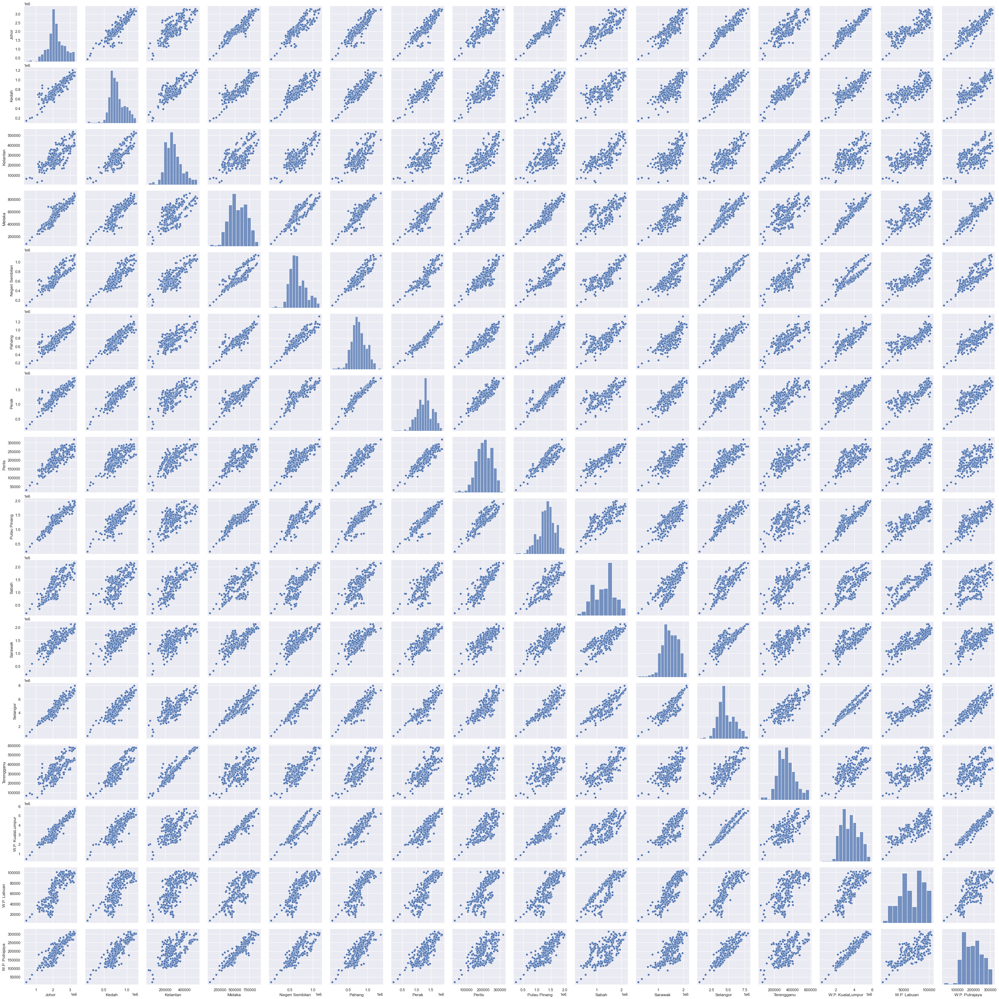

In [103]:
sns.pairplot(data=checkin_state_wide['checkins'])

In [104]:
cols = ['checkins', 'unique_ind', 'unique_loc']

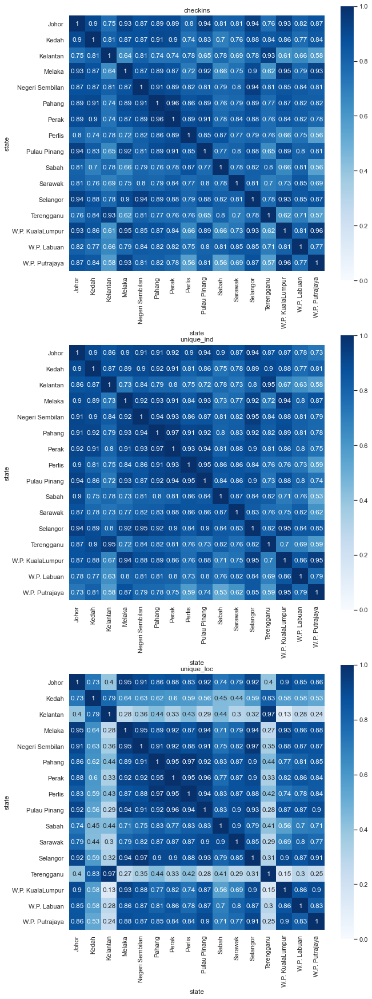

In [105]:
# plotting correlation matrices
fig, axes = plt.subplots(nrows=3, figsize=(10, 30))

for i, ax in enumerate(axes):
    sns.heatmap(checkin_state_wide[cols[i]].corr(), cmap='Blues', annot=True, square=True, vmin=0, vmax=1, ax=ax)
    ax.set_title(cols[i])

We can see from the above pairplot and subsequent correlation matrices, there is generally a moderate to strong correlation of daily check-ins between the states.
Note that for the case of unique location check-ins, states of *Terengganu*, *Kedah*, and *Kelantan* exhibit weak to moderate correlation to the other states but high correlation to each other.

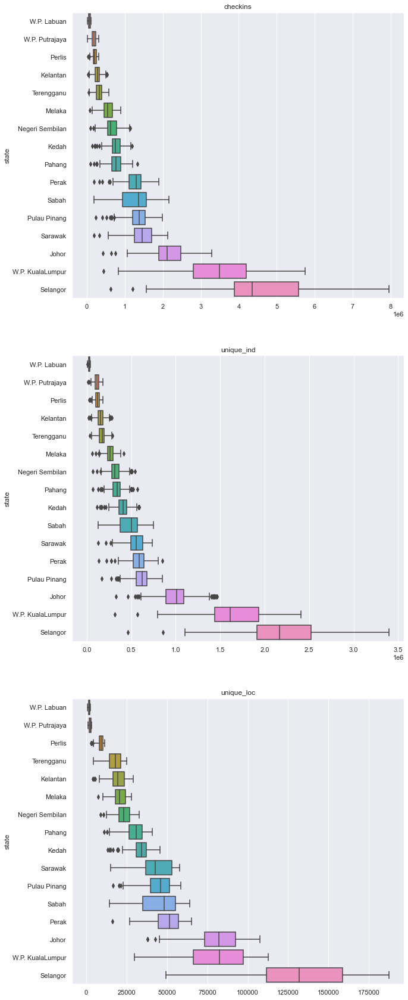

In [106]:
# plotting boxplots for each variable
fig, axes = plt.subplots(nrows=3, figsize=(10, 30))

for i, ax in enumerate(axes):
    sorted_index = checkin_state_wide[cols[i]].median().sort_values().index
    sns.boxplot(data=checkin_state_wide[cols[i]][sorted_index], orient='h', dodge=False, ax=ax)
    ax.set_title(cols[i])
#     ax.set_xscale("log")

From the boxplots above, we can see that the states of *Selangor*, *W.P. KualaLumpur* and *Johor*, have the highest numbers for all 3 check-in types. The state of *Selangor*, is the highest for all the check-in types as well.

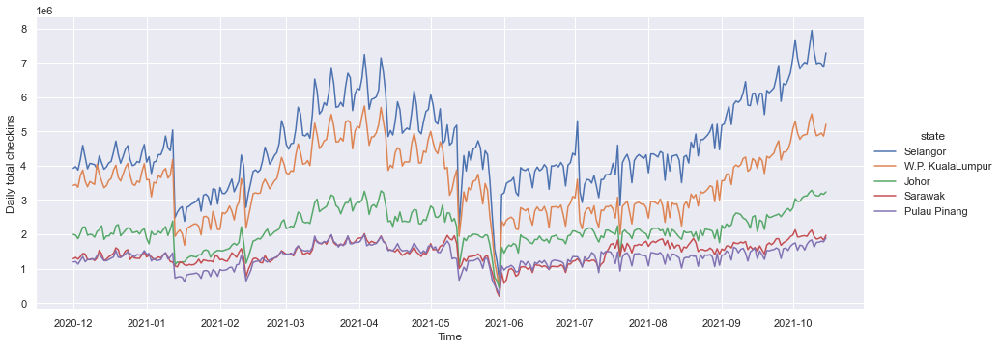

In [107]:
# selecting the top 5 states from the above plots to examine the time-series relationship
selected_states = ['Selangor', 'W.P. KualaLumpur', 'Johor', 'Sarawak', 'Pulau Pinang']
ax = sns.relplot(data=checkin_state_wide['checkins'].loc[:,selected_states], kind='line',
            aspect=2.5, dashes=False)
ax.set_xlabels('Time')
ax.set_ylabels('Daily total checkins')

In [108]:
# Taking the ratio of unique individual check-ins to unique location check-ins
checkin_state['ind_per_loc'] = checkin_state['unique_ind'] / checkin_state['unique_loc']

checkin_ratio_wide = checkin_state[['state', 'ind_per_loc']].pivot_table(index='date', columns='state', values='ind_per_loc')


Text(0.5, 0, 'Daily average number of unique check-ins per location')

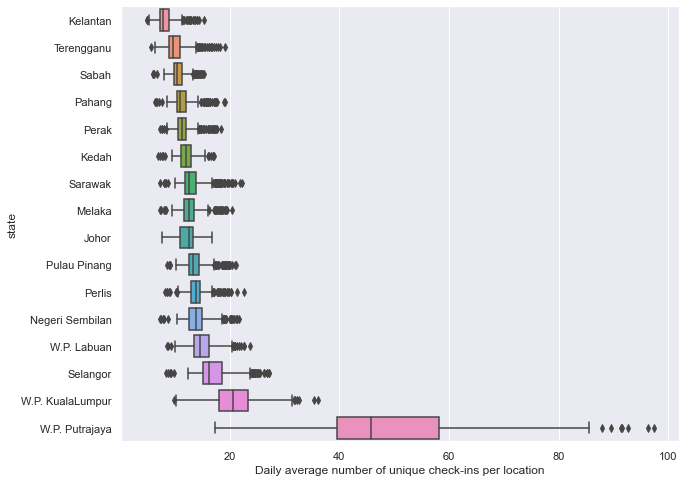

In [109]:
# boxplot of ratio values
fig, ax = plt.subplots(figsize=(10, 8))
sorted_index = checkin_ratio_wide.median().sort_values().index
sns.boxplot(data=checkin_ratio_wide[sorted_index], orient='h', dodge=False, ax=ax)
ax.set_xlabel('Daily average number of unique check-ins per location')

From this analysis, we can see that the ratio of unique individual check-ins to unique locations are extremely high in Putrajaya. This is most likely due to the fact that, despite the federal state of *Putrajaya* having one of the smallest population counts, it also holds almost all of Malaysia's governmental ministries and bodies. We can infer that most of the public servants who work in these ministry offices come from the surrounding states of *Selangor* and *W.P. Kuala Lumpur*.

### Trace Malaysia data (Daily casual contacts)

In [110]:
trace_malaysia.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 227 entries, 2021-01-03 to 2021-10-15
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   casual_contacts  227 non-null    int64  
 1   hide_large       177 non-null    float64
 2   hide_small       177 non-null    float64
dtypes: float64(2), int64(1)
memory usage: 7.1 KB


In [111]:
trace_malaysia.head()

,casual_contacts,hide_large,hide_small
date,,,
2021-01-03,7847,NaN,NaN
2021-02-03,6419,NaN,NaN
2021-03-03,6903,NaN,NaN
2021-04-03,7000,NaN,NaN
2021-05-03,9152,NaN,NaN


Text(0, 0.5, 'Daily casual contacts')

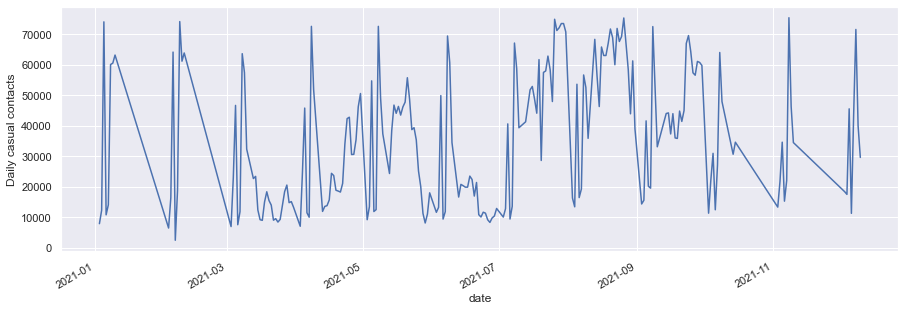

In [112]:
f, ax = plt.subplots(figsize=(15, 5))
trace_malaysia['casual_contacts'].plot(ax=ax)
ax.set_ylabel('Daily casual contacts')

The line plot above shows the reported daily casual contacts over time. By visual inspection, we can tell that some entries are not included, based on the presence of perfect straight lines. Note that there should be 255 days (inclusive) between 2021-01-03 to 2021-10-15, and this dataset only has 227 entries. Considering this and the fact that over half of the entries for the other two variables (`hide_large` and `hide_small`) are null, we will most likely refrain from using this dataset in further analysis.

### Daily check-in times for Malaysia

In [113]:
checkin_malaysia_time.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-01,6395,4052,2611,2005,1660,1574,1371,1421,1736,3316,7961,25196,52503,130025,260459,487275,589956,622652,607775,601831,622364,615467,627128,669364,801754,831169,848726,696972,649743,613763,587982,549878,528499,497217,541013,591255,630124,602570,533079,499436,484926,400220,287114,165690,95964,58921,34247,15906
2020-12-02,6615,3957,2682,1974,1721,1581,1438,1480,1867,3378,8253,26497,56792,139687,277312,508220,612710,645687,613719,601815,619992,617798,631502,674280,811867,837592,851573,696530,652126,618349,595056,556019,527820,502556,550235,596717,639260,611787,539724,503532,483593,397703,287540,165463,96497,60809,35813,16608
2020-12-03,6920,3943,2936,2150,1755,1490,1499,1590,1842,3500,8169,25687,55644,135933,268926,487973,584597,610616,589348,586045,608647,604825,617892,659293,792076,818396,836594,682480,636611,594575,568155,538281,507600,475773,515214,556486,589587,570865,521526,492463,468638,381225,275301,159941,95561,61119,36086,17350
2020-12-04,7404,4759,3064,2223,1791,1699,1543,1614,2115,3511,8441,27177,57741,136834,269189,483225,586855,625518,608907,608809,635336,631601,644903,683592,825833,923503,884577,689087,647664,620169,607824,582090,555542,522614,559748,603054,645704,636042,587843,562922,552979,464684,347722,211850,128239,81293,48715,23330
2020-12-05,9520,5907,3871,2662,2181,1769,1727,1718,2237,3696,8345,25391,53247,121701,223646,373478,470743,537549,589369,627339,695612,710804,743547,780108,852867,843240,845548,792314,771881,749059,731588,706541,692332,659717,681027,704550,726066,699774,638364,607971,597757,501530,375434,229508,138917,89817,53057,26056


In [114]:
checkin_malaysia_time.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 319 entries, 2020-12-01 to 2021-10-15
Data columns (total 48 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   0       319 non-null    int64
 1   1       319 non-null    int64
 2   2       319 non-null    int64
 3   3       319 non-null    int64
 4   4       319 non-null    int64
 5   5       319 non-null    int64
 6   6       319 non-null    int64
 7   7       319 non-null    int64
 8   8       319 non-null    int64
 9   9       319 non-null    int64
 10  10      319 non-null    int64
 11  11      319 non-null    int64
 12  12      319 non-null    int64
 13  13      319 non-null    int64
 14  14      319 non-null    int64
 15  15      319 non-null    int64
 16  16      319 non-null    int64
 17  17      319 non-null    int64
 18  18      319 non-null    int64
 19  19      319 non-null    int64
 20  20      319 non-null    int64
 21  21      319 non-null    int64
 22  22      319 non-null    int64
 

In [115]:
checkin_times = checkin_malaysia_time.copy()
hours = checkin_times.columns.to_numpy().astype('float') / 2 # convertin from half-hours to hours in a day
checkin_times.columns = pd.Index(hours)
checkin_times.columns.name = 'hour of the day'
checkin_times

hour of the day,0.0,0.5,1.0,1.5,2.0,2.5,3.0,3.5,4.0,4.5,5.0,5.5,6.0,6.5,7.0,7.5,8.0,8.5,9.0,9.5,10.0,10.5,11.0,11.5,12.0,12.5,13.0,13.5,14.0,14.5,15.0,15.5,16.0,16.5,17.0,17.5,18.0,18.5,19.0,19.5,20.0,20.5,21.0,21.5,22.0,22.5,23.0,23.5
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-01,6395,4052,2611,2005,1660,1574,1371,1421,1736,3316,7961,25196,52503,130025,260459,487275,589956,622652,607775,601831,622364,615467,627128,669364,801754,831169,848726,696972,649743,613763,587982,549878,528499,497217,541013,591255,630124,602570,533079,499436,484926,400220,287114,165690,95964,58921,34247,15906
2020-12-02,6615,3957,2682,1974,1721,1581,1438,1480,1867,3378,8253,26497,56792,139687,277312,508220,612710,645687,613719,601815,619992,617798,631502,674280,811867,837592,851573,696530,652126,618349,595056,556019,527820,502556,550235,596717,639260,611787,539724,503532,483593,397703,287540,165463,96497,60809,35813,16608
2020-12-03,6920,3943,2936,2150,1755,1490,1499,1590,1842,3500,8169,25687,55644,135933,268926,487973,584597,610616,589348,586045,608647,604825,617892,659293,792076,818396,836594,682480,636611,594575,568155,538281,507600,475773,515214,556486,589587,570865,521526,492463,468638,381225,275301,159941,95561,61119,36086,17350
2020-12-04,7404,4759,3064,2223,1791,1699,1543,1614,2115,3511,8441,27177,57741,136834,269189,483225,586855,625518,608907,608809,635336,631601,644903,683592,825833,923503,884577,689087,647664,620169,607824,582090,555542,522614,559748,603054,645704,636042,587843,562922,552979,464684,347722,211850,128239,81293,48715,23330
2020-12-05,9520,5907,3871,2662,2181,1769,1727,1718,2237,3696,8345,25391,53247,121701,223646,373478,470743,537549,589369,627339,695612,710804,743547,780108,852867,843240,845548,792314,771881,749059,731588,706541,692332,659717,681027,704550,726066,699774,638364,607971,597757,501530,375434,229508,138917,89817,53057,26056
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-11,9460,5744,4463,3689,3197,3075,3079,3588,4834,9772,22760,82504,151756,385584,650547,1220620,1230165,1153450,1063043,1025564,1064543,1050316,1070429,1113103,1238952,1249179,1259197,1061723,1013238,963433,924952,874205,852383,799572,885963,946569,1000115,1001211,897224,786076,721357,557793,402916,244725,152675,101462,61242,30808
2021-10-12,10921,6884,5231,4656,3904,3446,3425,4112,5214,10291,23537,84793,156228,396270,670020,1242500,1255968,1173670,1071338,1019546,1050360,1030715,1043065,1093021,1227861,1231682,1238283,1045443,993617,940996,902907,853326,833963,795323,881260,944188,996832,989994,890018,793495,727388,562204,407811,249769,157067,104071,62586,31220
2021-10-13,11115,6808,5261,4232,3873,3757,3729,4383,5472,10917,24457,86424,160873,408929,691545,1270561,1279449,1194583,1085874,1033723,1061405,1038167,1053937,1104210,1238643,1246387,1248583,1052656,1005028,949083,905744,858835,845532,809219,902705,974196,1031281,1022210,899735,806588,747940,589613,429814,266129,169456,112041,68225,33828


<AxesSubplot:xlabel='date', ylabel='hour of the day'>

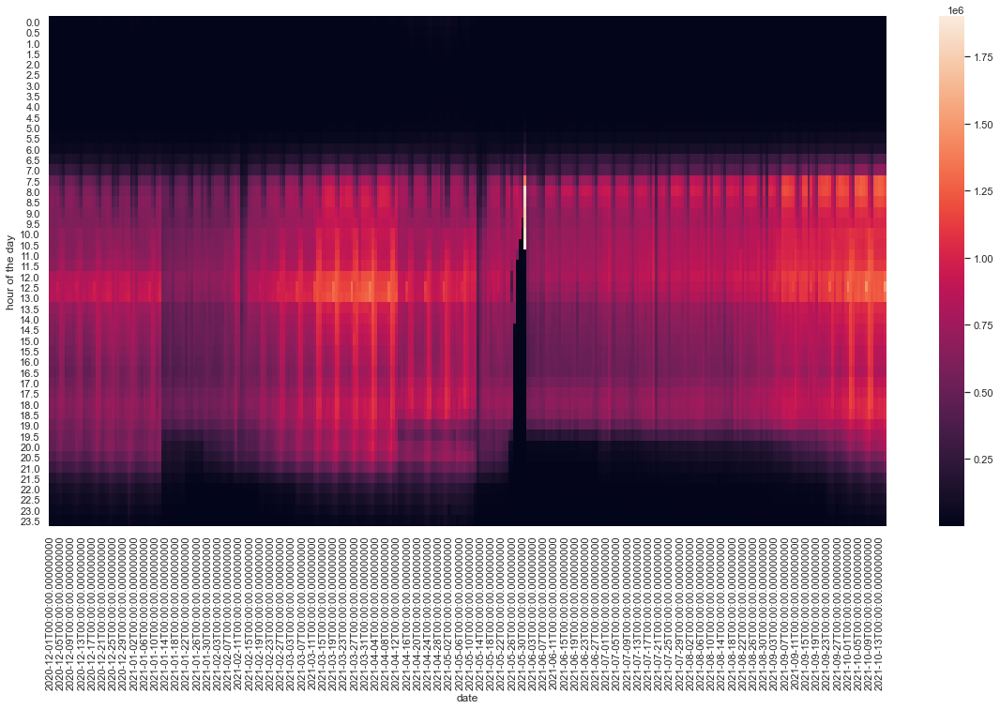

In [116]:
f, ax = plt.subplots(figsize=(20, 10))
sns.heatmap(checkin_times.transpose(), ax=ax)
# ax.yaxis.set_ticklabels(checkin_malaysia_time.index)

The above heatmap shows the daily total check-ins by half-hour intervals. We can clearly see that daily check-ins begin around 6:30 am - 8 am, which is when most workplace shifts begin. The brightest areas (higher number of check-ins) usually takes place around lunchtime (11:30 am - 1:30pm) and tea / dinner time (5:30 pm - 8pm). There appears to be a period of sudden and unsually low number of daily-checkins around the end of May 2021. Also around the same time period, the brightest part of this heatmap appears to be on a single day but abruptly ends around 10:30 AM. We are unable to explain this anomaly.

## Vaccination

### Loading the necessary vaccination dataset

In [117]:
malaysia_map = gpd.read_file('random_dataset/mys_admbnda_adm1_unhcr_20210211.shp')
vax_school = pd.read_csv('covid19-public/vaccination/vax_school.csv')

<AxesSubplot:>

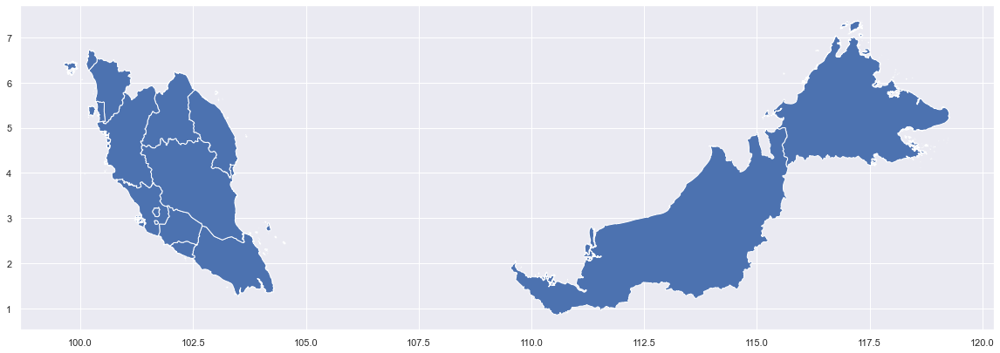

In [118]:
malaysia_map.plot()

In [119]:
malaysia_map.head()

,Shape_Leng,Shape_Area,ADM1_EN,ADM1_PCODE,ADM1_REF,ADM1ALT1EN,ADM1ALT2EN,ADM0_EN,ADM0_PCODE,date,validOn,validTo,geometry
0,10.541451,1.556311,Johor,MY01,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((103.42134 1.30583, 103.42113 1..."
1,8.615689,0.777377,Kedeh,MY02,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((100.32889 5.66444, 100.32917 5..."
2,7.185704,1.234524,Kelantan,MY03,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((102.17395 6.20126, 102.17395 6..."
3,2.067451,0.134483,Melaka,MY06,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((102.33500 2.04833, 102.33528 2..."
4,3.620969,0.542415,Negeri,MY07,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((101.79472 2.51389, 101.79444 2..."


In [120]:
crs = {'init': 'epsg:4326'}

In [121]:
vax_school.head()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose1_student,dose2_student,dose1_12,dose1_13,dose1_14,dose1_15,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.196633,101.255932,100.0,100.0,69.6,0.0,68.8,100.0,100.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.178276,101.200617,100.0,100.0,66.2,0.0,66.2,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,ABA0003,SK BANIR,8,56,35400,4.204361,101.181893,100.0,100.0,50.0,0.0,50.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,ABA0004,SK TEMOH,8,56,35350,4.235841,101.172819,100.0,100.0,77.8,5.6,77.8,NaN,NaN,NaN,NaN,NaN,NaN,5.6,NaN,NaN,NaN,NaN,NaN,NaN
4,ABA0005,SK CHENDERIANG,8,56,35300,4.267980,101.240556,100.0,100.0,78.4,0.0,78.4,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN


1 - Johor, 2 - Kedah, 3 - Kelantan, 4 - Melaka, 5 - Negeri Sembilan, 6 - Pahang, 7 - Pulau Pinang, 8 - Perak, 9 - Perlis, 10 - Selangor, 11 - Terengganu, 12 - Sabah, 13 - Sarawak, 14 - W.P. Kuala Lumpur, 15 - W.P. Labuan, 16 - W.P. Putrajaya

In [122]:
# check schools from Putrajaya, uncomment to see
# vax_school[vax_school['state'] == 16].head()

In [123]:
vax_school['state'] = vax_school['state'].replace([1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16], ['Johor', 'Kedah', 'Kelantan', 'Melaka', 'Negeri Sembilan', 'Pahang', 'Pulau Pinang', 'Perak', 'Perlis', 'Selangor', 'Terengganu', 'Sabah', 'Sarawak', 'W.P. Kuala Lumpur', 'W.P. Labuan', 'W.P. Putrajaya'])

In [124]:
vax_school['state'].unique()

array(['Perak', 'Selangor', 'Pahang', 'Kelantan', 'Johor', 'Kedah',
       'Melaka', 'Negeri Sembilan', 'Pulau Pinang', 'Perlis',
       'Terengganu', 'W.P. Kuala Lumpur', 'W.P. Labuan', 'W.P. Putrajaya',
       'Sabah', 'Sarawak'], dtype=object)

In [125]:
vax_school.isna().sum()

code                0
school              0
state               0
district            0
postcode            0
lat                 0
lon                 0
dose1_staff         0
dose2_staff         0
dose1_student      43
dose2_student      43
dose1_12         1691
dose1_13         6665
dose1_14         7241
dose1_15         7665
dose1_16         7803
dose1_17         7799
dose1_18         8361
dose2_12         1691
dose2_13         6665
dose2_14         7241
dose2_15         7665
dose2_16         7803
dose2_17         7799
dose2_18         8361
dtype: int64

We can see that 43 schools listed there does not have any information regarding doses taken by student. Since it's only 0.43% of the row is incomplete, we have decided to drop the data with null value on students.

We did not drop rows that has null values on the other column such as dose1_12 and dose2_12, as not all school do have students at that age enrolls there. (Namely SK only has students around age 7-12)

In [126]:
vax_school.dropna(subset = ["dose1_student"], inplace=True)

In [127]:
geometry = [Point(xy) for xy in zip(vax_school['lon'], vax_school['lat'])]
geometry[:3]

In [128]:
geo_df = gpd.GeoDataFrame(vax_school, crs=crs, geometry=geometry)
geo_df.head()

C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\pyproj\crs\crs.py:68: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose1_student,dose2_student,dose1_12,dose1_13,dose1_14,dose1_15,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18,geometry
0,ABA0001,SK TOH TANDEWA SAKTI,Perak,56,35000,4.196633,101.255932,100.0,100.0,69.6,0.0,68.8,100.0,100.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,POINT (101.25593 4.19663)
1,ABA0002,SK PENDITA ZA'BA,Perak,56,35400,4.178276,101.200617,100.0,100.0,66.2,0.0,66.2,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,POINT (101.20062 4.17828)
2,ABA0003,SK BANIR,Perak,56,35400,4.204361,101.181893,100.0,100.0,50.0,0.0,50.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,POINT (101.18189 4.20436)
3,ABA0004,SK TEMOH,Perak,56,35350,4.235841,101.172819,100.0,100.0,77.8,5.6,77.8,NaN,NaN,NaN,NaN,NaN,NaN,5.6,NaN,NaN,NaN,NaN,NaN,NaN,POINT (101.17282 4.23584)
4,ABA0005,SK CHENDERIANG,Perak,56,35300,4.267980,101.240556,100.0,100.0,78.4,0.0,78.4,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,POINT (101.24056 4.26798)


<AxesSubplot:>

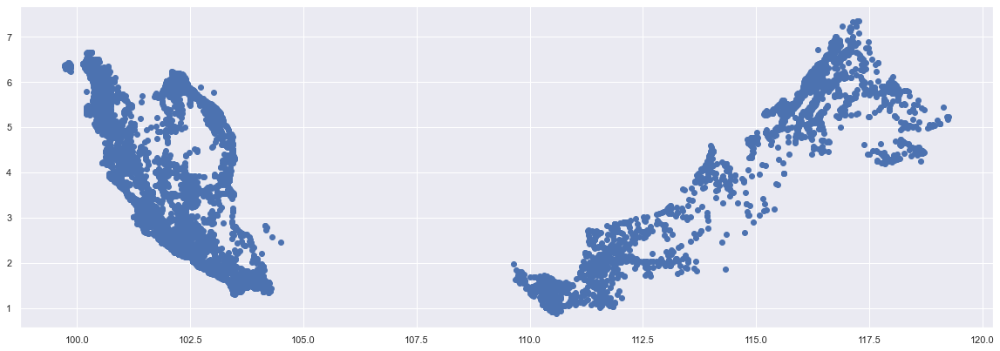

In [129]:
geo_df['geometry'].plot(aspect=1)

In [130]:
malaysia_map

,Shape_Leng,Shape_Area,ADM1_EN,ADM1_PCODE,ADM1_REF,ADM1ALT1EN,ADM1ALT2EN,ADM0_EN,ADM0_PCODE,date,validOn,validTo,geometry
0,10.541451,1.556311,Johor,MY01,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((103.42134 1.30583, 103.42113 1..."
1,8.615689,0.777377,Kedeh,MY02,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((100.32889 5.66444, 100.32917 5..."
2,7.185704,1.234524,Kelantan,MY03,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((102.17395 6.20126, 102.17395 6..."
3,2.067451,0.134483,Melaka,MY06,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((102.33500 2.04833, 102.33528 2..."
4,3.620969,0.542415,Negeri,MY07,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((101.79472 2.51389, 101.79444 2..."
5,10.750731,2.919169,Pahang,MY08,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((103.45879 3.46532, 103.45823 3..."
6,11.358448,1.707114,Perak,MY09,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((100.10291 3.97632, 100.10300 3..."
7,1.361590,0.067320,Perlis,MY10,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"POLYGON ((100.12444 6.40509, 100.12567 6.40631..."
8,2.616795,0.086223,Pulau Pinang,MY11,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((100.17973 5.23083, 100.18000 5..."
9,38.328468,6.028039,Sabah,MY12,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((118.62939 4.11226, 118.62906 4..."


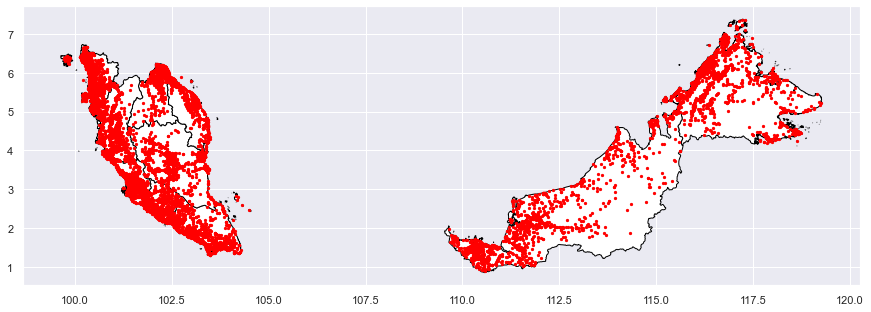

In [131]:
fig, ax = plt.subplots(figsize=(15,15))
ax.set_aspect('equal')

malaysia_map.plot(ax=ax, color='white', edgecolor='black')
geo_df.plot(ax=ax, marker='o', color='red', markersize=5)

plt.show()

The map above shows the distribution of schools in Malaysia (shown as red dots).

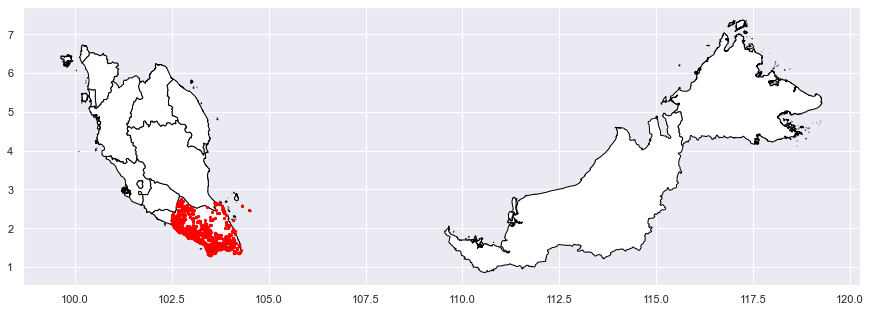

In [132]:
fig, ax = plt.subplots(figsize=(15,15))
ax.set_aspect('equal')

malaysia_map.plot(ax=ax, color='white', edgecolor='black')
geo_df[geo_df['state'] == 'Johor'].plot(ax=ax, marker='o', color='red', markersize=5)

plt.show()

### Mean vaccination rate in schools amongst students and staffs

To evaluate how safe it is if the school reopens, we considered looking at the vaccination rate at each schools for staffs and students. We would look at the mean percentage by states, as schools would reopen by states.

In [133]:
vax_school_trim = vax_school.groupby('state', as_index=False).mean()
vax_school_trim

,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose1_student,dose2_student,dose1_12,dose1_13,dose1_14,dose1_15,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,Johor,4.663567,83273.090448,1.871637,103.306228,98.789096,97.875148,75.375063,7.295351,71.399702,90.526835,93.192722,95.930970,96.869504,97.803571,97.936441,1.459921,3.543349,3.532075,5.275746,47.165248,48.625000,84.924153
1,Kedah,15.278667,7806.230667,5.863783,100.491550,98.611333,97.647200,77.353467,10.798533,73.683468,90.794444,91.833721,93.708629,96.630846,97.129353,96.404459,2.170502,6.583681,6.993798,8.796954,67.294527,71.342289,90.959873
2,Kelantan,28.251678,16905.781879,5.846821,102.194673,98.486074,97.555537,73.380369,10.148658,67.467804,87.378188,85.026957,93.735776,94.921143,96.346591,96.639655,2.149680,16.030537,2.854348,28.650431,54.300000,59.311932,87.006034
3,Melaka,35.114650,76541.592357,2.287706,102.274664,99.110191,98.680255,78.734713,11.257006,73.843678,96.384459,95.714000,97.653333,97.444737,98.202632,97.580645,4.341762,24.537838,9.047000,47.793333,42.153947,41.761842,91.282258
4,Negeri Sembilan,40.463158,71729.250526,2.703546,102.115100,98.883789,98.401684,62.933263,8.924632,54.041253,88.326636,92.681429,97.396667,96.858871,97.453226,96.705319,2.265013,24.620093,4.713571,37.708333,46.272581,47.893548,85.350000
5,Pahang,49.282225,27866.971506,3.664863,102.575915,98.891588,98.105699,75.018589,11.657666,69.073846,90.679495,91.046748,95.665126,96.186364,97.311675,98.604724,1.086838,15.920820,6.036585,24.140336,82.452020,82.930964,93.717323
6,Perak,60.772187,33531.134492,4.539639,100.949010,98.476029,97.532296,74.874016,8.849131,70.600437,88.360665,90.553623,93.163158,96.335081,97.476613,96.625854,1.257268,2.384765,2.281739,3.427530,68.699194,72.248387,87.131220
7,Perlis,67.000000,1975.480769,6.452178,100.224524,98.374038,97.255769,78.136538,11.350000,72.935714,93.638235,92.106667,95.856667,97.000000,98.090000,96.552174,1.882143,0.885294,1.346667,4.873333,84.703333,73.990000,90.430435
8,Pulau Pinang,70.386935,12640.175879,5.379311,100.380213,98.860553,97.893719,78.731156,7.077387,74.164169,88.758553,91.870229,93.380000,95.426400,95.727559,97.350549,0.761889,2.047368,2.824427,2.370000,31.588000,34.809449,82.841758
9,Sabah,85.858249,89723.615802,5.648841,116.825116,97.794655,96.231139,81.213943,52.096437,79.518310,85.306538,88.784649,90.684651,91.935616,93.375455,94.243275,49.216197,60.208462,66.658772,66.937674,74.435160,78.201818,87.040936


### Students

<AxesSubplot:xlabel='dose1_student', ylabel='state'>

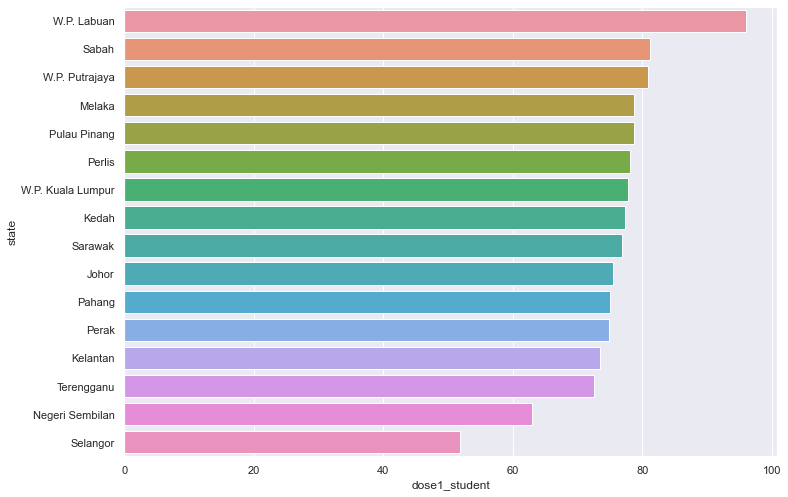

In [134]:
vax_school_trim = vax_school_trim.sort_values('dose1_student', ascending=False)
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(data=vax_school_trim, x='dose1_student', y='state', orient='h')
#sns.factorplot(x='state', y='dose1_student', data=df)

<AxesSubplot:xlabel='dose2_student', ylabel='state'>

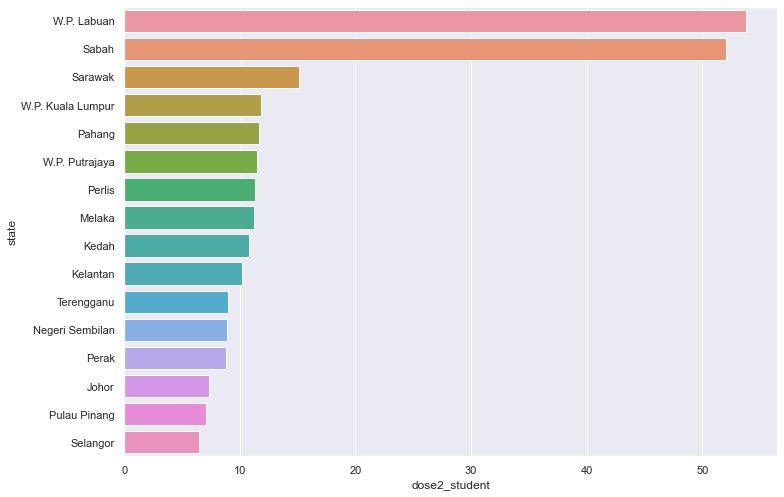

In [135]:
vax_school_trim = vax_school_trim.sort_values('dose2_student', ascending=False)
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(data=vax_school_trim, x='dose2_student', y='state', orient='h')

We can see that most of the students (>70%) have at least taken their first dose for all states. However, only W.P. Labuan have a high rate of full vaccinations for students (>50%), with more than half of the states having only close to or still less than 10% of their students fully vaccinated.

### Staffs

<AxesSubplot:xlabel='dose1_staff', ylabel='state'>

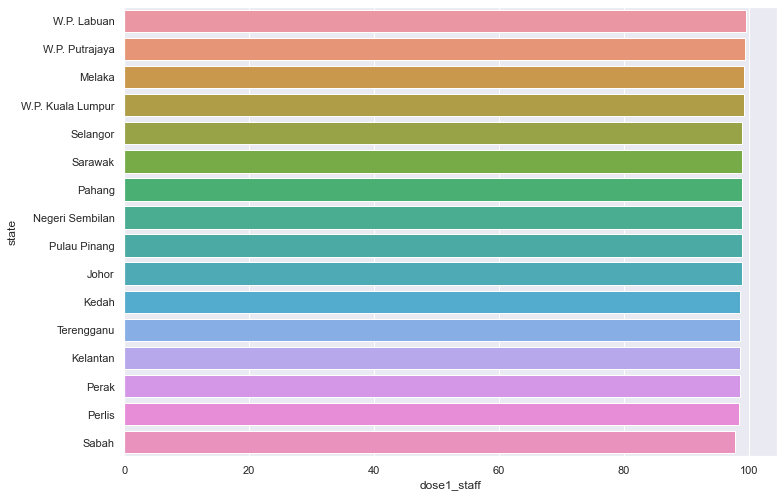

In [136]:
vax_school_trim = vax_school_trim.sort_values('dose1_staff', ascending=False)
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(data=vax_school_trim, x='dose1_staff', y='state', orient='h')

<AxesSubplot:xlabel='dose2_staff', ylabel='state'>

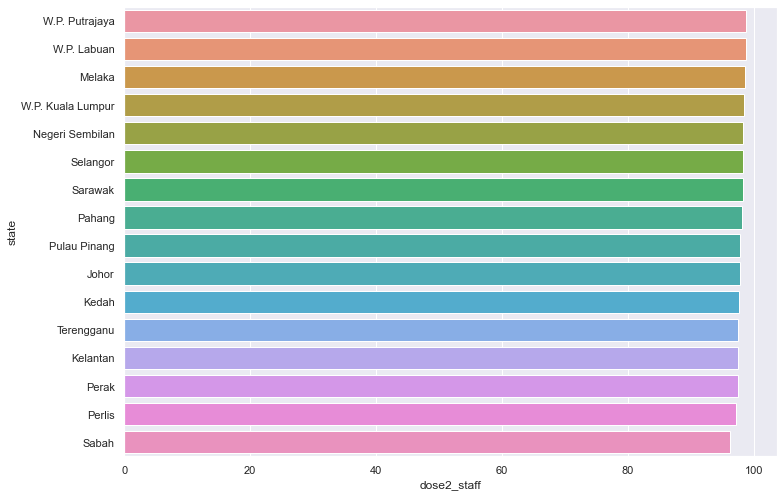

In [137]:
vax_school_trim = vax_school_trim.sort_values('dose2_staff', ascending=False)
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(data=vax_school_trim, x='dose2_staff', y='state', orient='h')

We can see that most of the staffs (>90%) have completed their vaccination.

# EDA on CITF Dataset

## Loading Dataset

In [138]:
# Registration
vaxreg_malaysia = pd.read_csv('citf-public/registration/vaxreg_malaysia.csv')
vaxreg_state = pd.read_csv('citf-public/registration/vaxreg_state.csv')

vaxreg_malaysia['date'] = pd.to_datetime(vaxreg_malaysia['date'], errors='raise')
vaxreg_state['date'] = pd.to_datetime(vaxreg_state['date'], errors='raise')

# vaccination 
vax_malaysia = pd.read_csv('citf-public/vaccination/vax_malaysia.csv')
vax_state = pd.read_csv('citf-public/vaccination/vax_state.csv')

vax_malaysia['date'] = pd.to_datetime(vax_malaysia['date'], errors='raise')
vax_state['date'] = pd.to_datetime(vax_state['date'], errors='raise')

In [139]:
vaxreg_malaysia.head()

,date,state,total,phase2,mysj,call,web,children,elderly,comorb,oku
0,2021-06-24,Malaysia,16191488,5219793,14910368,10668,1270452,776980,2787690,3938517,298917
1,2021-06-25,Malaysia,16321185,5253580,15031571,10779,1278835,797921,2802744,3964444,301849
2,2021-06-26,Malaysia,16431724,5282795,15136062,10892,1284770,815984,2815665,3986607,304571
3,2021-06-27,Malaysia,16515196,5304420,15231554,10808,1272834,830643,2824735,4003420,306740
4,2021-06-28,Malaysia,16630764,5333905,15335726,10933,1284105,842985,2835474,4027560,309623


In [140]:
vaxreg_state.head()

,date,state,total,phase2,mysj,call,web,children,elderly,comorb,oku
0,2021-06-24,Johor,2024149,657731,1880609,1167,142373,94096,373226,477510,39807
1,2021-06-24,Kedah,938187,340264,850376,855,86956,39636,181729,264154,20150
2,2021-06-24,Kelantan,621203,223260,527284,426,93493,26305,119608,173570,12921
3,2021-06-24,Melaka,510641,179964,484164,436,26041,25638,98045,138618,13547
4,2021-06-24,Negeri Sembilan,633026,229995,591847,592,40587,32396,125029,179280,13902


In [141]:
vax_malaysia.head()

,date,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending
0,2021-02-24,60,0,60,0,0,0,60,0,60,0,0,0,60,0,0,0,0,0,0,0
1,2021-02-25,1146,0,1146,0,0,0,1206,0,1206,0,0,0,1146,0,0,0,0,0,0,0
2,2021-02-26,4115,1,4116,0,0,0,5321,1,5322,0,0,0,4115,1,0,0,0,0,0,0
3,2021-02-27,6723,1,6724,0,0,0,12044,2,12046,0,0,0,6723,1,0,0,0,0,0,0
4,2021-02-28,6699,3,6702,0,0,0,18743,5,18748,0,0,0,6699,3,0,0,0,0,0,0


In [142]:
vax_state.head()

,date,state,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending
0,2021-02-24,Johor,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2021-02-24,Kedah,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2021-02-24,Kelantan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,2021-02-24,Melaka,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,2021-02-24,Negeri Sembilan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## Vaccination Registration Data

In [143]:
vaxreg_malaysia.dtypes

date        datetime64[ns]
state               object
total                int64
phase2               int64
mysj                 int64
call                 int64
web                  int64
children             int64
elderly              int64
comorb               int64
oku                  int64
dtype: object

In [144]:
vaxreg_malaysia.isnull().sum()

date        0
state       0
total       0
phase2      0
mysj        0
call        0
web         0
children    0
elderly     0
comorb      0
oku         0
dtype: int64

In [145]:
analysis = vaxreg_malaysia.copy()
analysis.set_index('date', inplace=True)
analysis.head()

,state,total,phase2,mysj,call,web,children,elderly,comorb,oku
date,,,,,,,,,,
2021-06-24,Malaysia,16191488,5219793,14910368,10668,1270452,776980,2787690,3938517,298917
2021-06-25,Malaysia,16321185,5253580,15031571,10779,1278835,797921,2802744,3964444,301849
2021-06-26,Malaysia,16431724,5282795,15136062,10892,1284770,815984,2815665,3986607,304571
2021-06-27,Malaysia,16515196,5304420,15231554,10808,1272834,830643,2824735,4003420,306740
2021-06-28,Malaysia,16630764,5333905,15335726,10933,1284105,842985,2835474,4027560,309623


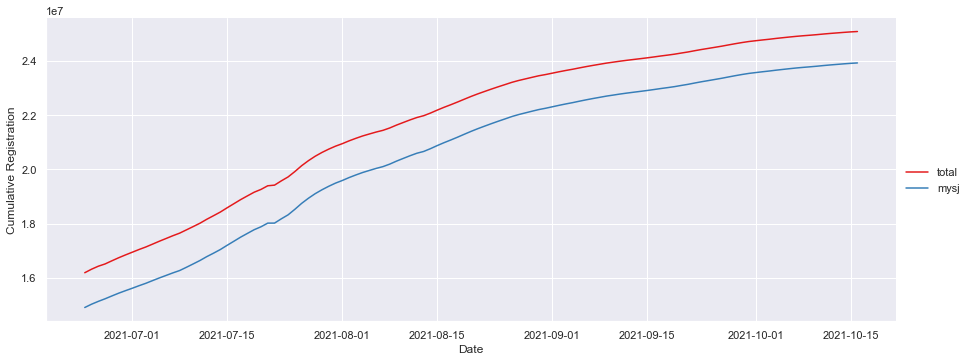

In [146]:
ax = sns.relplot(data=analysis.loc[:,['total', 'mysj']], kind='line',
            aspect=2.5, dashes=False, palette='Set1')
#ax.axhline(population['pop'][0], ls='--', linewidth=3, color='red')
# ax = ax.map(lambda y, **kw: plt.axhline(y.mean(), color="k"), 'COUNT')
#ax.refline(y=population['pop'][0])

#ax.axhline()

ax.set_xlabels('Date')
ax.set_ylabels('Cumulative Registration')

In [147]:
analysis.head()

,state,total,phase2,mysj,call,web,children,elderly,comorb,oku
date,,,,,,,,,,
2021-06-24,Malaysia,16191488,5219793,14910368,10668,1270452,776980,2787690,3938517,298917
2021-06-25,Malaysia,16321185,5253580,15031571,10779,1278835,797921,2802744,3964444,301849
2021-06-26,Malaysia,16431724,5282795,15136062,10892,1284770,815984,2815665,3986607,304571
2021-06-27,Malaysia,16515196,5304420,15231554,10808,1272834,830643,2824735,4003420,306740
2021-06-28,Malaysia,16630764,5333905,15335726,10933,1284105,842985,2835474,4027560,309623


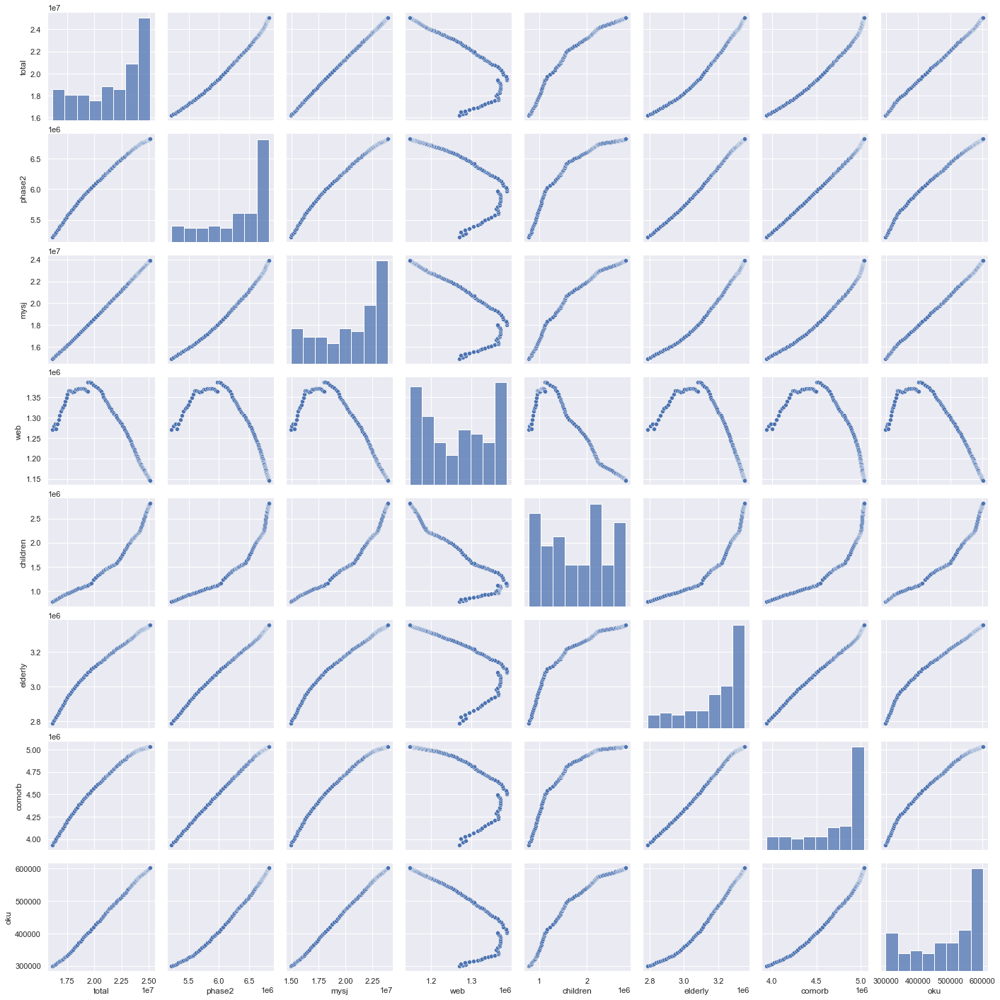

In [148]:
sns.pairplot(data=analysis[['state', 'total', 'phase2', 'mysj', 'web', 'children', 'elderly', 'comorb', 'oku']])

In [149]:
analysis['daily_reg'] = analysis['total'].diff()
analysis['7_rolling_avg'] = analysis['daily_reg'].rolling(7).mean()

In [150]:
analysis.dropna(inplace=True)

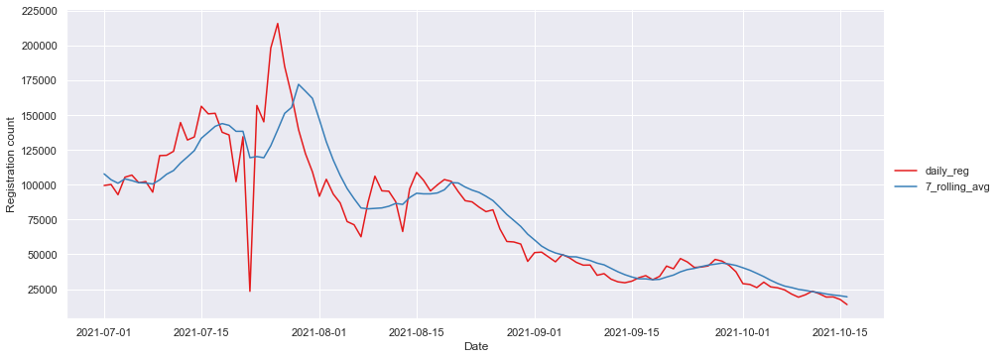

In [151]:
ax = sns.relplot(data=analysis.loc[:,['daily_reg', '7_rolling_avg']], kind='line',
            aspect=2.5, dashes=False, palette='Set1')
#ax.axhline(population['pop'][0], ls='--', linewidth=3, color='red')
# ax = ax.map(lambda y, **kw: plt.axhline(y.mean(), color="k"), 'COUNT')
#ax.refline(y=population['pop'][0])

#ax.axhline()
ax.set_xlabels('Date')
ax.set_ylabels('Registration count')

There's a significant drop around late July 2021 for the registration, though the number spikes back up few days after. We are unable to ascertain why, but we assume there might be a downtime or significant deduplication happening during that time period.

<AxesSubplot:>

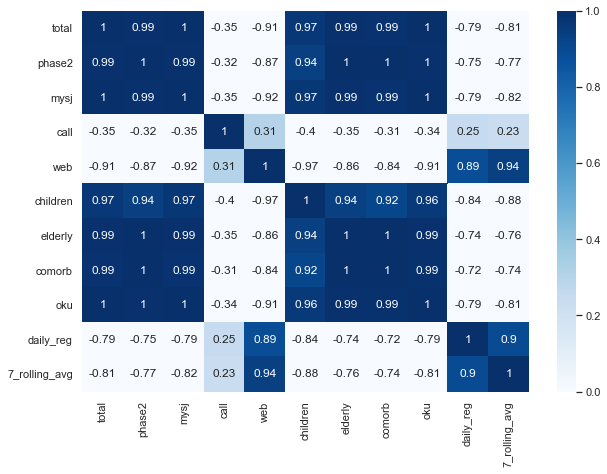

In [152]:
columns_list = analysis.columns
columns_list = columns_list.delete(0)

#analysis.groupby('ID')[['Val1','Val2']].corr()
sns.set(rc={'figure.figsize':(10, 7)})
sns.heatmap(analysis[columns_list].corr(), cmap='Blues', annot=True, vmin=0, vmax=1)

In [153]:
#analysis_recent = vaxreg_malaysia.copy()
analysis_recent = vaxreg_malaysia.iloc[-1:]


analysis_recent = pd.merge(analysis_recent, population[['state', 'pop','pop_18', 'pop_60', 'pop_12']], on='state')
#analysis_recent['pop_18'] = population['pop_18'][0]
#analysis_recent['pop_60'] = population['pop_60'][0]

analysis_recent

,date,state,total,phase2,mysj,call,web,children,elderly,comorb,oku,pop,pop_18,pop_60,pop_12
0,2021-10-16,Malaysia,25079220,6820116,23921547,11100,1146573,2814172,3355115,5032753,601552,32657400,23409600,3502000,3147500


In [154]:
analysis_recent['num_in_between'] = (analysis_recent['total'] - analysis_recent['children'] - analysis_recent['elderly'])
# #analysis_recent['pop_between'] = analysis_recent['pop'] - analysis_recent['pop_18'] - analysis_recent['pop_60']

analysis_recent['percent_children'] = ((analysis_recent['children'] / analysis_recent['pop_12']) * 100).round(2)
analysis_recent['percent_elderly'] = ((analysis_recent['elderly'] / analysis_recent['pop_60']) * 100).round(2)
analysis_recent['percent_adults'] = (((analysis_recent['num_in_between']) / (analysis_recent['pop_18'])) * 100).round(2)

analysis_recent

# ======================
# analysis_recent['num_in_between'] = (analysis_recent['total'] - analysis_recent['children'] - analysis_recent['elderly'])
# #analysis_recent['pop_between'] = analysis_recent['pop'] - analysis_recent['pop_18'] - analysis_recent['pop_60']

# analysis_recent['percent_children'] = ((analysis_recent['children'] / analysis_recent['pop_12']) * 100).round(2)
# analysis_recent['percent_reg_60'] = ((analysis_recent['elderly'] / analysis_recent['pop_60']) * 100).round(2)
# analysis_recent['percent_in_between'] = (((analysis_recent['num_in_between']) / (analysis_recent['pop'] - analysis_recent['pop_18'] - analysis_recent['pop_60'])) * 100).round(2)
# ==================

,date,state,total,phase2,mysj,call,web,children,elderly,comorb,oku,pop,pop_18,pop_60,pop_12,num_in_between,percent_children,percent_elderly,percent_adults
0,2021-10-16,Malaysia,25079220,6820116,23921547,11100,1146573,2814172,3355115,5032753,601552,32657400,23409600,3502000,3147500,18909933,89.41,95.81,80.78


Do childrens (<18) somehow got themselves registered as adults? Is there possible duplications that did not get resolved, or immigrants registered for vaccination here in this country counted as such? Latter seems likely, but that implies a huge amount of non-Malaysian registered for the vaccines.

Here we can see that up to 16th October, only 10% of population under 18 years old have registered for the vaccine, and the number seems rather low, considering the phase 4 of Recovery Plan is approaching and [students are expected to come back to the school in November 2021](https://www.thestar.com.my/news/nation/2021/09/12/education-minister-tighter-sop-for-schools-ahead-of-oct-3-reopening) . From what we can see, at least more than 80% at each category (children, adults, elderly) have registered for mysejahtera. More than 87% of the children under 18 have registered for the vaccine, which is above the required for herd immunity and ahead of the school reopening time.

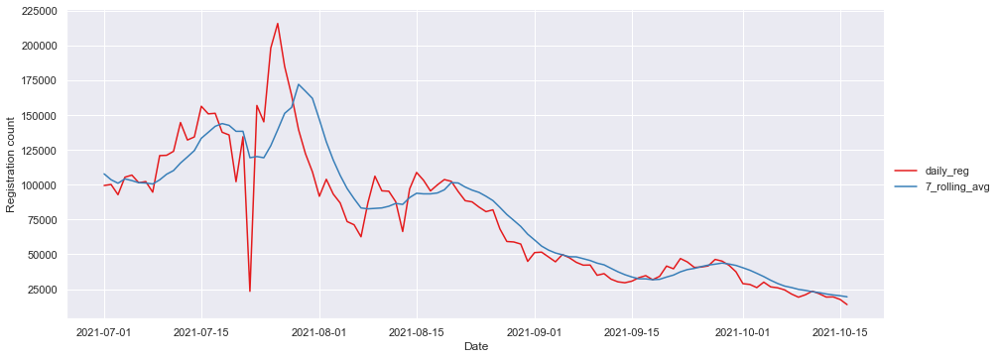

In [155]:
ax = sns.relplot(data=analysis.loc[:,['daily_reg', '7_rolling_avg']], kind='line',
            aspect=2.5, dashes=False, palette='Set1')
#ax.axhline(population['pop'][0], ls='--', linewidth=3, color='red')
# ax = ax.map(lambda y, **kw: plt.axhline(y.mean(), color="k"), 'COUNT')
#ax.refline(y=population['pop'][0])

#ax.axhline()
ax.set_xlabels('Date')
ax.set_ylabels('Registration count')

In [156]:
analysis_daily = vaxreg_malaysia.copy()
analysis_daily.columns

for x in analysis_daily.columns:
    if x == 'state' or x == 'date':
        continue
    analysis_daily[x] = analysis_daily[x].diff()
    
analysis_daily.dropna(inplace=True)

In [157]:
analysis_daily.head(5)

,date,state,total,phase2,mysj,call,web,children,elderly,comorb,oku
1,2021-06-25,Malaysia,129697.0,33787.0,121203.0,111.0,8383.0,20941.0,15054.0,25927.0,2932.0
2,2021-06-26,Malaysia,110539.0,29215.0,104491.0,113.0,5935.0,18063.0,12921.0,22163.0,2722.0
3,2021-06-27,Malaysia,83472.0,21625.0,95492.0,-84.0,-11936.0,14659.0,9070.0,16813.0,2169.0
4,2021-06-28,Malaysia,115568.0,29485.0,104172.0,125.0,11271.0,12342.0,10739.0,24140.0,2883.0
5,2021-06-29,Malaysia,112131.0,29482.0,101593.0,135.0,10403.0,13005.0,12957.0,22358.0,2930.0


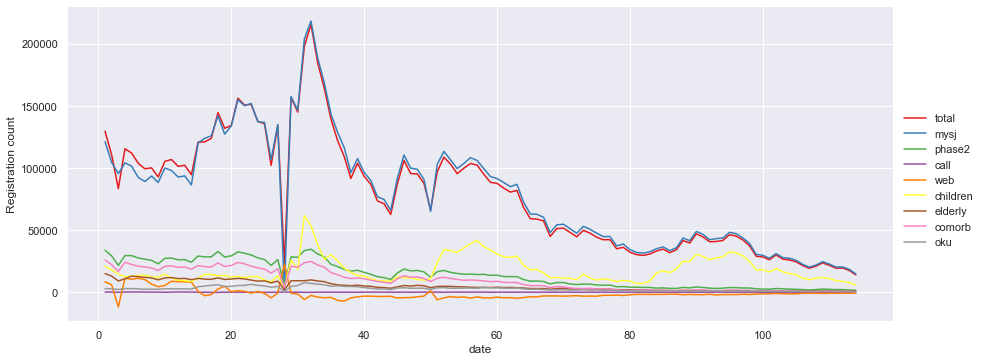

In [158]:
ax = sns.relplot(data=analysis_daily.loc[:,['total', 'mysj', 'phase2', 'call', 'web', 'children', 'elderly', 'comorb', 'oku']], kind='line',
            aspect=2.5, dashes=False, palette='Set1')
#ax.axhline(population['pop'][0], ls='--', linewidth=3, color='red')
# ax = ax.map(lambda y, **kw: plt.axhline(y.mean(), color="k"), 'COUNT')
#ax.refline(y=population['pop'][0])

#ax.axhline()
ax.set_xlabels('date')
ax.set_ylabels('Registration count')

From this graph, we can see that during the time when the total registration fell down, the number of registration for web increases, although it's only a small amount relative to the dip in mysejahtera registration during that day.

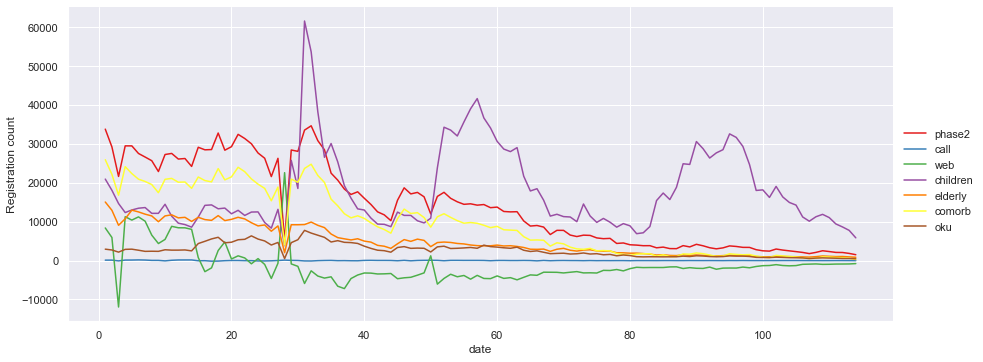

In [159]:
ax = sns.relplot(data=analysis_daily.loc[:,['phase2', 'call', 'web', 'children', 'elderly', 'comorb', 'oku']], kind='line',
            aspect=2.5, dashes=False, palette='Set1')
#ax.axhline(population['pop'][0], ls='--', linewidth=3, color='red')
# ax = ax.map(lambda y, **kw: plt.axhline(y.mean(), color="k"), 'COUNT')
#ax.refline(y=population['pop'][0])

#ax.axhline()
ax.set_xlabels('date')
ax.set_ylabels('Registration count')

We can that from this graph that somehow web registration goes into negative numbers. As noted in README.md for registration, MySejahtera has higher priority in the deduplication process, followed by call and then WEB registration. From this, we can assume that a lot of users registered for their vaccines through both MySejahtera and the website, and since the MySejahtera application takes priority over the web, a lot of web registration got deleted in the process.

In [160]:
vax_state.head()

,date,state,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending
0,2021-02-24,Johor,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2021-02-24,Kedah,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2021-02-24,Kelantan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,2021-02-24,Melaka,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,2021-02-24,Negeri Sembilan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<AxesSubplot:>

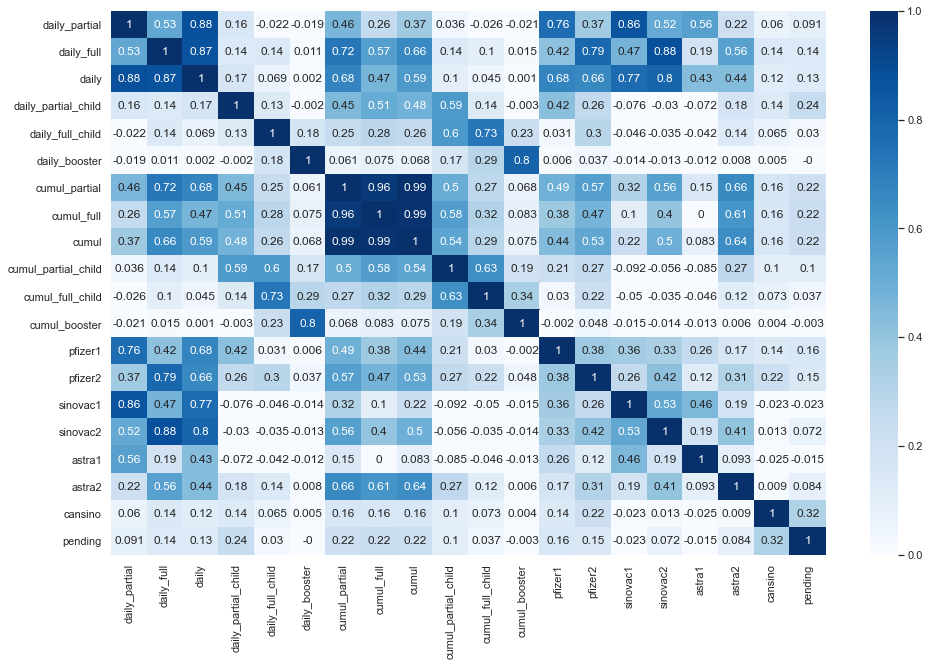

In [161]:
analysis = vax_state.copy()
columns_list = analysis.columns
columns_list = columns_list.delete(0)

#analysis.groupby('ID')[['Val1','Val2']].corr()
sns.set(rc={'figure.figsize':(16, 10)})
sns.heatmap(analysis[columns_list].corr().round(3), cmap='Blues', annot=True, vmin=0, vmax=1)

## For vaccination doses per state

First, we would look at the cumulative doses given in each state, sorted by descending order

In [162]:
vax_state_trim = vax_state.iloc[-16:]
vax_state_trim = vax_state_trim.sort_values('cumul', ascending=False)

<AxesSubplot:xlabel='cumul', ylabel='state'>

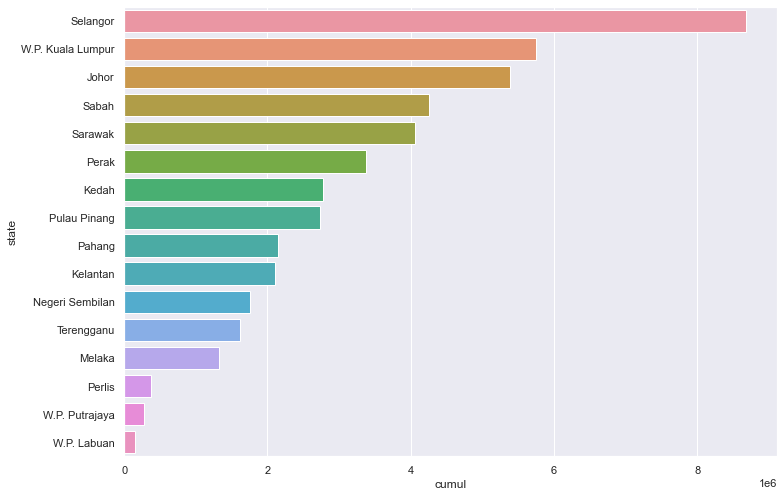

In [163]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(data=vax_state_trim, x='cumul', y='state', orient='h')

From here, we can see that Selangor has the most vaccine dose given compared all of the states

In [164]:
states_pop = population.iloc[-16:]

In [165]:
df_temp = pd.merge(vax_state_trim, population[['state', 'pop','pop_18', 'pop_60', 'pop_12']], on='state')

df_temp['perc_vax'] = (df_temp['cumul_partial'] / df_temp['pop'] * 100).round(2)

In [166]:
df_temp

,date,state,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending,pop,pop_18,pop_60,pop_12,perc_vax
0,2021-10-16,Selangor,5179,8555,13734,4617,7628,0,4564507,4118218,8678188,383538,56690,57,4721,8134,320,382,0,0,0,177,6538000,4747900,575800,569100,69.82
1,2021-10-16,W.P. Kuala Lumpur,1105,6798,7903,585,5558,0,2971904,2781658,5753298,138468,28353,106,950,6452,135,320,0,0,13,33,1773700,1348600,205800,140800,167.55
2,2021-10-16,Johor,3261,16231,19518,2530,7253,26,2873099,2516534,5386238,310300,54932,26,2891,8376,354,871,0,6909,35,82,3781000,2711900,428700,359900,75.99
3,2021-10-16,Sabah,1538,13200,14738,599,7471,0,2299290,2037946,4255323,253087,177003,0,1420,12350,113,134,1,391,285,44,3908500,2758400,238900,434000,58.83
4,2021-10-16,Sarawak,833,18254,21284,328,17810,2197,2106804,1938676,4054567,230833,101830,9383,2940,18047,89,206,0,0,0,2,2816500,2042700,332800,293200,74.80
5,2021-10-16,Perak,279,11451,12659,161,5971,929,1782140,1590388,3372199,194943,57840,7397,1140,9328,64,52,0,1921,131,23,2510300,1862700,397300,237200,70.99
6,2021-10-16,Kedah,426,6623,7050,198,4535,1,1478979,1305269,2780551,186479,53277,258,373,5232,45,2,1,1341,33,23,2185100,1540600,272500,211400,67.68
7,2021-10-16,Pulau Pinang,1198,9009,10216,590,5189,9,1448170,1283201,2727865,123022,18156,9,936,5745,252,498,5,2723,0,57,1773600,1367200,239200,141500,81.65
8,2021-10-16,Pahang,80,3921,4008,22,3278,7,1132167,1011665,2141309,132644,45674,1075,81,3528,6,29,0,360,0,4,1678700,1175800,190200,173000,67.44
9,2021-10-16,Kelantan,402,4083,4496,198,3524,11,1141296,968286,2107439,161125,40242,204,329,3927,84,151,0,0,0,5,1906700,1236200,194100,210600,59.86


Note that cumul_partial is used to count the number of unique individuals who have been vaccinated, which compromises people who received 1 dose of a double-dose vaccine (such as Pfizer, Sinovac, AstraZec), and those who received a single-dose vaccine (cansino).

Text(0.5, 1.0, 'Numbers of invidual that has been vaccinated (partial/complete)')

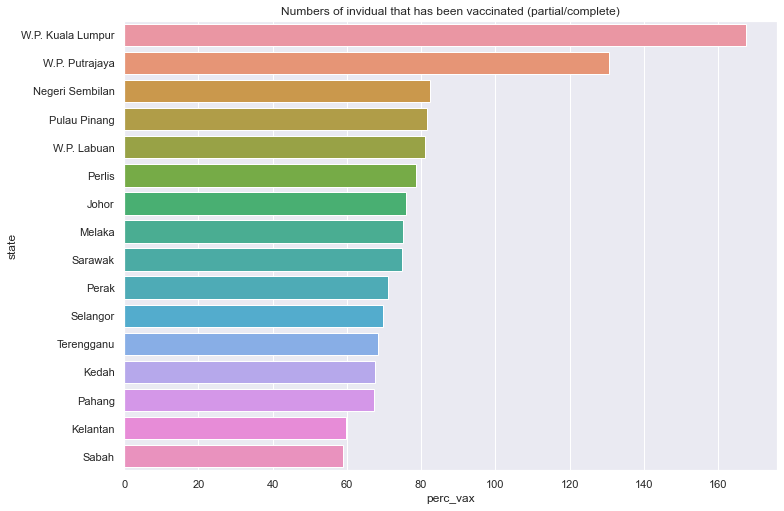

In [167]:
df_temp = df_temp.sort_values('perc_vax', ascending=False)

sns.set(rc={'figure.figsize':(11.7,8.27)})
ax = sns.barplot(data=df_temp, x='perc_vax', y='state', orient='h')
ax.set_title('Numbers of invidual that has been vaccinated (partial/complete)')

From this bar chart, we can see that more than 100% of the population in W.P. Kuala Lumpur have gotten their vaccines. We assumed that people from different states may have taken their vaccines in Kuala Lumpur during the vaccination drive.

## Vaccination Progress

### Vaccination Progress in Malaysia

In [168]:
df_trim = vax_malaysia.iloc[-1:]
df_trim = df_trim.sort_values('cumul', ascending=False)

df_trim['pop'] = population['pop'][0]
df_trim

,date,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending,pop
234,2021-10-16,15421,109745,128347,10625,79253,3181,24715782,22146626,46761751,2450352,716332,18766,16867,92625,1497,2688,7,13710,497,456,32657400


Calculate the percentages of population having vaccinated at least once

In [169]:
df_trim['percent_complete_part'] = ((df_trim['cumul_partial'] / df_trim['pop']) * 100).round(2)
df_trim['percent_incomplete_part'] = 100 - df_trim['percent_complete_part']
df_trim['place'] = 'Malaysia'

<AxesSubplot:xlabel='place'>

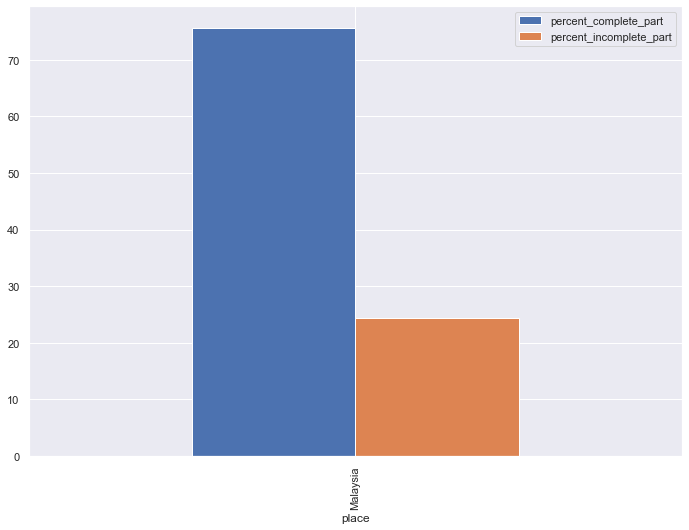

In [170]:
df_trim.plot(x="place", y=["percent_complete_part", "percent_incomplete_part"], kind="bar")

Here we can see that by 16th Oct 2021, about 3/4 of the Malaysian population have at least gotten their first vaccine.

In [171]:
df_trim

,date,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending,pop,percent_complete_part,percent_incomplete_part,place
234,2021-10-16,15421,109745,128347,10625,79253,3181,24715782,22146626,46761751,2450352,716332,18766,16867,92625,1497,2688,7,13710,497,456,32657400,75.68,24.32,Malaysia


In [172]:
df_trim['percent_complete_full'] = ((df_trim['cumul_full'] / df_trim['pop']) * 100).round(2)
df_trim['percent_incomplete_full'] = 100 - df_trim['percent_complete_full']

<AxesSubplot:xlabel='place'>

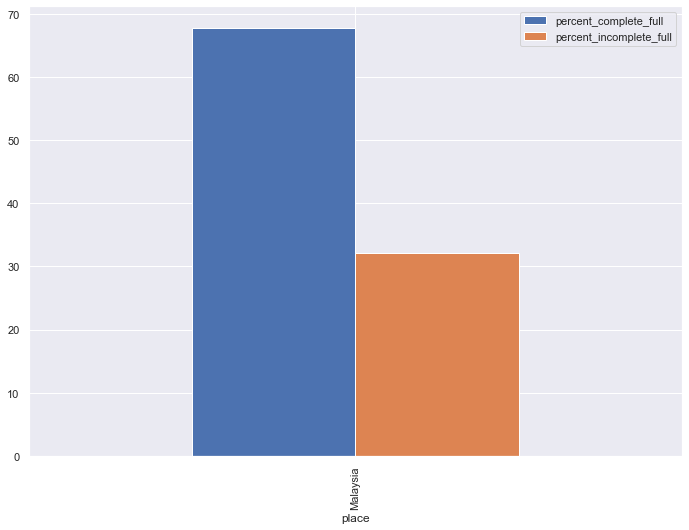

In [173]:
df_trim.plot(x="place", y=["percent_complete_full", "percent_incomplete_full"], kind="bar")

By this date, roughly 66% of people have completed their vaccination dose.

In [174]:
analysis = vax_state.copy()

In [175]:
analysis

,date,state,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending
0,2021-02-24,Johor,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2021-02-24,Kedah,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2021-02-24,Kelantan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,2021-02-24,Melaka,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,2021-02-24,Negeri Sembilan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3755,2021-10-16,Selangor,5179,8555,13734,4617,7628,0,4564507,4118218,8678188,383538,56690,57,4721,8134,320,382,0,0,0,177
3756,2021-10-16,Terengganu,675,3815,4490,608,3706,0,861416,752111,1609433,116743,29991,0,666,3811,9,4,0,0,0,0
3757,2021-10-16,W.P. Kuala Lumpur,1105,6798,7903,585,5558,0,2971904,2781658,5753298,138468,28353,106,950,6452,135,320,0,0,13,33
3758,2021-10-16,W.P. Labuan,61,706,767,8,660,0,80753,74097,154850,8112,5952,0,61,706,0,0,0,0,0,0


state
Johor                AxesSubplot(0.125,0.125;0.775x0.755)
Kedah                AxesSubplot(0.125,0.125;0.775x0.755)
Kelantan             AxesSubplot(0.125,0.125;0.775x0.755)
Melaka               AxesSubplot(0.125,0.125;0.775x0.755)
Negeri Sembilan      AxesSubplot(0.125,0.125;0.775x0.755)
Pahang               AxesSubplot(0.125,0.125;0.775x0.755)
Perak                AxesSubplot(0.125,0.125;0.775x0.755)
Perlis               AxesSubplot(0.125,0.125;0.775x0.755)
Pulau Pinang         AxesSubplot(0.125,0.125;0.775x0.755)
Sabah                AxesSubplot(0.125,0.125;0.775x0.755)
Sarawak              AxesSubplot(0.125,0.125;0.775x0.755)
Selangor             AxesSubplot(0.125,0.125;0.775x0.755)
Terengganu           AxesSubplot(0.125,0.125;0.775x0.755)
W.P. Kuala Lumpur    AxesSubplot(0.125,0.125;0.775x0.755)
W.P. Labuan          AxesSubplot(0.125,0.125;0.775x0.755)
W.P. Putrajaya       AxesSubplot(0.125,0.125;0.775x0.755)
Name: cumul_partial, dtype: object

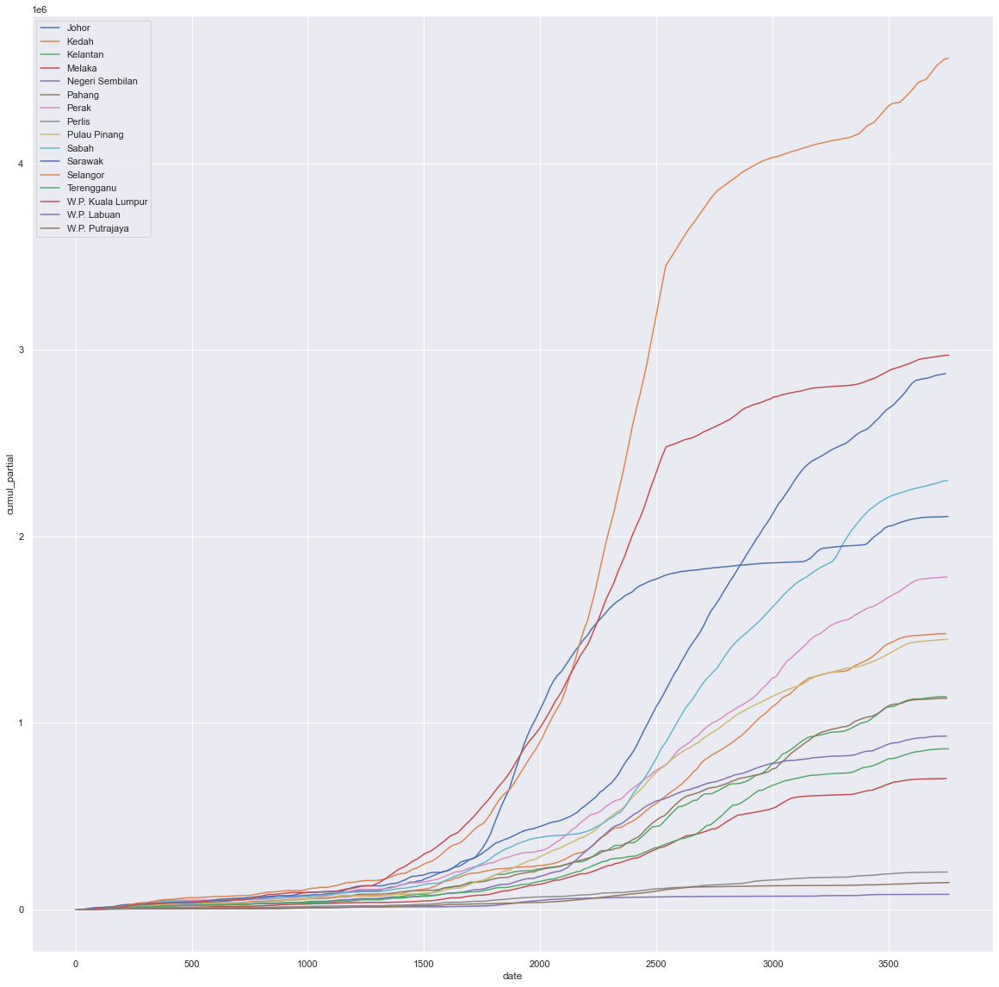

In [176]:
plt.figure(figsize=(20, 20))
#analysis.set_index("date", inplace=True)
analysis.groupby("state")["cumul_partial"].plot(legend=True, xlabel="date", ylabel="cumul_partial")

state
Johor                AxesSubplot(0.125,0.125;0.775x0.755)
Kedah                AxesSubplot(0.125,0.125;0.775x0.755)
Kelantan             AxesSubplot(0.125,0.125;0.775x0.755)
Melaka               AxesSubplot(0.125,0.125;0.775x0.755)
Negeri Sembilan      AxesSubplot(0.125,0.125;0.775x0.755)
Pahang               AxesSubplot(0.125,0.125;0.775x0.755)
Perak                AxesSubplot(0.125,0.125;0.775x0.755)
Perlis               AxesSubplot(0.125,0.125;0.775x0.755)
Pulau Pinang         AxesSubplot(0.125,0.125;0.775x0.755)
Sabah                AxesSubplot(0.125,0.125;0.775x0.755)
Sarawak              AxesSubplot(0.125,0.125;0.775x0.755)
Selangor             AxesSubplot(0.125,0.125;0.775x0.755)
Terengganu           AxesSubplot(0.125,0.125;0.775x0.755)
W.P. Kuala Lumpur    AxesSubplot(0.125,0.125;0.775x0.755)
W.P. Labuan          AxesSubplot(0.125,0.125;0.775x0.755)
W.P. Putrajaya       AxesSubplot(0.125,0.125;0.775x0.755)
Name: daily_partial, dtype: object

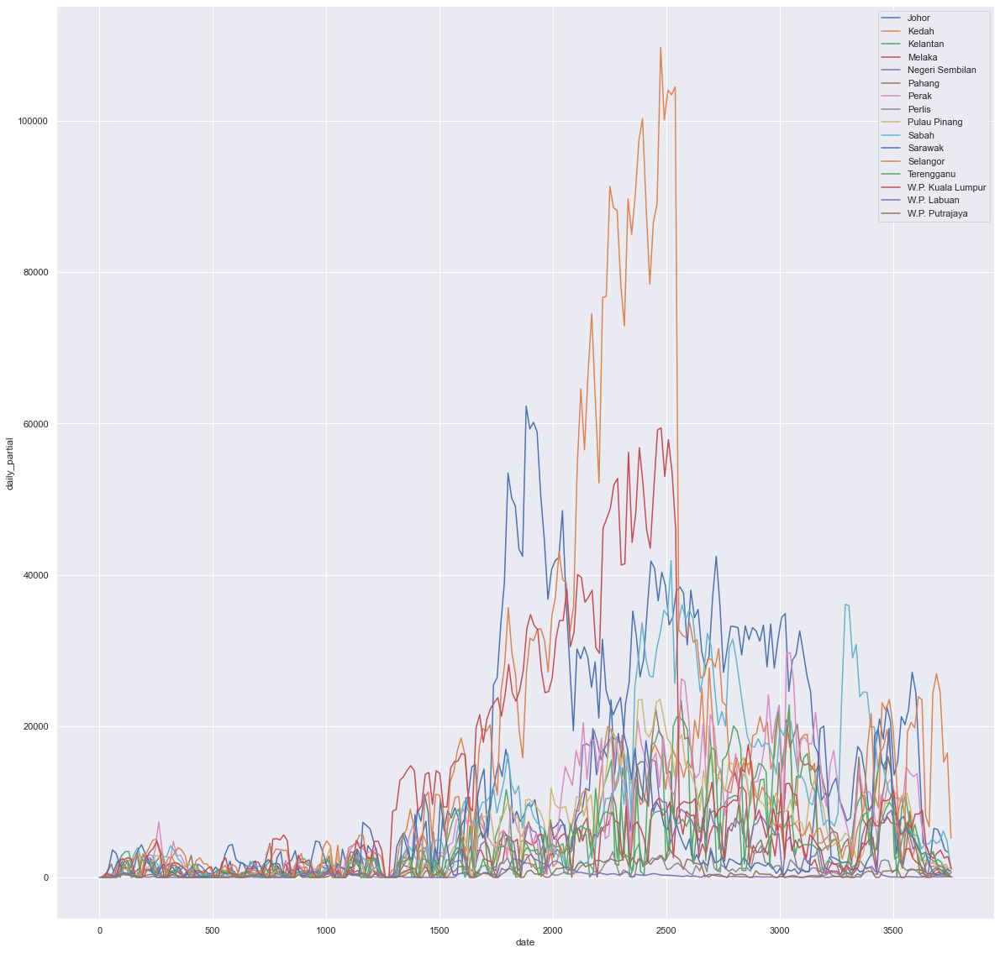

In [177]:
plt.figure(figsize=(20, 20))
#analysis.set_index("date", inplace=True)
analysis.groupby("state")["daily_partial"].plot(legend=True, xlabel="date", ylabel="daily_partial")

We can see there's a huge jump of vaccination given out at Selangor. For most of the other states, the vaccinations given daily is roughly around 20000.

# Mean Monthly Household Gross Income

## Loading the dataset

In [178]:
income = pd.read_csv('random_dataset/_202108260434240_mean-monthly-household-gross-income-by-state-malaysia.csv')

In [179]:
income.dtypes

Country/State                          object
Year                                    int64
Mean Monthly Household Gross Income    object
dtype: object

In [180]:
income.isnull().sum()

Country/State                          0
Year                                   0
Mean Monthly Household Gross Income    0
dtype: int64

Initially, we thought there was no wrong values. But when we tried to convert the `Mean Monthly HouseHold Gross Income` column, we realised we were unable to convert it to an `int` data type. Further inspection reveals that, in W.P.Labuan and W.P. Putrajaya (years 20002 and 2004), they contained 'n.a.' values.

Hence, for the purposes of our analysis, we decided to covert this n.a. value to 0, as we are only interested to see the change of household income over time.

In [181]:
income.replace("n.a.", "0", inplace=True)
income.replace('N.Sembilan', 'Negeri Sembilan', inplace=True)
income.replace('P.Pinang', 'Pulau Pinang', inplace = True)
income.replace('W.P.KL', 'W.P. Kuala Lumpur', inplace=True)
income.replace('W.P.Labuan', 'W.P. Labuan', inplace=True)

In [182]:
income['Country/State'].unique().tolist()

['Malaysia',
 'Johor',
 'Kedah',
 'Kelantan',
 'Melaka',
 'Negeri Sembilan',
 'Pahang',
 'Pulau Pinang',
 'Perak',
 'Perlis',
 'Selangor',
 'Terengganu',
 'Sabah',
 'Sarawak',
 'W.P. Kuala Lumpur',
 'W.P. Labuan',
 'W.P. Putrajaya']

In [183]:
income[income['Country/State'] == 'W.P. Labuan']
income[income['Country/State'] == 'W.P. Putrajaya']

,Country/State,Year,Mean Monthly Household Gross Income
128,W.P. Putrajaya,2002,0
129,W.P. Putrajaya,2004,0
130,W.P. Putrajaya,2007,5294
131,W.P. Putrajaya,2009,6747
132,W.P. Putrajaya,2012,8101
133,W.P. Putrajaya,2014,10401
134,W.P. Putrajaya,2016,11555
135,W.P. Putrajaya,2019,12840
152,W.P. Putrajaya,2020,12322


In [184]:
income['Mean Monthly Household Gross Income'] = pd.to_numeric(income['Mean Monthly Household Gross Income'])
income.Year = pd.to_datetime(income.Year, format='%Y')

In [185]:
income.dtypes

Country/State                                  object
Year                                   datetime64[ns]
Mean Monthly Household Gross Income             int64
dtype: object

In [186]:
income

,Country/State,Year,Mean Monthly Household Gross Income
0,Malaysia,2002-01-01,3011
1,Malaysia,2004-01-01,3249
2,Malaysia,2007-01-01,3686
3,Malaysia,2009-01-01,4025
4,Malaysia,2012-01-01,5000
...,...,...,...
148,Sabah,2020-01-01,5215
149,Sarawak,2020-01-01,5087
150,W.P. Kuala Lumpur,2020-01-01,11728
151,W.P. Labuan,2020-01-01,7333


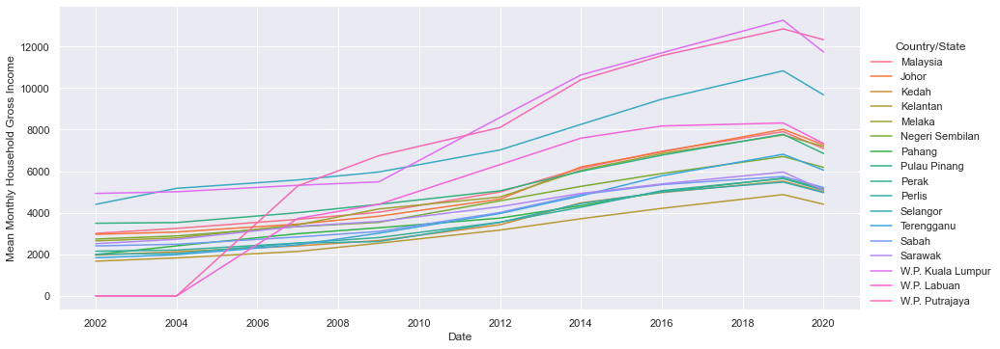

In [187]:
# income[income['Country/State']=='Malaysia']
# plt.figure(figsize=(20, 20))
#analysis.set_index("date", inplace=True)
# income.groupby("Country/State")["Mean Monthly Household Gross Income"].plot(legend=True, xlabel="date", ylabel="Mean Monthly Household Gross Income")
all_states = income['Country/State'].unique().tolist()

income_wide = income.pivot_table(index='Year', 
                                           columns='Country/State', 
                                           values=['Mean Monthly Household Gross Income']
                                          )

ax = sns.relplot(data=income_wide['Mean Monthly Household Gross Income'].loc[:,all_states], kind='line',
            aspect=2.5, dashes=False)
ax.set_xlabels('Date')
ax.set_ylabels('Mean Monthly Household Gross Income')

With that, we have successfully charted out the Mean Monthly Household Gross Income for the years leading up to 2020 for each state.

***

# Questions Answered: 

# 1. Is there any association between the total unique individual check-ins, total unique locations to daily cases in the country for the last 3 months?

The reason we want to answer this specific question was because, as we close in to the endemic phase of Malaysia, where constant check-ins by Malaysians into outlets are a norm, how this could potentially be a clue to whether or not our total daily cases could be associated with it. Hence, we want to find whether there is any association between unique individual check-ins and locations to daily cases in Malaysia.

Hence we will be using the `cases_malaysia.csv` and `checkin_malaysia.csv` dataset for this question. 

In [188]:
cases_malaysia = pd.read_csv('covid19-public/epidemic/cases_malaysia.csv')
checkin_malaysia = pd.read_csv('covid19-public/mysejahtera/checkin_malaysia.csv')

cases_malaysia['date'] = pd.to_datetime(cases_malaysia['date'], errors='raise')
checkin_malaysia['date'] = pd.to_datetime(checkin_malaysia['date'], errors='raise')

In [189]:
cases_malaysia_with_clusters = cases_malaysia[['date', 'cluster_import', 'cluster_religious', 'cluster_community', 'cluster_highRisk', 'cluster_education', 'cluster_detentionCentre', 'cluster_workplace']].copy()
cases_malaysia.drop(cases_malaysia.columns[12:], axis=1, inplace=True)
cases_malaysia = cases_engineer(cases_malaysia.reset_index(), show_plot=False)
cases_malaysia = pd.merge(cases_malaysia, cases_malaysia_with_clusters, on='date')
malaysia_merged = pd.merge(cases_malaysia, checkin_malaysia, on=['date'], how='inner')
malaysia_merged

,index,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace,checkins,unique_ind,unique_loc
0,311,2020-12-01,1472,5,1552,10476,1153,0,0,51,34,1098,37,1188.857143,1245.642857,5.571429,4.500000,1736.857143,1406.214286,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,970.0,5.0,2348.0,2188.0,0.0,1673.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17492265,6614474,630363
1,312,2020-12-02,851,4,658,10663,444,0,0,81,43,665,55,1171.857143,1259.285714,5.428571,4.500000,1495.428571,1408.214286,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,970.0,5.0,2348.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17695726,6667261,648752
2,313,2020-12-03,1075,3,948,10789,648,0,0,87,41,828,48,1191.857143,1243.928571,5.285714,4.357143,1265.857143,1413.214286,851.0,4.0,658.0,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17063123,6549583,645604
3,314,2020-12-04,1141,3,1144,10785,666,0,0,93,59,745,65,1196.428571,1257.000000,4.285714,4.214286,1265.285714,1426.642857,1075.0,3.0,948.0,851.0,4.0,658.0,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18350879,6803979,622383
4,315,2020-12-05,1123,5,1143,10761,638,0,0,77,79,894,69,1169.000000,1262.857143,4.285714,4.428571,1270.000000,1407.928571,1141.0,3.0,1144.0,1075.0,3.0,948.0,851.0,4.0,658.0,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19711082,6845366,573132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
314,625,2021-10-11,6709,6,10833,112093,282,674,4040,1225,486,4074,887,8666.142857,9793.500000,11.714286,12.071429,12926.000000,14326.000000,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,8817.0,14.0,15615.0,8075.0,6.0,15456.0,0.0,5.0,137.0,28.0,7.0,0.0,105.0,29362255,10926787,879374
315,626,2021-10-12,7276,10,10555,108747,379,776,4425,1236,581,4486,883,8446.000000,9503.785714,11.142857,11.142857,12203.142857,14068.500000,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,8817.0,14.0,15615.0,0.0,10.0,140.0,20.0,64.0,0.0,145.0,29230419,10938403,889096
316,627,2021-10-13,7950,29,10832,105822,500,777,4948,1312,524,4964,1004,8241.714286,9183.500000,13.428571,12.642857,11887.000000,13627.928571,7276.0,10.0,10555.0,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,0.0,24.0,95.0,78.0,66.0,44.0,193.0,29767155,11005026,893008
317,628,2021-10-14,8084,21,12456,101422,352,720,4993,1462,538,5020,1005,7983.714286,8851.285714,13.857143,12.928571,11825.857143,13251.571429,7950.0,29.0,10832.0,7276.0,10.0,10555.0,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,0.0,10.0,78.0,75.0,34.0,0.0,155.0,29428703,11003118,888636


In [190]:
malaysia_merged1 = malaysia_merged.loc[226:319]

malaysia_merged1

,index,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace,checkins,unique_ind,unique_loc
226,537,2021-07-15,13215,13,6095,107027,2828,1878,507,1800,882,9272,762,10303.428571,8701.071429,20.285714,17.785714,5760.000000,5538.571429,11618.0,26.0,6377.0,11079.0,27.0,5990.0,8574.0,40.0,5041.0,9105.0,18.0,5194.0,9353.0,11.0,5910.0,9180.0,7.0,5713.0,8868.0,10.0,5802.0,0.0,1.0,654.0,67.0,54.0,195.0,1207.0,19074986,8097781,676956
227,538,2021-07-16,12541,16,6742,112613,2785,1863,537,1514,732,9010,770,10783.571429,9098.142857,21.571429,18.714286,5907.000000,5571.714286,13215.0,13.0,6095.0,11618.0,26.0,6377.0,11079.0,27.0,5990.0,8574.0,40.0,5041.0,9105.0,18.0,5194.0,9353.0,11.0,5910.0,9180.0,7.0,5713.0,0.0,2.0,468.0,99.0,36.0,179.0,1518.0,18992596,8005078,642944
228,539,2021-07-17,12528,19,6629,118250,3206,1918,479,1615,806,8691,789,11237.142857,9517.428571,22.714286,19.285714,6009.714286,5639.714286,12541.0,16.0,6742.0,13215.0,13.0,6095.0,11618.0,26.0,6377.0,11079.0,27.0,5990.0,8574.0,40.0,5041.0,9105.0,18.0,5194.0,9353.0,11.0,5910.0,0.0,0.0,425.0,100.0,41.0,268.0,1772.0,18974196,7887380,604215
229,540,2021-07-18,10710,12,5778,122947,2164,1625,453,1402,649,7611,668,11466.428571,9850.642857,21.857143,18.714286,6093.142857,5675.928571,12528.0,19.0,6629.0,12541.0,16.0,6742.0,13215.0,13.0,6095.0,11618.0,26.0,6377.0,11079.0,27.0,5990.0,8574.0,40.0,5041.0,9105.0,18.0,5194.0,0.0,0.0,375.0,69.0,34.0,358.0,1015.0,17259037,7393890,489732
230,541,2021-07-19,10972,48,6439,127259,2480,1853,486,1467,697,7971,690,11809.000000,10178.142857,23.000000,20.285714,6292.857143,5812.142857,10710.0,12.0,5778.0,12528.0,19.0,6629.0,12541.0,16.0,6742.0,13215.0,13.0,6095.0,11618.0,26.0,6377.0,11079.0,27.0,5990.0,8574.0,40.0,5041.0,4.0,0.0,416.0,55.0,22.0,247.0,1358.0,20975355,8548480,655999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
314,625,2021-10-11,6709,6,10833,112093,282,674,4040,1225,486,4074,887,8666.142857,9793.500000,11.714286,12.071429,12926.000000,14326.000000,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,8817.0,14.0,15615.0,8075.0,6.0,15456.0,0.0,5.0,137.0,28.0,7.0,0.0,105.0,29362255,10926787,879374
315,626,2021-10-12,7276,10,10555,108747,379,776,4425,1236,581,4486,883,8446.000000,9503.785714,11.142857,11.142857,12203.142857,14068.500000,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,8817.0,14.0,15615.0,0.0,10.0,140.0,20.0,64.0,0.0,145.0,29230419,10938403,889096
316,627,2021-10-13,7950,29,10832,105822,500,777,4948,1312,524,4964,1004,8241.714286,9183.500000,13.428571,12.642857,11887.000000,13627.928571,7276.0,10.0,10555.0,6709.0,6.0,10833.0,7373.0,2.0,10959.0,8743.0,14.0,14422.0,9751.0,15.0,12724.0,9890.0,18.0,12884.0,9380.0,13.0,13045.0,0.0,24.0,95.0,78.0,66.0,44.0,193.0,29767155,11005026,893008
317,628,2021-10-14,8084,21,12456,101422,352,720,4993,1462,538,5020,1005,7983.714286,8851.285714,13.857143,12.928571,11825.857143,13251.571429,7950.0,29.

For this question, we will be using 3 specific columns: `cases_new`, `7DayAverageNewCases`, and `14DayAverageNewCases` for finding any association between these 3 variables to the unique individual check-ins, and to unique location check-ins. Hence this would be a multivariate linear regression. 

In [191]:
X = malaysia_merged1[['cases_new', '7DayAverageNewCases', '14DayAverageNewCases']]
Y = malaysia_merged1[['unique_ind']]
Z = malaysia_merged1[['unique_loc']]

scaler = MinMaxScaler()
X = scaler.fit_transform(X)
Y = scaler.fit_transform(Y)
Z = scaler.fit_transform(Z)

We will be tackling the question by splitting them into 2 parts: first we will investigate the correlation between `cases_new`, `7DayAverageNewCases`, and `14DayAverageNewCases` to `unique_ind`, followed by `unique_loc`. 

We will also be using the following Linear Regression models for this assignment: Linear Regression, Polynomial Regression, and then Ridge Regression. Polynomial regression is a special case of Linear Regression, in which the relationship between the x and y variable are not linear. This can be helpful for us to identify the possibility of non-linear relationship between x and y. We also can use Ridge Regression. The reason is because, multicollinearity may be exhibited between the predictor variables when they have correlation among themselves. Hence, ridge regerssion can add some bias in the estimates of the regression, which can increase the reliability of the estimates. 

Notice that we will also be using a MinMaxScaler, as we have a wide range of values for our data. So it is important to normalise them. 

## 1.1 Using unique individuals

### 1.1.1 Linear Regression Model

In [192]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=5, shuffle=True)

lm = LinearRegression(normalize=True)
lm.fit(X_train, Y_train)
print(lm.coef_, lm.intercept_)

Y_test_pred = lm.predict(X_test)
Y_test_pred = pd.DataFrame(Y_test_pred, columns=['PredictedSum'])

df_temp = malaysia_merged1.loc[:, ["cases_new", "unique_ind"]]
df_new = pd.concat([df_temp.reset_index(drop=True), Y_test_pred], axis = 1)

[[ 0.06991685 -2.34423688  1.9467453 ]] [0.84819126]


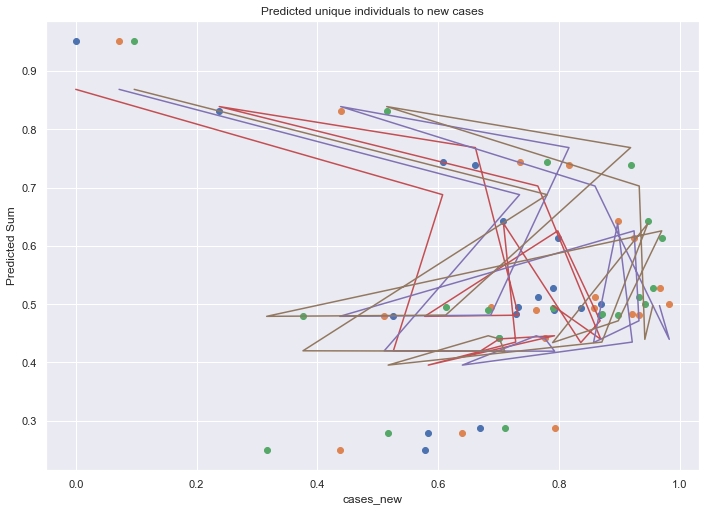

In [193]:
plt.plot(X_test, Y_test, 'o', )
plt.plot(X_test, Y_test_pred)
plt.xlabel('cases_new')
plt.ylabel('Predicted Sum')
plt.title('Predicted unique individuals to new cases')
plt.show()

In [194]:
print('Root Mean Squared Error = {:.2f}'.format(mean_squared_error(Y_test, Y_test_pred, squared=False)))
print('R-square Score = {:.2f}'. format(r2_score(Y_test, Y_test_pred)))

Root Mean Squared Error = 0.09
R-square Score = 0.75


### 1.1.2 Using Polynomial Regression

In [195]:
degree=2
polyreg=make_pipeline(PolynomialFeatures(degree),LinearRegression(normalize=True))
polyreg.fit(X_train,Y_train)

Y_test_pred = polyreg.predict(X_test)
Y_test_pred = pd.DataFrame(Y_test_pred, columns=['PredictedSum'])

df_temp = malaysia_merged1.loc[:, ["cases_new", "unique_ind"]]
df_new = pd.concat([df_temp.reset_index(drop=True), Y_test_pred], axis = 1)

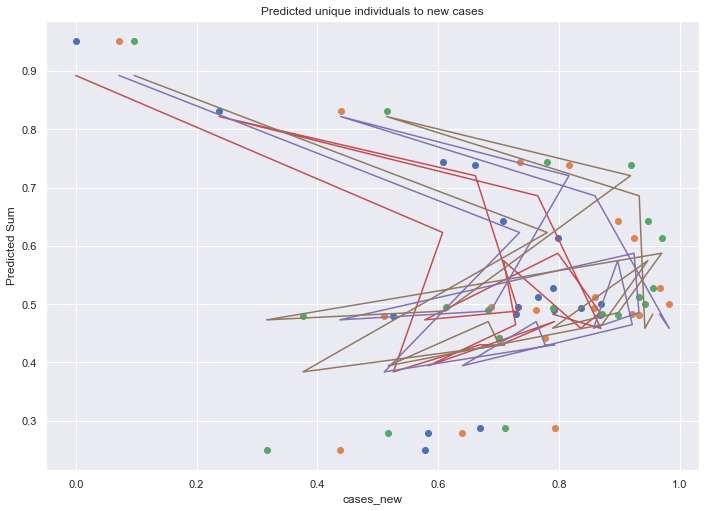

Root Mean Squared Error = 0.09
R-square Score = 0.74


In [196]:
plt.plot(X_test, Y_test, 'o', )
plt.plot(X_test, Y_test_pred)
plt.xlabel('cases_new')
plt.ylabel('Predicted Sum')
plt.title('Predicted unique individuals to new cases')
plt.show()

print('Root Mean Squared Error = {:.2f}'.format(mean_squared_error(Y_test, Y_test_pred, squared=False)))
print('R-square Score = {:.2f}'. format(r2_score(Y_test, Y_test_pred)))

### 1.1.3 Using Ridge Regression

In [197]:
rm = Ridge(alpha=0.1, normalize=True)
rm.fit(X_train, Y_train)
print(rm.coef_, rm.intercept_)

Y_test_pred = rm.predict(X_test)
Y_test_pred = pd.DataFrame(Y_test_pred, columns=['PredictedSum'])

df_temp = malaysia_merged1.loc[:, ["cases_new", "unique_ind"]]
df_new = pd.concat([df_temp.reset_index(drop=True), Y_test_pred], axis = 1)

[[-0.52179622 -0.35634355  0.48621731]] [0.8194422]


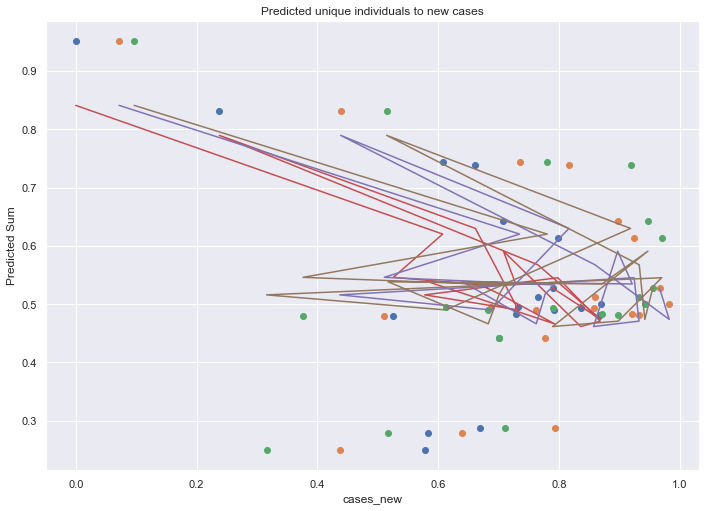

Root Mean Squared Error = 0.12
R-square Score = 0.56


In [198]:
plt.plot(X_test, Y_test, 'o', )
plt.plot(X_test, Y_test_pred)
plt.xlabel('cases_new')
plt.ylabel('Predicted Sum')
plt.title('Predicted unique individuals to new cases')
plt.show()

print('Root Mean Squared Error = {:.2f}'.format(mean_squared_error(Y_test, Y_test_pred, squared=False)))
print('R-square Score = {:.2f}'. format(r2_score(Y_test, Y_test_pred)))

Below are the summarized results obtained by our models above:
1. Linear Regression
- Root Mean Squared Error = 0.09
- R-square Score = 0.75

2. Polynomial Regression (degree = 2)
- Root Mean Squared Error = 0.09
- R-square Score = 0.74

3. Ridge Regression 
- Root Mean Squared Error = 0.12
- R-square Score = 0.56

As we can see, our results tell us that, based on our RMSE values (0.09 for LR, 0.09 for PR, 0.12 for RR), the data points measured are close to the observed data point's values, which indicate that the line fits well. This shows that the model predicts the data relatively well. In both Linear Regression and Polynomial Regression, we see a relatively high score for the R-square Score (0.75 and 0.74 respectively), which indicates that about 75% of the of the observed variations can be explained by the model's input. However, in Ridge Regression, we obtain only about 56%. In conclusion, this means that, we can associate the daily cases in the past 3 months to unique individual check-ins in the whole of Malaysia. 

# 1.2 Using unique locations

### 1.2.1 Linear Regression Model

In [199]:
X_train, X_test, Z_train, Z_test = train_test_split(X, Z, test_size=0.2, random_state=5)

lm = LinearRegression(normalize=True)
lm.fit(X_train, Z_train)
print(lm.coef_, lm.intercept_)

Z_test_pred = lm.predict(X_test)
Z_test_pred = pd.DataFrame(Z_test_pred, columns=['Predicted Sum'])

df_temp = malaysia_merged1.loc[:, ["cases_new", "unique_loc"]]
df_new = pd.concat([df_temp.reset_index(drop=True), Z_test_pred], axis = 1)

[[ 0.25590452 -2.06270019  1.67388828]] [0.79891325]


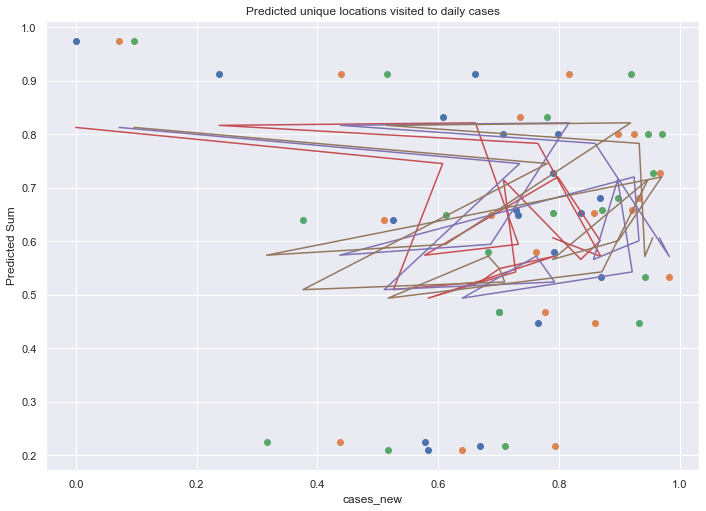

In [200]:
plt.plot(X_test, Z_test, 'o', )
plt.plot(X_test, Z_test_pred)
plt.xlabel('cases_new')
plt.ylabel('Predicted Sum')
plt.title('Predicted unique locations visited to daily cases')
plt.show()

In [201]:
print('Root Mean Squared Error = {:.2f}'.format(mean_squared_error(Z_test, Z_test_pred, squared=False)))
print('R-square Score = {:.2f}'. format(r2_score(Z_test, Z_test_pred)))

Root Mean Squared Error = 0.17
R-square Score = 0.44


### 1.2.2 Polynomial Regression Model

In [202]:
degree=2
polyreg=make_pipeline(PolynomialFeatures(degree),LinearRegression(normalize=True))
polyreg.fit(X_train,Z_train)

Z_test_pred = polyreg.predict(X_test)
Z_test_pred = pd.DataFrame(Z_test_pred, columns=['PredictedSum'])

df_temp = malaysia_merged1.loc[:, ["cases_new", "unique_loc"]]
df_new = pd.concat([df_temp.reset_index(drop=True), Z_test_pred], axis = 1)

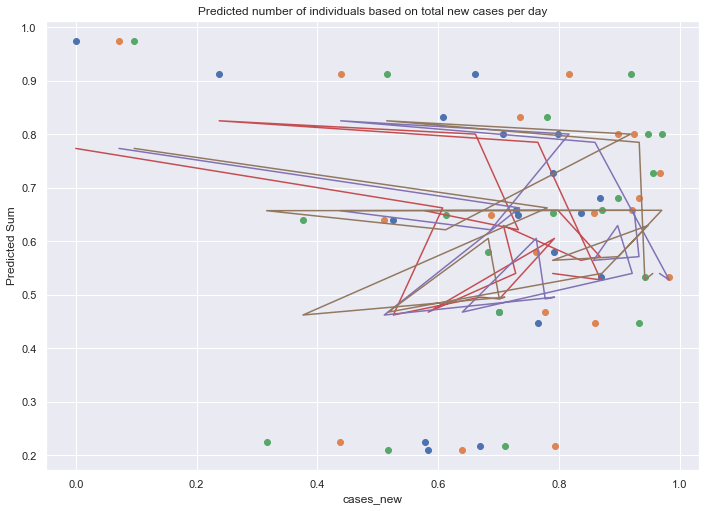

Root Mean Squared Error = 0.19
R-square Score = 0.29


In [203]:
plt.plot(X_test, Z_test, 'o', )
plt.plot(X_test, Z_test_pred)
plt.xlabel('cases_new')
plt.ylabel('Predicted Sum')
plt.title('Predicted number of individuals based on total new cases per day')
plt.show()

print('Root Mean Squared Error = {:.2f}'.format(mean_squared_error(Z_test, Z_test_pred, squared=False)))
print('R-square Score = {:.2f}'. format(r2_score(Z_test, Z_test_pred)))

### 1.2.3 Ridge Regression Model

In [204]:
rm = Ridge(alpha=0.1, normalize=True)
rm.fit(X_train, Z_train)
print(rm.coef_, rm.intercept_)

Z_test_pred = rm.predict(X_test)
Z_test_pred = pd.DataFrame(Z_test_pred, columns=['PredictedSum'])

df_temp = malaysia_merged1.loc[:, ["cases_new", "unique_loc"]]
df_new = pd.concat([df_temp.reset_index(drop=True), Z_test_pred], axis = 1)

[[-0.33492914 -0.28523728  0.41278592]] [0.77872032]


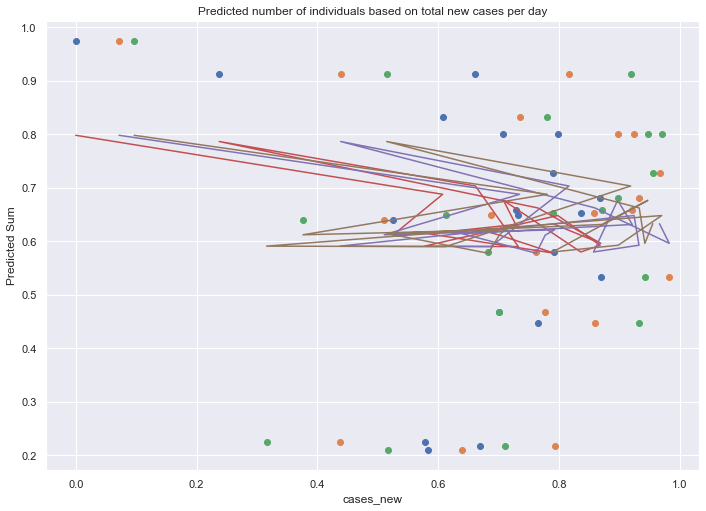

Root Mean Squared Error = 0.19
R-square Score = 0.27


In [205]:
plt.plot(X_test, Z_test, 'o', )
plt.plot(X_test, Z_test_pred)
plt.xlabel('cases_new')
plt.ylabel('Predicted Sum')
plt.title('Predicted number of individuals based on total new cases per day')
plt.show()

print('Root Mean Squared Error = {:.2f}'.format(mean_squared_error(Z_test, Z_test_pred, squared=False)))
print('R-square Score = {:.2f}'. format(r2_score(Z_test, Z_test_pred)))

Below are the summarized results obtained by our models above:
1. Linear Regression
- Root Mean Squared Error = 0.17
- R-square Score = 0.44

2. Polynomial Regression (degree = 2)
- Root Mean Squared Error = 0.19
- R-square Score = 0.29

3. Ridge Regression 
- Root Mean Squared Error = 0.19
- R-square Score = 0.27

As we can see, our results tell us that, based on our RMSE values (0.17 for LR, 0.19 for PR, 0.19 for RR), the data points are still pretty pretty close to the line, which indicate that the line fits the points nicely. This shows that the model predicts the data relatively well. However, in all 3 models, we see that we have a low R-squared value. This shows that, in terms of predicting daily cases to unique location check-ins, it will not necessarily provide a good association between daily new cases to unique location check-ins. 

# 2. Which classification model will be able to classify the unique individual checkin traffic based on the data?

In essence, we want to know the level of people who will be going outside in a day, and create a model that can help us to correctly classify the human traffic in a single day. This will allow us to create a model that can identify whether or not, for a particular day, if the number of individuals who will be going outside will be low, medium, or high. Hence we will be creating a column called `unique_individual_checkin_traffic`, which is binned from our `unique_ind`. The binned values are:
- Low-traffic: when unique_ind is < 7374345
- Medium-traffic: when unique_ind is 7374345 $\leq$ x $\leq$ 8680753
- High-traffic: when unique_ind > 8680753

We obtain these values based on the median values of the `unique_ind` in `checkin_malaysia`. 

In [206]:
def feature_engineer_cases_tests(df_cases, state_name='', show_plot=False):
    """Takes in the dataframe (if using the cases_state, the name of the state is needed). Returns a new dataset that 
    contains added lagging and rolling average features for cases and tests conducted.
    """
    cases = df_cases.copy()
    # extracting dataframe for this state
    if state_name != '':
        cases = df_cases[df_cases['state'] == state_name]
        cases = cases.drop(columns=['state'])
        cases.reset_index(inplace=True, drop=True)

    # adding columns of the rolling averages of new cases for 7 days and 14 days
    cases['7DayAverageNewCases'] = cases['cases_new'].rolling(window=7).mean()
    cases['14DayAverageNewCases'] = cases['cases_new'].rolling(window=14).mean()
    cases['7DayAverageImportCases'] = cases['cases_import'].rolling(window=7).mean()
    cases['14DayAverageImportCases'] = cases['cases_import'].rolling(window=14).mean()
    cases['7DayAverageRecoveredCases'] = cases['cases_recovered'].rolling(window=7).mean()
    cases['14DayAverageNewRecoveredCases'] = cases['cases_recovered'].rolling(window=14).mean() 
    cases['7DayAverageNewTests_rtk-ag'] = cases['rtk-ag'].rolling(window=7).mean()
    cases['14DayAverageNewTests_rtk-ag'] = cases['rtk-ag'].rolling(window=14).mean()
    cases['7DayAverageNewTests_pcr'] = cases['pcr'].rolling(window=7).mean()
    cases['14DayAverageNewTests_pcr'] = cases['pcr'].rolling(window=14).mean()

    # adding columns of 1-to-n-day-lags of new cases, new import cases and cases recovered, with tests conducted
    cases = calc_lag(cases, 7)
    cases = calc_lag_test(cases, 7)
    
    # drop null values from any of the columns, due to the lagging and rolling average columns
    cases = cases.dropna()

    return cases

In [207]:
def feature_extraction_for_individual_checkins(df):
    """Takes in a dataframe. Extracts and returns the best selected
    features for this state's data, and plots the top features."""
    
    X = df.drop(columns=['unique_individual_checkin_traffic','date', 'unique_ind'], axis=1)
    y = df['unique_individual_checkin_traffic']
    
    chi2_extractor = SelectKBest(chi2, k=5)
    chi2_extractor.fit(X, y)
    chi2_features = X.columns[chi2_extractor.get_support()]
    chi2_features = chi2_features.tolist()
    
    fclassif_extractor = SelectKBest(f_classif, k=5)
    fclassif_extractor.fit(X, y)
    fclassif_features = X.columns[fclassif_extractor.get_support()]
    fclassif_features = fclassif_features.tolist()
    
    minfoclassif_extractor = SelectKBest(mutual_info_classif, k=5)
    minfoclassif_extractor.fit(X, y)
    minfoclassif_features = X.columns[minfoclassif_extractor.get_support()]
    minfoclassif_features = minfoclassif_features.tolist()
    
    feature_list = list(chain(chi2_features, minfoclassif_features, fclassif_features))
    d = Counter(feature_list)
    
    feature_table = pd.DataFrame.from_dict(d, orient='index').reset_index()
    feature_table = feature_table.rename(columns={'index':'features_extracted', 0:'count'})
    feature_table = feature_table.sort_values('count', ascending=False)
    
    # from this table, create a barplot, detailing the top 10 features that appear the most number of times for this state
    sns_rfe_plot = sns.catplot(x="count", y="features_extracted", data = feature_table[0:10], kind = "bar", 
               height=14, aspect=1.9, palette='coolwarm')
    plt.title("Top 10 Strong Features/indicators for unique individual check-ins")
    
    # return list of top features given some min count, in this case we take 2, which means it is selected 2 out of 3 feature selectors
    best_features_filt = feature_table['count'] >= 2
    return feature_table.loc[best_features_filt, 'features_extracted'].values.tolist()

We will be joining the datasets of `cases_malaysia`, `deaths_malaysia`, `checkin_malaysia`, `vaxreg_malaysia`, `tests_malaysia`, and `vax_malaysia` to perform feature selection later on. 

In [208]:
cases_malaysia = pd.read_csv('covid19-public/epidemic/cases_malaysia.csv')
deaths_malaysia = pd.read_csv('covid19-public/epidemic/deaths_malaysia.csv')
tests_malaysia = pd.read_csv('covid19-public/epidemic/tests_malaysia.csv')
checkin_malaysia = pd.read_csv('covid19-public/mysejahtera/checkin_malaysia.csv')
vaxreg_malaysia = pd.read_csv('citf-public/registration/vaxreg_malaysia.csv')
vax_malaysia = pd.read_csv('citf-public/vaccination/vax_malaysia.csv')

In [209]:
cases_malaysia['date'] = pd.to_datetime(cases_malaysia['date'], errors='raise')
deaths_malaysia['date'] = pd.to_datetime(deaths_malaysia['date'], errors='raise')
tests_malaysia['date'] = pd.to_datetime(tests_malaysia['date'], errors='raise')
checkin_malaysia['date'] = pd.to_datetime(checkin_malaysia['date'], errors='raise')
vaxreg_malaysia['date'] = pd.to_datetime(vaxreg_malaysia['date'], errors='raise')
vax_malaysia['date'] = pd.to_datetime(vax_malaysia['date'], errors='raise')

In [210]:
merged_malaysia2 = pd.merge(cases_malaysia, deaths_malaysia, on=['date'], how='inner')
merged_malaysia2 = pd.merge(merged_malaysia2, tests_malaysia, on=['date'], how='inner')
merged_malaysia2 = pd.merge(merged_malaysia2, checkin_malaysia, on=['date'], how='inner')
merged_malaysia2 = pd.merge(merged_malaysia2, vaxreg_malaysia, on=['date'], how='inner')
merged_malaysia2 = pd.merge(merged_malaysia2, vax_malaysia, on=['date'], how='inner')
merged_malaysia2 = feature_engineer_cases_tests(merged_malaysia2.reset_index(), show_plot=False)
merged_malaysia2.reset_index(inplace=True)
merged_malaysia2.drop(['level_0', 'index', 'state'], axis=1, inplace=True)
merged_malaysia2

,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace,deaths_new,deaths_bid,deaths_new_dod,deaths_bid_dod,deaths_pvax,deaths_fvax,deaths_tat,rtk-ag,pcr,checkins,unique_ind,unique_loc,total,phase2,mysj,call,web,children,elderly,comorb,oku,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,7DayAverageNewTests_rtk-ag,14DayAverageNewTests_rtk-ag,7DayAverageNewTests_pcr,14DayAverageNewTests_pcr,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case,1-day lag rtk-ag,1-day lag pcr,2-day lag rtk-ag,2-day lag pcr,3-day lag rtk-ag,3-day lag pcr,4-day lag rtk-ag,4-day lag pcr,5-day lag rtk-ag,5-day lag pcr,6-day lag rtk-ag,6-day lag pcr,7-day lag rtk-ag,7-day lag pcr
0,2021-07-07,7097,26,4863,73587,2106,728,209,836,475,5018,457,0.0,1.0,370.0,82.0,92.0,166.0,927.0,91,10,155,17,32,0,3,42534,59879,18400422,7865994,661277,17555253,5573229,16185613,11779,1357861,952101,2939658,4210528,333224,218258,175011,393269,17,7,0,7202856,3077578,10280434,197,25,0,39691,62812,157024,107581,21535,4361,0,265,6830.142857,6341.714286,14.571429,13.714286,5285.428571,5294.642857,38354.714286,36136.571429,51826.714286,48792.285714,7654.0,11.0,4797.0,6387.0,26.0,4532.0,6045.0,20.0,5271.0,6658.0,11.0,5677.0,6982.0,3.0,6278.0,6988.0,5.0,5580.0,6276.0,16.0,4929.0,40048.0,52956.0,44941.0,41819.0,26064.0,42657.0,30817.0,55023.0,40860.0,55642.0,43219.0,54811.0,43012.0,54524.0
1,2021-07-08,8868,10,5802,76495,2704,1030,295,896,500,6520,662,0.0,6.0,474.0,75.0,23.0,25.0,1645.0,135,20,158,38,39,2,3,46348,60158,18258832,7861018,665133,17649903,5597428,16272080,11939,1365884,960686,2949716,4229090,335718,229164,158891,388055,15,1,0,7432020,3236469,10668489,212,26,0,40443,58610,167066,96912,21589,3344,0,91,7098.714286,6557.928571,15.285714,13.857143,5317.142857,5322.571429,38801.714286,37080.571429,52590.571429,49926.357143,7097.0,26.0,4863.0,7654.0,11.0,4797.0,6387.0,26.0,4532.0,6045.0,20.0,5271.0,6658.0,11.0,5677.0,6982.0,3.0,6278.0,6988.0,5.0,5580.0,42534.0,59879.0,40048.0,52956.0,44941.0,41819.0,26064.0,42657.0,30817.0,55023.0,40860.0,55642.0,43219.0,54811.0
2,2021-07-09,9180,7,5713,79780,2343,1017,289,1113,516,6462,612,0.0,2.0,339.0,41.0,5.0,169.0,1462.0,77,8,182,24,55,5,2,50294,64077,18042905,7734690,623039,17770806,5626556,16392264,11888,1366654,971874,2960838,4250568,340094,219993,127985,347978,17,0,0,7652013,3364454,11016467,229,26,0,43373,40533,154701,83991,21907,3434,0,39,7412.714286,6798.500000,15.857143,12.071429,5236.428571,5246.714286,40149.428571,38319.500000,53795.571429,51102.571429,8868.0,10.0,5802.0,7097.0,26.0,4863.0,7654.0,11.0,4797.0,6387.0,26.0,4532.0,6045.0,20.0,5271.0,6658.0,11.0,5677.0,6982.0,3.0,6278.0,46348.0,60158.0,42534.0,59879.0,40048.0,52956.0,44941.0,41819.0,26064.0,42657.0,30817.0,55023.0,40860.0,55642.0
3,2021-07-10,9353,11,5910,83074,3016,1102,336,940,488,6442,629,0.0,12.0,359.0,73.0,13.0,80.0,2135.0,87,8,149,32,35,3,3,46869,55962,16655703,7274107,565680,17891932,5655027,16516278,11854,1363800,986070,2971374,4271136,345047,219224,114575,333799,13,4,0,7871237,3479029,11350266,242,30,0,51470,49

In [211]:
merged_malaysia2['unique_individual_checkin_traffic'] = pd.cut(merged_malaysia2['unique_ind'], bins=[-1, 7374345, 8680753, 12000000], labels=['low_traffic', 'medium_traffic', 'high_traffic'])
merged_malaysia2

,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,cluster_import,cluster_religious,cluster_community,cluster_highRisk,cluster_education,cluster_detentionCentre,cluster_workplace,deaths_new,deaths_bid,deaths_new_dod,deaths_bid_dod,deaths_pvax,deaths_fvax,deaths_tat,rtk-ag,pcr,checkins,unique_ind,unique_loc,total,phase2,mysj,call,web,children,elderly,comorb,oku,daily_partial,daily_full,daily,daily_partial_child,daily_full_child,daily_booster,cumul_partial,cumul_full,cumul,cumul_partial_child,cumul_full_child,cumul_booster,pfizer1,pfizer2,sinovac1,sinovac2,astra1,astra2,cansino,pending,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,7DayAverageNewTests_rtk-ag,14DayAverageNewTests_rtk-ag,7DayAverageNewTests_pcr,14DayAverageNewTests_pcr,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case,1-day lag rtk-ag,1-day lag pcr,2-day lag rtk-ag,2-day lag pcr,3-day lag rtk-ag,3-day lag pcr,4-day lag rtk-ag,4-day lag pcr,5-day lag rtk-ag,5-day lag pcr,6-day lag rtk-ag,6-day lag pcr,7-day lag rtk-ag,7-day lag pcr,unique_individual_checkin_traffic
0,2021-07-07,7097,26,4863,73587,2106,728,209,836,475,5018,457,0.0,1.0,370.0,82.0,92.0,166.0,927.0,91,10,155,17,32,0,3,42534,59879,18400422,7865994,661277,17555253,5573229,16185613,11779,1357861,952101,2939658,4210528,333224,218258,175011,393269,17,7,0,7202856,3077578,10280434,197,25,0,39691,62812,157024,107581,21535,4361,0,265,6830.142857,6341.714286,14.571429,13.714286,5285.428571,5294.642857,38354.714286,36136.571429,51826.714286,48792.285714,7654.0,11.0,4797.0,6387.0,26.0,4532.0,6045.0,20.0,5271.0,6658.0,11.0,5677.0,6982.0,3.0,6278.0,6988.0,5.0,5580.0,6276.0,16.0,4929.0,40048.0,52956.0,44941.0,41819.0,26064.0,42657.0,30817.0,55023.0,40860.0,55642.0,43219.0,54811.0,43012.0,54524.0,medium_traffic
1,2021-07-08,8868,10,5802,76495,2704,1030,295,896,500,6520,662,0.0,6.0,474.0,75.0,23.0,25.0,1645.0,135,20,158,38,39,2,3,46348,60158,18258832,7861018,665133,17649903,5597428,16272080,11939,1365884,960686,2949716,4229090,335718,229164,158891,388055,15,1,0,7432020,3236469,10668489,212,26,0,40443,58610,167066,96912,21589,3344,0,91,7098.714286,6557.928571,15.285714,13.857143,5317.142857,5322.571429,38801.714286,37080.571429,52590.571429,49926.357143,7097.0,26.0,4863.0,7654.0,11.0,4797.0,6387.0,26.0,4532.0,6045.0,20.0,5271.0,6658.0,11.0,5677.0,6982.0,3.0,6278.0,6988.0,5.0,5580.0,42534.0,59879.0,40048.0,52956.0,44941.0,41819.0,26064.0,42657.0,30817.0,55023.0,40860.0,55642.0,43219.0,54811.0,medium_traffic
2,2021-07-09,9180,7,5713,79780,2343,1017,289,1113,516,6462,612,0.0,2.0,339.0,41.0,5.0,169.0,1462.0,77,8,182,24,55,5,2,50294,64077,18042905,7734690,623039,17770806,5626556,16392264,11888,1366654,971874,2960838,4250568,340094,219993,127985,347978,17,0,0,7652013,3364454,11016467,229,26,0,43373,40533,154701,83991,21907,3434,0,39,7412.714286,6798.500000,15.857143,12.071429,5236.428571,5246.714286,40149.428571,38319.500000,53795.571429,51102.571429,8868.0,10.0,5802.0,7097.0,26.0,4863.0,7654.0,11.0,4797.0,6387.0,26.0,4532.0,6045.0,20.0,5271.0,6658.0,11.0,5677.0,6982.0,3.0,6278.0,46348.0,60158.0,42534.0,59879.0,40048.0,52956.0,44941.0,41819.0,26064.0,42657.0,30817.0,55023.0,40860.0,55642.0,medium_traffic
3,2021-07-10,9353,11,5910,83074,3016,1102,336,940,488,6442,629,0.0,12.0,359.0,73.0,13.0,80.0,2135.0,87,8,149,32,35,3,3,46869,55962,16655703,7274107,565680,17891932,5655027,16516278,11854,1363800,986070,2971374,427113

In [212]:
merged_malaysia2['unique_individual_checkin_traffic'].value_counts()

high_traffic      46
medium_traffic    45
low_traffic        7
Name: unique_individual_checkin_traffic, dtype: int64

## 2.1 Find and extract best features

In order to reduce the number of features and select the features which can help us to accurately predict the class variable, we will need to perform feature selection first. We will be using chi2, f_classif, and mutual_info_classif.

We use the chi2 test for feature selection in order to select the variables which are highly dependent on the response, as having a smaller chi2 value shows that the variables are independent of each other. In other words, the variables that have high chi2 values can be selected for model training. 

We use the F test in order to reveal the discriminative power of each feature independently from the others. One score is computed for the first feature, and another score is computed for the second feature and so on. We will be able to know the significance of each feature to improve a model. 

We use Mutual Information Classifier to measure the entropy drop under the condition of our target variable. If we obtain a high score, that means that there is a strong connection between this variable to the target variable, and should be used for training. 

By combining all 3 feature selectors, we will select the strongest features present in each feature selector to be used for our classification problem. 

C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [43 49] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw


['checkins', 'cumul_full', 'web', 'children']

<Figure size 842.4x595.44 with 0 Axes>

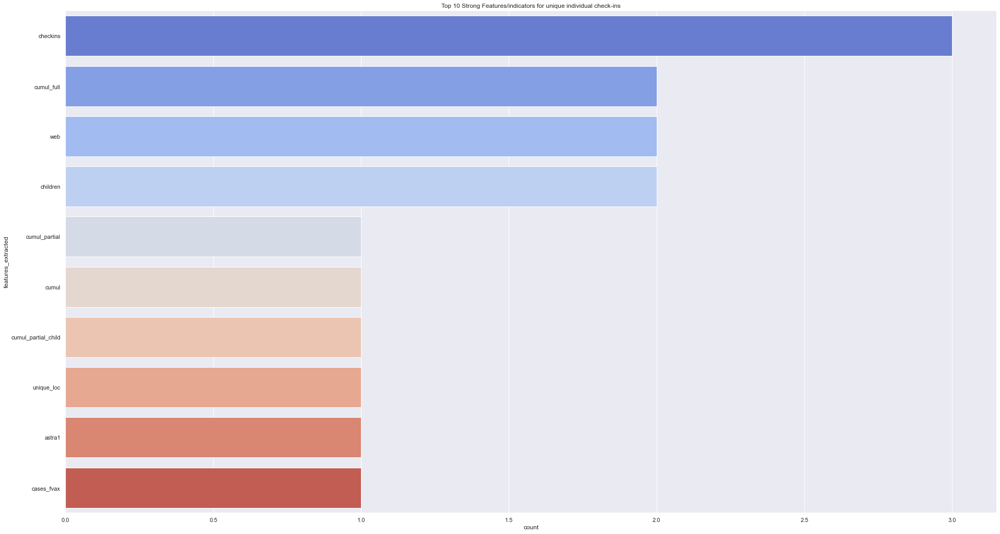

In [213]:
best_features = [] 

# plot and extract
plt.figure()
best_features = feature_extraction_for_individual_checkins(merged_malaysia2)
best_features

In [214]:
merged_malaysia3 = merged_malaysia2[['checkins', 'cumul_full', 'web', 'children', 'unique_individual_checkin_traffic']].copy()
merged_malaysia3['unique_individual_checkin_traffic'] = merged_malaysia3['unique_individual_checkin_traffic'].map({'low_traffic' :0, 'medium_traffic' :1, 'high_traffic' :2}).astype(int) #mapping numbers

X = merged_malaysia3.drop(['unique_individual_checkin_traffic'],axis=1)
y = merged_malaysia3['unique_individual_checkin_traffic']
scaler = MinMaxScaler()
X = scaler.fit_transform(X)
X = pd.DataFrame(X,columns=['checkins', 'cumul_full', 'web', 'children'])
X

,checkins,cumul_full,web,children
0,0.309936,0.000000,0.874848,0.000000
1,0.302700,0.008582,0.908618,0.004690
2,0.291663,0.015495,0.911859,0.010802
3,0.220762,0.021684,0.899846,0.018558
4,0.114941,0.027243,0.891954,0.026376
...,...,...,...,...
93,0.936336,0.973737,0.015599,0.975792
94,1.000000,0.979285,0.011739,0.981321
95,0.868857,0.984556,0.008102,0.987475
96,0.870205,0.991696,0.004011,0.993965


## 2.2 Do SMOTE

In [215]:
merged_malaysia2['unique_individual_checkin_traffic'].value_counts()

high_traffic      46
medium_traffic    45
low_traffic        7
Name: unique_individual_checkin_traffic, dtype: int64

Notice that, for the low_traffic class, we only have up to 7 classes only. Which means that, the model will be more biased to the medium and high traffic days. In order to prevent this, we will have to conduct oversampling of the data using SMOTE.

0    46
2    46
1    45
Name: unique_individual_checkin_traffic, dtype: int64


Text(0.5, 1.0, 'Class Distribution')

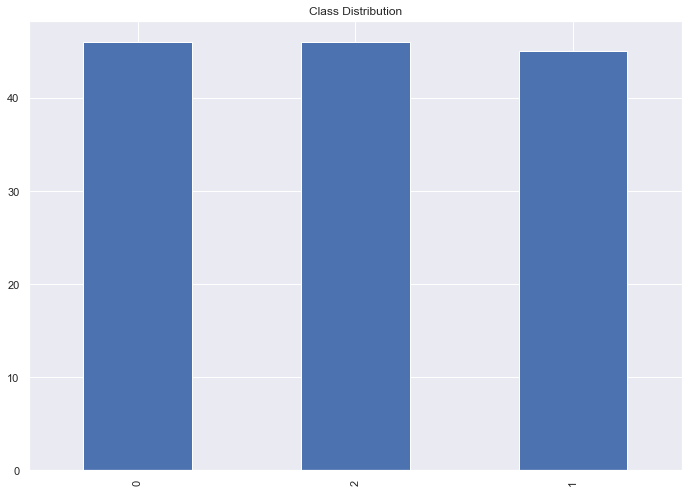

In [216]:
smt = imblearn.over_sampling.SMOTE(sampling_strategy="minority", random_state=42, k_neighbors=3)

X_res, y_res = smt.fit_resample(X, y)
print(y_res.value_counts())
y_res.value_counts().plot(kind="bar")
plt.title("Class Distribution")

After obtaining the oversample dataset, we will now begin to use our classification models to see, which models will perform the best to classify unique individual check-ins in a day.

We will be using 3 models: K-Nearest Neighbour, Decision Tree, and Support Vector Machine, and compare which of these 3 will produce the best result for us.

## 2.3 Using KNN

In [217]:
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size=0.2, random_state = 1)
knn_clf=KNeighborsClassifier()
knn_clf.fit(X_train,y_train)
ypred=knn_clf.predict(X_test) #These are the predicted output values

result = confusion_matrix(y_test, ypred)
print('Confusion Matrix:')
print(result)
result1 = classification_report(y_test, ypred)
print('Classification Report:',)
print (result1)
result_knn = accuracy_score(y_test,ypred)
print('Accuracy: ',result_knn)

Confusion Matrix:
[[7 0 0]
 [0 9 3]
 [0 0 9]]
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         7
           1       1.00      0.75      0.86        12
           2       0.75      1.00      0.86         9

    accuracy                           0.89        28
   macro avg       0.92      0.92      0.90        28
weighted avg       0.92      0.89      0.89        28

Accuracy:  0.8928571428571429


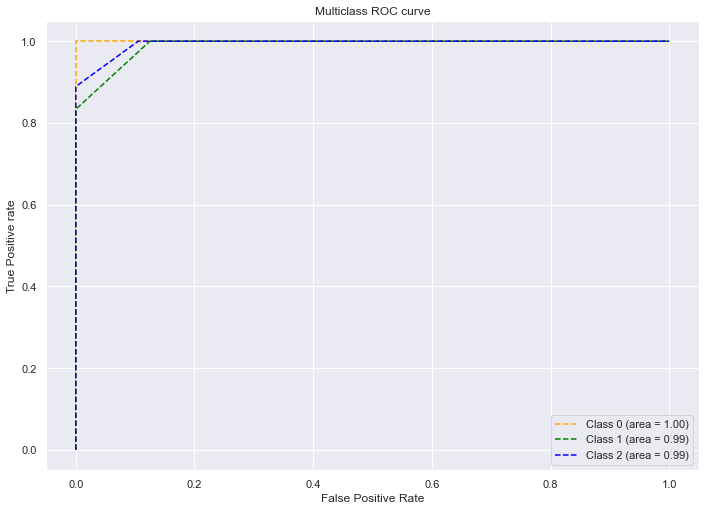

In [218]:
prob_knn = knn_clf.predict_proba(X_test)
roc_auc_score(y_test, prob_knn, multi_class='ovo', average='weighted')

fpr = {}
tpr = {}
thresh ={}
roc_auc = {}

n_class = 3

for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, prob_knn[:,i], pos_label=i)
    roc_auc[i] = auc(fpr[i], tpr[i])
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class {0} (area = {1:0.2f})'.format(0, roc_auc[0]))
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class {0} (area = {1:0.2f})'.format(1, roc_auc[1]))
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class {0} (area = {1:0.2f})'.format(2, roc_auc[2]))
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300);  

## 2.4 Using Decision Tree Classifier

In [219]:
model_DT = DecisionTreeClassifier(max_depth=5)
model_DT.fit(X_train, y_train)
y_pred = model_DT.predict(X_test)

result = confusion_matrix(y_test, y_pred)
print('Confusion Matrix:')
print(result)
result1 = classification_report(y_test, y_pred)
print('Classification Report:',)
print (result1)
result_decision_tree = accuracy_score(y_test,y_pred)
print('Accuracy: ',result_decision_tree)

Confusion Matrix:
[[ 7  0  0]
 [ 0 11  1]
 [ 0  0  9]]
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         7
           1       1.00      0.92      0.96        12
           2       0.90      1.00      0.95         9

    accuracy                           0.96        28
   macro avg       0.97      0.97      0.97        28
weighted avg       0.97      0.96      0.96        28

Accuracy:  0.9642857142857143


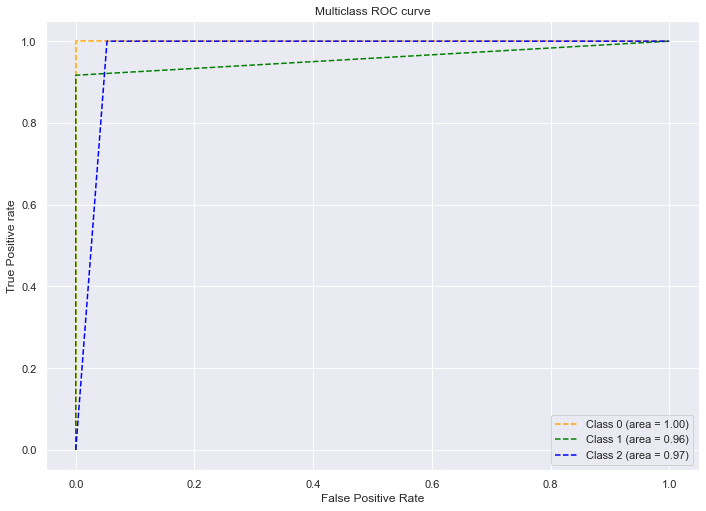

In [220]:
prob_DT = model_DT.predict_proba(X_test)
roc_auc_score(y_test, prob_DT, multi_class='ovo', average='weighted')

fpr = {}
tpr = {}
thresh ={}
roc_auc = {}

n_class = 3

for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, prob_DT[:,i], pos_label=i)
    roc_auc[i] = auc(fpr[i], tpr[i])
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class {0} (area = {1:0.2f})'.format(0, roc_auc[0]))
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class {0} (area = {1:0.2f})'.format(1, roc_auc[1]))
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class {0} (area = {1:0.2f})'.format(2, roc_auc[2]))
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300);  

## 2.5 Using SVM (linear)

In [221]:
clf = svm.SVC(kernel='linear', gamma='auto') # Linear Kernel
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

result = confusion_matrix(y_test, y_pred)
print('Confusion Matrix:')
print(result)
result1 = classification_report(y_test, y_pred)
print('Classification Report:',)
print (result1)
result_svm = accuracy_score(y_test,y_pred)
print('Accuracy: ',result_svm)

Confusion Matrix:
[[7 0 0]
 [2 8 2]
 [0 0 9]]
Classification Report:
              precision    recall  f1-score   support

           0       0.78      1.00      0.88         7
           1       1.00      0.67      0.80        12
           2       0.82      1.00      0.90         9

    accuracy                           0.86        28
   macro avg       0.87      0.89      0.86        28
weighted avg       0.89      0.86      0.85        28

Accuracy:  0.8571428571428571


## 2.6 Using SVM (rbf) 

In [222]:
clf = svm.SVC(kernel='rbf', gamma='auto') # Linear Kernel
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

result = confusion_matrix(y_test, y_pred)
print('Confusion Matrix:')
print(result)
result1 = classification_report(y_test, y_pred)
print('Classification Report:',)
print (result1)
result_svm = accuracy_score(y_test,y_pred)
print('Accuracy: ',result_svm)

Confusion Matrix:
[[7 0 0]
 [4 5 3]
 [0 0 9]]
Classification Report:
              precision    recall  f1-score   support

           0       0.64      1.00      0.78         7
           1       1.00      0.42      0.59        12
           2       0.75      1.00      0.86         9

    accuracy                           0.75        28
   macro avg       0.80      0.81      0.74        28
weighted avg       0.83      0.75      0.72        28

Accuracy:  0.75


## 2.7 Using SVM (poly, degree= 2,3,4) 

In [223]:
clf = svm.SVC(kernel='poly', degree=2, gamma='auto') # Linear Kernel
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

result = confusion_matrix(y_test, y_pred)
print('Confusion Matrix:')
print(result)
result1 = classification_report(y_test, y_pred)
print('Classification Report:',)
print (result1)
result_svm = accuracy_score(y_test,y_pred)
print('Accuracy: ',result_svm)

Confusion Matrix:
[[ 7  0  0]
 [10  0  2]
 [ 0  0  9]]
Classification Report:
              precision    recall  f1-score   support

           0       0.41      1.00      0.58         7
           1       0.00      0.00      0.00        12
           2       0.82      1.00      0.90         9

    accuracy                           0.57        28
   macro avg       0.41      0.67      0.49        28
weighted avg       0.37      0.57      0.44        28

Accuracy:  0.5714285714285714


C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [224]:
clf = svm.SVC(kernel='poly', degree=3, gamma='auto') # Linear Kernel
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

result = confusion_matrix(y_test, y_pred)
print('Confusion Matrix:')
print(result)
result1 = classification_report(y_test, y_pred)
print('Classification Report:',)
print (result1)
result_svm = accuracy_score(y_test,y_pred)
print('Accuracy: ',result_svm)

Confusion Matrix:
[[ 7  0  0]
 [12  0  0]
 [ 1  0  8]]
Classification Report:
              precision    recall  f1-score   support

           0       0.35      1.00      0.52         7
           1       0.00      0.00      0.00        12
           2       1.00      0.89      0.94         9

    accuracy                           0.54        28
   macro avg       0.45      0.63      0.49        28
weighted avg       0.41      0.54      0.43        28

Accuracy:  0.5357142857142857


C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [225]:
clf = svm.SVC(kernel='poly', degree=4, gamma='auto') # Linear Kernel
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

result = confusion_matrix(y_test, y_pred)
print('Confusion Matrix:')
print(result)
result1 = classification_report(y_test, y_pred)
print('Classification Report:',)
print (result1)
result_svm = accuracy_score(y_test,y_pred)
print('Accuracy: ',result_svm)

Confusion Matrix:
[[ 7  0  0]
 [12  0  0]
 [ 3  0  6]]
Classification Report:
              precision    recall  f1-score   support

           0       0.32      1.00      0.48         7
           1       0.00      0.00      0.00        12
           2       1.00      0.67      0.80         9

    accuracy                           0.46        28
   macro avg       0.44      0.56      0.43        28
weighted avg       0.40      0.46      0.38        28

Accuracy:  0.4642857142857143


C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Based on the results obtained, the Decision Tree Classifier performs the best for classifying and predicting the 3 class variables, with an accuracy of 0.96. It also has a significant good ROC value for all 3 classes (Class 0: 1.00, Class 1: 0.96, Class 2: 0.97). 

All this points to the fact that, we can use the Decision Tree Classifier model for classifying unique individual checkin traffic based on the data input. 

## 3. Question 3

#### Is there any relationship between income and vaccination rate for states in Malaysia?

Hafizi bin Ismail

The COVID-19 pandemic is unprecedented in scale and its impacts are looming large on the well-beings of people living in Malaysia. Many people are not able to handle nationwide lockdown as the nation attempts to curb the spread of COVID-19 early on, with the closure of many business and a halt to economic trades in Malaysia. [[1]](https://www.unido.org/sites/default/files/files/2021-03/UNIDO%20COVID19%20Assessment_Malaysia_FINAL.pdf) In order to curb the growing number of cases in Malaysia, Malaysia has implemented a nationwide vaccination programme in order to achieve herd immunity by vaccinating 80% of the adult population in Malaysia. [[2]](https://www.vaksincovid.gov.my/pdf/National_COVID-19_Immunisation_Programme.pdf)

However, despite the urgency of COVID-19 situation, there seems to be widespread hesitency [[3]](https://www.malaymail.com/news/malaysia/2021/06/22/not-all-who-dont-want-to-be-vaccinated-against-covid-19-are-anti-vaxxers-an/1983961) and distrust [[4]](https://www.dailyexpress.com.my/news/179312/anti-vaccine-movement-getting-louder-angrier-legal-expert/) at registering and taking the vaccines amongts Malaysian people.

In this question, we would like to investigate whether there's a trend between income and vaccination rates in states, namely between income group - B40, M40 and T20.

### 3.1 Data Merging and Visualization

#### 3.1.1 Income

In [226]:
# Income dataset ------------------------------
# https://www.data.gov.my/data/ms_MY/dataset/mean-monthly-household-gross-income-by-state-malaysia
income = pd.read_csv('random_dataset/_202108260434240_mean-monthly-household-gross-income-by-state-malaysia.csv')

# Dataset cleaning and preprocessing ----------
income.replace("n.a.", "0", inplace=True)
income.replace('N.Sembilan', 'Negeri Sembilan', inplace=True)
income.replace('P.Pinang', 'Pulau Pinang', inplace = True)
income.replace('W.P.KL', 'W.P. Kuala Lumpur', inplace=True)
income.replace('W.P.Labuan', 'W.P. Labuan', inplace=True)

income['Mean Monthly Household Gross Income'] = pd.to_numeric(income['Mean Monthly Household Gross Income'])
income.Year = pd.to_datetime(income.Year, format='%Y')

# Income groups -------------------------------
income['income_group'] = pd.cut(income['Mean Monthly Household Gross Income'], bins=[-1, 4850, 11000, 100000], labels=['B40', 'M40', 'T20'])

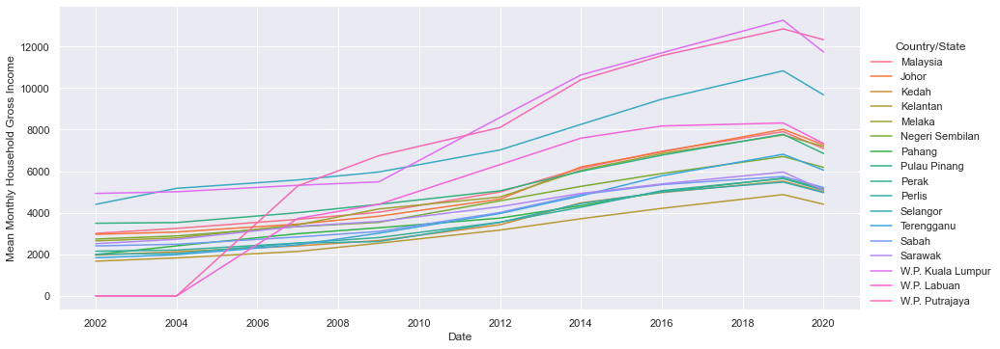

In [227]:
all_states = income['Country/State'].unique().tolist()

income_wide = income.pivot_table(index='Year', 
                                           columns='Country/State', 
                                           values=['Mean Monthly Household Gross Income']
                                          )

ax = sns.relplot(data=income_wide['Mean Monthly Household Gross Income'].loc[:,all_states], kind='line',
            aspect=2.5, dashes=False)
ax.set_xlabels('Date')
ax.set_ylabels('Mean Monthly Household Gross Income')

From the graph above, we can see income across all states has fallen in 2020 due to COVID-19 pandemic. However, all of the states still fall under their same income brackets as last year, thus we would be using income brackets to identify the relationship as well.

In [228]:
#income[income['Year'] >= '2019-01-01']
income_latest = income[income['Year'] >= '2019-01-01'].iloc[-16:]
income_latest.columns = ['state', 'year', 'mean_income', 'income_group']
income_latest

,state,year,mean_income,income_group
137,Johor,2020-01-01,7264,M40
138,Kedah,2020-01-01,5005,M40
139,Kelantan,2020-01-01,4411,B40
140,Melaka,2020-01-01,7186,M40
141,Negeri Sembilan,2020-01-01,6184,M40
142,Pahang,2020-01-01,5144,M40
143,Pulau Pinang,2020-01-01,6850,M40
144,Perak,2020-01-01,5081,M40
145,Perlis,2020-01-01,4971,M40
146,Selangor,2020-01-01,9668,M40


#### 3.1.2 Vaccination state and merging

In [229]:
# Combine vaccination state, population and income -------------------------

vax_state_trim = vax_state.iloc[-16:]
df_Q3 = pd.merge(vax_state_trim[['state', 'cumul_partial', 'cumul_partial_child', 'cumul_full', 'cumul_full_child']], population[['state', 'pop', 'pop_12']], on='state')
df_Q3 = pd.merge(df_Q3, income_latest[['state', 'mean_income', 'income_group']], on='state')

df_Q3
# --------------------------------------------------------------------------

# Calculate percentage of vaccinated pop -----------------------------------
df_Q3['perc_vax_full'] = (df_Q3['cumul_full'] / df_Q3['pop'] * 100).round(2)
df_Q3['perc_vax_part'] = (df_Q3['cumul_partial'] / df_Q3['pop'] * 100).round(2)

df_Q3['perc_vax_full_child'] = (df_Q3['cumul_full_child'] / df_Q3['pop_12'] * 100).round(2)
df_Q3['perc_vax_part_child'] = (df_Q3['cumul_partial_child'] / df_Q3['pop_12'] * 100).round(2)

df_Q3
# --------------------------------------------------------------------------

,state,cumul_partial,cumul_partial_child,cumul_full,cumul_full_child,pop,pop_12,mean_income,income_group,perc_vax_full,perc_vax_part,perc_vax_full_child,perc_vax_part_child
0,Johor,2873099,310300,2516534,54932,3781000,359900,7264,M40,66.56,75.99,15.26,86.22
1,Kedah,1478979,186479,1305269,53277,2185100,211400,5005,M40,59.73,67.68,25.20,88.21
2,Kelantan,1141296,161125,968286,40242,1906700,210600,4411,B40,50.78,59.86,19.11,76.51
3,Melaka,701739,80245,629577,18523,932700,86500,7186,M40,67.50,75.24,21.41,92.77
4,Negeri Sembilan,929298,94754,833000,19784,1128800,109400,6184,M40,73.80,82.33,18.08,86.61
5,Pahang,1132167,132644,1011665,45674,1678700,173000,5144,M40,60.26,67.44,26.40,76.67
6,Perak,1782140,194943,1590388,57840,2510300,237200,5081,M40,63.35,70.99,24.38,82.19
7,Perlis,200422,22425,177369,5666,254900,23100,4971,M40,69.58,78.63,24.53,97.08
8,Pulau Pinang,1448170,123022,1283201,18156,1773600,141500,6850,M40,72.35,81.65,12.83,86.94
9,Sabah,2299290,253087,2037946,177003,3908500,434000,5215,M40,52.14,58.83,40.78,58.31


### 3.2 Correlation between Income and Population Vaccinated (%)

#### 3.2.1 Using regression plot

[(4200.0, 12400.0)]

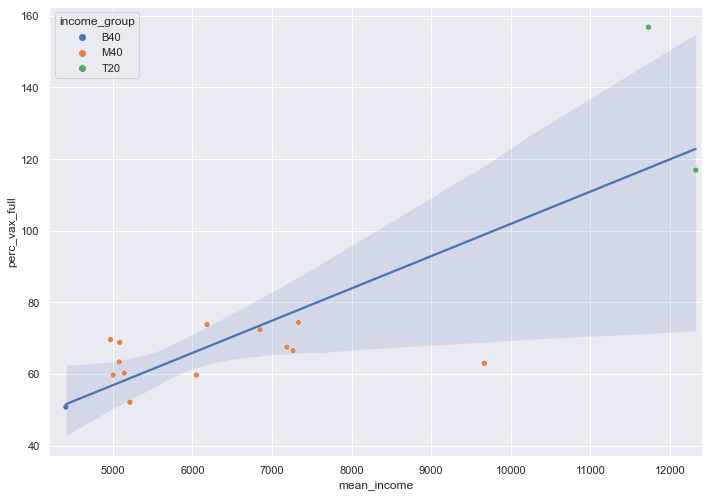

In [230]:
# ax = sns.pairplot(data=income_wide['Mean Monthly Household Gross Income'].loc[:,all_states], kind='line',
#             aspect=2.5, dashes=False)
# sns.scatterplot(data=tips, x="total_bill", y="tip", hue="time")

sns.set(rc={'figure.figsize':(11.7,8.27)})

# https://stackoverflow.com/questions/45955439/seaborn-regplot-removes-colors-of-datapoints
# https://stackoverflow.com/questions/47407173/seaborn-regression-plot-with-different-colors/
ax = sns.regplot(x="mean_income", y="perc_vax_full", data=df_Q3, scatter=False)
ax = sns.scatterplot(data=df_Q3, x='mean_income', y='perc_vax_full', hue='income_group')
ax.set(xlim=(4200, 12400))
#ax.set_xlabels('Date')
#ax.set_ylabels('Mean Monthly Household Gross Income')

From this chart, we can see that there's a positive correlation between their mean incomes and the percentage of population vaccinated. However, Sabah seems to have rather low vaccination rate relative to income, with only 58.83% of their population being vaccinated despite being in the higher bracket of M40 group. Some of the likely causes are relative remoteness of the state [[5]](https://www.thestar.com.my/news/nation/2021/10/02/sabah039s-low-vaccination-rate-possibly-due-to-remoteness-of-areas-migration-says-health-dept) and a lot of the vaccines delivered remained unutilized. [[6]](https://codeblue.galencentre.org/2021/10/06/sabah-still-has-over-ibe-million-covid-19-vaccine-doses-in-balance/) 

States like W.P. Kuala Lumpur seems to have much higher vaccination, likely due to people moving in from different states to get their vaccines in W.P Kuala Lumpur's PPV centres.

#### 3.2.2 Using LM Model 

In [231]:
import statsmodels.api as sm

X = df_Q3[['mean_income']]
Y = df_Q3[['perc_vax_full']]

# model = sm.OLS(Y,X).fit()
# predictions = model.predict(X)

X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
predictions = model.predict(X)
model.summary()

C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\statsmodels\tsa\tsatools.py:130: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)
C:\Users\user\anaconda3\envs\testpmdarima\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          perc_vax_full   R-squared:                       0.668
Model:                            OLS   Adj. R-squared:                  0.644
Method:                 Least Squares   F-statistic:                     28.16
Date:                Mon, 01 Nov 2021   Prob (F-statistic):           0.000111
Time:                        08:31:39   Log-Likelihood:                -65.923
No. Observations:                  16   AIC:                             135.8
Df Residuals:                      14   BIC:                             137.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const          11.8156     12.284      0.962      0.352     -14.530      38.162
mean_income     0.0090      0.002      5.307      0.000       0.005       0.013
==============================================================================
Omnibus:                        5.696   Durbin-Watson:                   2.299
Prob(Omnibus):                  0.058   Jarque-Bera (JB):                3.595
Skew:                           0.296   Prob(JB):                        0.166
Kurtosis:                       5.246   Cond. No.                     2.23e+04
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.23e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

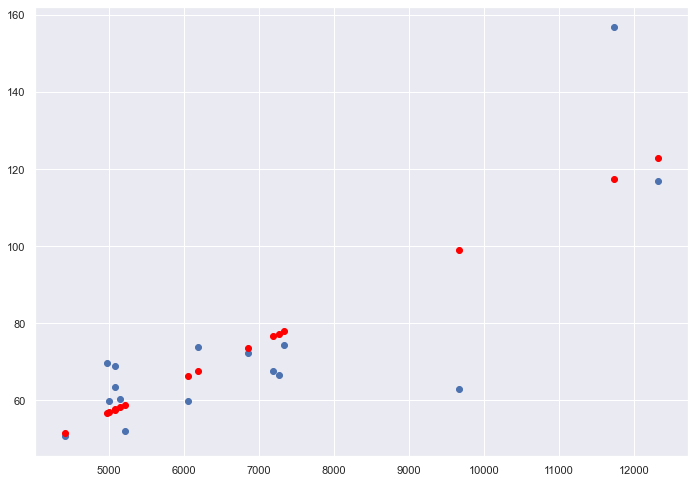

In [232]:
plt.scatter(X['mean_income'],Y)
plt.scatter(X['mean_income'],predictions, color='red')

From the table summary above, we can see that the R-square for mean income and the percentage of population fully vaccinated is 0.668, which is a positive correlation.

### 3.3 Conclusion

COVID-19 had a big impact on the livelihood of many Malaysian people, as the average population income dropped considerably during 2020. From 3.2, we can observe that there's a strong correlation between income and vaccination rate. We can see that richer state (T20) had higher vaccination rate, implying there may be profit incentive to be vaccinated and reopen the economy. 

M40 states are still working towards being fully vaccinated, although there's states like Sabah which is only at 60% vaccination despite being in higher bracket of M40. B40 states have much lower vaccination rates, although it's still above 60% which is rather good.

## 4. Question 4

#### Relationship between vaccination rate and cases/death? What does it imply? (correlation)

By October 4, 87.6% of the adult population has been vaccinated. [[7]](https://www.thestar.com.my/news/nation/2021/10/04/covid-19-876-percent-of-malaysia039s-adults-fully-vaccinated-as-of-sunday-oct-3)

In this question, we would investage whether being vaccinated would reduce the likelihood of getting infected and whether it helps at reducing the death rate.

### 4.1 Data merging

#### 4.1.1 Cases and vaccination dataset

In [233]:
# ========================
# Malaysia
# ========================

# Get population count --------------------------

# https://stackoverflow.com/questions/16729574/how-to-get-a-value-from-a-cell-of-a-dataframe
malaysia_pop = population.iloc[0]['pop']
malaysia_pop_child = population.iloc[0]['pop_12']

# Merge vaccination and cases ------------------------
vax_column_select = ['date', 'cumul_partial', 'cumul_full', 'daily_full', 'cumul_partial_child', 'cumul_full_child']
cases_column_select = ['date', 'cases_new', 'cases_pvax', 'cases_fvax', 'cases_recovered' ,'cases_active']

df_Q4_malaysia = pd.merge(left=vax_malaysia[vax_column_select], right=cases_malaysia[cases_column_select], how='inner', on=['date'])

# Calculate vaccination rate --------------------------
df_Q4_malaysia['perc_fvax'] = (df_Q4_malaysia['cumul_full'] / malaysia_pop * 100).round(2)
df_Q4_malaysia['perc_pvax'] = (df_Q4_malaysia['cumul_partial'] / malaysia_pop * 100).round(2)

df_Q4_malaysia['perc_fvax_child'] = (df_Q4_malaysia['cumul_full_child'] / malaysia_pop_child * 100).round(2)
df_Q4_malaysia['perc_pvax_child'] = (df_Q4_malaysia['cumul_partial_child'] / malaysia_pop_child * 100).round(2)

df_Q4_malaysia['perc_cases_fvax'] = (df_Q4_malaysia['cases_fvax'] / df_Q4_malaysia['cases_new'] * 100).round(2)
#df_Q4_malaysia['perc_cases_pvax'] = (df_Q4_malaysia['cases_pvax'])

## 28/10/2021
df_Q4_malaysia['cases_per_100000'] = (df_Q4_malaysia['cases_new'] / malaysia_pop * 100000).round(1)
df_Q4_malaysia['cases_fvax_per_100000'] = (df_Q4_malaysia['cases_fvax'] / malaysia_pop * 100000).round(1)

# beds utilization

 
# Calculate vaccination c
df_Q4_malaysia

,date,cumul_partial,cumul_full,daily_full,cumul_partial_child,cumul_full_child,cases_new,cases_pvax,cases_fvax,cases_recovered,cases_active,perc_fvax,perc_pvax,perc_fvax_child,perc_pvax_child,perc_cases_fvax,cases_per_100000,cases_fvax_per_100000
0,2021-02-24,60,0,0,0,0,3545,0,0,3331,30572,0.00,0.00,0.00,0.00,0.00,10.9,0.0
1,2021-02-25,1206,0,0,0,0,1924,0,0,3752,28738,0.00,0.00,0.00,0.00,0.00,5.9,0.0
2,2021-02-26,5321,1,1,0,0,2253,0,0,3085,27903,0.00,0.02,0.00,0.00,0.00,6.9,0.0
3,2021-02-27,12044,2,1,0,0,2364,0,0,3320,26937,0.00,0.04,0.00,0.00,0.00,7.2,0.0
4,2021-02-28,18743,5,3,0,0,2437,0,0,3251,26118,0.00,0.06,0.00,0.00,0.00,7.5,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,2021-10-12,24567968,21591116,153736,2352464,370995,7276,776,4425,10555,108747,66.11,75.23,11.79,74.74,60.82,22.3,13.5
231,2021-10-13,24620890,21744866,153750,2390062,453906,7950,777,4948,10832,105822,66.58,75.39,14.42,75.94,62.24,24.3,15.2
232,2021-10-14,24663184,21907522,162656,2416010,551972,8084,720,4993,12456,101422,67.08,75.52,17.54,76.76,61.76,24.8,15.3
233,2021-10-15,24699864,22036881,129359,2439727,637079,7420,611,4588,11413,97417,67.48,75.63,20.24,77.51,61.83,22.7,14.0


#### 4.1.2 Deaths and vaccination dataset

In [234]:
deaths_malaysia.reset_index(inplace=True)

In [235]:
# ========================
# Malaysia
# ========================

# Get population count --------------------------

# https://stackoverflow.com/questions/16729574/how-to-get-a-value-from-a-cell-of-a-dataframe
malaysia_pop = population.iloc[0]['pop']
malaysia_pop_child = population.iloc[0]['pop_12']

# Merge vaccination and cases ------------------------
vax_column_select = ['date', 'cumul_partial', 'cumul_full', 'daily_full', 'cumul_partial_child', 'cumul_full_child']
deaths_column_select = ['date', 'deaths_new', 'deaths_pvax', 'deaths_fvax']

df_Q4_malaysia_death = pd.merge(left=vax_malaysia[vax_column_select], right=deaths_malaysia[deaths_column_select], how='inner', on=['date'])

# Calculate vaccination rate --------------------------
df_Q4_malaysia_death['perc_fvax'] = (df_Q4_malaysia_death['cumul_full'] / malaysia_pop * 100).round(2)
df_Q4_malaysia_death['perc_pvax'] = (df_Q4_malaysia_death['cumul_partial'] / malaysia_pop * 100).round(2)

df_Q4_malaysia_death['perc_fvax_child'] = (df_Q4_malaysia_death['cumul_full_child'] / malaysia_pop_child * 100).round(2)
df_Q4_malaysia_death['perc_pvax_child'] = (df_Q4_malaysia_death['cumul_partial_child'] / malaysia_pop_child * 100).round(2)

df_Q4_malaysia_death['perc_deaths_fvax'] = (df_Q4_malaysia_death['deaths_fvax'] / df_Q4_malaysia_death['deaths_new'] * 100).round(2)
#df_Q4_malaysia['perc_cases_pvax'] = (df_Q4_malaysia['cases_pvax'])

df_Q4_malaysia_death['deaths_per_1000000'] = (df_Q4_malaysia_death['deaths_new'] / malaysia_pop * 1000000).round(1)
df_Q4_malaysia_death['deaths_fvax_per_1000000'] = (df_Q4_malaysia_death['deaths_fvax'] / malaysia_pop * 1000000).round(1)

# Calculate vaccination c
df_Q4_malaysia_death

,date,cumul_partial,cumul_full,daily_full,cumul_partial_child,cumul_full_child,deaths_new,deaths_pvax,deaths_fvax,perc_fvax,perc_pvax,perc_fvax_child,perc_pvax_child,perc_deaths_fvax,deaths_per_1000000,deaths_fvax_per_1000000
0,2021-02-24,60,0,0,0,0,12,0,0,0.00,0.00,0.00,0.00,0.00,0.4,0.0
1,2021-02-25,1206,0,0,0,0,13,0,0,0.00,0.00,0.00,0.00,0.00,0.4,0.0
2,2021-02-26,5321,1,1,0,0,10,0,0,0.00,0.02,0.00,0.00,0.00,0.3,0.0
3,2021-02-27,12044,2,1,0,0,10,0,0,0.00,0.04,0.00,0.00,0.00,0.3,0.0
4,2021-02-28,18743,5,3,0,0,9,0,0,0.00,0.06,0.00,0.00,0.00,0.3,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,2021-10-12,24567968,21591116,153736,2352464,370995,103,8,27,66.11,75.23,11.79,74.74,26.21,3.2,0.8
231,2021-10-13,24620890,21744866,153750,2390062,453906,68,3,15,66.58,75.39,14.42,75.94,22.06,2.1,0.5
232,2021-10-14,24663184,21907522,162656,2416010,551972,88,4,12,67.08,75.52,17.54,76.76,13.64,2.7,0.4
233,2021-10-15,24699864,22036881,129359,2439727,637079,89,0,6,67.48,75.63,20.24,77.51,6.74,2.7,0.2


### 4.2 Data visualization

#### 4.2.1 Vaccination vs Cases by COVID-19

We assume that the number of cases of COVID-19 would go down as the vaccination rate amongst the general public goes up. Thus, we would investigate the relationship between those two variables.

##### 4.2.1.1 Daily cases and percentage of people fully vaccinated

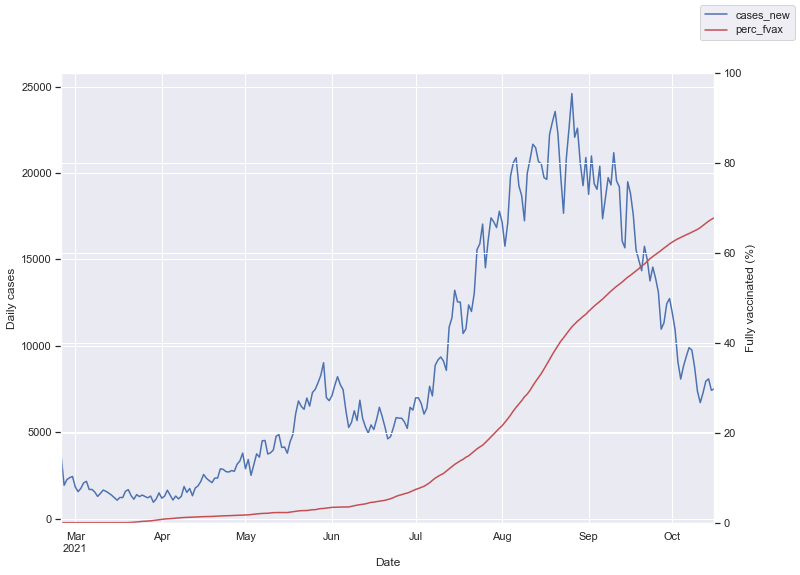

In [236]:
# Plot daily cases and percentage of people fully vaccinated ----------------

# https://stackoverflow.com/questions/47591650/second-y-axis-time-series-seaborn
# https://stackoverflow.com/questions/6142944/how-can-i-plot-with-2-different-y-axes/6143251
ax = df_Q4_malaysia.plot(x='date', y='cases_new', legend=False)
ax.set_xlabel('Date')
ax.set_ylabel('Daily cases')
ax2 = ax.twinx()
ax2.set(ylim=(0, 100))
df_Q4_malaysia.plot(x='date', y='perc_fvax', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Fully vaccinated (%)')
ax.figure.legend()
plt.show()

# ----------------------------------------------------------------------------

From this graph, we can see that during July, there's a huge vaccination drive around the same time COVID-19 cases ramped up, as the Malaysian government seek to curb the epidemic with combination of stricter lockdown[[9]](https://www.straitstimes.com/asia/se-asia/stricter-lockdown-curfews-in-klang-valley-as-covid-19-cases-soar-in-malaysia) and mass vaccination program. [[10]](https://www.channelnewsasia.com/asia/malaysia-covid-19-vaccination-experts-caution-no-silver-bullet-2070271) However, we can see that it took 2 months for those two measures to have effects on the number of COVID-19 cases in Malaysia. 

The number of cases seems to be stabilize at around 50% mark, and then goes down significantly at 60% vaccination. This could imply that the vaccination programme contributed to the lowering of daily COVID-19 cases in Malaysia. Although, we have yet to see the effectiveness of vaccinated population at reducing cases numbers as the economy has not opened up completely and there are still restrictions in place. Once the Phase 4 of National Recovery Plan starts at earnest, we can then see whether vaccine would help prevent the spread of COVID-19 to vaccinated and unvaccinated population at large.

##### 4.2.1.2 Daily cases on fully vaccinated people and population fully vaccinated

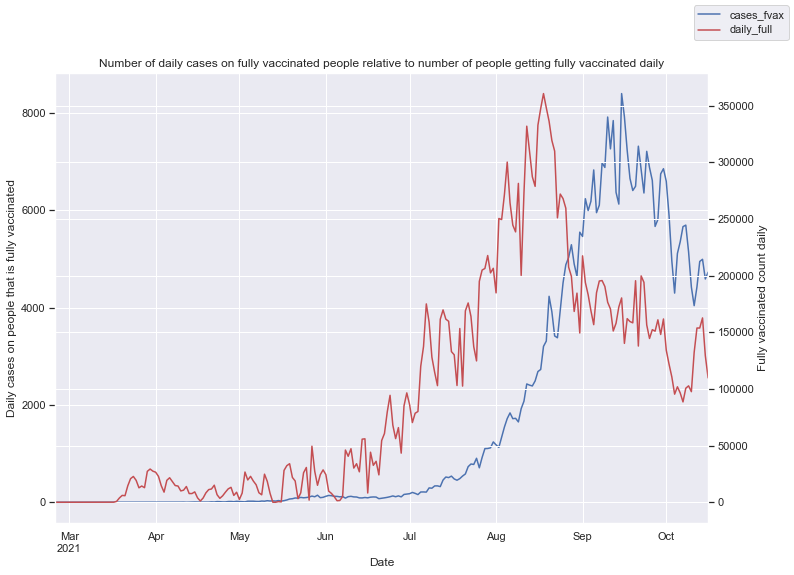

R^2 = 0.3594608131409408


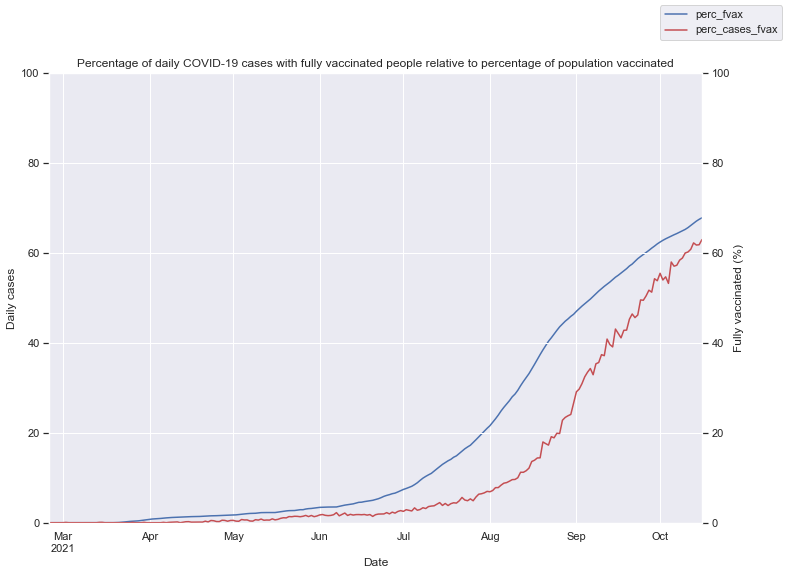

R^2 = 0.9232055360905697


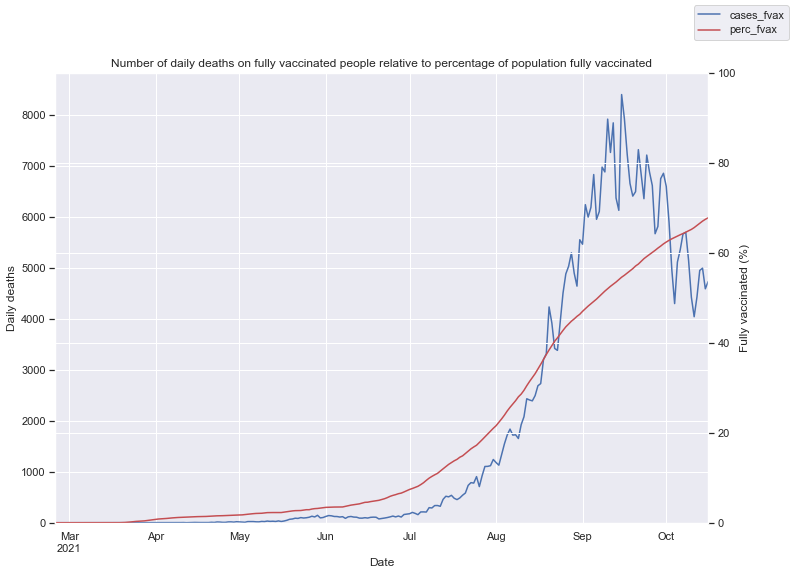

R^2 = 0.9045969218741838


In [237]:
ax = df_Q4_malaysia.plot(x='date', y='cases_fvax', legend=False)
ax.set_xlabel('Date')
ax.set_ylabel('Daily cases on people that is fully vaccinated')
ax.set_title('Number of daily cases on fully vaccinated people relative to number of people getting fully vaccinated daily')
ax2 = ax.twinx()
#ax2.set(ylim=(0, 100))
df_Q4_malaysia.plot(x='date', y='daily_full', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Fully vaccinated count daily')
ax.figure.legend()
plt.show()

correlation_matrix = np.corrcoef(df_Q4_malaysia['cases_fvax'], df_Q4_malaysia['daily_full'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print('R^2 = ' + str(r_squared))

ax = df_Q4_malaysia.plot(x='date', y='perc_fvax', legend=False)
ax.set_xlabel('Date')
ax.set_ylabel('Daily cases')
ax.set_title('Percentage of daily COVID-19 cases with fully vaccinated people relative to percentage of population vaccinated')
ax.set(ylim=(0, 100))
ax2 = ax.twinx()
ax2.set(ylim=(0, 100))
df_Q4_malaysia.plot(x='date', y='perc_cases_fvax', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Fully vaccinated (%)')
ax.figure.legend()
plt.show()

correlation_matrix = np.corrcoef(df_Q4_malaysia['perc_fvax'], df_Q4_malaysia['perc_cases_fvax'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print('R^2 = ' + str(r_squared))


ax = df_Q4_malaysia.plot(x='date', y='cases_fvax', legend=False)
ax.set(ylim=(0, None))
ax.set_xlabel('Date')
ax.set_ylabel('Daily deaths')
ax.set_title('Number of daily deaths on fully vaccinated people relative to percentage of population fully vaccinated')
ax2 = ax.twinx()
ax2.set(ylim=(0, 100))
df_Q4_malaysia.plot(x='date', y='perc_fvax', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Fully vaccinated (%)')
ax.figure.legend()
plt.show()

correlation_matrix = np.corrcoef(df_Q4_malaysia['cases_fvax'], df_Q4_malaysia['perc_fvax'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print('R^2 = ' + str(r_squared))

In this first graph, we can see that the number of people getting fully vaccinated daily spikes up as the Government ramped up the vaccination programme, though it slows down as number of cases spikes up considerably. There's 2-3 weeks gap between each spike, which could mean that there would eventually be larger population of fully vaccinated getting infected as more population are getting vaccinated. 

In the second graph, we can see that the proportion of COVID-19 cases on fully vaccinated people strongly correlates to the percentage of fully vaccinated population, with $R^2$ of 0.92. From this, we conclude that the vaccines does not reduce the number of COVID-19 cases. 

##### 4.2.1.3 COVID-19 cases per 100000 people vs COVID-19 cases with fully vaccinated per 100000 people

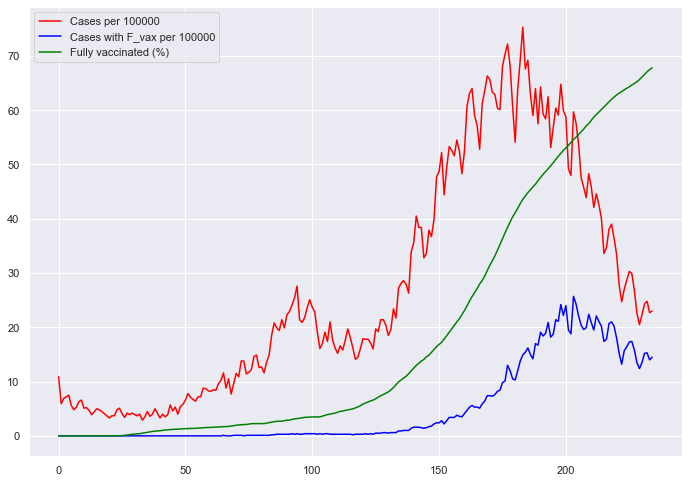

In [238]:
plt.plot(df_Q4_malaysia['cases_per_100000'], color = 'red', label = 'Cases per 100000')
plt.plot(df_Q4_malaysia['cases_fvax_per_100000'], color = 'blue', label = 'Cases with F_vax per 100000')
plt.plot(df_Q4_malaysia['perc_fvax'], color='green', label='Fully vaccinated (%)')
plt.legend()
plt.show()



From the graph above, we can see that cases in general, cases starts dropping down once the vaccination rate hits 50%. By October 2021, COVID-19 cases are going down such that total COVID-19 cases and total cases related to fully vaccinated are almost the same.

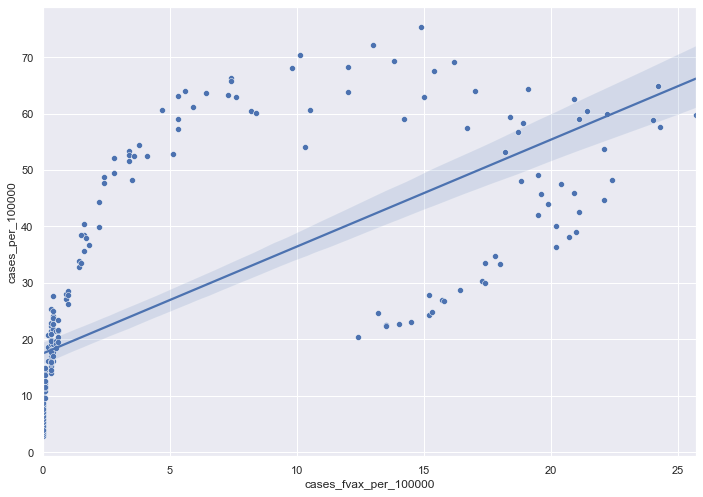

In [239]:
sns.set(rc={'figure.figsize':(11.7,8.27)})

# https://stackoverflow.com/questions/45955439/seaborn-regplot-removes-colors-of-datapoints
# https://stackoverflow.com/questions/47407173/seaborn-regression-plot-with-different-colors/
ax = sns.regplot(x="cases_fvax_per_100000", y="cases_per_100000", data=df_Q4_malaysia, scatter=False)
ax = sns.scatterplot(x="cases_fvax_per_100000", y="cases_per_100000", data=df_Q4_malaysia)

We can see that relationship between those two variables - cases_fvax and cases exhibits heteroscedasticity features. as the deviations of a predicted variable monitored over different values of an independent variable are non-constant. The deviation changes throughout the plot, although we assumed that once the vaccination rate gets high enough, high proportion of cases are from fully vaccinated, as the scatterplot loops back.

In [240]:
correlation_matrix = np.corrcoef(df_Q4_malaysia['cases_fvax_per_100000'], df_Q4_malaysia['cases_per_100000'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print(r_squared)

0.4711869366316774


Calculating  𝑅2  for those two plots, we get 0.47 correlation, which implies that the vaccination only marginally or does not prevent one from getting infected from COVID-19.

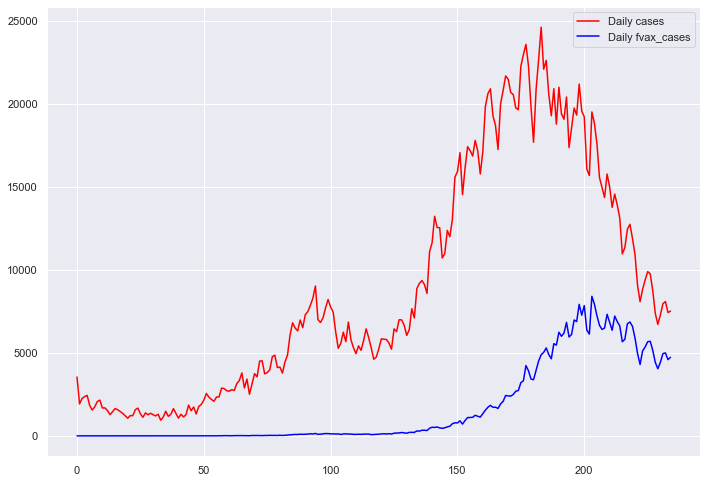

In [241]:
plt.plot(df_Q4_malaysia['cases_new'], color = 'red', label = 'Daily cases')
plt.plot(df_Q4_malaysia['cases_fvax'], color = 'blue', label = 'Daily fvax_cases')
#plt.plot(df_Q4_malaysia['perc_fvax'], color='green', label='Fully vaccinated (%)')
plt.legend()
plt.show()

##### 4.2.1.4 Conclusion for vaccination vs cases

We had initially assumed that COVID-19 vaccines would reduce the number of COVID-19 cases, as more and more population is getting vaccinated. In 4.2.1.1, we can see that the cases are indeed going down by a lot at 60% vaccination, however 4.1.1.2 does show that more people getting vaccinated means more fully vaccinated people getting infected by COVID-19. In 4.1.1.3, we can see that the number of COVID-19 cases would eventually equal to cases with fully vaccinated people, but the cases are still not going down by much and it's possible that number of cases would still be slightly or equal to number cases prior to the July-Oct wave, except that the most of the cases are those from vaccinated people.

There could be a different pattern once 60~80% of the population have been vaccinated, though it's far too early to say much on it. One thing of note is that vaccines alone may not reduce the number of cases and that another lockdown would be needed if another COVID wave hits Malaysia despite having most if not all of population vaccinated.

#### 4.2.2 Vaccination vs Death by COVID-19

Here, we would assume that vaccines would reduce the number of deaths amongst Malaysia, as government raced to provide herd immunity by accelerating its vaccination programme. Thus, we would investigate the vaccination and death data to see if vaccine provide an impact at reducing the number of deaths.

##### 4.2.2.1 Daily deaths and percentage of people fully vaccinated

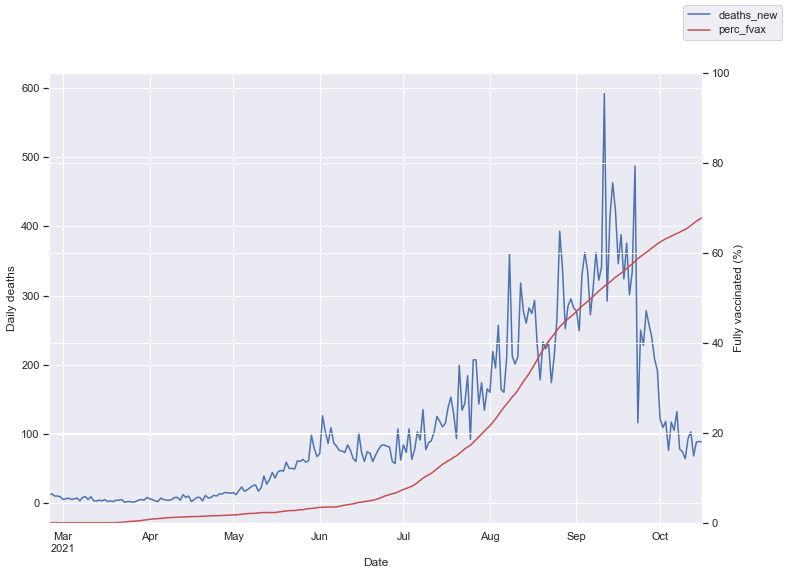

R^2 = 0.5365510742532331


In [242]:
# Plot daily deaths and percentage of people fully vaccinated ----------------

# https://stackoverflow.com/questions/47591650/second-y-axis-time-series-seaborn
ax = df_Q4_malaysia_death.plot(x='date', y='deaths_new', legend=False, color='b')
#ax3 = df_Q4_malaysia_death.plot(x='date', y='deaths_fvax', legend=False, color='g')
ax.set_xlabel('Date')
ax.set_ylabel('Daily deaths')
ax2 = ax.twinx()
ax2.set(ylim=(0, 100))
df_Q4_malaysia_death.plot(x='date', y='perc_fvax', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Fully vaccinated (%)')
ax.figure.legend()
plt.show()

# # ----------------------------------------------------------------------------
# axes_lst = []    

# #plot fig1
# fig1 = plt.figure()
# ax1 = fig1.add_subplot(111)
# axes_lst.append(ax1)

# #plot fig2
# fig2 = plt.figure()
# ax2 = fig2.add_subplot(111)
# axes_lst.append(ax2)

# for ax in axes_lst:
#     ax.plot(x, y)

# plt.show()

correlation_matrix = np.corrcoef(df_Q4_malaysia_death['deaths_new'], df_Q4_malaysia_death['perc_fvax'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print('R^2 = ' + str(r_squared))


From this graph, we can see that daily deaths follows the trend of vaccination rate, although it seems to fall off significantly by Oct 2021 and stays around 20 deaths per day from there.

##### 4.2.2.2 Daily deaths on fully vaccinated people and vaccination rate

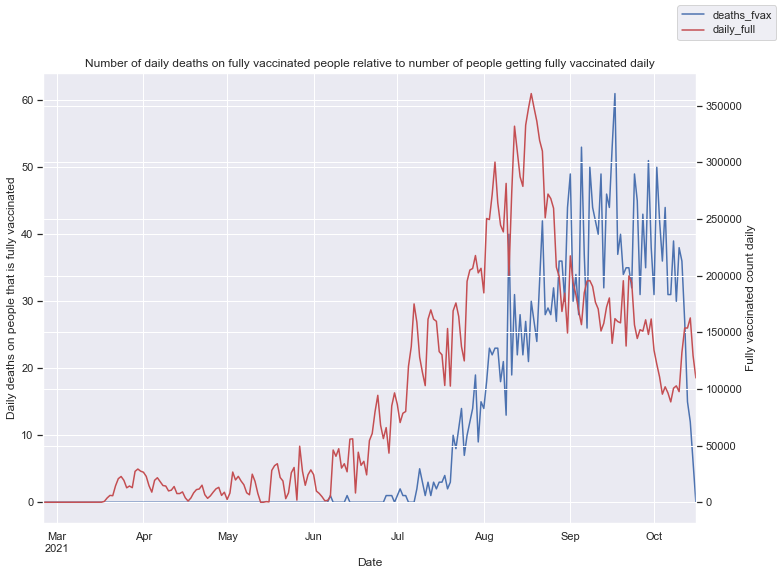

R^2 = 0.4762693489514021


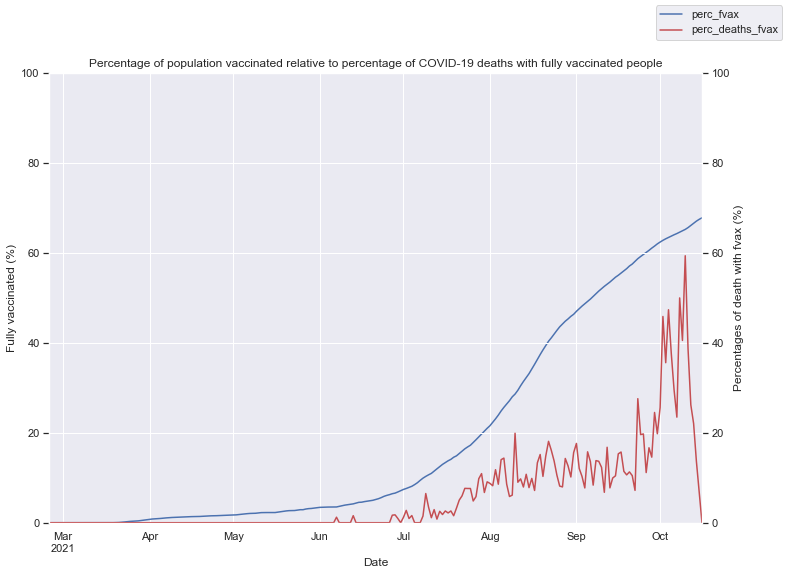

R^2 = 0.67804028511225


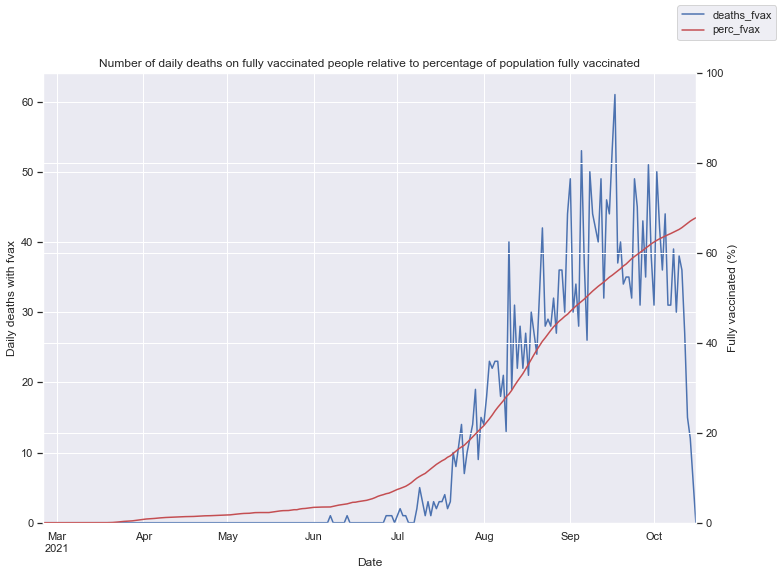

R^2 = 0.8160857096561593


In [243]:
ax = df_Q4_malaysia_death.plot(x='date', y='deaths_fvax', legend=False)
ax.set_xlabel('Date')
ax.set_ylabel('Daily deaths on people that is fully vaccinated')
ax.set_title('Number of daily deaths on fully vaccinated people relative to number of people getting fully vaccinated daily')
ax2 = ax.twinx()
#ax2.set(ylim=(0, 100))
df_Q4_malaysia_death.plot(x='date', y='daily_full', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Fully vaccinated count daily')
ax.figure.legend()
plt.show()

correlation_matrix = np.corrcoef(df_Q4_malaysia_death['deaths_fvax'], df_Q4_malaysia_death['daily_full'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print('R^2 = ' + str(r_squared))

ax = df_Q4_malaysia_death.plot(x='date', y='perc_fvax', legend=False)
ax.set_xlabel('Date')
#ax.set_ylabel('Daily deaths with fvax (%)')
ax.set_ylabel('Fully vaccinated (%)')
ax.set_title('Percentage of population vaccinated relative to percentage of COVID-19 deaths with fully vaccinated people')
ax.set(ylim=(0, 100))
ax2 = ax.twinx()
ax2.set(ylim=(0, 100))
df_Q4_malaysia_death.plot(x='date', y='perc_deaths_fvax', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Percentages of death with fvax (%)')
ax.figure.legend()
plt.show()

correlation_matrix = np.corrcoef(df_Q4_malaysia_death['perc_fvax'], df_Q4_malaysia_death['perc_deaths_fvax'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print('R^2 = ' + str(r_squared))


ax = df_Q4_malaysia_death.plot(x='date', y='deaths_fvax', legend=False)
ax.set(ylim=(0, None))
ax.set_xlabel('Date')
ax.set_ylabel('Daily deaths with fvax')
ax.set_title('Number of daily deaths on fully vaccinated people relative to percentage of population fully vaccinated')
ax2 = ax.twinx()
ax2.set(ylim=(0, 100))
df_Q4_malaysia_death.plot(x='date', y='perc_fvax', ax=ax2, legend=False, color='r')
ax2.set_ylabel('Fully vaccinated (%)')
ax.figure.legend()
plt.show()

correlation_matrix = np.corrcoef(df_Q4_malaysia_death['deaths_fvax'], df_Q4_malaysia_death['perc_fvax'])
correlation_xy = correlation_matrix[0,1]
r_squared = correlation_xy**2

print('R^2 = ' + str(r_squared))

In this first graph, we can see that the number of people getting fully vaccinated daily spikes up as the Government ramped up the vaccination programme. There's 2-3 weeks gap between each spike, which could mean that there would eventually be larger population of fully vaccinated getting dying as more population are getting vaccinated.

In the second graph, we can see that the proportion of COVID-19 deaths on fully vaccinated population are rather low after the initial spike in Aug 2021. Though during the Oct 2021, the percentage jumps to a surprising 60% deaths with fully vaccinated, and then drops all the way down to 0 cases.

In the third graph, we can that number of deaths follows the vaccination rate trend up until Oct 2021. Then, the number drops all the way to 0 at Oct 16.

From this, we are unable to determine that vaccination rate actually reduce the number or not. Death correlates to the number of fully vaccinated up to a certain point, then the death goes down to 0.

##### 4.2.2.3 COVID-19 deaths per 1000000 people vs COVID-19 deaths with fully vaccinated per 1000000 people

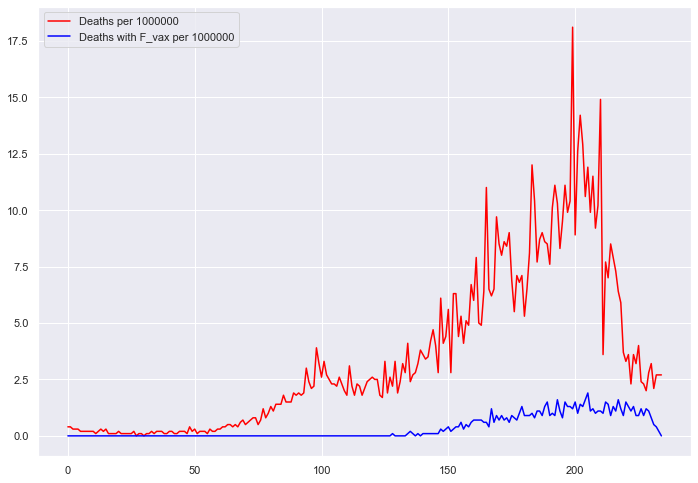

In [244]:
plt.plot(df_Q4_malaysia_death['deaths_per_1000000'], color = 'red', label = 'Deaths per 1000000')
plt.plot(df_Q4_malaysia_death['deaths_fvax_per_1000000'], color = 'blue', label = 'Deaths with F_vax per 1000000')
#plt.plot(df_Q4_malaysia_death['perc_fvax'], color='green', label='Fully vaccinated (%)')
plt.legend()
plt.show()

We can see that the number of cases deaths spikes really high around Sept-Oct 2021, however the number of cases with fvax remains relatively low compared to the number of death and goes to 0 by mid Oct 16.

##### 4.2.2.4 Conclusion for Vaccination vs Death

Vaccination seems to have a reduce the number of death initially amongst the vaccinated population, as we can see from second graph in 4.2.2.2, however it spikes up for a week before going back down. However, we can also observe that the death fell down at around 60% vaccination rate.

### 4.3 Conclusion

As Malaysia looks forward to reopen most of the economy with the Economey Recovery Plan (ERP) announced by Malaysian Prime Minitster, we needed to be certain that the measures implemented by the government is sufficient so that we do not experienced another COVID-19 wave that forces us to close down again.

Two of the main measures done by the governemt during the July-Oct wave is lockdown on most sectors and mass vaccination programme. We had initially assumed that COVID-19 vaccines would reduce the number of COVID-19 cases and deaths, as more and more population is getting vaccinated. In 4.2.1.1, we can see that the cases are indeed going down by a lot at 60% vaccination, however we can see that most of the cases later on would be mostly fully vaccinated one.

As for deaths count, the numbers of deaths amongst population remains relatively low compared to total number of deaths, and the deaths drops considerably after reaching 60% vaccination. Also, the deaths amongst those that is fully vaccinated remains low, then suddenly reaching up to 60% of deaths for that day before dropping down to 0%. We're not sure whether that implies that the vaccines is effective at preventing death by COVID-19 or not, and we would need more data to investigate it further.

There could be a different pattern once 80% of the population have been vaccinated, though it's far too early to say much on it. One thing of note is that vaccines alone may not reduce the number of cases and that another lockdown would be needed if another COVID wave hits Malaysia despite having most if not all of population vaccinated.

## 5. Question 5

##### What clustering techniques can be used? What patterns can be observed from this?

For this question, we would be using TimeSeriesKMeans to cluster each states on their cases and deaths. We would first merge the data from cases and deaths, then we would cluster those states based on those cateogories.

We could observe how these states are doing in general at handling COVID-19 cases and deaths by observing those clusters.

### 5.1 Clustering states based on cases

#### Merging datasets for COVID-19 cases

In [245]:
df_Q11_cases = cases_state.copy()
df_Q11_cases = df_Q11_cases[['date', 'state', 'cases_new']]
df_Q11_cases = df_Q11_cases[(df_Q11_cases['date'] > '2020-10-31')] # We want to see roughly a year worth of data

pop_select = ['state', 'pop']

df_Q11_cases = pd.merge(left=df_Q11_cases, right=population[pop_select], on='state')

df_Q11_cases['cases_per_100000'] = (df_Q11_cases['cases_new'] / df_Q11_cases['pop'] * 100000).round(1)
df_Q11_cases

,date,state,cases_new,pop,cases_per_100000
0,2020-11-01,Johor,1,3781000,0.0
1,2020-11-02,Johor,9,3781000,0.2
2,2020-11-03,Johor,1,3781000,0.0
3,2020-11-04,Johor,2,3781000,0.1
4,2020-11-05,Johor,2,3781000,0.1
...,...,...,...,...,...
5595,2021-10-12,W.P. Putrajaya,32,110000,29.1
5596,2021-10-13,W.P. Putrajaya,19,110000,17.3
5597,2021-10-14,W.P. Putrajaya,24,110000,21.8
5598,2021-10-15,W.P. Putrajaya,39,110000,35.5


#### 5.1.1 Clustering based on daily cases by states

##### 5.1.1.1 Find k-value for cases_new clustering

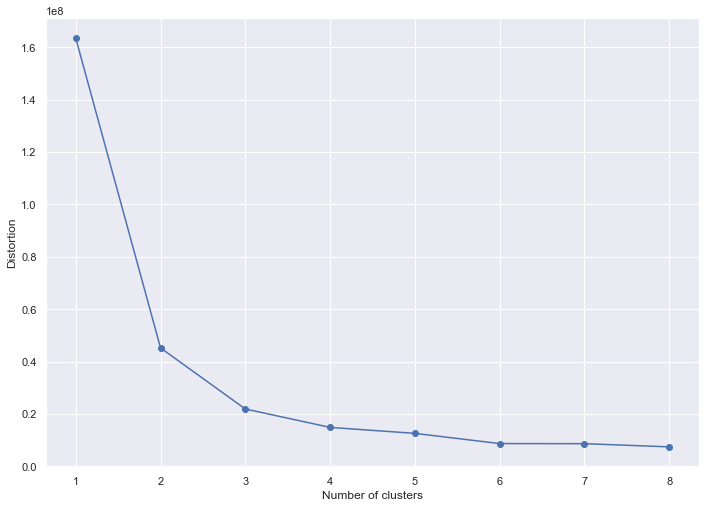

In [246]:
# ==============================
# Data cleaning
# ==============================

from tslearn.utils import to_time_series_dataset
from tslearn.clustering import TimeSeriesKMeans

df_Q11_cases_num = pd.pivot_table(df_Q11_cases,index=df_Q11_cases['state'],columns=df_Q11_cases['date'],
               values='cases_new')
#print(df)
X_train = df_Q11_cases_num.rolling(7, axis=1, min_periods=1).mean().fillna(0)
#print(X_train)
colors = ['blue', 'red', 'green']
names = ['blue cluster','red cluster','green cluster']
seed = 1

X_train = to_time_series_dataset(X_train.copy())

# ------------------------------

# ==============================
# P
# ==============================

distortions = []

# your codes here...
for i in range(1, 11):
    km=TimeSeriesKMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state=0
    )
    km.fit(X_train)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 11), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.show()

From the graph above, we can see that the 'knee' is around $k=2 \text{ or } k=3$, thus we would be using that to compute our state clusters based on states.

##### 5.1.1.2 Clustering states based on cases_new using $k=2$

COVID-19 cases vs time curves
52780303.811 --> 45216344.838 --> 45216344.838 --> 
red cluster, N = 1
Index(['Selangor'], dtype='object', name='state')
blue cluster, N = 15
Index(['Johor', 'Kedah', 'Kelantan', 'Melaka', 'Negeri Sembilan', 'Pahang',
       'Perak', 'Perlis', 'Pulau Pinang', 'Sabah', 'Sarawak', 'Terengganu',
       'W.P. Kuala Lumpur', 'W.P. Labuan', 'W.P. Putrajaya'],
      dtype='object', name='state')


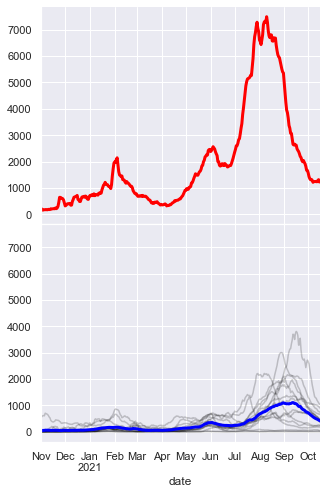

In [247]:
cluster = 2
colors = ['blue', 'red', 'green']
names = ['blue cluster','red cluster','green cluster']
seed = 1


print('COVID-19 cases vs time curves')
km = TimeSeriesKMeans(n_clusters=cluster, verbose=True, random_state=seed,
                         max_iter=10)

y_pred = km.fit_predict(X_train)
clusters = pd.Series(data=y_pred, index=df_Q11_cases_num.index)

f, (ax1, ax2) = plt.subplots(2, sharex=True, sharey=True,figsize=(5, 8))

for yi,cl,xs in zip(range(cluster),[1,0],[ax1,ax2]):
    data = df_Q11_cases_num.rolling(7, axis=1, min_periods=1).mean().fillna(0).loc[clusters[clusters == cl].index]
    data.T.plot(legend=False, alpha=.2,color='black', ax=xs)
    data.mean(axis=0).plot(linewidth=3., color=colors[cl], ax=xs)
    n = len(data)
    print('{}, N = {}'.format(names[cl], n))
    print(data.index)

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['right'].set_visible(False)
#ax3.spines['right'].set_visible(False)

f.subplots_adjust(hspace=0)
#plt.ylim(-0.02, 3.5)
plt.setp([a.get_xticklabels() for a in f.axes[:-1]], visible=False)

From the graph above, we can see that Selangor has much larger cases number compared to any other states, with 3 noticeable big spikes happening around Feb, June and Sept 2021. Other states has much smaller spikes, though states like Pulau Pinang has a much bigger spike compared to other states in the same category.

##### 5.1.1.3 Clustering states based on cases_new using $k=3$


COVID-19 cases vs time curves
31811191.523 --> 23344520.268 --> 22788435.471 --> 22788435.471 --> 
green cluster, N = 6
Index(['Johor', 'Kedah', 'Kelantan', 'Pulau Pinang', 'Sabah', 'Sarawak'], dtype='object', name='state')
red cluster, N = 1
Index(['Selangor'], dtype='object', name='state')
blue cluster, N = 9
Index(['Melaka', 'Negeri Sembilan', 'Pahang', 'Perak', 'Perlis', 'Terengganu',
       'W.P. Kuala Lumpur', 'W.P. Labuan', 'W.P. Putrajaya'],
      dtype='object', name='state')


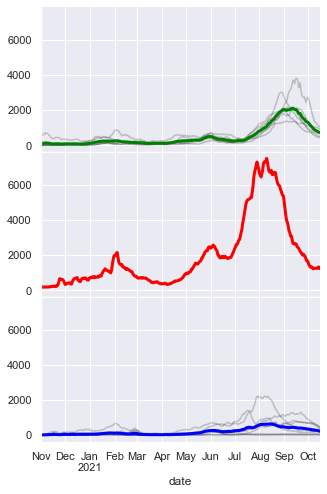

In [248]:
# https://towardsdatascience.com/which-countries-are-affected-the-most-by-covid-19-4d4570852e31
# https://github.com/rbiele02/07_clustering_covid_time_series/blob/master/covid_clustering.ipynb

from tslearn.utils import to_time_series_dataset
from tslearn.clustering import TimeSeriesKMeans

colors = ['blue', 'red', 'green']
names = ['blue cluster','red cluster','green cluster']
cluster = 3
seed = 1




print('COVID-19 cases vs time curves')
km = TimeSeriesKMeans(n_clusters=cluster, verbose=True, random_state=seed,
                         max_iter=10)

y_pred = km.fit_predict(X_train)
clusters = pd.Series(data=y_pred, index=df_Q11_cases_num.index)

f, (ax1, ax2, ax3) = plt.subplots(3, sharex=True, sharey=True,figsize=(5, 8))

for yi,cl,xs in zip(range(cluster),[2,1,0],[ax1,ax2,ax3]):
    data = df_Q11_cases_num.rolling(7, axis=1, min_periods=1).mean().fillna(0).loc[clusters[clusters == cl].index]
    data.T.plot(legend=False, alpha=.2,color='black', ax=xs)
    data.mean(axis=0).plot(linewidth=3., color=colors[cl], ax=xs)
    n = len(data)
    print('{}, N = {}'.format(names[cl], n))
    print(data.index)

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax3.spines['right'].set_visible(False)

f.subplots_adjust(hspace=0)
#plt.ylim(-0.02, 3.5)
plt.setp([a.get_xticklabels() for a in f.axes[:-1]], visible=False)

From the graph above, we can see states divided into 3 clusters. States in red cluster [Selangor] has much bigger than any other states. The spikes in Selangor is much more pronounced and taller/wider compared to other clusters.

The blue cluster (Melaka, Negeri Sembilan, Pahang, Perak, Perlis, Terengganu, W.P. Kuala Lumpur. W.P. Labuan, W.P. Putrajaya) seems not to be affected by COVID waves as much compared to other state, with curve being much flatter than other clusters

The green cluster (Johor, Kedah, Kelantan, Pulau Pinang, Sabah, Sarawak) do have much rather wide waves, with cases taking awhile subsides.

#### 5.1.2 Number of cases per 100000 people in states clusters

In [249]:
df_Q11_cases_prop = pd.pivot_table(df_Q11_cases,index=df_Q11_cases['state'],columns=df_Q11_cases['date'],
               values='cases_per_100000')
df_Q11_cases_prop

date,2020-11-01,2020-11-02,2020-11-03,2020-11-04,2020-11-05,2020-11-06,2020-11-07,2020-11-08,2020-11-09,2020-11-10,2020-11-11,2020-11-12,2020-11-13,2020-11-14,2020-11-15,2020-11-16,2020-11-17,2020-11-18,2020-11-19,2020-11-20,2020-11-21,2020-11-22,2020-11-23,2020-11-24,2020-11-25,2020-11-26,2020-11-27,2020-11-28,2020-11-29,2020-11-30,2020-12-01,2020-12-02,2020-12-03,2020-12-04,2020-12-05,2020-12-06,2020-12-07,2020-12-08,2020-12-09,2020-12-10,2020-12-11,2020-12-12,2020-12-13,2020-12-14,2020-12-15,2020-12-16,2020-12-17,2020-12-18,2020-12-19,2020-12-20,2020-12-21,2020-12-22,2020-12-23,2020-12-24,2020-12-25,2020-12-26,2020-12-27,2020-12-28,2020-12-29,2020-12-30,2020-12-31,2021-01-01,2021-01-02,2021-01-03,2021-01-04,2021-01-05,2021-01-06,2021-01-07,2021-01-08,2021-01-09,2021-01-10,2021-01-11,2021-01-12,2021-01-13,2021-01-14,2021-01-15,2021-01-16,2021-01-17,2021-01-18,2021-01-19,2021-01-20,2021-01-21,2021-01-22,2021-01-23,2021-01-24,2021-01-25,2021-01-26,2021-01-27,2021-01-28,2021-01-29,2021-01-30,2021-01-31,2021-02-01,2021-02-02,2021-02-03,2021-02-04,2021-02-05,2021-02-06,2021-02-07,2021-02-08,2021-02-09,2021-02-10,2021-02-11,2021-02-12,2021-02-13,2021-02-14,2021-02-15,2021-02-16,2021-02-17,2021-02-18,2021-02-19,2021-02-20,2021-02-21,2021-02-22,2021-02-23,2021-02-24,2021-02-25,2021-02-26,2021-02-27,2021-02-28,2021-03-01,2021-03-02,2021-03-03,2021-03-04,2021-03-05,2021-03-06,2021-03-07,2021-03-08,2021-03-09,2021-03-10,2021-03-11,2021-03-12,2021-03-13,2021-03-14,2021-03-15,2021-03-16,2021-03-17,2021-03-18,2021-03-19,2021-03-20,2021-03-21,2021-03-22,2021-03-23,2021-03-24,2021-03-25,2021-03-26,2021-03-27,2021-03-28,2021-03-29,2021-03-30,2021-03-31,2021-04-01,2021-04-02,2021-04-03,2021-04-04,2021-04-05,2021-04-06,2021-04-07,2021-04-08,2021-04-09,2021-04-10,2021-04-11,2021-04-12,2021-04-13,2021-04-14,2021-04-15,2021-04-16,2021-04-17,2021-04-18,2021-04-19,2021-04-20,2021-04-21,2021-04-22,2021-04-23,2021-04-24,2021-04-25,2021-04-26,2021-04-27,2021-04-28,2021-04-29,2021-04-30,2021-05-01,2021-05-02,2021-05-03,2021-05-04,2021-05-05,2021-05-06,2021-05-07,2021-05-08,2021-05-09,2021-05-10,2021-05-11,2021-05-12,2021-05-13,2021-05-14,2021-05-15,2021-05-16,2021-05-17,2021-05-18,2021-05-19,2021-05-20,2021-05-21,2021-05-22,2021-05-23,2021-05-24,2021-05-25,2021-05-26,2021-05-27,2021-05-28,2021-05-29,2021-05-30,2021-05-31,2021-06-01,2021-06-02,2021-06-03,2021-06-04,2021-06-05,2021-06-06,2021-06-07,2021-06-08,2021-06-09,2021-06-10,2021-06-11,2021-06-12,2021-06-13,2021-06-14,2021-06-15,2021-06-16,2021-06-17,2021-06-18,2021-06-19,2021-06-20,2021-06-21,2021-06-22,2021-06-23,2021-06-24,2021-06-25,2021-06-26,2021-06-27,2021-06-28,2021-06-29,2021-06-30,2021-07-01,2021-07-02,2021-07-03,2021-07-04,2021-07-05,2021-07-06,2021-07-07,2021-07-08,2021-07-09,2021-07-10,2021-07-11,2021-07-12,2021-07-13,2021-07-14,2021-07-15,2021-07-16,2021-07-17,2021-07-18,2021-07-19,2021-07-20,2021-07-21,2021-07-22,2021-07-23,2021-07-24,2021-07-25,2021-07-26,2021-07-27,2021-07-28,2021-07-29,2021-07-30,2021-07-31,2021-08-01,2021-08-02,2021-08-03,2021-08-04,2021-08-05,2021-08-06,2021-08-07,2021-08-08,2021-08-09,2021-08-10,2021-08-11,2021-08-12,2021-08-13,2021-08-14,2021-08-15,2021-08-16,2021-08-17,2021-08-18,2021-08-19,2021-08-20,2021-08-21,2021-08-22,2021-08-23,2021-08-24,2021-08-25,2021-08-26,2021-08-27,2021-08-28,2021-08-29,2021-08-30,2021-08-31,2021-09-01,2021-09-02,2021-09-03,2021-09-04,2021-09-05,2021-09-06,2021-09-07,2021-09-08,2021-09-09,2021-09-10,2021-09-11,2021-09-12,2021-09-13,2021-09-14,2021-09-15,2021-09-16,2021-09-17,2021-09-18,2021-09-19,2021-09-20,2021-09-21,2021-09-22,2021-09-23,2021-09-24,2021-09-25,2021-09-26,2021-09-27,2021-09-28,2021-09-29,2021-09-30,2021-10-01,2021-10-02,2021-10-03,2021-10-04,2021-10-05,2021-10-06,2021-10-07,2021-10-08,2021-10-09,2021-10-10,2021-10-11,2021-10-12,2021-10-13,2021-10-14,2021-10-15,2021-10-16
state,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

##### 5.1.2.1 Find k-value for cases_new clustering

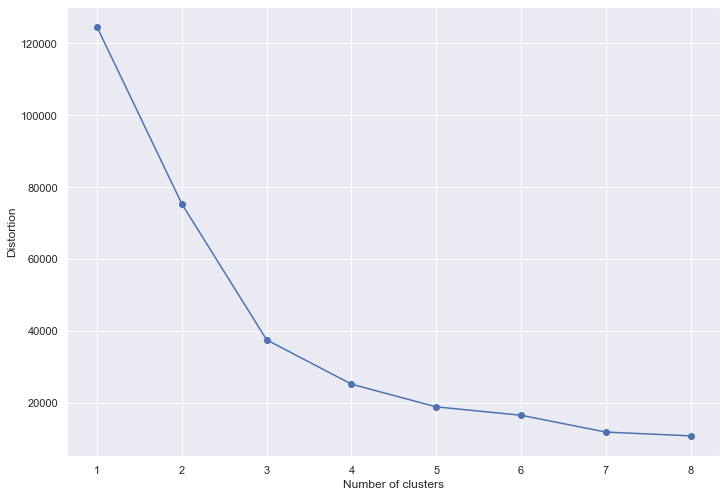

In [250]:
X_train = df_Q11_cases_prop.rolling(7, axis=1, min_periods=1).mean().fillna(0)
#print(X_train)
colors = ['blue', 'red', 'green']
names = ['blue cluster','red cluster','green cluster']
seed = 1

X_train = to_time_series_dataset(X_train.copy())

# ------------------------------

# ==============================
# P
# ==============================

distortions = []

# your codes here...
for i in range(1, 11):
    km=TimeSeriesKMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state=0
    )
    km.fit(X_train)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 11), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.show()

Looking at the graph, we can see the value of k we can pick is $k=4$

##### 5.1.2.2 Clustering states based on cases_per_100000 using $k=4$

COVID-19 cases vs time curves
38020.145 --> 25176.007 --> 25176.007 --> 
yellow cluster, N = 1
Index(['W.P. Labuan'], dtype='object', name='state')
green cluster, N = 4
Index(['Kedah', 'Kelantan', 'Pulau Pinang', 'Sarawak'], dtype='object', name='state')
red cluster, N = 3
Index(['Negeri Sembilan', 'Selangor', 'W.P. Kuala Lumpur'], dtype='object', name='state')
blue cluster, N = 8
Index(['Johor', 'Melaka', 'Pahang', 'Perak', 'Perlis', 'Sabah', 'Terengganu',
       'W.P. Putrajaya'],
      dtype='object', name='state')


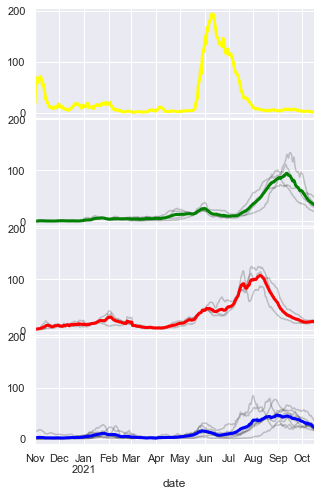

In [251]:
cluster = 4
colors = ['blue', 'red', 'green', 'yellow']
names = ['blue cluster','red cluster','green cluster', 'yellow cluster']
seed = 1

#X_train = to_time_series_dataset(X_train.copy())

print('COVID-19 cases vs time curves')
km = TimeSeriesKMeans(n_clusters=cluster, verbose=True, random_state=seed,
                         max_iter=10)

y_pred = km.fit_predict(X_train)
clusters = pd.Series(data=y_pred, index=df_Q11_cases_prop.index)

f, (ax1, ax2, ax3, ax4) = plt.subplots(cluster, sharex=True, sharey=True,figsize=(5, 8))

for yi,cl,xs in zip(range(cluster),[3,2,1,0],[ax1,ax2,ax3,ax4]):
    data = df_Q11_cases_prop.rolling(7, axis=1, min_periods=1).mean().fillna(0).loc[clusters[clusters == cl].index]
    data.T.plot(legend=False, alpha=.2,color='black', ax=xs)
    data.mean(axis=0).plot(linewidth=3., color=colors[cl], ax=xs)
    n = len(data)
    print('{}, N = {}'.format(names[cl], n))
    print(data.index)

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax4.spines['right'].set_visible(False)

f.subplots_adjust(hspace=0)
#plt.ylim(-0.02, 3.5)
plt.setp([a.get_xticklabels() for a in f.axes[:-1]], visible=False)

For yellow groups, we can observe that in yellow cluster (W.P. Labuan), the cases suddenly spikes up around Jun 2021 before going down really fast.

For green groups, we can observe that in green cluster (Kedah, Kelantan, Pulau Pinang, Sarawak) seems to handling cases rather well for most of the states

For red groups, we can observe that (Negeri Sembilan, Selangor, W.P. Kuala Lumpur) seems to be affected by COVID cases throughout the year, with cases taking much longer to subside, but still not fully controlled.

For blue group, we can observe that (Johor, Melaka, Pahang, Perak, Perlis, Sabah, Terengganu) seems to be a lot less affected by the COVID cases throughout the year, with most spikes doesn't go as high, but still takes longer for the spike to subside.

### 5.2 Clustering states based on deaths

Now, we would cluster states based on the death in each states, then we would observe the patterns between those groups.

In [252]:
df_Q11_deaths = deaths_state.copy()
#df_Q11_deaths = df_Q11_deaths[['date', 'state', 'deaths_new']]
df_Q11_deaths = df_Q11_deaths[(df_Q11_deaths['date'] > '2020-10-31')] # We want to see roughly a year worth of data

pop_select = ['state', 'pop']
deaths_select = ['date', 'state', 'deaths_new']

df_Q11_deaths = pd.merge(left=df_Q11_deaths[deaths_select], right=population[pop_select], on='state')

df_Q11_deaths['deaths_per_1000000'] = (df_Q11_deaths['deaths_new'] / df_Q11_deaths['pop'] * 1000000).round(1)
df_Q11_deaths
#df['cases_fvax_per_100000'] = (df['cases_new'] / df['pop'])

,date,state,deaths_new,pop,deaths_per_1000000
0,2020-11-01,Johor,0,3781000,0.0
1,2020-11-02,Johor,0,3781000,0.0
2,2020-11-03,Johor,0,3781000,0.0
3,2020-11-04,Johor,0,3781000,0.0
4,2020-11-05,Johor,0,3781000,0.0
...,...,...,...,...,...
5595,2021-10-12,W.P. Putrajaya,0,110000,0.0
5596,2021-10-13,W.P. Putrajaya,0,110000,0.0
5597,2021-10-14,W.P. Putrajaya,1,110000,9.1
5598,2021-10-15,W.P. Putrajaya,0,110000,0.0


#### 5.2.1 Clustering states based on their deaths_new

##### 5.2.1.1 Finding k-value for deaths_new

First, we would find the k value to clusters those states together

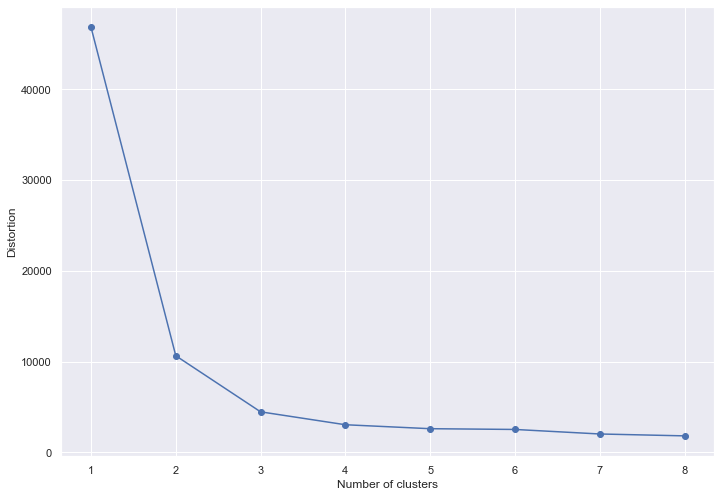

In [253]:
# ==============================
# Data cleaning
# ==============================

from tslearn.utils import to_time_series_dataset
from tslearn.clustering import TimeSeriesKMeans

df_Q11_deaths_num = pd.pivot_table(df_Q11_deaths,index=df_Q11_deaths['state'],columns=df_Q11_deaths['date'],
               values='deaths_new')
#print(df)
X_train = df_Q11_deaths_num.rolling(7, axis=1, min_periods=1).mean().fillna(0)
#print(X_train)
colors = ['blue', 'red', 'green']
names = ['blue cluster','red cluster','green cluster']
seed = 1

X_train = to_time_series_dataset(X_train.copy())

# ------------------------------

# ==============================
# P
# ==============================

distortions = []

# your codes here...
for i in range(1, 11):
    km=TimeSeriesKMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state=0
    )
    km.fit(X_train)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 11), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.show()

We can see the good k value for this cluster is $k=3$.

##### 5.2.1.2 Clustering states based on deaths_new using $k=3$

COVID-19 cases vs time curves
6582.256 --> 5002.557 --> 4463.851 --> 4463.851 --> 
green cluster, N = 5
Index(['Johor', 'Kedah', 'Pulau Pinang', 'Sabah', 'W.P. Kuala Lumpur'], dtype='object', name='state')
red cluster, N = 1
Index(['Selangor'], dtype='object', name='state')
blue cluster, N = 10
Index(['Kelantan', 'Melaka', 'Negeri Sembilan', 'Pahang', 'Perak', 'Perlis',
       'Sarawak', 'Terengganu', 'W.P. Labuan', 'W.P. Putrajaya'],
      dtype='object', name='state')


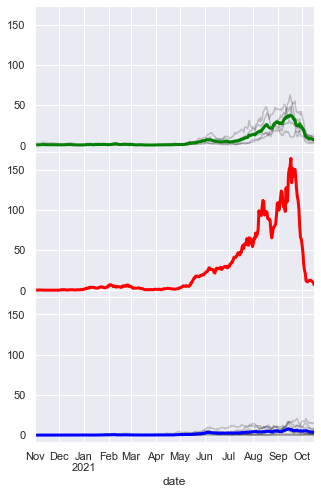

In [254]:
cluster = 3
colors = ['blue', 'red', 'green']
names = ['blue cluster','red cluster','green cluster']
seed = 1
df = df_Q11_deaths_num

print('COVID-19 cases vs time curves')
km = TimeSeriesKMeans(n_clusters=cluster, verbose=True, random_state=seed,
                         max_iter=10)

y_pred = km.fit_predict(X_train)
clusters = pd.Series(data=y_pred, index=df.index)

f, (ax1, ax2, ax3) = plt.subplots(3, sharex=True, sharey=True,figsize=(5, 8))

for yi,cl,xs in zip(range(cluster),[2,1,0],[ax1,ax2,ax3]):
    data = df.rolling(7, axis=1, min_periods=1).mean().fillna(0).loc[clusters[clusters == cl].index]
    data.T.plot(legend=False, alpha=.2,color='black', ax=xs)
    data.mean(axis=0).plot(linewidth=3., color=colors[cl], ax=xs)
    n = len(data)
    print('{}, N = {}'.format(names[cl], n))
    print(data.index)

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax3.spines['right'].set_visible(False)

f.subplots_adjust(hspace=0)
#plt.ylim(-0.02, 3.5)
plt.setp([a.get_xticklabels() for a in f.axes[:-1]], visible=False)

For green clusters (Johor, Kedah, Pulau Pinang, Sabah, W.P. Kuala Lumpur) we can observe that deaths.

For red clusters (Selangor), we can observe that Selangor is considerably affected by COVID-19 deaths, especially noticeable during the July-Oct wave. However, the numbers of death do fall down a lot by October.

For blue clusters (Kelantan, Melaka, Negeri Sembilan, Pahang, Perak, Perlis, Sarawak, Terengganu, W.P. Labuan, W.P Putrajaya), we can see that they're relatively unaffected and kept the COVID-19 death under control.

#### 5.2.2 Clustering states based on deaths per 1000000 (1 mil)

##### 5.2.2.1 Finding k-value for deaths_per_1000000 clusters

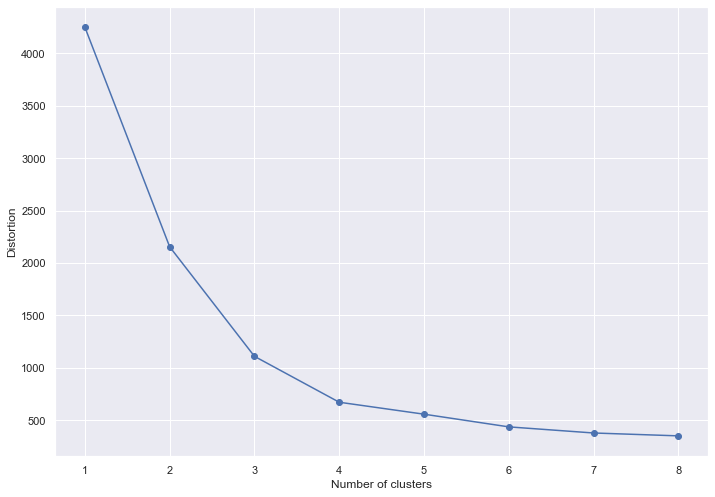

In [255]:
# ==============================
# Data cleaning
# ==============================

from tslearn.utils import to_time_series_dataset
from tslearn.clustering import TimeSeriesKMeans

df_Q11_deaths_num = pd.pivot_table(df_Q11_deaths,index=df_Q11_deaths['state'],columns=df_Q11_deaths['date'],
               values='deaths_per_1000000')
#print(df)
X_train = df_Q11_deaths_num.rolling(7, axis=1, min_periods=1).mean().fillna(0)
#print(X_train)
colors = ['blue', 'red', 'green']
names = ['blue cluster','red cluster','green cluster']
seed = 1

X_train = to_time_series_dataset(X_train.copy())

# ------------------------------

# ==============================
# P
# ==============================

distortions = []

# your codes here...\
for i in range(1, 11):
    km=TimeSeriesKMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state=0
    )
    km.fit(X_train)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 11), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.show()

We can see from the graph that the $k$ value is $k=4$

##### 5.2.2.2 Clustering states based on deaths_per_1000000 using $k=4$

COVID-19 deaths per 1000000 vs time curves
1317.774 --> 727.591 --> 671.371 --> 671.371 --> 
yellow cluster, N = 4
Index(['Johor', 'Kedah', 'Pulau Pinang', 'Selangor'], dtype='object', name='state')
green cluster, N = 3
Index(['Melaka', 'Negeri Sembilan', 'W.P. Kuala Lumpur'], dtype='object', name='state')
red cluster, N = 1
Index(['W.P. Labuan'], dtype='object', name='state')
blue cluster, N = 8
Index(['Kelantan', 'Pahang', 'Perak', 'Perlis', 'Sabah', 'Sarawak',
       'Terengganu', 'W.P. Putrajaya'],
      dtype='object', name='state')


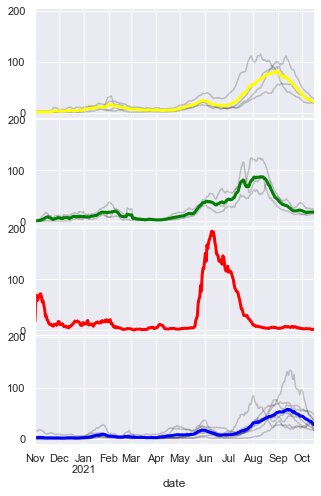

In [256]:
cluster = 4
colors = ['blue', 'red', 'green', 'yellow']
names = ['blue cluster','red cluster','green cluster', 'yellow cluster']
seed = 1

#X_train = to_time_series_dataset(X_train.copy())

print('COVID-19 deaths per 1000000 vs time curves')
km = TimeSeriesKMeans(n_clusters=cluster, verbose=True, random_state=seed,
                         max_iter=10)

y_pred = km.fit_predict(X_train)
clusters = pd.Series(data=y_pred, index=df_Q11_cases_prop.index)

f, (ax1, ax2, ax3, ax4) = plt.subplots(cluster, sharex=True, sharey=True,figsize=(5, 8))

for yi,cl,xs in zip(range(cluster),[3,2,1,0],[ax1,ax2,ax3,ax4]):
    data = df_Q11_cases_prop.rolling(7, axis=1, min_periods=1).mean().fillna(0).loc[clusters[clusters == cl].index]
    data.T.plot(legend=False, alpha=.2,color='black', ax=xs)
    data.mean(axis=0).plot(linewidth=3., color=colors[cl], ax=xs)
    n = len(data)
    print('{}, N = {}'.format(names[cl], n))
    print(data.index)

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax4.spines['right'].set_visible(False)

f.subplots_adjust(hspace=0)
#plt.ylim(-0.02, 3.5)
plt.setp([a.get_xticklabels() for a in f.axes[:-1]], visible=False)

For yellow groups, we can observe that in green clusters (Johor, Kedah, Pulau Pinang, Selangor) seem to handle deaths rather well, but there are still huge waves. 

For green groups, we can observe that (Negeri Sembilan, Melaka, W.P. Kuala Lumpur) seems to be affected by COVID deaths throughout the year, with deaths taking much longer to subside, but still not fully controlled. 

For red groups, we can observe that in the red cluster (W.P. Labuan), the cases suddenly spikes up around Jun 2021 before going down really fast. The huge influx could probably be attributed to people from neighbouring states like Selangor, and subsided really fast.

For blue group, we can observe that (Kelantan, Pahang, Perak, Perlis, Sabah, Sarawak, Terengganu, W.P. Putrajaya) seems to be a lot less affected by the COVID deaths throughout the year, with most spikes doesn't go as high, but still takes longer for the spike to subside compared to other clusters.


### 5.3 Conclusion

We can see that KMeanTimeSeries is a good clustering technique to group together states of comparable trend and behaviour. States might changes between each cluster but the trend of the clusters remains.

## 6. Question 6

##### Does the current vaccination rate allow herd immunity to be achieved by 30 November 2021? You can assume that herd immunity can be achieved with 80% of population has been vaccinated

Forecasting vaccination shots given and percentage of population that has received it. 

In [257]:
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from matplotlib.animation import FuncAnimation
from math import sqrt


### 6.1 Data visualization

In [258]:
df_Q6 = vax_malaysia.copy()
df_Q6 = df_Q6[['date', 'daily_full']]
df_Q6.set_index('date', inplace=True)

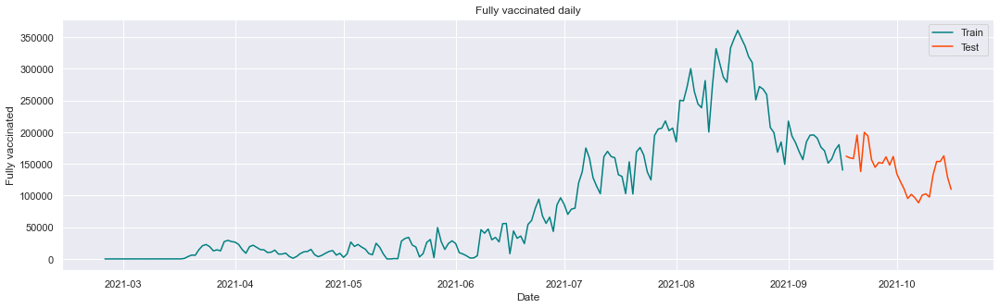

In [259]:
days = 30
train = df_Q6.iloc[:-days,0:1].copy()
test = df_Q6.iloc[-days:,0:1].copy()
plt.figure(figsize=(18,5))
plt.title('Fully vaccinated daily')
plt.plot(train['daily_full'], color='teal')
plt.plot(test['daily_full'], color='orangered')
plt.legend(['Train','Test'])
plt.xlabel('Date')
plt.ylabel('Fully vaccinated')
plt.show()

The null hypothesis of the ADF test is that the time series is non-stationary. So, if the p-value of the test is less than the significance level (0.05) then we will reject the null hypothesis and infer that the time series is indeed stationary.

In [260]:
from statsmodels.tsa.stattools import adfuller
from numpy import log
result = adfuller(df_Q6.daily_full.dropna())
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])

ADF Statistic: -1.354485
p-value: 0.603892


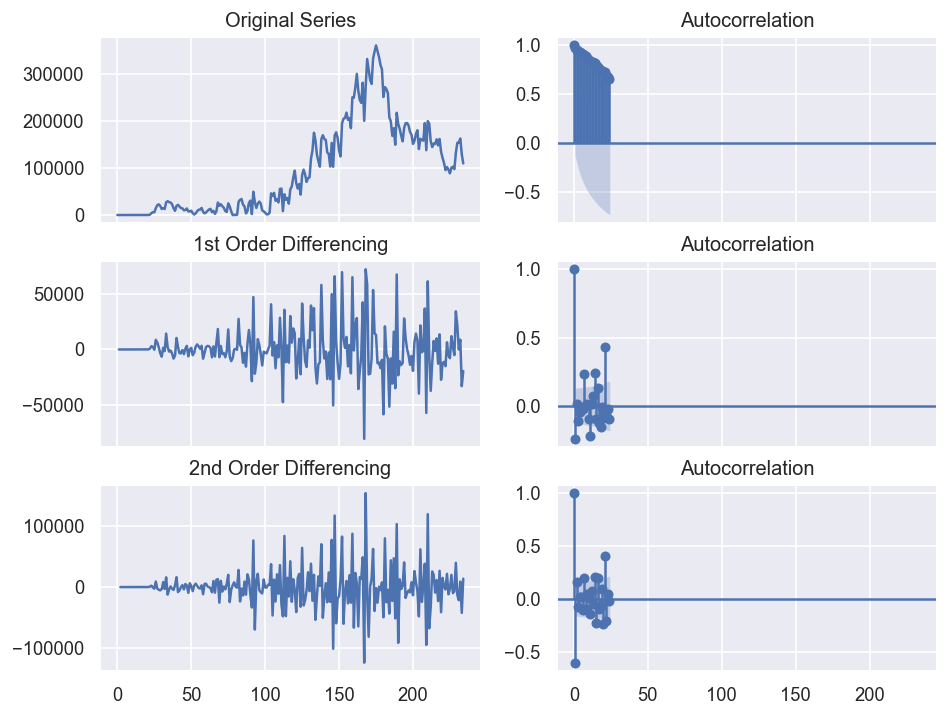

In [261]:
import numpy as np, pandas as pd
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

# Import data
#df = pd.read_csv('https://raw.githubusercontent.com/selva86/datasets/master/wwwusage.csv', names=['value'], header=0)
df_temp = vax_malaysia.copy()
df_temp = df_temp[['daily_full']]
df_temp.columns = ['value']
# Original Series
fig, axes = plt.subplots(3, 2, sharex=True)
axes[0, 0].plot(df_temp.value); axes[0, 0].set_title('Original Series')
plot_acf(df_temp.value, ax=axes[0, 1])

# 1st Differencing
axes[1, 0].plot(df_temp.value.diff()); axes[1, 0].set_title('1st Order Differencing')
plot_acf(df_temp.value.diff().dropna(), ax=axes[1, 1])

# 2nd Differencing
axes[2, 0].plot(df_temp.value.diff().diff()); axes[2, 0].set_title('2nd Order Differencing')
plot_acf(df_temp.value.diff().diff().dropna(), ax=axes[2, 1])

plt.show()

### 6.2 Building ARIMA model using Auto ARIMA (pmdarima)

In [262]:
from statsmodels.tsa.arima_model import ARIMA
#  statsmodels.tsa.arima.model.ARIMA
import pmdarima as pm

#df = pd.read_csv('https://raw.githubusercontent.com/selva86/datasets/master/wwwusage.csv', names=['value'], header=0)
# df = vax_malaysia.copy()
# df = df[['date', 'daily_full']]
# df.set_index('date', inplace=True)
# df.columns = ['value']

# Get copy of vax_malaysia
df_Q11 = vax_malaysia.copy()
df_Q11 = df_Q11[['date', 'daily_full']]
df_Q11.set_index('date', inplace=True)
df_Q11

# =========================

# Define test ============
days = 30
train = df_Q11.iloc[:-days,0:1].copy()
test = df_Q11.iloc[-days:,0:1].copy()

train_test = train.copy()
train_test.columns = ['value']

# ==========================
#df

model = pm.auto_arima(train_test.value, start_p=0, start_q=0,
                      test='adf',       # use adftest to find optimal 'd'
                      max_p=3, max_q=3, # maximum p and q
                      m=1,              # frequency of series
                      d=None,           # let model determine 'd'
                      seasonal=False,   # No Seasonality
                      start_P=0, 
                      D=0, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                      stepwise=True,
                        random_state = 1)

print(model.summary())

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4652.263, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4643.874, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4642.281, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4650.475, Time=0.03 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4642.218, Time=0.23 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4644.433, Time=0.39 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4644.618, Time=0.32 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4643.046, Time=0.16 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4645.401, Time=0.12 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=4645.062, Time=0.54 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4640.313, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4640.712, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4642.239, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4642.150, Time=0.39 sec
 ARIMA(1,1,2)(0,0,0)[0]          

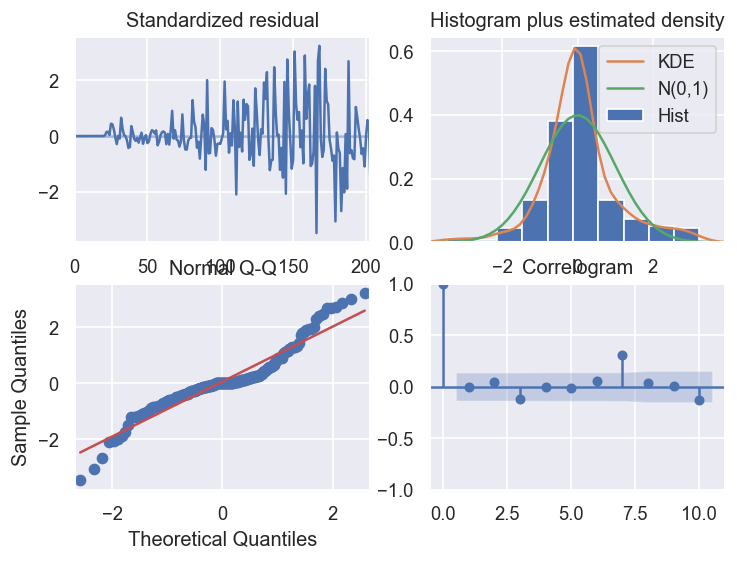

In [263]:
model.plot_diagnostics(figsize=(7,5))
plt.show()

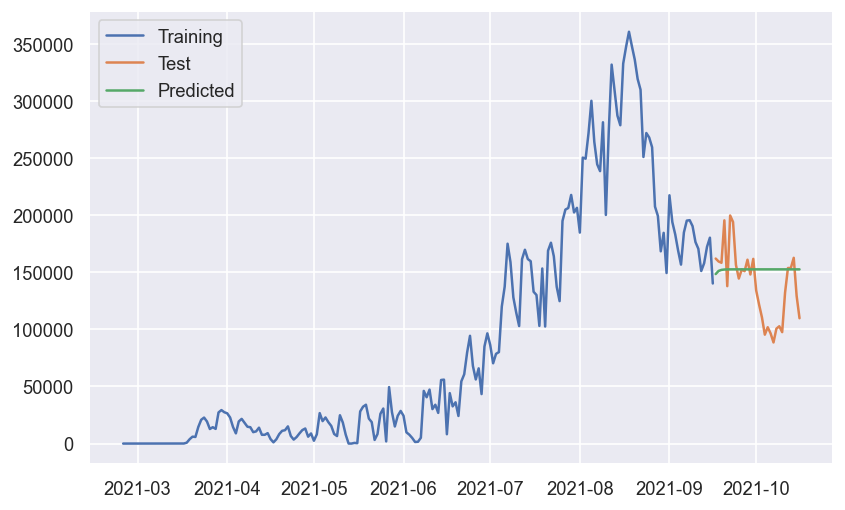

In [264]:
prediction = pd.DataFrame(model.predict(n_periods = 30),index=test.index)
prediction.columns = ['pred_fvax']
plt.figure(figsize=(8,5))
plt.plot(train,label="Training")
plt.plot(test,label="Test")
plt.plot(prediction,label="Predicted")
plt.legend(loc = 'upper left')
#plt.savefig('SecondPrection.jpg')
plt.show()

We can see that prediction draws roughly a straight line on the numbers of vaccination given for that day.

### 6.3 Forecasting using ARIMA

#### 6.3.1 Forecasting daily full vaccinated people

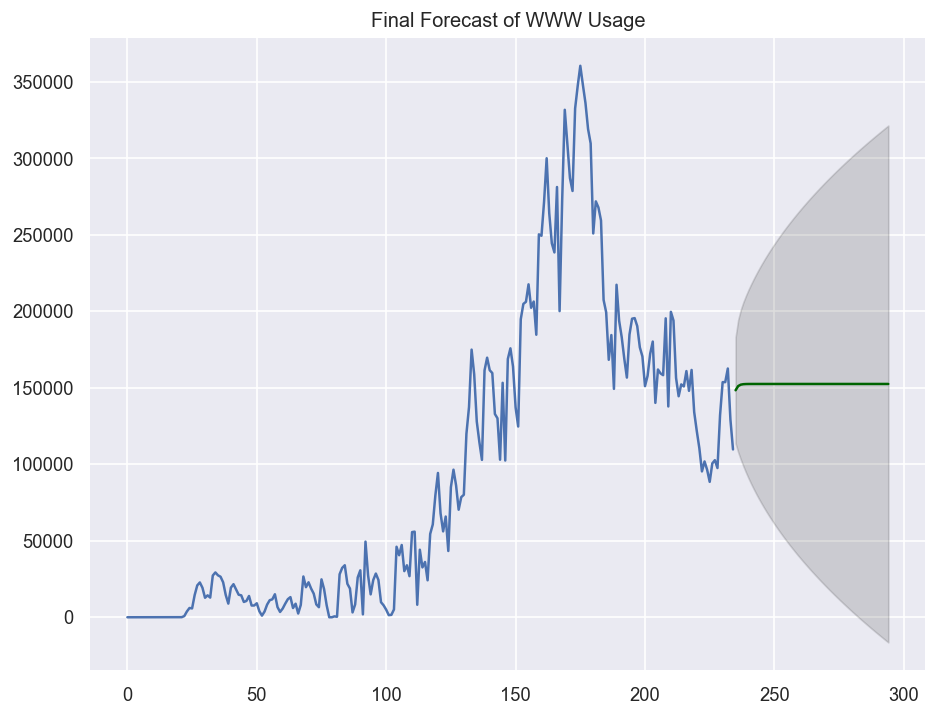

In [265]:
# Forecast
n_periods = 60
fc, confint = model.predict(n_periods=n_periods, return_conf_int=True, alpha=0.10)
index_of_fc = np.arange(len(df_Q11.values), len(df_Q11.values)+n_periods)

# make series for plotting purpose
fc_series = pd.Series(fc, index=index_of_fc)
lower_series = pd.Series(confint[:, 0], index=index_of_fc)
upper_series = pd.Series(confint[:, 1], index=index_of_fc)

# Plot
plt.plot(df_Q11.values)
plt.plot(fc_series, color='darkgreen')
plt.fill_between(lower_series.index, 
                 lower_series, 
                 upper_series, 
                 color='k', alpha=.15)

plt.title("Final Forecast of WWW Usage")
plt.show()

Using the model to forecast, we see that numbers of daily vaccinated people remain constant, although with rather wide upper and lower bounds,  

#### 6.3.2 Forecasting population vaccinated

In [266]:
#confint

df_forecast = (pd.DataFrame(data=fc))
df_forecast.index = df_forecast.index + len(df_Q11)
df_forecast.columns=['predict']

df_initial = (pd.DataFrame(data=df_Q11.values))
df_confint = pd.DataFrame(data=confint, columns = ['lower', 'upper'])

# https://stackoverflow.com/questions/20167930/start-index-at-1-for-pandas-dataframe/20168416
df_confint.index = df_confint.index + len(df_Q11)
df_initial.columns=['fvax']

df_temp = pd.merge(left=df_initial, right=df_confint, how='outer', left_on=None, right_on=None, left_index=True, right_index=True)
df_temp = pd.merge(left=df_temp, right= df_forecast, how='outer', left_index=True, right_index=True)

#df_temp

dates = pd.date_range(start='2021-02-24', periods=len(df_temp))
df_dates = pd.DataFrame(data=dates)
df_dates.columns=['date']
df_temp = pd.merge(left=df_temp, right=df_dates, how='left', left_index=True, right_index=True)

#df_temp[df_temp < 0] = 0
df_temp['lower'][df_temp['lower'] < 0] = 0
#df_temp.tail(20)

malaysia_pop = population.iloc[0]['pop']
# df = df.assign(Percentage = lambda x: (x['Total_Marks'] /500 * 100))
start_cumul_fvax = df_temp['fvax'].sum()

df_temp['fvax_cumul'] = df_temp['fvax'].cumsum()


df_temp.at[234, 'lower'] = np.int64(start_cumul_fvax) 
df_temp.at[234, 'upper'] = np.int64(start_cumul_fvax)
df_temp.at[234, 'predict'] = np.int64(start_cumul_fvax)
#df_temp['lower'].astype(np.int64)
# df_temp = df_temp.assign(Percentage = lambda x: x['lower'] )
# df.loc[df.index[someRowNumber], 'New Column Title'] = "some value"
df_temp['lower_cumul'] = df_temp['lower'].cumsum()
df_temp['upper_cumul'] = df_temp['upper'].cumsum()
df_temp['predict_cumul'] = df_temp['predict'].cumsum()

df_temp['perc_fvax'] = (df_temp['fvax_cumul'] / malaysia_pop * 100).round(1)

df_temp['lower_cumul_pop'] = (df_temp['lower_cumul'] / malaysia_pop * 100).round(1)
df_temp['upper_cumul_pop'] = (df_temp['upper_cumul'] / malaysia_pop * 100).round(1)
df_temp['predict_cumul_pop'] = (df_temp['predict_cumul'] / malaysia_pop * 100).round(1)

df_temp.set_index('date', inplace=True)
df_temp.tail(65)

<ipython-input-266-8a8391d766ca>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['lower'][df_temp['lower'] < 0] = 0


,fvax,lower,upper,predict,fvax_cumul,lower_cumul,upper_cumul,predict_cumul,perc_fvax,lower_cumul_pop,upper_cumul_pop,predict_cumul_pop
date,,,,,,,,,,,,
2021-10-12,153736.0,NaN,NaN,NaN,21591116.0,NaN,NaN,NaN,66.1,NaN,NaN,NaN
2021-10-13,153750.0,NaN,NaN,NaN,21744866.0,NaN,NaN,NaN,66.6,NaN,NaN,NaN
2021-10-14,162656.0,NaN,NaN,NaN,21907522.0,NaN,NaN,NaN,67.1,NaN,NaN,NaN
2021-10-15,129359.0,NaN,NaN,NaN,22036881.0,NaN,NaN,NaN,67.5,NaN,NaN,NaN
2021-10-16,109745.0,22146626.0,2.214663e+07,2.214663e+07,22146626.0,2.214663e+07,2.214663e+07,2.214663e+07,67.8,67.8,67.8,67.8
...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-11,NaN,0.0,3.159878e+05,1.525537e+05,NaN,2.436960e+07,3.704424e+07,3.068347e+07,NaN,74.6,113.4,94.0
2021-12-12,NaN,0.0,3.173838e+05,1.525537e+05,NaN,2.436960e+07,3.736163e+07,3.083602e+07,NaN,74.6,114.4,94.4
2021-12-13,NaN,0.0,3.187681e+05,1.525537e+05,NaN,2.436960e+07,3.768039e+07,3.098858e+07,NaN,74.6,115.4,94.9


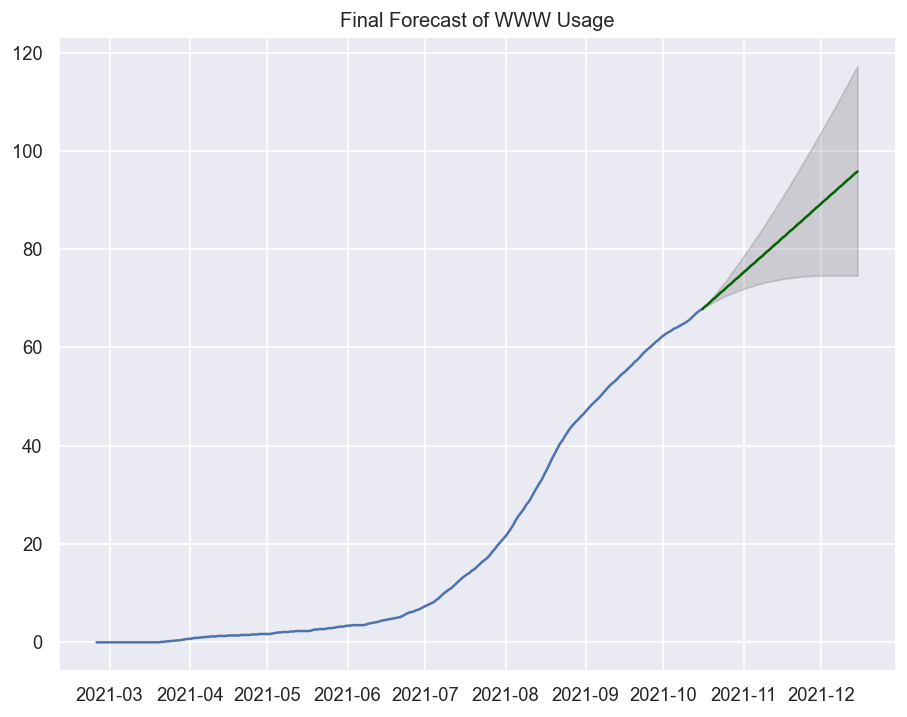

In [267]:
# Forecast
#n_periods = 60
#fc, confint = model.predict(n_periods=n_periods, return_conf_int=True, alpha=0.10)
#index_of_fc = np.arange(len(df.values), len(df.values)+n_periods)
index_of_fc = np.arange(len(df_temp))


# make series for plotting purpose
#fc_series = pd.Series(fc, index=index_of_fc)
#lower_series = pd.Series(confint[:, 0], index=index_of_fc)
#upper_series = pd.Series(confint[:, 1], index=index_of_fc)

# my_series = df['Price'].squeeze()
rl_series = df_temp['perc_fvax'].squeeze()
fc_series = df_temp['predict_cumul_pop'].squeeze()
lower_series = df_temp['lower_cumul_pop'].squeeze()
upper_series = df_temp['upper_cumul_pop'].squeeze()


# Plot
#plt.plot(df.values)
plt.plot(rl_series)
plt.plot(fc_series, color='darkgreen')
plt.fill_between(lower_series.index, 
                 lower_series, 
                 upper_series, 
                 color='k', alpha=.15)

plt.title("Final Forecast of WWW Usage")
plt.show()


We can observe that from this graph, we would achieve 80% vaccination by 2021-11-30. However, the lower and upper bound has a really big variation, such that by mid-Nov, lower bound stopped decreasing.

In [268]:
#df_temp[df_temp['date'] == '2021-11-30']
df_view = df_temp.reset_index()
df_view[df_view['date'] == '2021-11-30']

,date,fvax,lower,upper,predict,fvax_cumul,lower_cumul,upper_cumul,predict_cumul,perc_fvax,lower_cumul_pop,upper_cumul_pop,predict_cumul_pop
279,2021-11-30,NaN,5346.681698,299760.730655,152553.706176,NaN,2.436278e+07,3.364797e+07,2.900538e+07,NaN,74.6,103.0,88.8


At 90% confidence interval, by 30th November 2021, about $88.8\%$ of population would be completely vaccinated with lower bound of $74.8\%$ and upper bound of $103.0\%$. We could assume it's likely that at 80% of the population would've been vaccinated by November 30

## Question 7: Can we identify any given day as a public holiday / not a public holiday based on the data?

This question aims to use classification as a method to determine if, given some data for each day (except possibly the date itself) can we then determine if that day was a public holiday or not? This is based on the assumption that the movement and activity of the general population is different on or near public holidays, and that this effect is present in the features of some of the datasets.

The data for Malaysian public holidays in 2020 and 2021 were taken from the official government sources:
http://www.kabinet.gov.my/bkpp/pdf/hari_kelepasan_am/hka_2020.pdf
http://www.kabinet.gov.my/bkpp/pdf/hari_kelepasan_am/hka_2021.pdf

These include national holidays as well as state holidays that apply to at least one of the top five states (by total cases): *Selangor*, *Sarawak*, *Johor*, *Sabah*, *W.P. Kuala Lumpur*

#### 7.1 Loading and preprocessing data

In [269]:
# national and chosen state holidays
national_holidays_2020 = ['2020-01-25', '2020-01-26', '2020-05-01', '2020-05-07', '2020-05-24', 
 '2020-05-25', '2020-06-08', '2020-07-31', '2020-08-20', '2020-08-31',
 '2020-09-16', '2020-10-29', '2020-11-14', '2020-12-25']
chosen_state_holidays_2020 = ['2020-01-01', '2020-02-01', '2020-02-08', '2020-03-23', '2020-04-10', 
 '2020-04-24', '2020-05-10', '2020-05-30', '2020-05-31', '2020-06-01', 
 '2020-06-02', '2020-07-22', '2020-09-24', '2020-10-03', '2020-10-10', 
 '2020-12-11', '2020-12-24']
national_holidays_2021 = ['2021-02-12', '2021-02-13', '2021-05-01', '2021-05-13', '2021-05-14', 
 '2021-05-26', '2021-06-07', '2021-07-20', '2021-08-10', '2021-08-31', 
 '2021-09-16', '2021-10-19', '2021-11-04', '2021-12-25']
chosen_state_holidays_2021 = ['2021-01-01', '2021-01-28', '2021-02-01', '2021-03-23', '2021-04-02',
 '2021-04-13', '2021-04-29', '2021-05-30', '2021-05-31', '2021-06-01',
 '2021-06-02', '2021-07-22', '2021-09-13', '2021-10-02', '2021-10-09',
 '2021-12-11', '2021-12-24']

# 2020 and 2021 public holiday dates 
public_holidays = national_holidays_2020 + chosen_state_holidays_2020 + national_holidays_2021 + chosen_state_holidays_2021
public_holidays.sort()
public_holidays = [pd.Timestamp(date) for date in public_holidays]
public_holidays

[Timestamp('2020-01-01 00:00:00'),
 Timestamp('2020-01-25 00:00:00'),
 Timestamp('2020-01-26 00:00:00'),
 Timestamp('2020-02-01 00:00:00'),
 Timestamp('2020-02-08 00:00:00'),
 Timestamp('2020-03-23 00:00:00'),
 Timestamp('2020-04-10 00:00:00'),
 Timestamp('2020-04-24 00:00:00'),
 Timestamp('2020-05-01 00:00:00'),
 Timestamp('2020-05-07 00:00:00'),
 Timestamp('2020-05-10 00:00:00'),
 Timestamp('2020-05-24 00:00:00'),
 Timestamp('2020-05-25 00:00:00'),
 Timestamp('2020-05-30 00:00:00'),
 Timestamp('2020-05-31 00:00:00'),
 Timestamp('2020-06-01 00:00:00'),
 Timestamp('2020-06-02 00:00:00'),
 Timestamp('2020-06-08 00:00:00'),
 Timestamp('2020-07-22 00:00:00'),
 Timestamp('2020-07-31 00:00:00'),
 Timestamp('2020-08-20 00:00:00'),
 Timestamp('2020-08-31 00:00:00'),
 Timestamp('2020-09-16 00:00:00'),
 Timestamp('2020-09-24 00:00:00'),
 Timestamp('2020-10-03 00:00:00'),
 Timestamp('2020-10-10 00:00:00'),
 Timestamp('2020-10-29 00:00:00'),
 Timestamp('2020-11-14 00:00:00'),
 Timestamp('2020-12-

In [270]:
# loading chosen datasets
cases_malaysia = pd.read_csv('covid19-public/epidemic/cases_malaysia.csv')
deaths_malaysia = pd.read_csv('covid19-public/epidemic/deaths_malaysia.csv')
hospital = pd.read_csv('covid19-public/epidemic/hospital.csv')
icu = pd.read_csv('covid19-public/epidemic/icu.csv')
pkrc = pd.read_csv('covid19-public/epidemic/pkrc.csv')
tests_malaysia = pd.read_csv('covid19-public/epidemic/tests_malaysia.csv')
checkin_malaysia = pd.read_csv('covid19-public/mysejahtera/checkin_malaysia.csv')

In [271]:
# basic preperations
cases_malaysia = cases_malaysia.iloc[:,:-7]
cases_malaysia['date'] = pd.to_datetime(cases_malaysia['date'], errors='raise')
deaths_malaysia['date'] = pd.to_datetime(deaths_malaysia['date'], errors='raise')
hospital['date'] = pd.to_datetime(hospital['date'], errors='raise')
icu['date'] = pd.to_datetime(icu['date'], errors='raise')
pkrc['date'] = pd.to_datetime(pkrc['date'], errors='raise')
tests_malaysia['date'] = pd.to_datetime(tests_malaysia['date'], errors='raise')
checkin_malaysia['date'] = pd.to_datetime(checkin_malaysia['date'], errors='raise')

In [272]:
# adding features
cases_malaysia = cases_engineer(cases_malaysia)
tests_malaysia = tests_engineer(tests_malaysia)

In [273]:
# Choosing datasets to merge...
cases_malaysia # starts from '2020-01-25'
deaths_malaysia # starts from '2020-03-17'
tests_malaysia # starts from '2020-01-24'
pkrc_malaysia = pkrc.groupby(by='date').sum().reset_index()
pkrc_malaysia # starts from '2020-03-28'
icu_malaysia = icu.groupby(by='date').sum().reset_index()
icu_malaysia # starts from '2020-03-24'
hospital = hospital.groupby(by='date').sum().reset_index()
hospital # starts from '2020-03-24'
checkin_malaysia # starts from '2020-12-01'

dfs_to_merge = [cases_malaysia, deaths_malaysia, tests_malaysia, pkrc_malaysia, icu_malaysia,
                hospital, checkin_malaysia]

In [274]:
# merging chosen datasets
from functools import reduce

df_merged = reduce(lambda df_left, df_right: pd.merge(df_left, df_right, on='date', how='inner'), dfs_to_merge)
df_merged

,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case,deaths_new,deaths_bid,deaths_new_dod,deaths_bid_dod,deaths_pvax,deaths_fvax,deaths_tat,rtk-ag,pcr,7DayAverageNewTests_rtk-ag,14DayAverageNewTests_rtk-ag,7DayAverageNewTests_pcr,14DayAverageNewTests_pcr,1-day lag rtk-ag,1-day lag pcr,2-day lag rtk-ag,2-day lag pcr,3-day lag rtk-ag,3-day lag pcr,4-day lag rtk-ag,4-day lag pcr,5-day lag rtk-ag,5-day lag pcr,6-day lag rtk-ag,6-day lag pcr,7-day lag rtk-ag,7-day lag pcr,beds_x,admitted_pui_x,admitted_covid_x,admitted_total_x,discharge_pui,discharge_covid,discharge_total,pkrc_covid,pkrc_pui,pkrc_noncovid,beds_icu,beds_icu_rep,beds_icu_total,beds_icu_covid,vent,vent_port,icu_covid,icu_pui,icu_noncovid,vent_covid,vent_pui,vent_noncovid,vent_used,vent_port_used,beds_y,beds_covid,beds_noncrit,admitted_pui_y,admitted_covid_y,admitted_total_y,discharged_pui,discharged_covid,discharged_total,hosp_covid,hosp_pui,hosp_noncovid,checkins,unique_ind,unique_loc
0,2020-12-01,1472,5,1552,10476,1153,0,0,51,34,1098,37,1188.857143,1245.642857,5.571429,4.500000,1736.857143,1406.214286,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,970.0,5.0,2348.0,2188.0,0.0,1673.0,2,0,0,0,0,0,2,7347,16024,6691.714286,6289.142857,15286.857143,15938.214286,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,7447.0,17164.0,7257.0,15993.0,7187.0,15046.0,15243,12,965,977,5,1310,1315,4905,110,364,603,295,898,503,1050,505,140,5,345,50,5,0,539,0,24440,5630,23542,80,446,526,68,529,597,2746,298,12557,17492265,6614474,630363
1,2020-12-02,851,4,658,10663,444,0,0,81,43,665,55,1171.857143,1259.285714,5.428571,4.500000,1495.428571,1408.214286,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,970.0,5.0,2348.0,2,2,6,2,0,0,4,8761,15962,6906.571429,6416.857143,15282.428571,15464.214286,7347.0,16024.0,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,7447.0,17164.0,7257.0,15993.0,15329,5,1210,1215,23,485,508,5466,94,507,603,295,898,505,1050,505,138,5,340,50,5,0,539,0,24440,5717,23542,102,621,723,63,494,557,2788,323,12868,17695726,6667261,648752
2,2020-12-03,1075,3,948,10789,648,0,0,87,41,828,48,1191.857143,1243.928571,5.285714,4.357143,1265.857143,1413.214286,851.0,4.0,658.0,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,11,1,1,0,0,0,3,10533,21196,7347.428571,6715.428571,15858.428571,15754.928571,8761.0,15962.0,7347.0,16024.0,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,7447.0,17164.0,15449,20,567,587,11,718,729,5406,97,381,617,295,912,505,1068,513,136,6,354,59,6,0,551,0,24432,5845,23520,105,477,582,75,322,397,2866,331,13013,17063123,6549583,645604
3,2020-12-04,1141,3,1144,10785,666,0,0,93,59,745,65,1196.428571,1257.000000,4.285714,4.214286,1265.285714,1426.642857,1075.0,3.0,948.0,851.0,4.0,658.0,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,0,0,1,0,0,0,0,11457,19657,7911.142857,7148.428571,16586.142857,15904.642857,10533.0,21196.0,8761.0,15962.0,7347.0,16024.0,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,15547,43,950,993,27,1035,1062,5326,121,416,618,295,913,506,1068,513,144,9,331,61,9,0,581,0,24432,5845,23519,116,435,551,82,339,42

In [275]:
# select dates in the merged dataframe that are public holidays
mask = df_merged['date'].isin(public_holidays)
display(mask.value_counts())

# checking if public holidays are the same dates
df_merged.loc[mask, 'date']

# adding new column to merged df
df_merged['holiday'] = mask.astype(int)
df_merged

False    287
True      29
Name: date, dtype: int64

,date,cases_new,cases_import,cases_recovered,cases_active,cases_cluster,cases_pvax,cases_fvax,cases_child,cases_adolescent,cases_adult,cases_elderly,7DayAverageNewCases,14DayAverageNewCases,7DayAverageImportCases,14DayAverageImportCases,7DayAverageRecoveredCases,14DayAverageNewRecoveredCases,1-day lag imported case,1-day lag new case,1-day lag recovered case,2-day lag imported case,2-day lag new case,2-day lag recovered case,3-day lag imported case,3-day lag new case,3-day lag recovered case,4-day lag imported case,4-day lag new case,4-day lag recovered case,5-day lag imported case,5-day lag new case,5-day lag recovered case,6-day lag imported case,6-day lag new case,6-day lag recovered case,7-day lag imported case,7-day lag new case,7-day lag recovered case,deaths_new,deaths_bid,deaths_new_dod,deaths_bid_dod,deaths_pvax,deaths_fvax,deaths_tat,rtk-ag,pcr,7DayAverageNewTests_rtk-ag,14DayAverageNewTests_rtk-ag,7DayAverageNewTests_pcr,14DayAverageNewTests_pcr,1-day lag rtk-ag,1-day lag pcr,2-day lag rtk-ag,2-day lag pcr,3-day lag rtk-ag,3-day lag pcr,4-day lag rtk-ag,4-day lag pcr,5-day lag rtk-ag,5-day lag pcr,6-day lag rtk-ag,6-day lag pcr,7-day lag rtk-ag,7-day lag pcr,beds_x,admitted_pui_x,admitted_covid_x,admitted_total_x,discharge_pui,discharge_covid,discharge_total,pkrc_covid,pkrc_pui,pkrc_noncovid,beds_icu,beds_icu_rep,beds_icu_total,beds_icu_covid,vent,vent_port,icu_covid,icu_pui,icu_noncovid,vent_covid,vent_pui,vent_noncovid,vent_used,vent_port_used,beds_y,beds_covid,beds_noncrit,admitted_pui_y,admitted_covid_y,admitted_total_y,discharged_pui,discharged_covid,discharged_total,hosp_covid,hosp_pui,hosp_noncovid,checkins,unique_ind,unique_loc,holiday
0,2020-12-01,1472,5,1552,10476,1153,0,0,51,34,1098,37,1188.857143,1245.642857,5.571429,4.500000,1736.857143,1406.214286,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,970.0,5.0,2348.0,2188.0,0.0,1673.0,2,0,0,0,0,0,2,7347,16024,6691.714286,6289.142857,15286.857143,15938.214286,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,7447.0,17164.0,7257.0,15993.0,7187.0,15046.0,15243,12,965,977,5,1310,1315,4905,110,364,603,295,898,503,1050,505,140,5,345,50,5,0,539,0,24440,5630,23542,80,446,526,68,529,597,2746,298,12557,17492265,6614474,630363,0
1,2020-12-02,851,4,658,10663,444,0,0,81,43,665,55,1171.857143,1259.285714,5.428571,4.500000,1495.428571,1408.214286,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,970.0,5.0,2348.0,2,2,6,2,0,0,4,8761,15962,6906.571429,6416.857143,15282.428571,15464.214286,7347.0,16024.0,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,7447.0,17164.0,7257.0,15993.0,15329,5,1210,1215,23,485,508,5466,94,507,603,295,898,505,1050,505,138,5,340,50,5,0,539,0,24440,5717,23542,102,621,723,63,494,557,2788,323,12868,17695726,6667261,648752,0
2,2020-12-03,1075,3,948,10789,648,0,0,87,41,828,48,1191.857143,1243.928571,5.285714,4.357143,1265.857143,1413.214286,851.0,4.0,658.0,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,935.0,4.0,2555.0,11,1,1,0,0,0,3,10533,21196,7347.428571,6715.428571,15858.428571,15754.928571,8761.0,15962.0,7347.0,16024.0,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,7447.0,17164.0,15449,20,567,587,11,718,729,5406,97,381,617,295,912,505,1068,513,136,6,354,59,6,0,551,0,24432,5845,23520,105,477,582,75,322,397,2866,331,13013,17063123,6549583,645604,0
3,2020-12-04,1141,3,1144,10785,666,0,0,93,59,745,65,1196.428571,1257.000000,4.285714,4.214286,1265.285714,1426.642857,1075.0,3.0,948.0,851.0,4.0,658.0,1472.0,5.0,1552.0,1212.0,9.0,2112.0,1309.0,1.0,1333.0,1315.0,5.0,1110.0,1109.0,10.0,1148.0,0,0,1,0,0,0,0,11457,19657,7911.142857,7148.428571,16586.142857,15904.642857,10533.0,21196.0,8761.0,15962.0,7347.0,16024.0,7687.0,12861.0,5527.0,16422.0,4066.0,13981.0,7511.0,14563.0,15547,43,950,993,27,1035,1062,5326,121,416,618,295,913,506,1068,513,144,9,331,61,9,0,581,0,24432,5845,23519,116,435

#### 7.2 Dimentionality reduction by selecting best features

In [276]:
# Best feature selection for classification, using f_classif (ANOVA F-value) 

X = df_merged.drop(columns=['date', 'holiday'], axis=1)
y = df_merged['holiday']
    
selector = SelectKBest(f_classif, k=10) # selecting 10 best features
selector.fit(X, y)
best_features = X.columns[selector.get_support()].to_list()
best_features

['7-day lag new case',
 'rtk-ag',
 '5-day lag pcr',
 '6-day lag pcr',
 '7-day lag pcr',
 'admitted_covid_x',
 'admitted_total_x',
 'checkins',
 'unique_ind',
 'unique_loc']

#### 7.3 Additional data transformation

In [277]:
# splitting dataset into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X[best_features], y, test_size=0.3, random_state=42)

In [278]:
# scalling the input data
sc = MinMaxScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.fit_transform(X_test)

#### 7.4 Oversampling with SMOTE

In [279]:
# Note imbalanced train set
y_train.value_counts()

0    199
1     22
Name: holiday, dtype: int64

In [280]:
sm = SMOTE(random_state=12)
X_train_sm, y_train_sm = sm.fit_resample(X_train, y_train)

In [281]:
# CLass balanced train set after random oversampling
y_train_sm.value_counts()

0    199
1    199
Name: holiday, dtype: int64

#### 7.5 Classification models training

We will be training and comparing 4 of the following classifiers for this problem.
* Logistic Regression
* Naive Bayes Classifier
* Decision Tree Classifier
* Random Forest Classifier

In [282]:
# model training with Logistic Regression 
clf_lr = LogisticRegression(solver='lbfgs', max_iter=500)
clf_lr.fit(X_train_sm, y_train_sm)
y_pred_lr = clf_lr.predict(X_test)

# model training with Naive Bayes Classifier
clf_nb = GaussianNB()
clf_nb.fit(X_train_sm, y_train_sm)
y_pred_nb = clf_nb.predict(X_test)

# model training with Decision Tree Classifier
clf_dt = DecisionTreeClassifier()
clf_dt.fit(X_train_sm, y_train_sm)
y_pred_dt = clf_dt.predict(X_test)

# model training with Random Forest Classifier
clf_rf = RandomForestClassifier(n_estimators=60, random_state=0)
clf_rf.fit(X_train_sm, y_train_sm)
y_pred_rf = clf_rf.predict(X_test)

#### 7.6 Model evaluation and summary

In [283]:
print("--- Logistic Regression Classifier ---")
print(classification_report(y_test, y_pred_lr))
print("Test set accuracy: ", accuracy_score(y_test, y_pred_lr))
print("AUC score: ", roc_auc_score(y_test, y_pred_lr))
print()

print("--- Naive Bayes Classifier ---")
print(classification_report(y_test, y_pred_nb))
print("Test set accuracy: ", accuracy_score(y_test, y_pred_nb))
print("AUC score: ", roc_auc_score(y_test, y_pred_nb))
print()

print("--- Decision Tree Classifier ---")
print(classification_report(y_test, y_pred_dt))
print("Test set accuracy: ", accuracy_score(y_test, y_pred_dt))
print("AUC score: ", roc_auc_score(y_test, y_pred_dt))
print()

print("--- Random Forest Classifier ---")
print(classification_report(y_test, y_pred_rf))
print("Test set accuracy: ", accuracy_score(y_test, y_pred_rf))
print("AUC score: ", roc_auc_score(y_test, y_pred_rf))

--- Logistic Regression Classifier ---
              precision    recall  f1-score   support

           0       0.97      0.76      0.85        88
           1       0.19      0.71      0.30         7

    accuracy                           0.76        95
   macro avg       0.58      0.74      0.58        95
weighted avg       0.91      0.76      0.81        95

Test set accuracy:  0.7578947368421053
AUC score:  0.7378246753246753

--- Naive Bayes Classifier ---
              precision    recall  f1-score   support

           0       0.96      0.85      0.90        88
           1       0.24      0.57      0.33         7

    accuracy                           0.83        95
   macro avg       0.60      0.71      0.62        95
weighted avg       0.91      0.83      0.86        95

Test set accuracy:  0.8315789473684211
AUC score:  0.7118506493506493

--- Decision Tree Classifier ---
              precision    recall  f1-score   support

           0       0.93      0.80      0.86   

Based on the evaluation results above, the random forest classifier appears to be the best choice among the four models due to it's high AUC score and highest test accuracy of 0.89. The logistic regression model appears to do the best job at differentiating between correct holidays and non-holidays, having the highest AUC score of 0.74. We can see that for the case of classifying a non-holiday (i.e. Class 0), all four models perform well. However, the f1-score for holiday class (i.e. Class 1) is poor for all the models. Because of this, neither model can be recommended as a solution to this classification problem.